<a href="https://colab.research.google.com/github/tatsath/PortfolioOptimization/blob/main/Updated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [ ]:
import numpy as np
import numpy.matlib
#from scipy.stats import norm
from torch.distributions import Normal
import matplotlib.pyplot as plt
from matplotlib import cm
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from scipy import stats
from statsmodels.distributions.empirical_distribution import ECDF
from sklearn.neighbors import KernelDensity
from scipy.special import logit
import random 
import seaborn as sns
import time
import copy

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Thu Jun 24 15:06:01 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P0    29W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Mount/Seeding/Device

In [ ]:
if torch.cuda.is_available():
    device = torch.device('cuda') 
else:
    device = torch.device('cpu') 
print(device)   

cuda


In [ ]:
torch.manual_seed(100)
torch.cuda.manual_seed(100)
np.random.seed(100)
random.seed(100)

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

root_dir = "/content/gdrive/My Drive/"

Mounted at /content/gdrive


# Notes

* Experimented with a Monotonic Neural Network: key idea is to use a neural network to output the derivative (which is made to be always positive with ELU + 1 activation function), and then approximate the integral of this derivative with numerical methods. Can backpropogate the neural network through Leibniz Integral Rule:  $\nabla_{\theta}F(x;  \theta) =  \int_{0}^{x} \nabla_{\theta}f(t;  \theta) dt + \nabla_{\theta}F(0;  \theta) $

* Added implementation for copula, ran into several issues:
 * Generated $ U^\delta $ through empirical CDF and $\tilde{U}$ using the conditional KDE estimate of $\zeta_T | X_T^\delta$. $\tilde{U}$ and $ U^\delta $  should be independent but are not, potential simulation error?
 * Generated V through inverse copula: $v^{(i)} = C^{-1}_{\pi|\delta}(1 - \tilde{u}^{(i)} | {u}_\delta^{(i)})$. Is the empirical distribution of V expected to be uniform? My diagram shows very heavy at 0 and at $u*$
 * Found an estimate of $\xi(u)$ using sample $v^{(i)}$ and $\zeta_T^{(i)}$ but does not seem to match paper


# Networks

## Benchmark to Portfolio Terminal Value Network (Part 1)


In [ ]:
class ValueNet(nn.Module):
    
    def __init__(self, n ):
      
        super(ValueNet, self).__init__()
        
        # 1 input layer (X_T^delta), 1 output channel, 3 hidden layers with n units each
        self.f_in_to_h1 = nn.Linear( 1 , n)
        self.f_h1= nn.Linear(n, n)
        self.f_h2 = nn.Linear(n, n)
        self.f_h2_to_out = nn.Linear(n, 1)
        #self.f_h2_to_out = nn.LogSoftmax(n, 3)
        self.myReLU = nn.ReLU()

    def forward(self, x):
        
        # input into 1st hidden layer
        x = self.myReLU(self.f_in_to_h1(x))
        # 1st hidden to 2nd hidden layer
        x = self.myReLU(self.f_h1(x))
        x = self.myReLU(self.f_h2(x))
        y = self.f_h2_to_out(x)      
        
        return y
    

## Jump Network (Part 1)

In [ ]:
class ValueNet_Jump(nn.Module):
    
    def __init__(self, n ):
      
        super(ValueNet_Jump, self).__init__()
        
        # 1 input layer (X_T^delta), 1 output channel, 3 hidden layers with n units each
        self.f_in_to_h1 = nn.Linear( 1 , n)
        self.f_h1_to_h2= nn.Linear(n, n)
        self.f_h2_to_h3 = nn.Linear(n, n)
        self.f_h3_to_out = nn.Linear(2*n, 1)
        self.myReLU = nn.ReLU()

    def forward(self, x):
        
        # input into 1st hidden layer
        #print("Input: ", x)
        axis = int(len(x) > 1)

        x = self.myReLU(self.f_in_to_h1(x))
        #print("First Layer: ", x)
        x = self.f_h1_to_h2(x)
        #print("Second Layer No ReLU: ", x)
        x_jump = (x > 0).float()
        #print("Second Layer Indicator: ", x_jump)
        x = self.myReLU(x)
        x = self.myReLU(self.f_h2_to_h3(x))
        #print("Third Layer Part 1: ", x)
        x_concat = torch.cat((x, x_jump), axis)
        #print("Third Layer Concatenated: ", x_concat)
        y = self.f_h3_to_out(x_concat)
        #print("Output: ", y)

        return y


   
    
    

## Reconstruct Portfolio Weights Network (Part 2)

In [ ]:
#%% ANN
#5 layers

class PortNet(nn.Module):
    
    def __init__(self, n, n_assets):
      
        super(PortNet, self).__init__()
        
   
        self.f_in_to_h1 = nn.Linear( 2 , n)
        self.f_h1 = nn.Linear(n, n)
        self.f_h2 = nn.Linear(n, n)
        self.f_h3 = nn.Linear(n, n)
        self.f_h3_to_out = nn.Linear(n, n_assets)

        self.myReLU = nn.ReLU()

    def forward(self, x):
        
        # input into 1st hidden layer
        x = self.myReLU(self.f_in_to_h1(x))
        
        # 1st hidden to 2nd hidden layer
        x = self.myReLU(self.f_h1(x))
        x = self.myReLU(self.f_h2(x))
        x = self.myReLU(self.f_h3(x))
        # 2nd hidden layer to output layer
        y = self.f_h3_to_out(x)      
        
        return y

# GBM Simulator

In [ ]:
def SimPath(Ndt, params, T, Nsims, X0 = 1):
    
    dt = T/Ndt
    

    N_assets= params["mu"].shape[0]
    
    assert N_assets == params["sigma"].shape[0], "#assets in mu != #assets in sigma"
    assert N_assets == params["rho"].shape[0], "#assets in mu != #assets in rho"
    assert params["rho"].ndim == 2, "rho must be matrix"
    assert N_assets == params["rho"].shape[1], "rho not square matrix"
    
    S = np.zeros((Ndt+1, Nsims, N_assets ))
    S[0,:,:] = params["S0"]

    X = np.zeros((Ndt+1, Nsims))
    X[0, :] = X0

    Z = np.zeros((Ndt+1, Nsims))
    Z[0, :] =1

    mpr = np.linalg.inv(params["rho"]) @ ( ((params["mu"]-params["rf"])/params["sigma"]).reshape(-1,1) )
    Lambda = (mpr.T @ params["rho"] @ mpr)[0,0]
    conv = ((params["delta"]*params["sigma"]).T @ params["rho"] @ (params["delta"]*params["sigma"]))
    W_S = np.zeros((Ndt, Nsims, N_assets))

    for i in range(Ndt):
        
        dW = np.sqrt(dt) * np.random.multivariate_normal(np.zeros(N_assets), params["rho"], Nsims)
        W_S[i, : , :] = dW
        S[i+1,:,:] = S[i,:,:] * np.exp((params["mu"]-0.5*params["sigma"]**2)*dt + params["sigma"]*dW)
        Z[i+1, :] = Z[i, :]* (np.exp( -(params["rf"]+0.5*Lambda)*dt - (dW @ mpr ) ).reshape(-1))
        X[i+1 ,:] = X[i,:]* np.exp((params["rf"] + np.sum(params["delta"] * (params["mu"]-params["rf"])) -0.5*conv)*dt + \
                                   np.sum(params["delta"] * params["sigma"] * dW, axis=1))
        
        Z_adj_factor = np.mean(Z[i+1,:])
        Z[i+1, :] = Z[i+1, :]/Z_adj_factor

        X_adj_factor = X0 - np.mean(X[i+1,:] * Z[i+1, :])
        X[i+1, :] = X[i+1, :] + X_adj_factor

        S_adj_factor = params["S0"] - np.mean(S[i+1,:,:] * Z[i+1, :].reshape(-1,1), axis = 0)
        S[i+1, : ,:] = S[i+1, : ,:] + S_adj_factor
  
        
    t = np.linspace(0,T,Ndt+1)
    return t, S, X, Z, W_S

## Parameters

In [ ]:
params = {
    "S0" : np.array([1]),
    "mu" : np.array([0.03]),
    "sigma" : np.array([.2]),
    "rho" : np.array([[1]]),
    "rf" : 0,
    "delta" : np.array([0.7])
    }

params_MV = {
    "S0" : np.array([1, 2]),
    "mu" : np.array([0.05, 0.06]),
    "sigma" : np.array([0.1, 0.12]),
    "rho" : np.array([[1, .25],[.25,1]]),
    "rf" : 0,
    "delta" : np.array([0.25, 0.75])
    }

## Sample Simulation

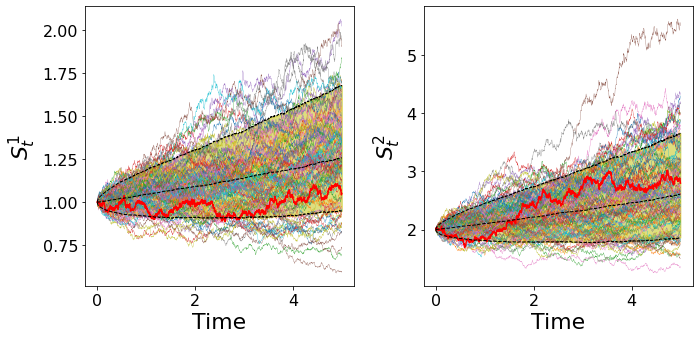

In [ ]:
# Sim some paths and show sims with quantiles and a sample path
t, S, X, Z, W_S = SimPath(Ndt=252*5, params = params_MV, T=5, Nsims = 5000)

plt.figure(figsize=(10,5))
plt.rcParams.update({'font.size': 16})
plt.rc('axes', labelsize=22)
for i in range(S.shape[2]):
    
    plt.subplot(1,S.shape[2],i+1)
    
    plt.fill_between(t, np.quantile(S[:,:,i],0.1,axis=1).T, np.quantile(S[:,:,i],0.9,axis=1).T, color='y', alpha=0.5)
    plt.plot(t, S[:,:100,i],linewidth=0.3)
    plt.plot(t, S[:,0,i],color='r',linewidth=1.5)
    plt.plot(t, np.quantile(S[:,:,i],[0.1, 0.5, 0.9],axis=1).T,color='k',linewidth=1, linestyle='--')
    
    plt.xlabel("Time")
    plt.ylabel("$S_t^" +str(i+1)+"$")
    
plt.tight_layout()
plt.show()

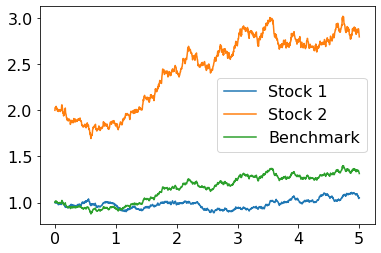

In [ ]:
plt.plot(t, S[:, 0, 0], label = "Stock 1")
plt.plot(t, S[:, 0, 1], label = "Stock 2")
plt.plot(t, X[:, 0], label = "Benchmark")
plt.legend()

## Check Expectations

* Ensure $E[Z_{t}] = 1 $ for all t
* Ensure $E[X_{t}Z_{t}] = 1 $ for all t

In [ ]:
print("Z_t mean: ",np.mean(Z, axis = 1))
print("X_t*Z_t mean: ", np.mean(X * Z, axis = 1))
print("S_t*Z_t mean: ", np.mean(S[:,:,0] * Z, axis = 1))


Z_t mean:  [1. 1. 1. ... 1. 1. 1.]
X_t*Z_t mean:  [1. 1. 1. ... 1. 1. 1.]
S_t*Z_t mean:  [1. 1. 1. ... 1. 1. 1.]


In [ ]:
print(Z[1000,:])
print((X*Z)[1000,:])
print(X[1000, :])

[0.55450817 0.27987161 3.73302549 ... 0.10553322 1.21400562 0.15120927]
[0.7141163  0.34385887 3.19957926 ... 0.18593108 1.47919444 0.2211224 ]
[1.28783728 1.22863075 0.85710083 ... 1.76182505 1.21844118 1.4623601 ]


# Helper Functions

## Uniform Generator and Copula

In [ ]:
def ICopula(x, u, u_s):
  return  x * u_s * (u <= u_s) + u * (u > u_s) * (x > 0)

In [ ]:
def KDE_DF_adj(X, V, SDF):
    n = X.shape[0]
    h = 1.06 * np.std(X) * n**(-1/5) / 1
    EDF = np.zeros(n)
    max_scale = 1 / (stats.norm.pdf(0) / (n*h))
    
    for i in range(n):

      x_score = (X-X[i])/h
      EDF += SDF[i] /(n*h) * np.clip(1/V + 1/(1-V), 0 , max_scale)* stats.norm.pdf(x_score)
      
    return EDF

def KDE_DF_vec(X, V, SDF):
    n = X.shape[0]
    h = 1.06 * np.std(X) * n**(-1/5) / 1

    max_scale = 1 / (stats.norm.pdf(0) / (n*h))
    x_score = (X.reshape(1, -1) - X.reshape(-1, 1)) / h
    EDF = np.sum(stats.norm.pdf(x_score)* SDF.reshape(-1, 1)) * np.clip(1/V + 1/(1-V), 0 , max_scale).reshape(1, -1) /(n*h)
      
    return EDF.reshape(-1, 1)

In [ ]:
def GenerateUniforms(X, Y): 
    h = lambda  X : 1.06 * np.std(X) * (len(X))**(-1/5)
    f = lambda x, X, h : np.sum( stats.norm.pdf((x.reshape(1,-1)-X.reshape(-1,1))/h)/h, axis=0 ) / len(X)         
    ecdf_X = ECDF(X)
    ecdf_Y = ECDF(Y)
    # generate uniforms        
    U_X = ecdf_X(X)
    U_Y = ecdf_Y(Y)
    # generate  G_{X|Y}(x|y) := P(X \le x | Y = y) using kernel densities
    G = lambda x, y, X, Y, hx, hy : np.sum(stats.norm.cdf((x.reshape(1,-1)-X.reshape(-1,1))/hx) \
                                           * stats.norm.pdf((y.reshape(1,-1)-Y.reshape(-1,1))/hy)/hy, axis=0 ) / len(X) / f(y, Y, hy)
    U_X_Y = G(X, Y, X, Y, h(X), h(Y))
    ecdf_U_X_Y = ECDF(U_X_Y)
    U_X_Y = ecdf_U_X_Y(U_X_Y)
    return U_X, U_Y, U_X_Y

In [ ]:
def GenerateInput(X_T, Z_T):
  U_Z, U_X, U_Z_X = GenerateUniforms(Z_T, X_T)
  V = ICopula(1-U_Z_X, U_X, 0.25)
  ecdf_V = ECDF(V)
  V = ecdf_V(V)
  V_clip = np.clip(V, 1e-4, 1 - 1e-4)
  V_logit = logit(V_clip)

  return V, V_clip, V_logit, U_X

### Testing

In [ ]:
t, S, X, Z, W_S = SimPath(Ndt=252*5, params = params_MV, T=5, Nsims = 5000)
X_log = np.log(X[-1,:])
Z_log = np.log(Z[-1,:])
u_z, u_x, u_z_x = GenerateUniforms(Z_log, X_log)
V = ICopula(1-u_z_x, u_x, 0.25)

ecdf_V = ECDF(V)
V = ecdf_V(V)

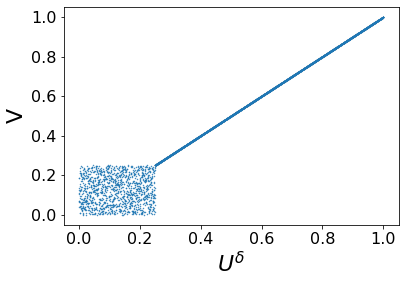

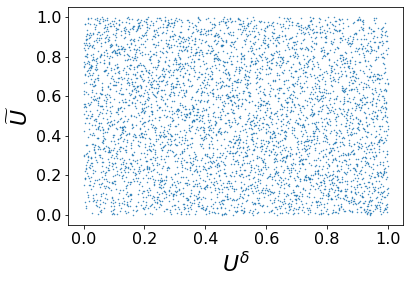

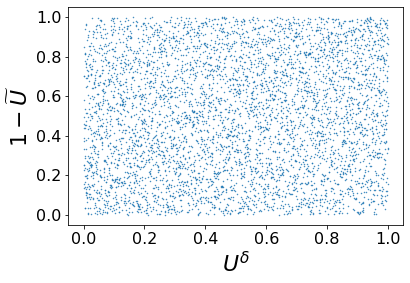

Text(0, 0.5, 'V')

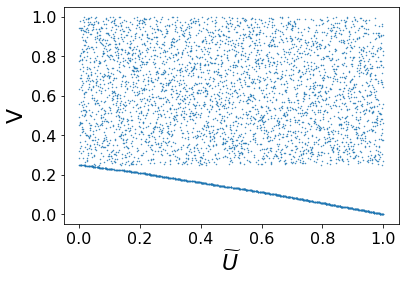

In [ ]:
plt.scatter(u_x, V, s = 0.2)
plt.xlabel("$U^\delta$")
plt.ylabel("V")
plt.show()
plt.scatter(u_x, u_z_x, s = 0.2)
plt.xlabel("$U^\delta$")
plt.ylabel("$\widetilde{U}$")
plt.show()
plt.scatter(u_x, 1 - u_z_x, s = 0.2)
plt.xlabel("$U^\delta$")
plt.ylabel("$1 - \widetilde{U}$")
plt.show()
plt.scatter(u_z_x, V, s = 0.2)
plt.xlabel("$\widetilde{U}$")
plt.ylabel("V")

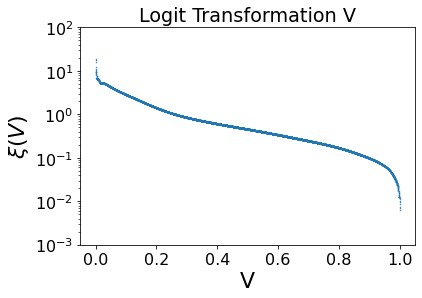

In [ ]:
V_clip = np.clip(V, 1e-4,  1 - 1e-4)
V_logit = logit(V_clip)

EDF_log = KDE_DF_adj(V_logit, V_clip, Z[-1,:])
plt.scatter(V, EDF_log, s = 0.2)
plt.xlabel("V")
plt.yscale("log")
#plt.xlim([0,0.25])
plt.ylim([1/10**3, 10**2])
plt.ylabel(r"$ \xi(V) $")
plt.title("Logit Transformation V")
plt.show()

## Plotting

### Plot Surface

In [ ]:
def PlotStrat(net, params, upper, lower, T):
    
    t = np.linspace(0, T, 252*T + 1)
    X_delta_t = np.linspace(lower, upper, 1000)

    x1, x2 = np.meshgrid(X_delta_t, t)
    x = np.zeros((x1.shape[0], x1.shape[1], 2))
    
    x[:,:,0] = x2/t[-1]
    x[:,:,1] = x1
    
    x_t = torch.tensor(x, dtype=torch.float, device = device)
    
    w_t = net(x_t).cpu().detach().numpy()
        
    fig = plt.figure(figsize=(8*w_t.shape[2],5))

    
    for i in range(w_t.shape[2]):
            
        ax = fig.add_subplot(1, w_t.shape[2], i+1, projection='3d')
        #Normalizing the weights to get the ratio of portfolio and benchmark weight
        ax.plot_surface(x2, x1, w_t[:,:,i]/params["delta"][i], cmap=cm.coolwarm, linewidth=0, antialiased=False)
        #ax.plot_surface(x2, x1, w_t[:,:,i], cmap=cm.coolwarm, linewidth=0, antialiased=False)
        #ax.plot_surface(x2, x1, w_t[:,:,i], cmap=cm.coolwarm)
       
        
        plt.title('Asset ' + str(i+1) + ' Scaled Weights', pad = 15)
        ax.set_xlabel('t', labelpad = 10, fontsize = 20)
        ax.set_ylabel(r'$X^{\delta}_{t}$'  , labelpad = 15, fontsize = 20)
        ax.yaxis.set_major_locator(plt.MaxNLocator(6))
        ax.zaxis.set_rotate_label(False)
        ax.set_zlabel(r'${\pi}_{t}$' + "/" + r'$\delta$', rotation =90, labelpad = 5, fontsize = 20)
        ax.zaxis.set_major_locator(plt.MaxNLocator(5))
        ax.view_init(30, 45)
        plt.savefig("Asset_Weights_" + str(i) + ".png")


    
    plt.tight_layout()
    plt.show()

### Plot Histograms

In [ ]:
def PlotHists_Copula(X, Y, U_X, V):
    
    bins = np.linspace(0, 4, 50)
    plt.figure(figsize=(15,5))
    
    plt.subplot(1, 3 ,1)
    sns.distplot(X, bins = bins, hist=True, kde= True, label='Benchmark')
    sns.distplot(Y, bins = bins,  hist=True, kde= True, label='Portfolio')
    plt.axvline(np.quantile(X, 0.1),color='k')
    plt.axvline(np.quantile(Y, 0.1),color='r')
    plt.xlim(bins[0],bins[-1])
    plt.legend()



    plt.subplot(1, 3, 2)
    base = [min(X), max(X)]
    plt.plot(base,base,'--k' )
    plt.scatter(X,Y, marker='o',color='r', s=5)
    plt.ylim(0.9*np.quantile(X,0.01),1.1*np.quantile(X,0.99))
    plt.xlim(0.9*np.quantile(X,0.01),1.1*np.quantile(X,0.99))
    plt.rcParams.update({'font.size': 16})
    plt.rc('axes', labelsize=22)


    plt.subplot(1, 3, 3)
    plt.scatter(V, Y, label = "NN Quantile Fnc")
    plt.plot(np.sort(np.squeeze(U_X)), np.sort(np.squeeze(X)), '--k', label = "BM Quantile Fnc")
    plt.legend()
  
    plt.tight_layout()
    plt.show()


def PlotHists(X, Y):
    
    bins = np.linspace(0, 4, 50)
    
    
    plt.figure(figsize=(10,5))
    plt.subplot(1, 2 ,1)
    sns.distplot(X, bins = bins, hist=True, kde= True, label='Benchmark')
    sns.distplot(Y, bins = bins,  hist=True, kde= True, label='Portfolio')
    plt.axvline(np.quantile(X, 0.1),color='k')
    plt.axvline(np.quantile(Y, 0.1),color='r')
    plt.xlim(bins[0],bins[-1])
    plt.legend()
    
    plt.subplot(1, 2, 2)
    base = [min(X), max(X)]
    plt.plot(base,base,'--k' )
    plt.scatter(X,Y, marker='o',color='r', s=5)
    plt.ylim(0.9*np.quantile(X,0.01),1.1*np.quantile(X,0.99))
    plt.xlim(0.9*np.quantile(X,0.01),1.1*np.quantile(X,0.99))
    plt.rcParams.update({'font.size': 16})
    plt.rc('axes', labelsize=22)
    plt.tight_layout()
    plt.show()


def PlotHists_Comparison(X, Y, Y_Target):
    
    bins = np.linspace(0, 4, 50)
    
    plt.figure(figsize=(10,5))
    plt.subplot(1, 2 ,1)
    #sns.distplot(X, bins = bins, hist=True, kde= True, label='Benchmark')
    sns.distplot(Y, bins = bins,  hist=True, kde= True, label='Portfolio')
    sns.distplot(Y_Target, bins = bins,  hist=True, kde= True, label='Target')
    #plt.axvline(np.quantile(X, 0.1),color='k')
    plt.axvline(np.quantile(Y, 0.1),color='r')
    plt.axvline(np.quantile(Y_Target, 0.1),color='k')
    plt.xlim(bins[0],bins[-1])
    plt.legend()
    
    plt.subplot(1, 2, 2)
    base = [min(X), max(X)]
    plt.plot(base,base,'--k' )
    plt.scatter(X,Y, marker='o',color='r', s=5, label = 'Portfolio')
    plt.scatter(X, Y_Target, marker='.',color='b', s = 2, label = 'Target')
    plt.ylim(0.9*np.quantile(X,0.01),1.1*np.quantile(X,0.99))
    plt.xlim(0.9*np.quantile(X,0.01),1.1*np.quantile(X,0.99))
    plt.rcParams.update({'font.size': 16})
    plt.rc('axes', labelsize=22)
    plt.legend()

    plt.tight_layout()
    plt.show()


def PlotPortValues(params, t, wt, Y_Target, Y_T):
 
    N_assets= params["mu"].shape[0]
    plt.figure(figsize=(10,5))
    
    plt.subplot(1,2,1)
    for i in range(N_assets):
      plt.plot(t, wt[:, 0, i], label = "Portfolio Weights, Asset #:  " + str(i+1), color = 'r')
      plt.axhline(params["delta"][i], label = "Benchmark Weights, Asset #: " + str(i+1))
    plt.legend(loc = 2, fontsize = "small")

    plt.subplot(1,2,2)
    base = [min(Y_Target), max(Y_Target)]
    plt.plot(base, base , '--k' )
    plt.scatter(Y_Target, Y_T , marker='o',color='r', s=5)
    plt.ylim(0.9*np.quantile(Y_Target,0.01),1.1*np.quantile(Y_Target,0.99))
    plt.xlim(0.9*np.quantile(Y_Target,0.01),1.1*np.quantile(Y_Target,0.99))
    
    plt.rcParams.update({'font.size': 16})
    plt.rc('axes', labelsize=22)
    
    plt.tight_layout()
    plt.show()



## Risk Measures

### Standard

In [ ]:
#%% Compute RM from samples
def GetRiskMeasure(X, Type):
    #TVaR    
    if (Type == "TVaR"):
        
        alpha = 0.1
        Qtl= torch.quantile(X, alpha)
        RiskMeasure = -torch.mean(X[X<=Qtl])
    
    # alpha-beta
    elif (Type == "alpha-beta" ):
        
        alpha = 0.1        
        LQtl = torch.quantile(X,alpha)
        
        beta = 0.9
        UQtl = torch.quantile(X,beta)
        
        # weight factor (p in the paper)
        p = 0.75
        eta = p * alpha + (1-p) * (1-beta)
        RiskMeasure = -(p* alpha* torch.mean(X[X<=LQtl]) \
                        + (1-p) *(1-beta) * torch.mean(X[X>=UQtl] ) )/eta
        
        
    #Variance
    elif (Type == "Variance"):  
        RiskMeasure = torch.var(X)   
        
    return RiskMeasure

### Distortion Deterministic

General Idea:

* Transform $ X_\delta $ into $ X_\pi = H_\theta(X_\delta)$ and interested in the distribution of $F_\theta(X_\pi ; \theta) $. The source of randomness is coming from $ X_\delta $, wouldn't using $ X_\pi = H_\theta(X_\delta) + \epsilon$ where $ \epsilon \sim \mathcal{N}(0, 0.01)$ just add unnecessary noise.
* $\nabla_{\theta} \mathcal{R}[X_\pi] = \mathbb{E} [ \frac{\nabla_{\theta}F(x;  \theta)|_{x = X_\pi} } {f(X_\pi;  \theta)} \gamma(F(X_\pi;  \theta)) ] $ still holds but can evaluate $ \nabla_{\theta}F(x;  \theta)|_{x = X_\pi} $  differently.
* $ \nabla_{\theta}F(x;  \theta) = \nabla_{\theta} \frac{1}{n}\sum_{i=1}^{n} \Phi(\frac{x - H_\theta(X_\delta^{(i)})}{h}) = -\frac{1}{nh}\sum_{i=1}^{n} \phi(\frac{x - H_{\theta}(X_\delta^{(i)})}{h}) \nabla_{\theta}H_\theta(X_\delta^{(i)}) $ 
* If include noise would this just be: $-\frac{1}{nh}\sum_{i=1}^{n} \phi(\frac{x - (H_{\theta}(X_\delta^{(i)}) + \epsilon)}{h}) \nabla_{\theta}H_\theta(X_\delta^{(i)}) $ 
* Would it be more accurate to replace $ \gamma(F(X_\pi;  \theta)) $ with just the percentile ranking for risk measures like TVaR and Alpha-Beta because the $ 10\%$ TVaR would not capture 500/5000 of the tail scenarios, but a number like 460/5000

rough notes

* Represents risk measure as expectation in terms of quantiles: $\mathcal{R}[X_\pi] = -\mathbb{E}[F^{-1}(U ; \theta)\gamma(U)]$
* Uses following gradient of risk measure: $\nabla_\theta\mathcal{R}_{d}[X_\pi] = -\mathbb{E}[\nabla_\theta F^{-1}(U ; \theta)\gamma(U)]$

In [ ]:
def GetRiskMeasure_Distortion_Deterministic(X, F_x,  Type):

    f_x , grad_F_x = Density_Estimate(X)

   
    if (Type == 'TVaR'):
      alpha = 0.1
      RM_weight = (F_x <= alpha)/alpha
     
    
    elif (Type == 'alpha-beta'):

      alpha = 0.1        
      beta = 0.9

      p = 0.75
      eta = p * alpha + (1-p) * (1-beta)
      RM_weight = (p *(F_x <= alpha) + (1-p) * (F_x > beta))/eta
    
    RiskMeasure = torch.mean(grad_F_x * RM_weight / f_x)
    return RiskMeasure

def Density_Estimate(X):
    
    n = X.shape[0]
    X_no_grad = X.detach()
    norm = Normal(0,1)
    h = 1.06 * torch.std(X_no_grad) * n**(-1/5)

    z_score = (X_no_grad.reshape(1, -1) - X_no_grad) / h
    f_x = torch.sum(torch.exp(norm.log_prob(z_score))/h, axis = 0) / n
    #F_x = torch.sum(norm.cdf(z_score), axis = 0) / n
    grad_F_x = -torch.sum(torch.exp(norm.log_prob(z_score))/h * X, axis = 0) / n
    # print(torch.exp(norm.log_prob(z_score))/h)
    # print(X)
    # print(torch.exp(norm.log_prob(z_score))/h * X)
    
    return f_x.reshape(-1, 1), grad_F_x.reshape(-1, 1)

def Density_Estimate_Slow(X):

    n = X.shape[0]
    h = 1.06 * torch.std(X.detach()) * n**(-1/5)
    norm = Normal(0,1)
    F_x = torch.zeros((n,1)).to(device)
    f_x = torch.zeros((n,1)).to(device)
    grad_F_x = torch.zeros((n,1)).to(device)
    
    for x_i in X:

      z_score = (X.detach() - x_i.detach())/h
      F_x += norm.cdf(z_score)/n
      f_x += torch.exp(norm.log_prob(z_score))/(n*h)
      grad_F_x -= torch.exp(norm.log_prob(z_score)) * x_i /(n*h)


    return f_x, grad_F_x


def Density_Estimate_Mask(X):

    n = X.shape[0]
    X_no_grad = X.detach()
    h = 1.06 * torch.std(X.detach()) * n**(-1/5)
    norm = Normal(0,1)
    f_x = torch.zeros((n,1)).to(device)
    grad_F_x = torch.zeros((n,1)).to(device)
    z_score = (X_no_grad.reshape(1, -1) - X_no_grad) / h
    
    for i in range(n):

      f_x[i, 0] =  torch.sum(torch.exp(norm.log_prob(z_score[i, torch.abs(z_score[i,:]) <= 5 ])))/(n*h)
      grad_F_x[i, 0] = -torch.sum(torch.exp(norm.log_prob(z_score[i, torch.abs(z_score[i,:]) <= 5 ])) * X[i , 0]) /(n*h)


    return f_x, grad_F_x

In [ ]:
    # wont work for grad_f_x since converting to np.array loses gradient... have to use a loop 
    #but this defeats the point as more inefficient than fully vectorized solution, propose to not mask
    h = 1
    n = 50
    X_no_grad = torch.rand((n,1))
    z_score = (X_no_grad.reshape(1, -1) - X_no_grad) / h
    norm = Normal(0, 1)
    f_x =  np.array([torch.sum(torch.exp(norm.log_prob(z_score[i, torch.abs(z_score[i,:]) <= 5 ]))/h) for i in range(n)])
    f_x = torch.FloatTensor(f_x.reshape(-1, 1)).to(device)

In [ ]:
    # masked solution, is there a better way? 
    # need to make sure gradients are still kept
    h = 1
    n = 50
    X_no_grad = torch.rand((n,1))
    norm = Normal(0, 1)    
    
    f_x = torch.zeros((n,1)).to(device)
    grad_F_x = torch.zeros((n,1)).to(device)
    z_score = (X_no_grad.reshape(1, -1) - X_no_grad) / h
    
    for i in range(n):

      f_x[i, 0] =  torch.sum(torch.exp(norm.log_prob(z_score[i, torch.abs(z_score[i,:]) <= 5 ])))/(n*h)
      grad_F_x[i, 0] = -torch.sum(torch.exp(norm.log_prob(z_score[i, torch.abs(z_score[i,:]) <= 5 ])) * X_no_grad[i , 0]) /(n*h)

    #print(f_x)

## Wass Distance

In [ ]:
# %% compute Wasserstein distance
def getWassDistance(X, Y):
    
    X_sorted, _ = torch.sort(X)
    Y_sorted, _ = torch.sort(Y)
    wass_dist = torch.sqrt(torch.mean(( X_sorted - Y_sorted )**2))
    
    return wass_dist 


# Part 1 Training

## Comonotonic

In [ ]:
def SimRM(BenchmarkVal_T, Z_T, X0, net, params, Ndt = 252*5, T = 5, Nsims = 5000, Type="alpha-beta", Update = "backprop", device= device):
    
    PortfolioVal_T = net(BenchmarkVal_T)
    X0_port = torch.mean(PortfolioVal_T * Z_T)
    PortfolioVal_T_np = PortfolioVal_T.cpu().detach().numpy()

    wass_dist = getWassDistance(BenchmarkVal_T, PortfolioVal_T)
    budget_dist =  X0_port - X0

    if Update == "backprop":
      RiskMeasure = GetRiskMeasure(PortfolioVal_T, Type) 
      RiskMeasure_Actual = RiskMeasure.detach()
    
    elif Update == "distortion":

      ecdf_Y = ECDF(PortfolioVal_T_np.squeeze())      
      U_Y = ecdf_Y(PortfolioVal_T_np.squeeze())
      U_Y = torch.FloatTensor(U_Y.reshape(-1, 1)).to(device)
      RiskMeasure = GetRiskMeasure_Distortion_Deterministic(PortfolioVal_T, U_Y, Type) 
      RiskMeasure_Actual = GetRiskMeasure(PortfolioVal_T.detach(), Type) 
    
    
    
    return RiskMeasure, RiskMeasure_Actual, wass_dist, budget_dist, PortfolioVal_T_np

In [ ]:
def Train_ValueNet(net, model_name, params,  Ndt, T, Nsims, Nepochs, Update = "backprop"):
  
  loss_history = []
  risk_history = []
  wass_dist_history=[]
  budget_dist_history = []
  start_time= time.time()
  optimizer = optim.Adam(net.parameters(), lr = 1e-3)
  
  if Update == "backprop":
    total_iter = 10000
    print_iter = 4999
    wass_scale = 1.5
    budget_scale = 1

  elif Update == "distortion":
    total_iter = 10000
    print_iter = 4999
    wass_scale = 1.25
    budget_scale = 1


  for epoch in range(Nepochs):

      X0 = 1
      t, S, X, Z, W_S = SimPath(Ndt, params, T=T, Nsims=Nsims, X0 = X0) 
      X_T, Z_T = X[-1, :], Z[-1, :]


      BenchmarkVal_T = torch.FloatTensor(X[-1, :].reshape(-1,1)).to(device)
      Z_T = torch.FloatTensor(Z_T.reshape(-1,1)).to(device)

      for i in range(total_iter):

        optimizer.zero_grad()
        RiskMeasure, RiskMeasure_Actual, wass_dist, budget_dist,  Y_T  = SimRM(BenchmarkVal_T, Z_T, X0, net, params, Ndt, T , Nsims, \
                                                                         Type="alpha-beta", Update = Update, device= device)
        loss = wass_scale*(wass_dist - 0.1)*(wass_dist > 0.1) + budget_scale*budget_dist*(budget_dist > 0) + RiskMeasure
        loss.backward()   
        optimizer.step()
        
        loss_history.append(loss.item())
        risk_history.append(RiskMeasure_Actual.item())
        wass_dist_history.append(wass_dist.item())
        budget_dist_history.append(budget_dist.item())
        

        if (i + 1) % 500 == 0:
          torch.save(net.state_dict(), root_dir + model_name)
          #print("Network Checkpoint Reached! Epoch: {} Iteration: {} ".format(epoch, i))
        
        if (i + 1) % 1000 == 0:
          torch.save(net.state_dict(), root_dir + "Epoch_" + str(epoch) + "Iter_" + str(i) + "_" + model_name)
          #print("Second Network Checkpoint Reached! Epoch: {} Iteration: {} ".format(epoch, i))
        

        if (i + 1) % print_iter == 0:

            print("Epoch: {} Iteration: {} ".format(epoch, i) , end=" ")
            print("duration = ", "{:.3f}".format(time.time() - start_time), " secs")
            start_time = time.time()
            print("Budget Dist:", "{:.3f}".format(budget_dist_history[-1]), end=" " )
            print("Wass Dist:",  "{:.3f}".format(wass_dist_history[-1]), end=" " )
            print("Risk Measure:", "{:.3f}".format(risk_history[-1]), end=" ")
            print("Loss:", "{:.3f}".format(loss_history[-1]))

            PlotHists(X_T, Y_T)
                
  print('Finished Training')

## Copula 

In [ ]:
def SimRM_Copula(BenchmarkVal_T, V_T, EDF_T, X0, net, params, Ndt = 252*5, T = 5, Nsims = 5000, Type="alpha-beta", Update = "backprop", device= device):
    
    PortfolioVal_T = net(V_T)
    X0_port = torch.mean(PortfolioVal_T * EDF_T)
    
    wass_dist = getWassDistance(BenchmarkVal_T, PortfolioVal_T)

    if Update == "backprop":
      RiskMeasure = GetRiskMeasure(PortfolioVal_T, Type) 
      RiskMeasure_Actual = RiskMeasure.detach()

    elif Update == "distortion":
      RiskMeasure = GetRiskMeasure_Distortion_Deterministic(PortfolioVal_T, V_T, Type) 
      RiskMeasure_Actual = GetRiskMeasure(PortfolioVal_T.detach(), Type) 
    
    budget_dist =  X0_port - X0
    
    return RiskMeasure, RiskMeasure_Actual, wass_dist, budget_dist, PortfolioVal_T.cpu().detach().numpy()

In [ ]:
def Train_ValueNet_Copula(net, model_name, params,  Ndt, T, Nsims, Nepochs, Update = "backprop"):
  
  loss_history = []
  risk_history = []
  wass_dist_history=[]
  budget_dist_history = []
  start_time= time.time()
  optimizer = optim.Adam(net.parameters(), lr = 1e-3)
  
  if Update == "backprop":
    total_iter = 10000
    print_iter = 4999
    wass_scale = 2
    budget_scale = 2

  elif Update == "distortion":
    total_iter = 10000
    print_iter = 4999
    wass_scale = 1.25
    budget_scale = 1.1


  for epoch in range(Nepochs):

      X0 = 1
      t, S, X, Z, W_S = SimPath(Ndt, params, T=T, Nsims=Nsims, X0 = X0) 
      X_T, Z_T = X[-1, :], Z[-1, :]
      V, V_clip, V_logit, U_X = GenerateInput(np.log(X_T), np.log(Z_T))
      EDF = KDE_DF_adj(V_logit, V_clip, Z_T)

      BenchmarkVal_T = torch.FloatTensor(X[-1, :].reshape(-1,1)).to(device)
      EDF_T = torch.FloatTensor(EDF.reshape(-1, 1)).to(device)
      V_T = torch.FloatTensor(V.reshape(-1,1)).to(device)

      for i in range(total_iter):

        optimizer.zero_grad()
        RiskMeasure, RiskMeasure_Actual, wass_dist, budget_dist,  Y_T  = SimRM_Copula(BenchmarkVal_T, V_T, EDF_T, X0, net, params, Ndt, T , Nsims, \
                                                                         Type="alpha-beta", Update = Update, device= device)
        loss = wass_scale*(wass_dist - 0.1)*(wass_dist > 0.1) + budget_scale*budget_dist*(budget_dist > 0) + RiskMeasure
        loss.backward()   
        optimizer.step()
        
        loss_history.append(loss.item())
        risk_history.append(RiskMeasure_Actual.item())
        wass_dist_history.append(wass_dist.item())
        budget_dist_history.append(budget_dist.item())
        

        if (i + 1) % 500 == 0:
          torch.save(net.state_dict(), root_dir + model_name)
          #print("Network Checkpoint Reached! Epoch: {} Iteration: {} ".format(epoch, i))
        
        if (i + 1) % 1000 == 0:
          torch.save(net.state_dict(), root_dir + "Epoch_" + str(epoch) + "Iter_" + str(i) + "_" + model_name)
          #print("Second Network Checkpoint Reached! Epoch: {} Iteration: {} ".format(epoch, i))
        

        if (i + 1) % print_iter == 0:

            print("Epoch: {} Iteration: {} ".format(epoch, i) , end=" ")
            print("duration = ", "{:.3f}".format(time.time() - start_time), " secs")
            start_time = time.time()
            print("Budget Dist:", "{:.3f}".format(budget_dist_history[-1]), end=" " )
            print("Wass Dist:",  "{:.3f}".format(wass_dist_history[-1]), end=" " )
            print("Risk Measure:", "{:.3f}".format(risk_history[-1]), end=" ")
            print("Loss:", "{:.3f}".format(loss_history[-1]))

            PlotHists_Copula(X_T, Y_T, U_X, V)
                
  print('Finished Training')

# Part 2 Training

## Continuous

In [ ]:
def SimWeight_Continuous(BenchmarkVal_T, BenchmarkPath_Time, Z, W_S, X0, value_net, port_net, params, Ndt = 252*5, T = 5, Nsims = 5000, Type= "alpha-beta",  device= device):
    
    PortfolioVal_Target = value_net(BenchmarkVal_T).detach()
    wt = port_net(BenchmarkPath_Time)

    PortfolioVal_path = np.zeros((Ndt+1,Nsims))
    PortfolioVal_path[0,:] = X0
    PortfolioVal_i = torch.zeros((1,Nsims), dtype=torch.float,  device=device)  
    PortfolioVal_i[0,:] = X0

    sigma_tensor = torch.FloatTensor(params["sigma"]).to(device)
    mu_tensor = torch.FloatTensor(params["mu"]).to(device)
    rho_tensor = torch.FloatTensor(params["rho"]).to(device)

    dt = T/Ndt
    for i in range(Ndt):

      dW = W_S[i, : , :]
      wt_i = wt[i, :, :]

      conv = torch.diagonal(((wt_i*sigma_tensor) @ rho_tensor @ (wt_i*sigma_tensor).T), 0)
      PortfolioVal_i *= torch.exp((params["rf"] + torch.sum(wt_i * \
                                  (mu_tensor-params["rf"]), axis = 1) -0.5*conv)*dt + \
                                  torch.sum(wt_i * sigma_tensor * dW, axis=1))
      PortfolioVal_adj_factor = X0 - torch.mean(PortfolioVal_i * Z[i+1, :])
      PortfolioVal_i += PortfolioVal_adj_factor
      PortfolioVal_path[i+1 ,:] = PortfolioVal_i.cpu().detach().numpy()

    PortfolioVal_T = PortfolioVal_i.reshape(-1, 1)
    X0_port = torch.mean(PortfolioVal_T * Z[-1, :].reshape(-1, 1))

    #loss_fnc = torch.nn.MSELoss()
    loss_fnc = torch.nn.SmoothL1Loss(beta = 0.1)

    #Add budget constraint
    terminal_val_dist = loss_fnc(PortfolioVal_T, PortfolioVal_Target)
    wass_dist = getWassDistance(BenchmarkVal_T, PortfolioVal_T).item()
    RiskMeasure = GetRiskMeasure(PortfolioVal_T, Type).item()
    budget_dist = (X0_port - X0).item()


    return wt.cpu().detach().numpy(), PortfolioVal_Target.cpu().detach().numpy(), PortfolioVal_path, RiskMeasure, wass_dist, budget_dist, terminal_val_dist

## Discrete

In [ ]:
def SimWeight_Discrete(BenchmarkVal_T, BenchmarkPath_Time, Z_T, S_t, X0, value_net, port_net, params, Ndt = 252*5, T = 5, Nsims = 5000, Type= "alpha-beta",  device= device):
    
    dt = T/Ndt
    PortfolioVal_Target = value_net(BenchmarkVal_T).detach()
    wt = port_net(BenchmarkPath_Time)
    
    S_Ret = (S_t[1:,:,:]-S_t[:-1,:,:])/S_t[:-1,:,:]
    Portfolio_Ret = (1-torch.sum(wt[:-1,:,:], axis=2)) * params["rf"] * dt+ torch.sum(wt[:-1,:,:] * S_Ret , axis=2)    
    PortfolioVal_path = torch.zeros((Ndt+1,Nsims), dtype=torch.float, device=device)    
    PortfolioVal_path[0,:] = X0
    PortfolioVal_path[1:,:] = X0*torch.cumprod((1.0+Portfolio_Ret), axis=0)
    PortfolioVal_T = PortfolioVal_path[-1,:].reshape(-1,1)
    X0_port = torch.mean(PortfolioVal_T * Z_T)

    #loss_fnc = torch.nn.MSELoss()
    loss_fnc = torch.nn.SmoothL1Loss(beta = 0.01)

    #Add budget constraint
    terminal_val_dist = loss_fnc(PortfolioVal_T, PortfolioVal_Target)
    wass_dist = getWassDistance(BenchmarkVal_T, PortfolioVal_T).item()
    RiskMeasure = GetRiskMeasure(PortfolioVal_T, Type).item()
    budget_dist = (X0_port - X0).item()


    return wt.cpu().detach().numpy(), PortfolioVal_Target.cpu().detach().numpy(), PortfolioVal_path.cpu().detach().numpy(), RiskMeasure, wass_dist, budget_dist, terminal_val_dist

## Training

In [ ]:
def Train_PortNet(value_net, port_net, model_name, params,  Ndt, T, Nsims, Nepochs, Path_Type = "discrete"):

  loss_history = []
  risk_history = []
  wass_dist_history=[]
  terminal_val_dist_history = []
  budget_dist_history = []

  start_time= time.time()
  optimizer = optim.Adam(port_net.parameters(), lr = 1e-2)

  for epoch in range(Nepochs): 

    X0 = 1
    t, S, X, Z, W_S = SimPath(Ndt, params, T=T, Nsims=Nsims, X0 = X0)  
    X_T, Z_T = X[-1, :], Z[-1, :]

    Z = torch.FloatTensor(Z).to(device)
    W_S = torch.FloatTensor(W_S).to(device) 
    Z_T = torch.FloatTensor(Z_T.reshape(-1, 1)).to(device)
    S_t = torch.FloatTensor(S).to(device) 

    BenchmarkVal_T = torch.FloatTensor(X[-1, :].reshape(-1,1)).to(device)
    BenchmarkPath_Time =np.zeros((Ndt+1, Nsims, 2))   
    BenchmarkPath_Time[:,:,0] = np.matlib.repmat(t.reshape(-1,1)/t[-1], 1, Nsims)
    BenchmarkPath_Time[:,:,1] = X/X0
    BenchmarkPath_Time_Tensor = torch.FloatTensor(BenchmarkPath_Time).to(device)


    for i in range(1000):  

        optimizer.zero_grad()
      
        if Path_Type == "continuous":

          wt, PortfolioVal_Target, PortfolioVal_path, RiskMeasure, wass_dist, budget_dist, terminal_val_dist = \
          SimWeight_Continuous(BenchmarkVal_T, BenchmarkPath_Time_Tensor, Z, W_S, X0, value_net, port_net, params, Ndt, T , Nsims , Type = "alpha-beta", device= device)
        
        elif Path_Type == "discrete":

          wt, PortfolioVal_Target, PortfolioVal_path, RiskMeasure, wass_dist, budget_dist, terminal_val_dist = \
          SimWeight_Discrete(BenchmarkVal_T, BenchmarkPath_Time_Tensor, Z_T, S_t, X0, value_net, port_net, params, Ndt, T , Nsims , Type = "alpha-beta", device= device)

        loss = terminal_val_dist 
        loss.backward()   
        optimizer.step()
        
    
        loss_history.append(loss.item())
        terminal_val_dist_history.append(terminal_val_dist.item())
        risk_history.append(RiskMeasure)
        wass_dist_history.append(wass_dist)
        budget_dist_history.append(budget_dist)
        
        if (i + 1) % 100 == 0:
          torch.save(port_net.state_dict(), root_dir + model_name)
          #print("Network Checkpoint, Epoch: ", epoch, end = " ")
          print("Epoch: {} Iteration: {} ".format(epoch, i), end=" ")
          print("duration = ", "{:.3f}".format(time.time() - start_time), " secs")
          start_time = time.time()

          print("Terminal Val Dist:", "{:.3f}".format(terminal_val_dist_history[-1]), end=" " )
          print("Wass Dist:", "{:.3f}".format(wass_dist_history[-1]), end=" " )
          print("Budget Dist:", "{:.3f}".format(budget_dist_history[-1]), end=" " )
          print("Risk Measure:", "{:.3f}".format(risk_history[-1]), end=" ")
          print("Loss:", "{:.3f}".format(loss_history[-1]))

          # Plots Index vs Target
          Y_T = PortfolioVal_path[-1, :]
          #PlotHists(X_T, PortfolioVal_Target)
          PlotHists_Comparison(X_T, Y_T, PortfolioVal_Target)
          #Plots time series weights of replicated portfolio as well as terminal target port value vs terminal replicated port value
          PlotPortValues(params, t, wt, PortfolioVal_Target, Y_T)

    
    torch.save(port_net.state_dict(), root_dir + "Epoch_" + str(epoch) + "_" + model_name)
    #print("Second Network Checkpoint Reached: Epoch: ", epoch, end = " ")
    lower = 0.9 * np.quantile(X , 0.01)
    upper = 1.1 * np.quantile(X, 0.99)
    PlotStrat(port_net, params, upper, lower, T)


  print('Finished Training')

# Results

## Comonotonic Backprop

### Part 1

Epoch: 0 Iteration: 4998  duration =  17.679  secs
Budget Dist: 0.007 Wass Dist: 0.107 Risk Measure: -1.328 Loss: -1.310


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


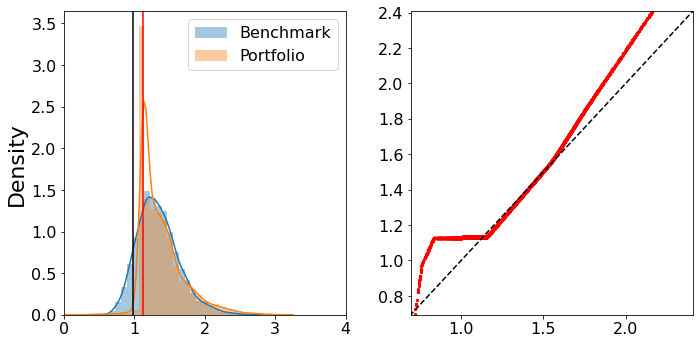

Epoch: 0 Iteration: 9997  duration =  16.240  secs
Budget Dist: -0.004 Wass Dist: 0.103 Risk Measure: -1.323 Loss: -1.318


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


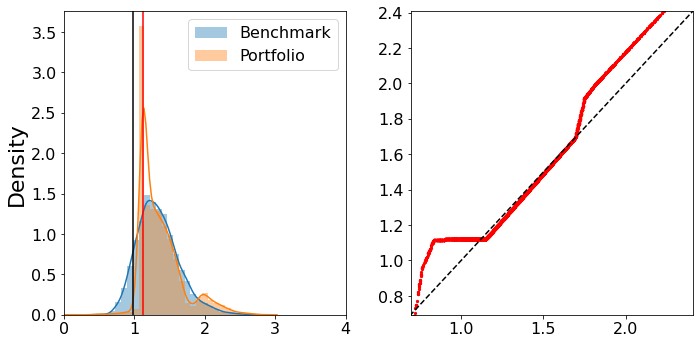

Epoch: 1 Iteration: 4998  duration =  18.362  secs
Budget Dist: 0.007 Wass Dist: 0.101 Risk Measure: -1.282 Loss: -1.273


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


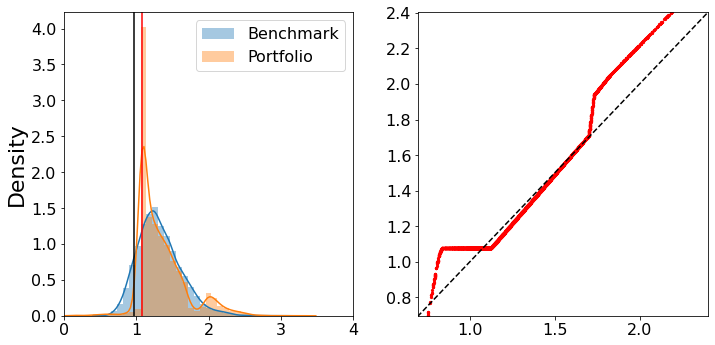

Epoch: 1 Iteration: 9997  duration =  16.136  secs
Budget Dist: -0.002 Wass Dist: 0.099 Risk Measure: -1.272 Loss: -1.272


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


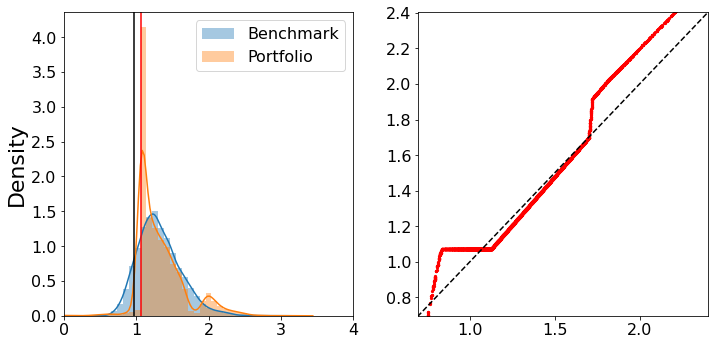

Epoch: 2 Iteration: 4998  duration =  18.197  secs
Budget Dist: -0.002 Wass Dist: 0.098 Risk Measure: -1.277 Loss: -1.277


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


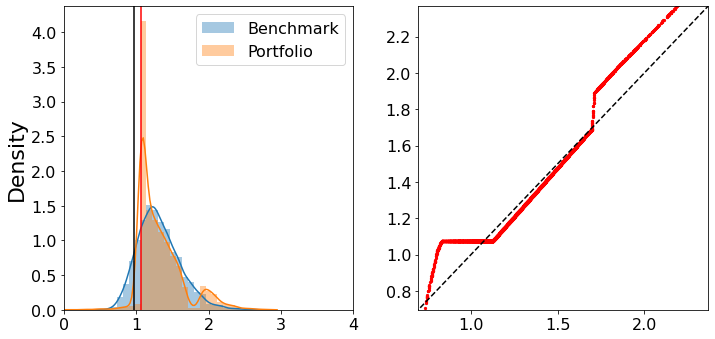

Epoch: 2 Iteration: 9997  duration =  16.178  secs
Budget Dist: -0.000 Wass Dist: 0.102 Risk Measure: -1.284 Loss: -1.281


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


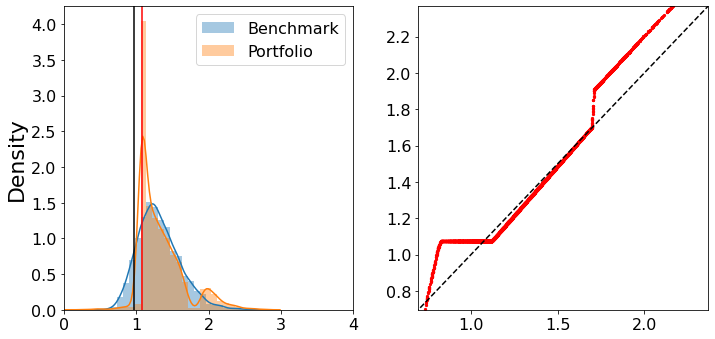

Epoch: 3 Iteration: 4998  duration =  18.077  secs
Budget Dist: 0.004 Wass Dist: 0.102 Risk Measure: -1.284 Loss: -1.277


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


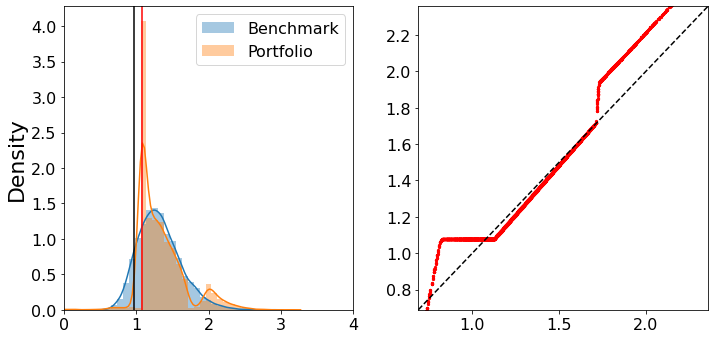

Epoch: 3 Iteration: 9997  duration =  16.120  secs
Budget Dist: 0.012 Wass Dist: 0.104 Risk Measure: -1.292 Loss: -1.274


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


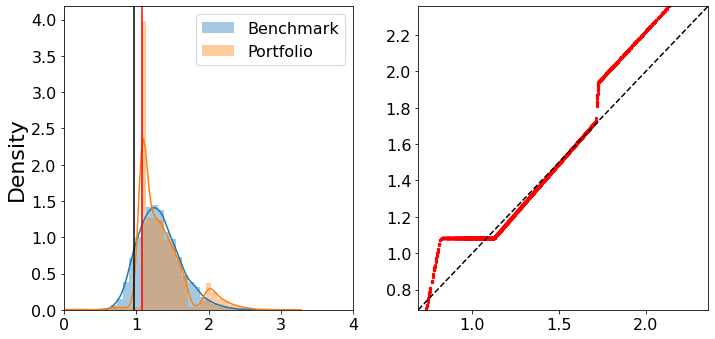

Epoch: 4 Iteration: 4998  duration =  18.184  secs
Budget Dist: 0.003 Wass Dist: 0.104 Risk Measure: -1.301 Loss: -1.292


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


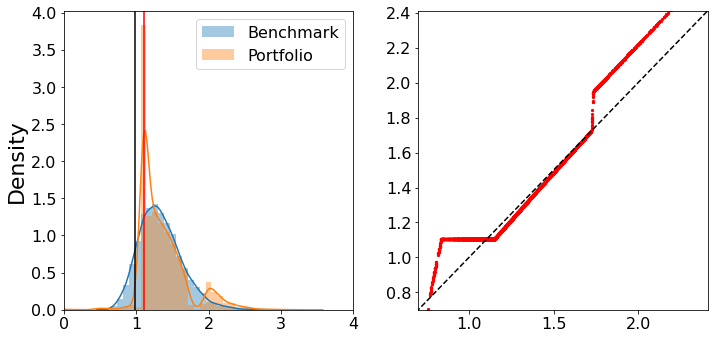

Epoch: 4 Iteration: 9997  duration =  16.227  secs
Budget Dist: 0.010 Wass Dist: 0.106 Risk Measure: -1.309 Loss: -1.289


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


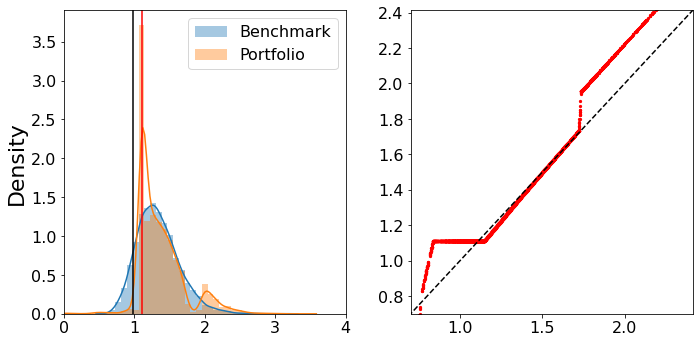

Finished Training


In [ ]:
net = ValueNet(50).to(device)
model_name = "ValueNet_Standard.pt"
T = 5
Ndt = 252*T
Nsims = 5000
Nepochs = 5
Train_ValueNet(net, model_name, params_MV,  Ndt, T, Nsims, Nepochs, Update = "backprop")

### Part 2

Epoch: 0 Iteration: 99  duration =  246.748  secs
Terminal Val Dist: 0.020 Wass Dist: 0.063 Budget Dist: 0.000 Risk Measure: -1.185 Loss: 0.020


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


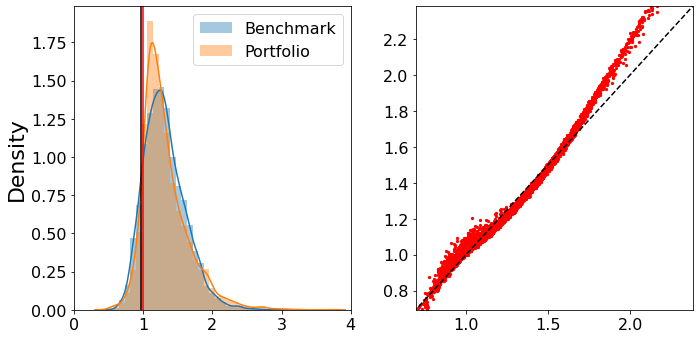

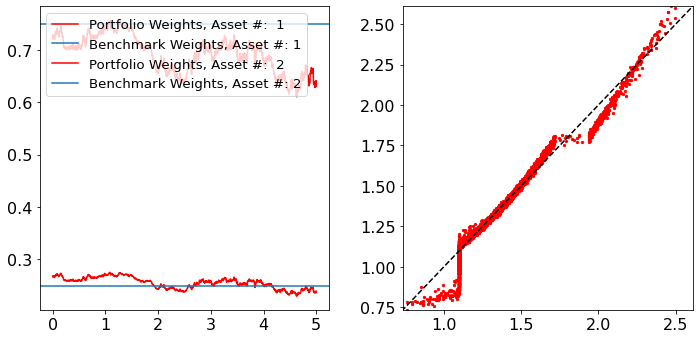

Epoch: 0 Iteration: 199  duration =  246.055  secs
Terminal Val Dist: 0.013 Wass Dist: 0.075 Budget Dist: 0.000 Risk Measure: -1.211 Loss: 0.013


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


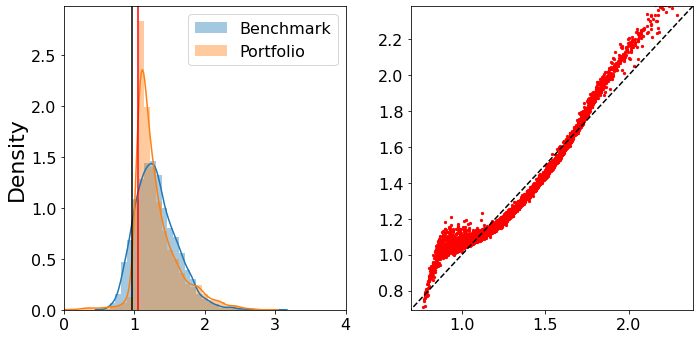

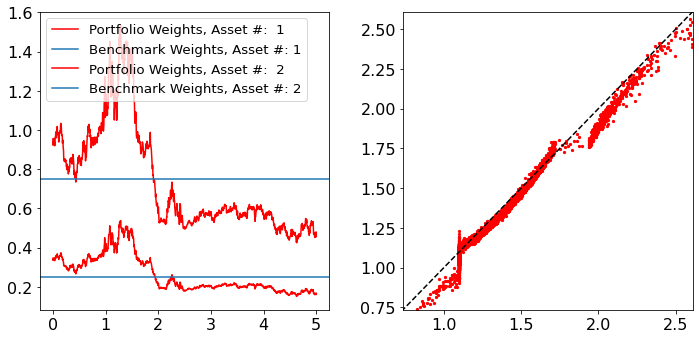

Epoch: 0 Iteration: 299  duration =  246.034  secs
Terminal Val Dist: 0.007 Wass Dist: 0.091 Budget Dist: 0.000 Risk Measure: -1.238 Loss: 0.007


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


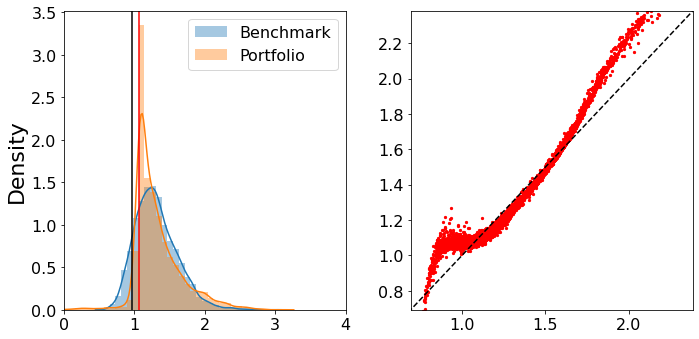

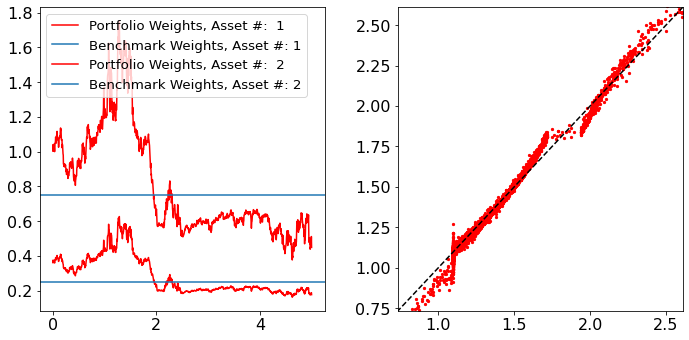

Epoch: 0 Iteration: 399  duration =  245.924  secs
Terminal Val Dist: 0.007 Wass Dist: 0.089 Budget Dist: 0.000 Risk Measure: -1.235 Loss: 0.007


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


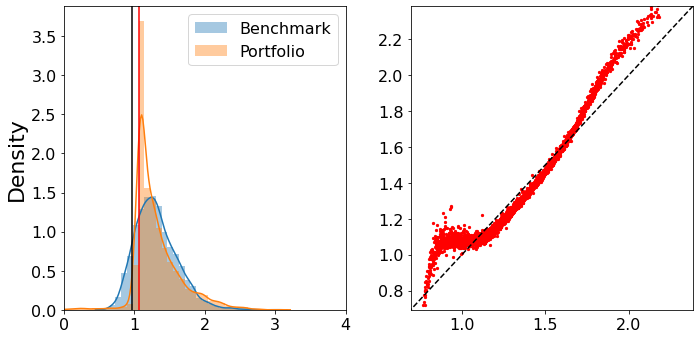

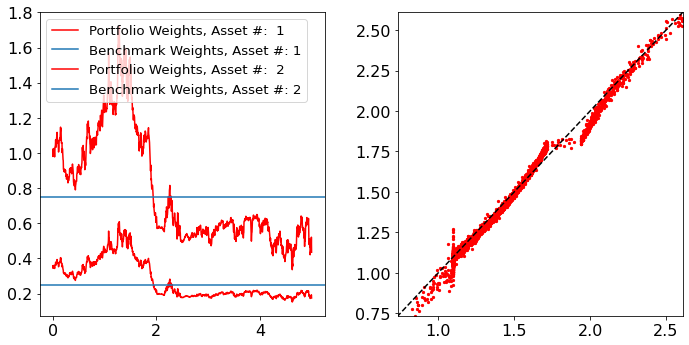

Epoch: 0 Iteration: 499  duration =  245.771  secs
Terminal Val Dist: 0.007 Wass Dist: 0.089 Budget Dist: 0.000 Risk Measure: -1.235 Loss: 0.007


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


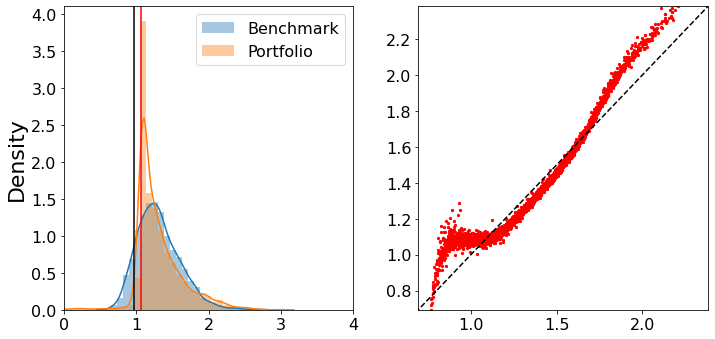

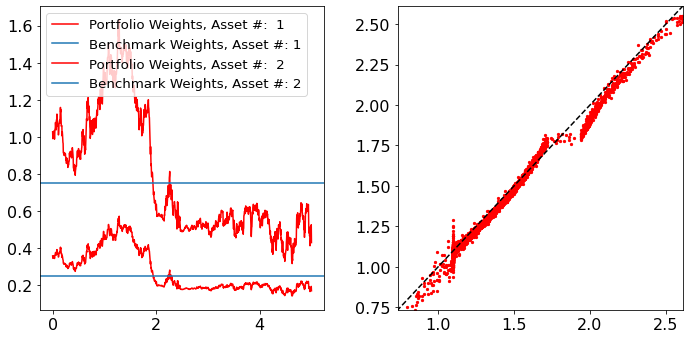

Epoch: 0 Iteration: 599  duration =  245.848  secs
Terminal Val Dist: 0.005 Wass Dist: 0.096 Budget Dist: -0.000 Risk Measure: -1.246 Loss: 0.005


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


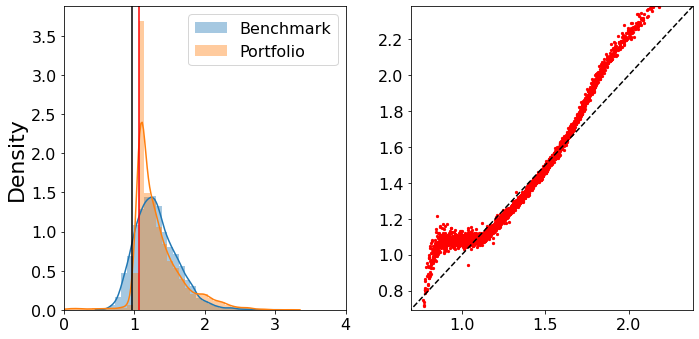

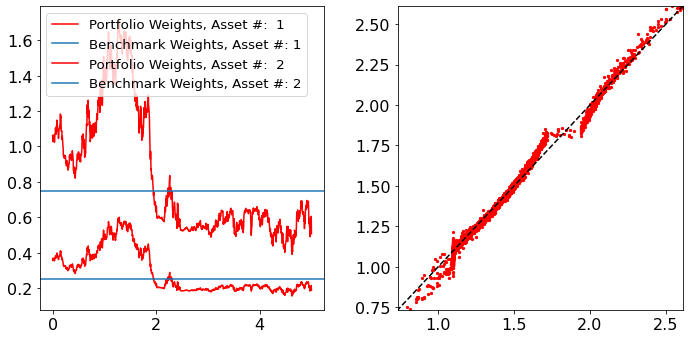

Epoch: 0 Iteration: 699  duration =  245.798  secs
Terminal Val Dist: 0.005 Wass Dist: 0.091 Budget Dist: 0.000 Risk Measure: -1.241 Loss: 0.005


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


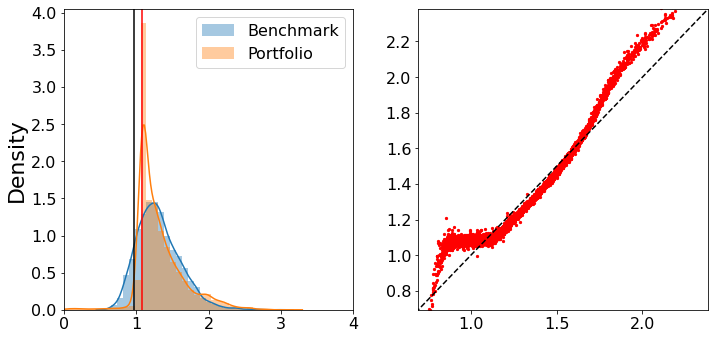

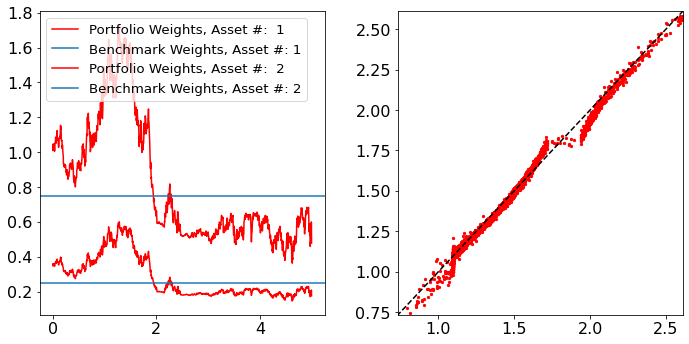

Epoch: 0 Iteration: 799  duration =  245.782  secs
Terminal Val Dist: 0.004 Wass Dist: 0.094 Budget Dist: 0.000 Risk Measure: -1.247 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


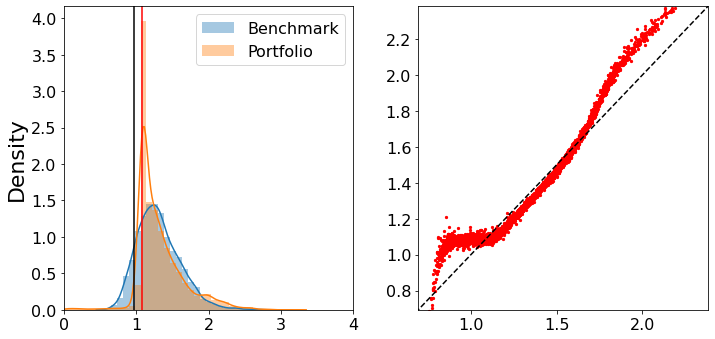

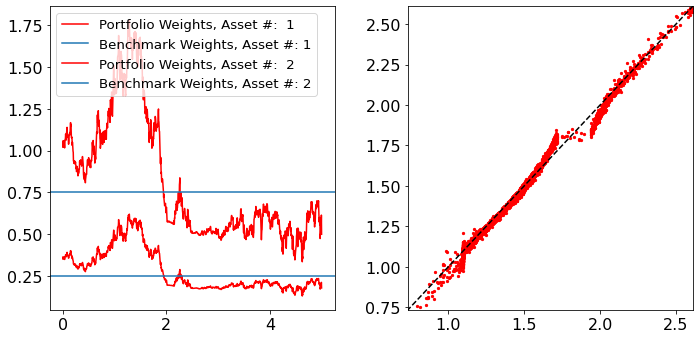

Epoch: 0 Iteration: 899  duration =  245.822  secs
Terminal Val Dist: 0.006 Wass Dist: 0.091 Budget Dist: 0.000 Risk Measure: -1.241 Loss: 0.006


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


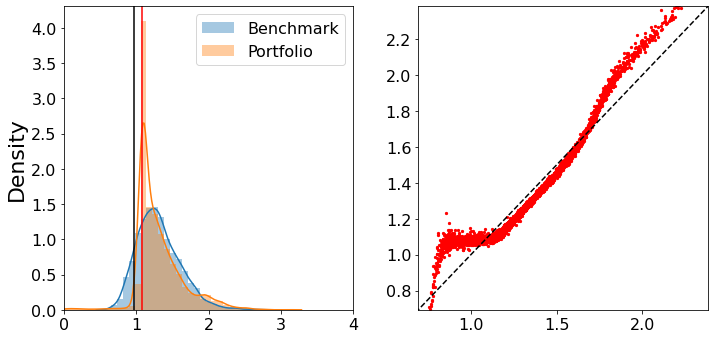

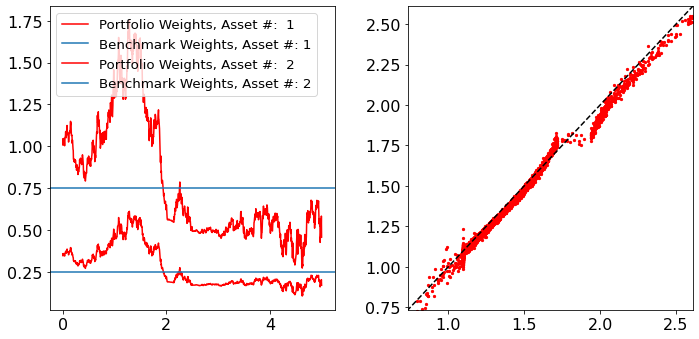

Epoch: 0 Iteration: 999  duration =  245.694  secs
Terminal Val Dist: 0.005 Wass Dist: 0.091 Budget Dist: 0.000 Risk Measure: -1.243 Loss: 0.005


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


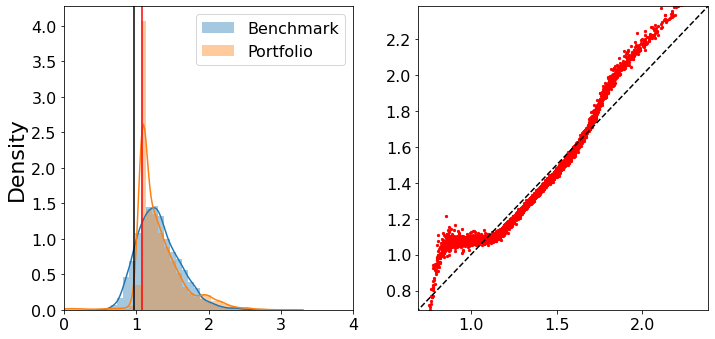

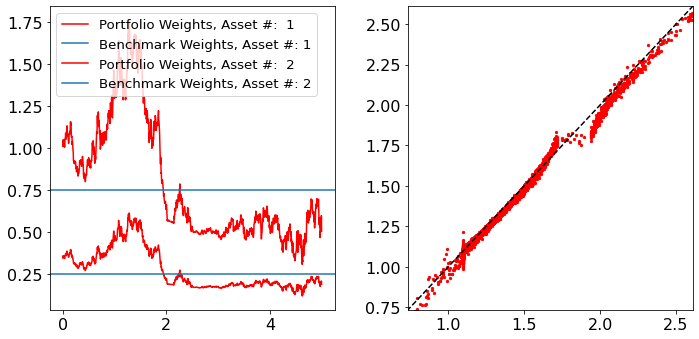

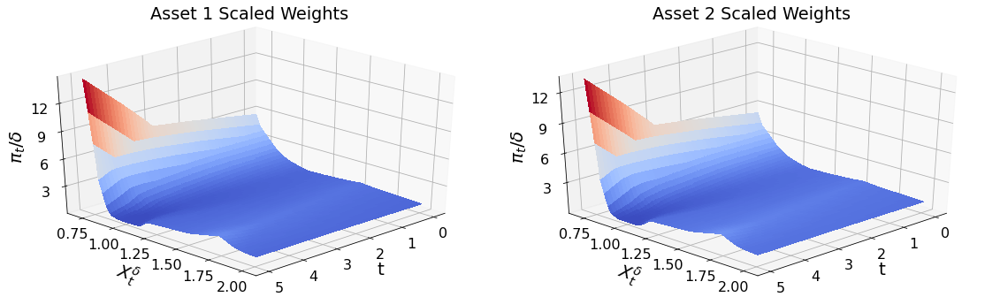

Epoch: 1 Iteration: 99  duration =  249.986  secs
Terminal Val Dist: 0.004 Wass Dist: 0.093 Budget Dist: 0.000 Risk Measure: -1.288 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


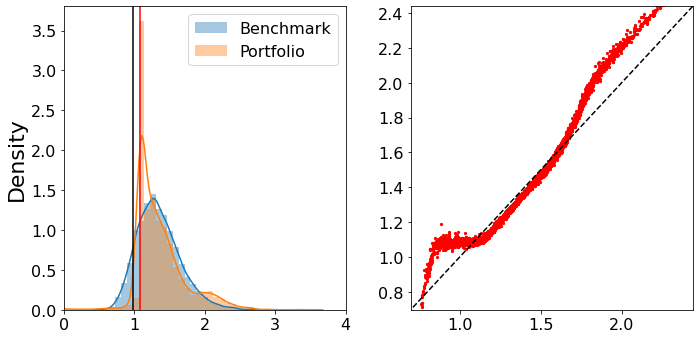

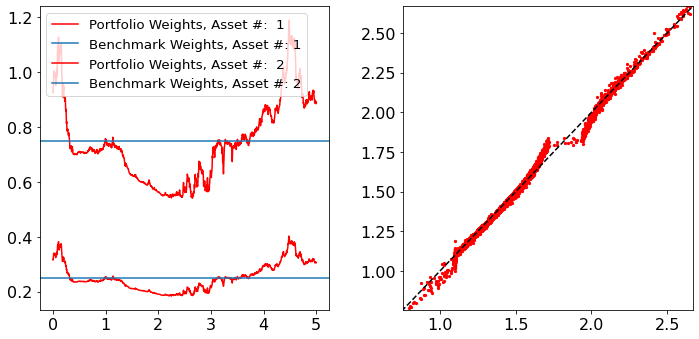

Epoch: 1 Iteration: 199  duration =  245.636  secs
Terminal Val Dist: 0.004 Wass Dist: 0.094 Budget Dist: 0.000 Risk Measure: -1.290 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


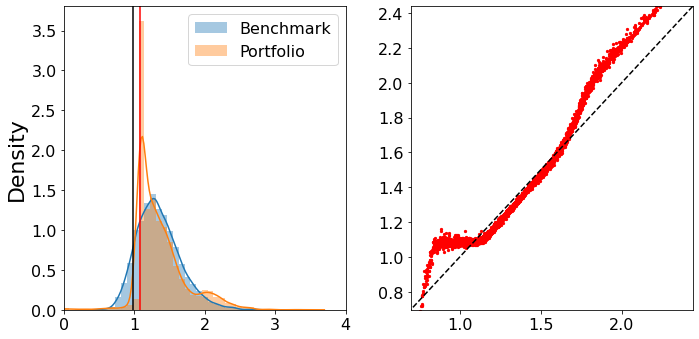

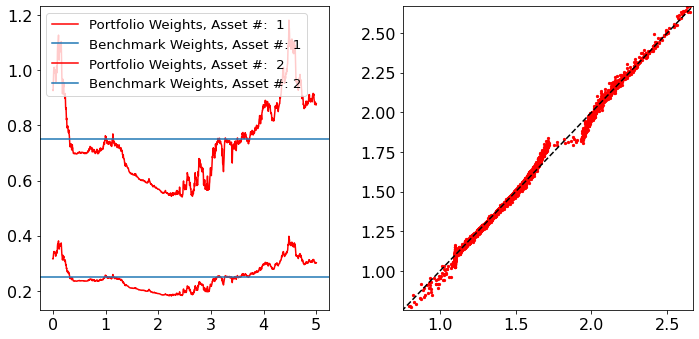

Epoch: 1 Iteration: 299  duration =  245.695  secs
Terminal Val Dist: 0.004 Wass Dist: 0.091 Budget Dist: 0.000 Risk Measure: -1.287 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


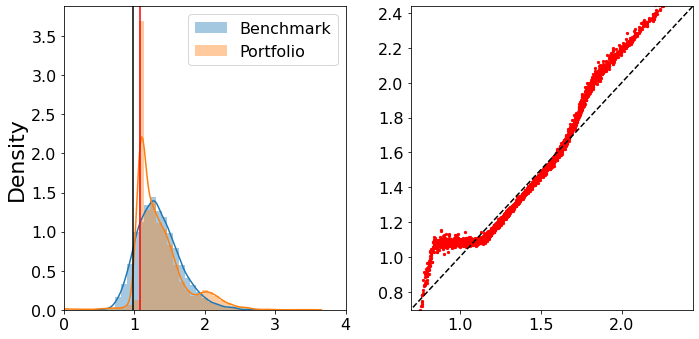

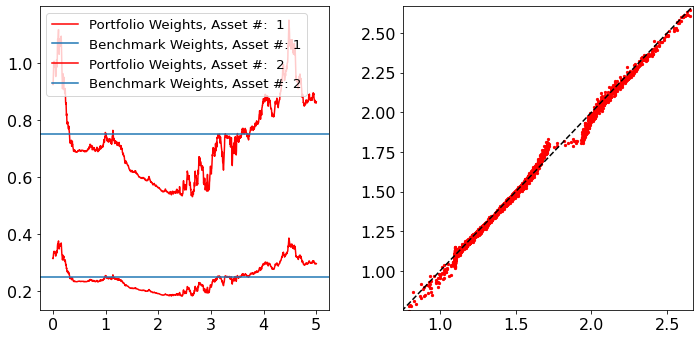

Epoch: 1 Iteration: 399  duration =  246.008  secs
Terminal Val Dist: 0.004 Wass Dist: 0.088 Budget Dist: 0.000 Risk Measure: -1.283 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


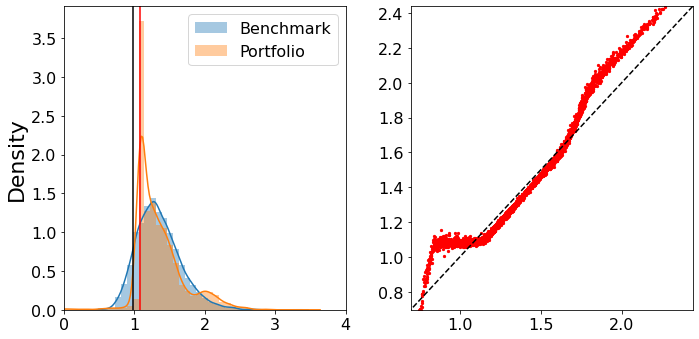

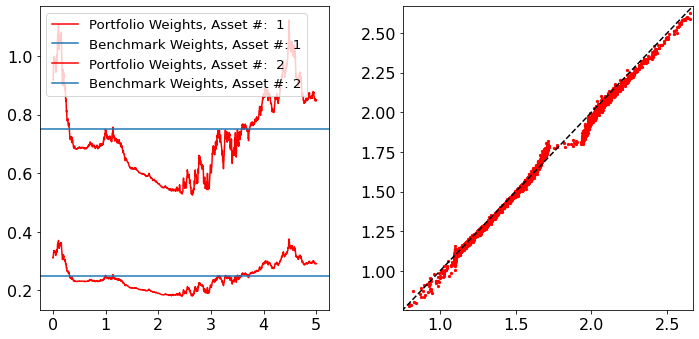

Epoch: 1 Iteration: 499  duration =  245.717  secs
Terminal Val Dist: 0.004 Wass Dist: 0.095 Budget Dist: 0.000 Risk Measure: -1.291 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


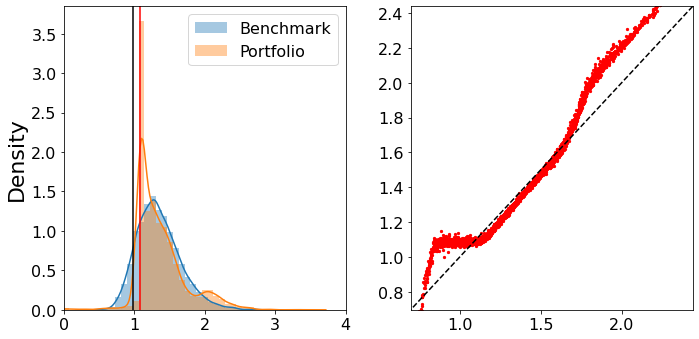

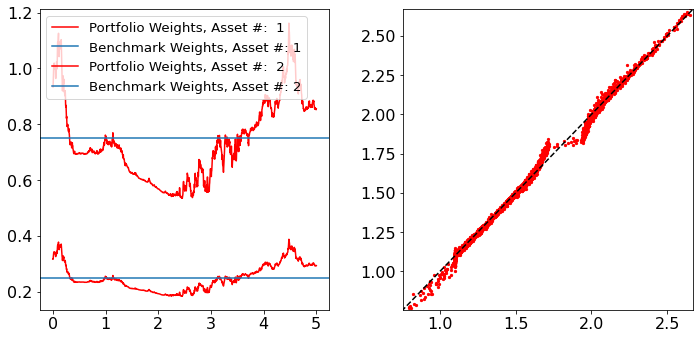

Epoch: 1 Iteration: 599  duration =  245.489  secs
Terminal Val Dist: 0.004 Wass Dist: 0.093 Budget Dist: 0.000 Risk Measure: -1.289 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


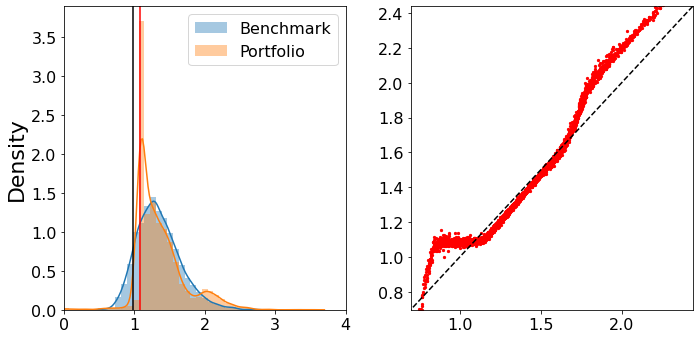

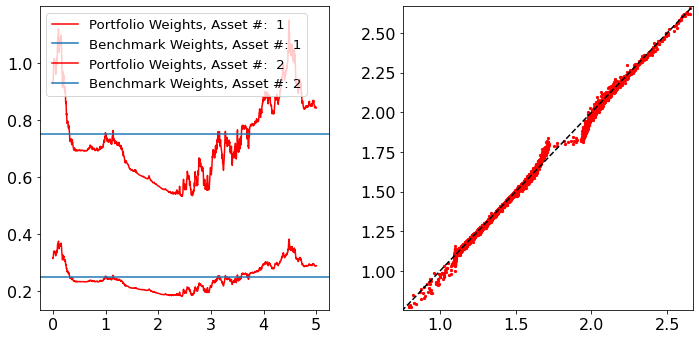

Epoch: 1 Iteration: 699  duration =  245.536  secs
Terminal Val Dist: 0.004 Wass Dist: 0.099 Budget Dist: 0.000 Risk Measure: -1.296 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


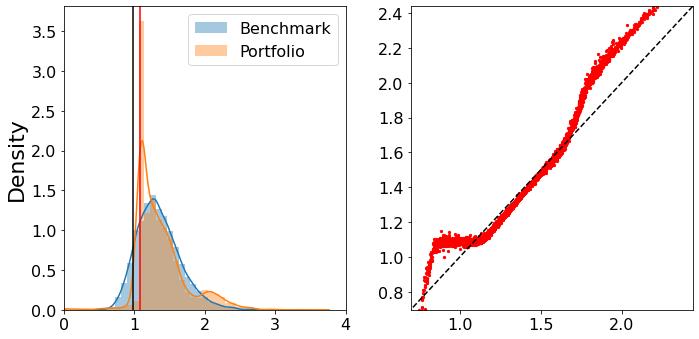

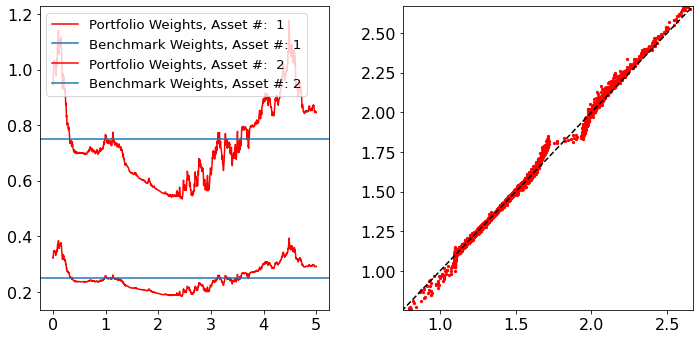

Epoch: 1 Iteration: 799  duration =  245.703  secs
Terminal Val Dist: 0.004 Wass Dist: 0.090 Budget Dist: 0.000 Risk Measure: -1.286 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


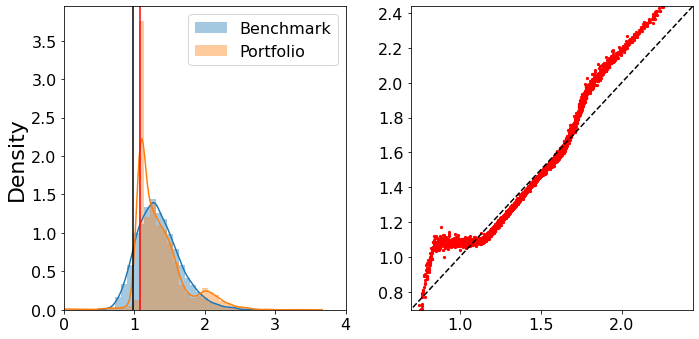

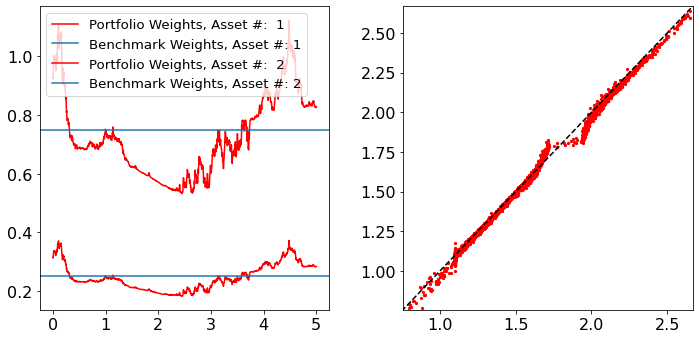

Epoch: 1 Iteration: 899  duration =  245.739  secs
Terminal Val Dist: 0.004 Wass Dist: 0.088 Budget Dist: 0.000 Risk Measure: -1.284 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


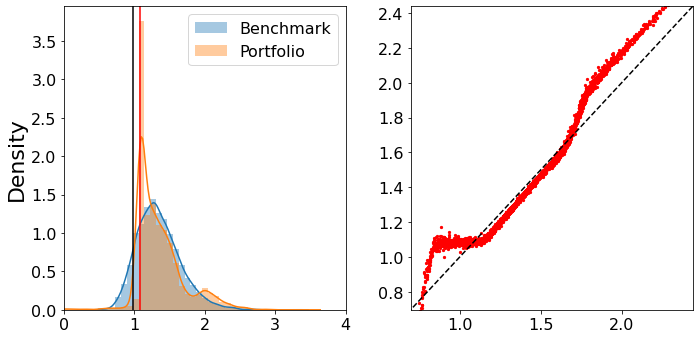

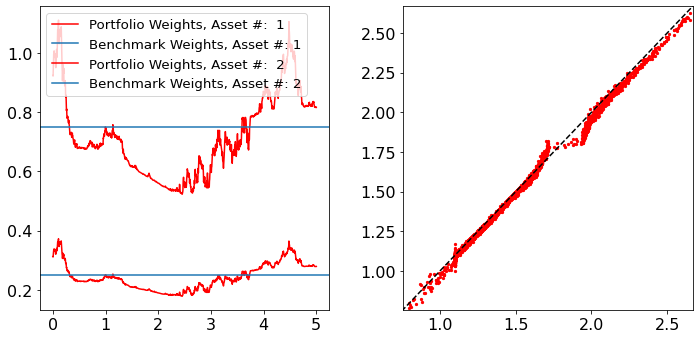

Epoch: 1 Iteration: 999  duration =  245.548  secs
Terminal Val Dist: 0.003 Wass Dist: 0.093 Budget Dist: 0.000 Risk Measure: -1.290 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


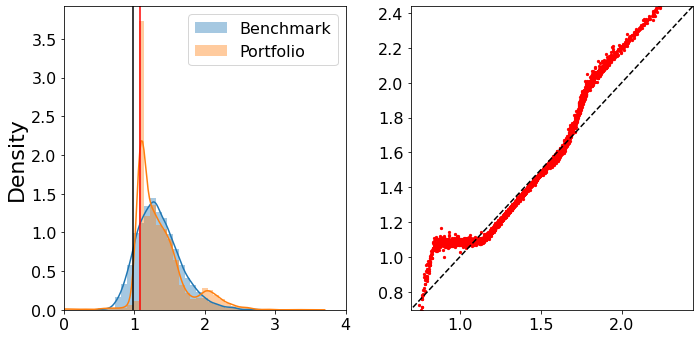

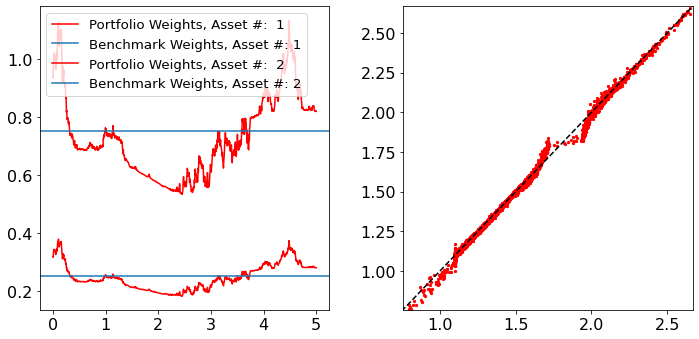

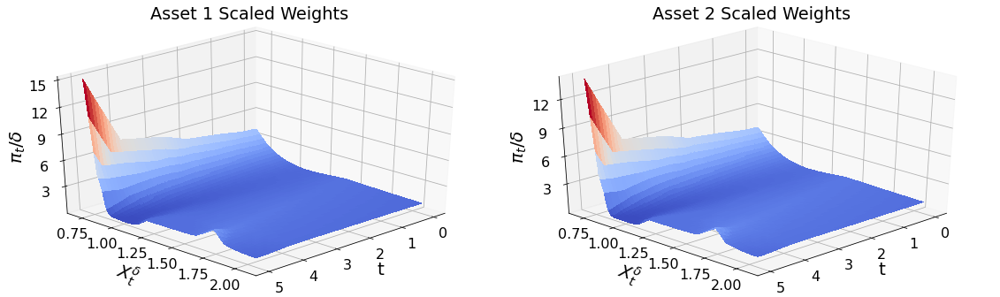

Epoch: 2 Iteration: 99  duration =  250.279  secs
Terminal Val Dist: 0.004 Wass Dist: 0.092 Budget Dist: 0.000 Risk Measure: -1.255 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


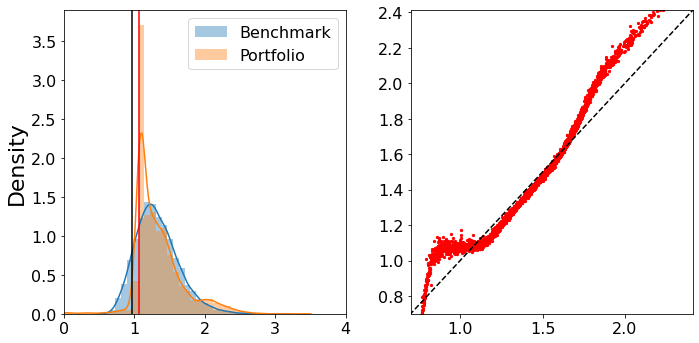

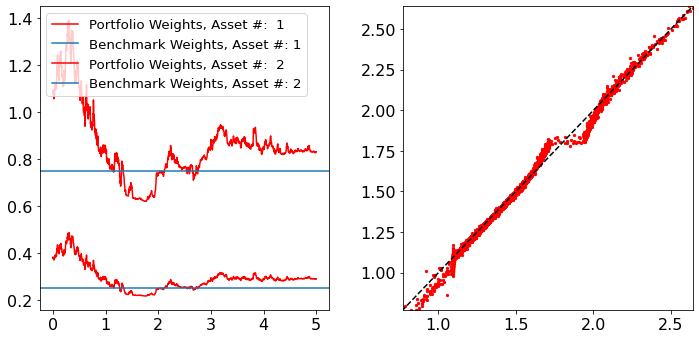

Epoch: 2 Iteration: 199  duration =  245.509  secs
Terminal Val Dist: 0.004 Wass Dist: 0.092 Budget Dist: 0.000 Risk Measure: -1.256 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


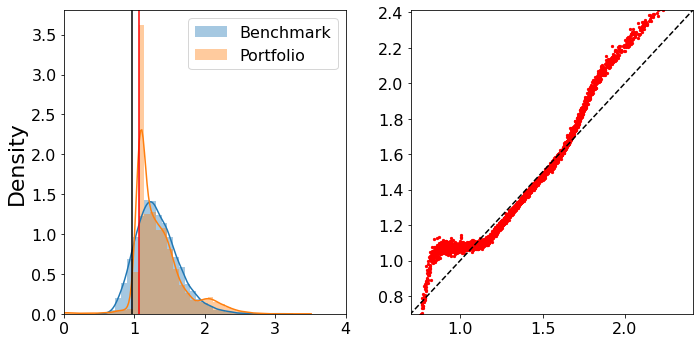

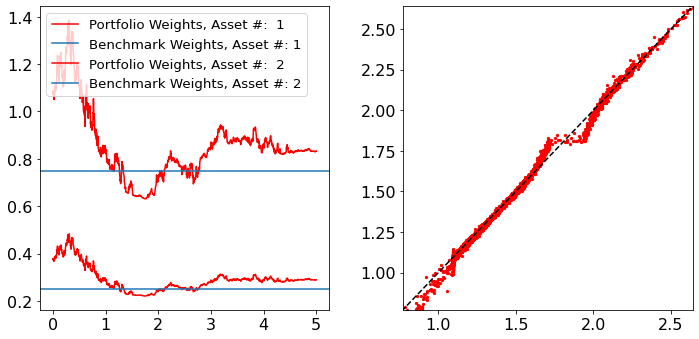

Epoch: 2 Iteration: 299  duration =  245.808  secs
Terminal Val Dist: 0.004 Wass Dist: 0.096 Budget Dist: 0.000 Risk Measure: -1.259 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


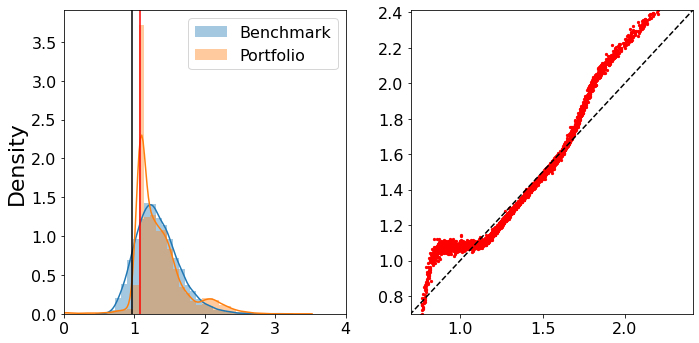

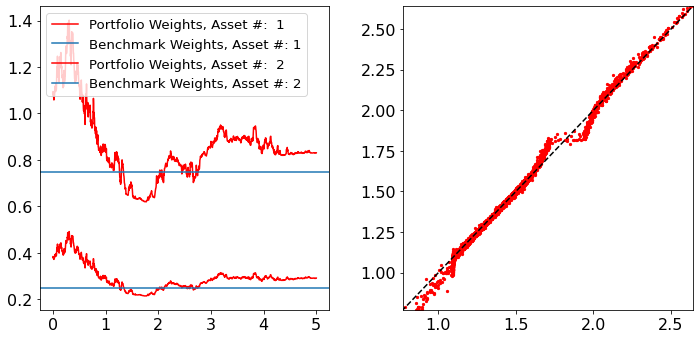

Epoch: 2 Iteration: 399  duration =  245.561  secs
Terminal Val Dist: 0.004 Wass Dist: 0.091 Budget Dist: -0.000 Risk Measure: -1.254 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


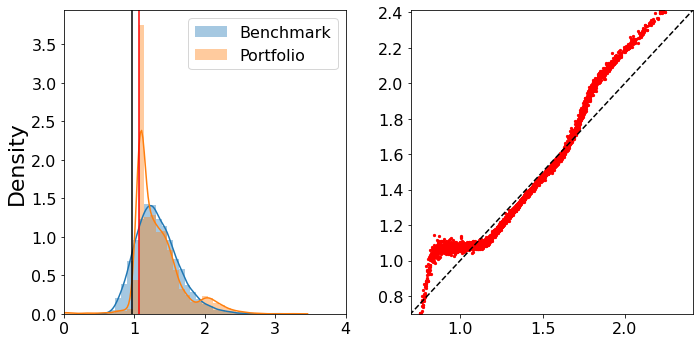

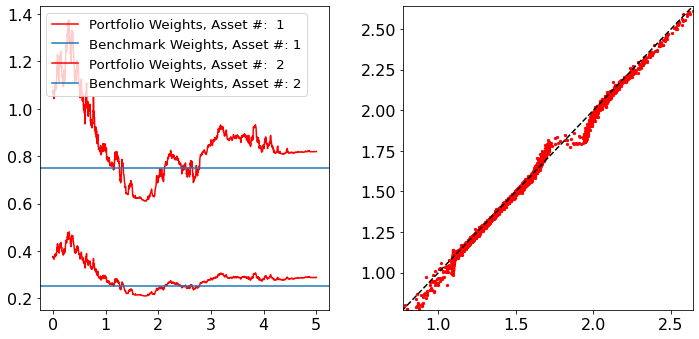

Epoch: 2 Iteration: 499  duration =  245.873  secs
Terminal Val Dist: 0.004 Wass Dist: 0.093 Budget Dist: 0.000 Risk Measure: -1.257 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


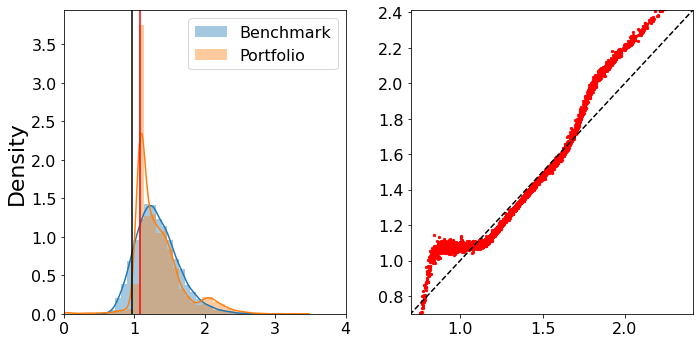

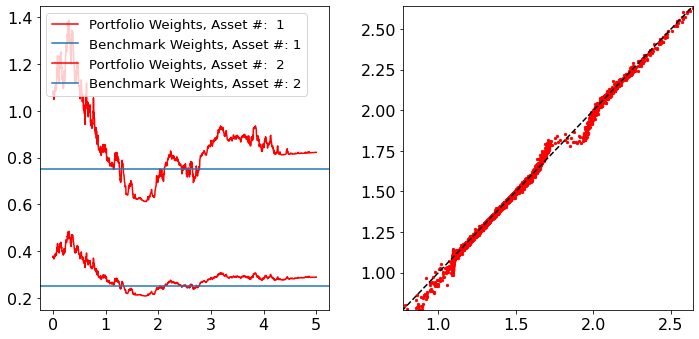

Epoch: 2 Iteration: 599  duration =  245.756  secs
Terminal Val Dist: 0.004 Wass Dist: 0.090 Budget Dist: 0.000 Risk Measure: -1.253 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


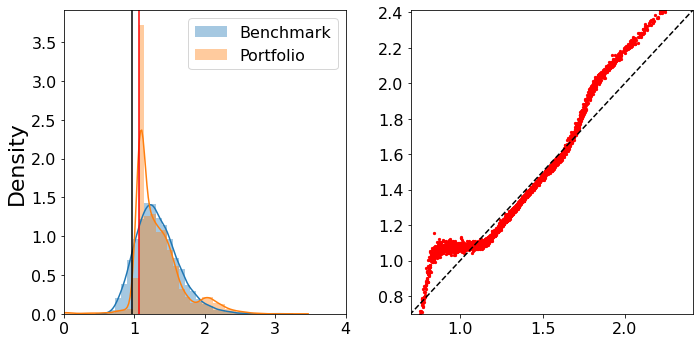

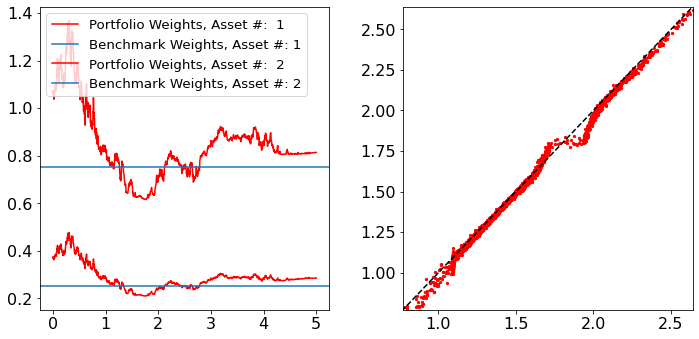

Epoch: 2 Iteration: 699  duration =  245.564  secs
Terminal Val Dist: 0.003 Wass Dist: 0.092 Budget Dist: 0.000 Risk Measure: -1.255 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


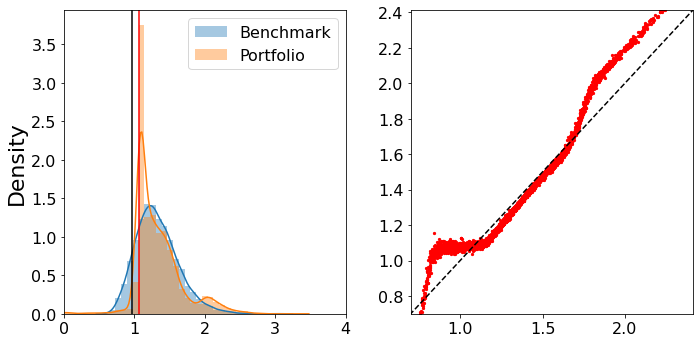

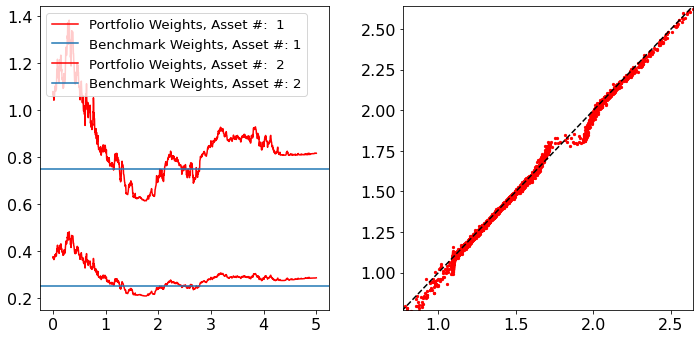

Epoch: 2 Iteration: 799  duration =  245.527  secs
Terminal Val Dist: 0.004 Wass Dist: 0.089 Budget Dist: 0.000 Risk Measure: -1.251 Loss: 0.004


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


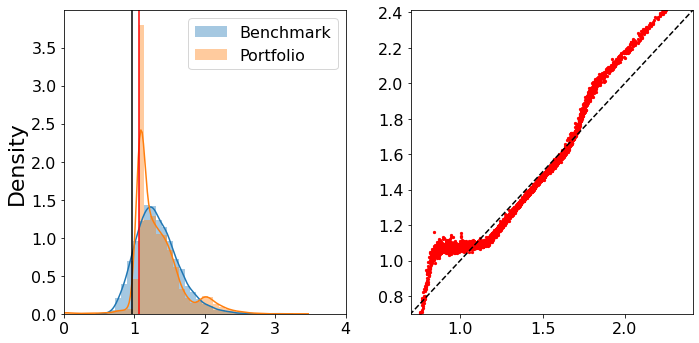

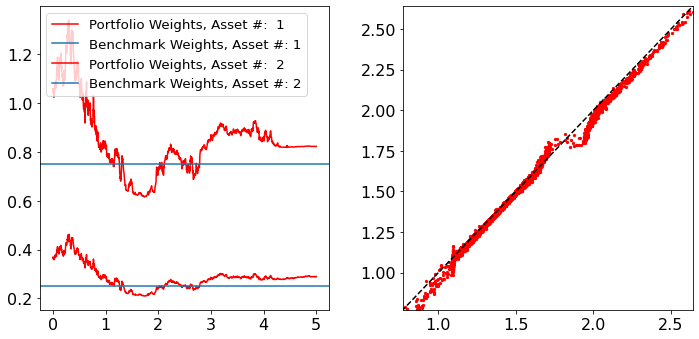

Epoch: 2 Iteration: 899  duration =  245.712  secs
Terminal Val Dist: 0.003 Wass Dist: 0.094 Budget Dist: 0.000 Risk Measure: -1.259 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


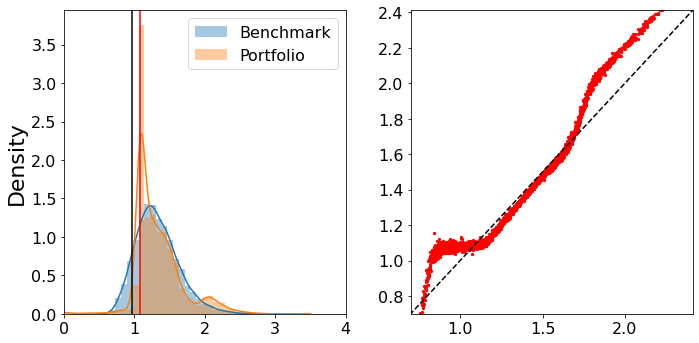

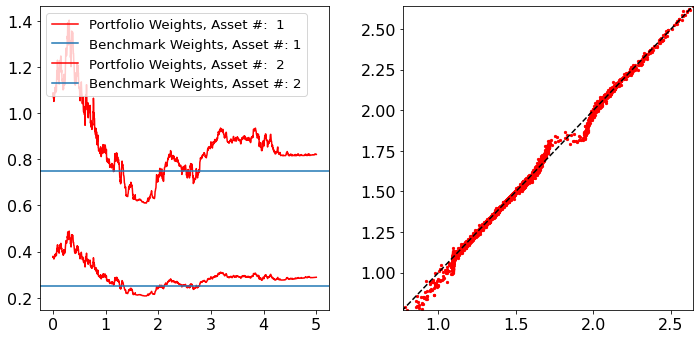

Epoch: 2 Iteration: 999  duration =  245.564  secs
Terminal Val Dist: 0.003 Wass Dist: 0.094 Budget Dist: 0.000 Risk Measure: -1.258 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


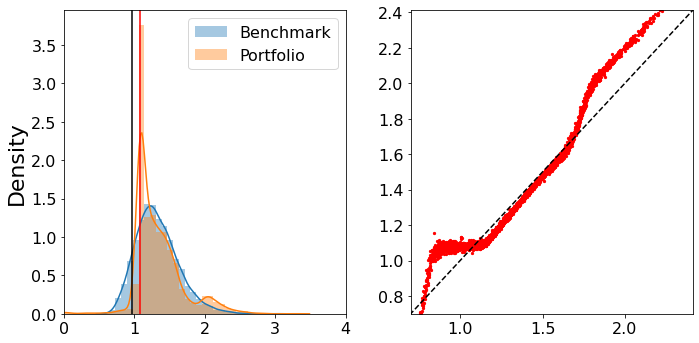

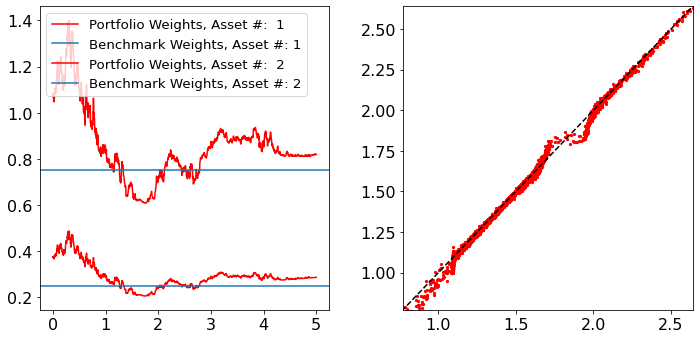

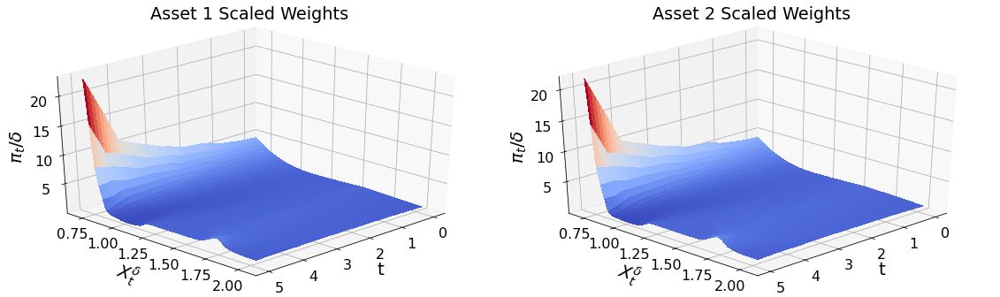

Epoch: 3 Iteration: 99  duration =  249.858  secs
Terminal Val Dist: 0.003 Wass Dist: 0.098 Budget Dist: 0.000 Risk Measure: -1.301 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


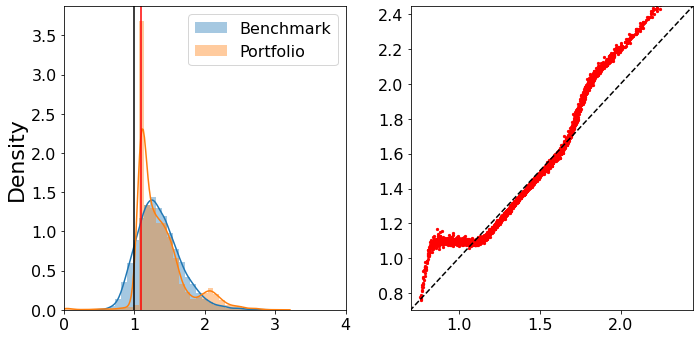

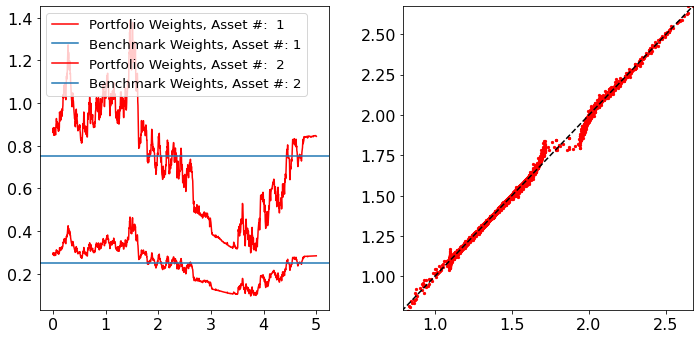

Epoch: 3 Iteration: 199  duration =  245.574  secs
Terminal Val Dist: 0.003 Wass Dist: 0.098 Budget Dist: 0.000 Risk Measure: -1.301 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


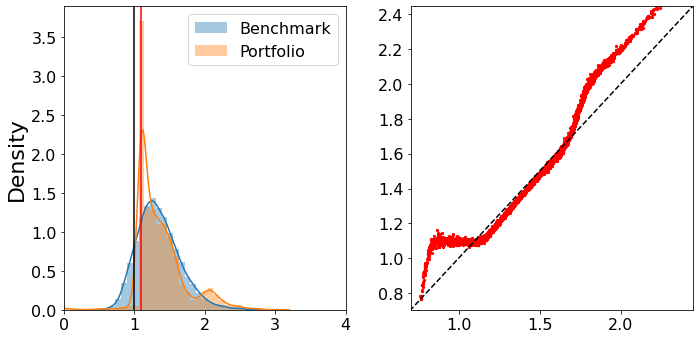

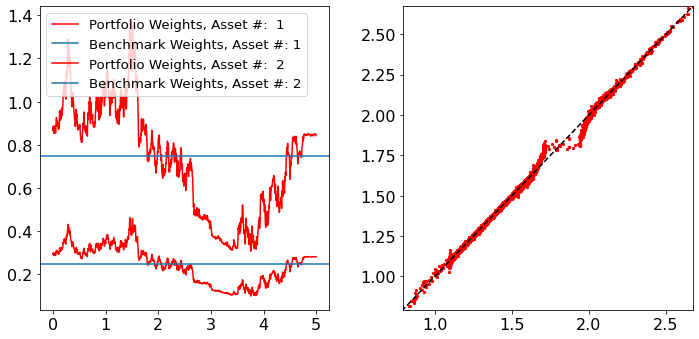

Epoch: 3 Iteration: 299  duration =  245.685  secs
Terminal Val Dist: 0.003 Wass Dist: 0.098 Budget Dist: 0.000 Risk Measure: -1.302 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


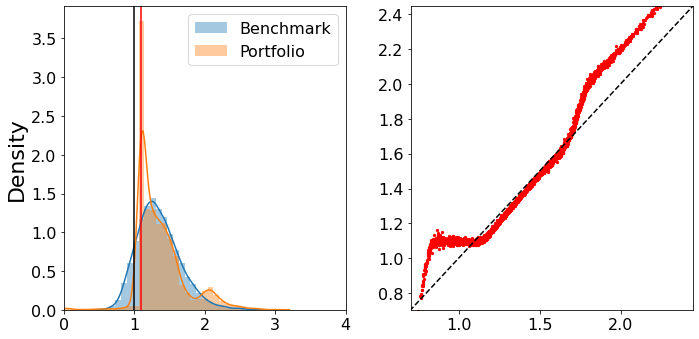

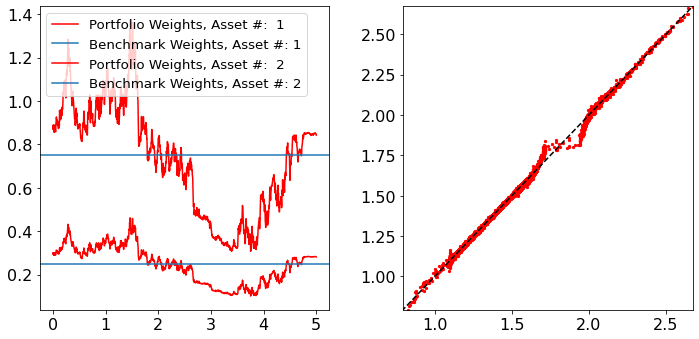

Epoch: 3 Iteration: 399  duration =  245.367  secs
Terminal Val Dist: 0.003 Wass Dist: 0.098 Budget Dist: 0.000 Risk Measure: -1.302 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


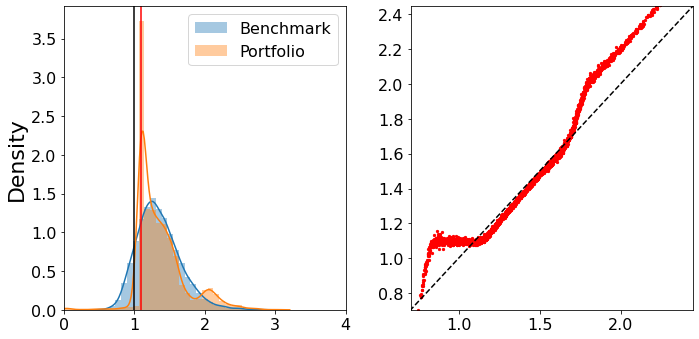

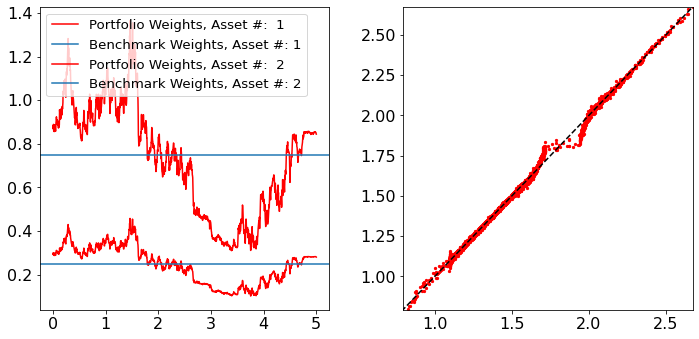

Epoch: 3 Iteration: 499  duration =  245.362  secs
Terminal Val Dist: 0.003 Wass Dist: 0.095 Budget Dist: 0.000 Risk Measure: -1.298 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


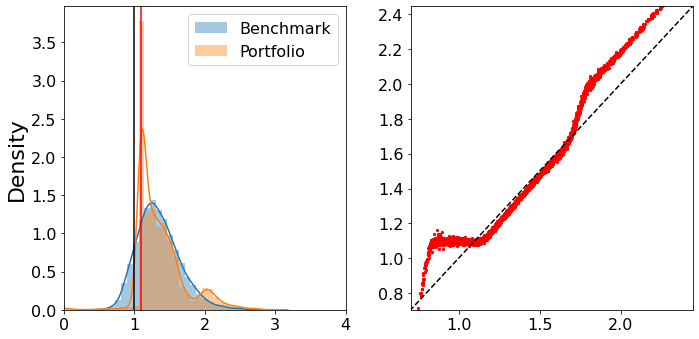

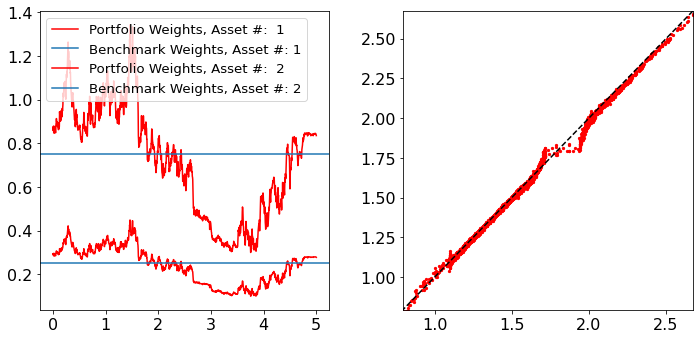

Epoch: 3 Iteration: 599  duration =  245.676  secs
Terminal Val Dist: 0.003 Wass Dist: 0.102 Budget Dist: 0.000 Risk Measure: -1.306 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


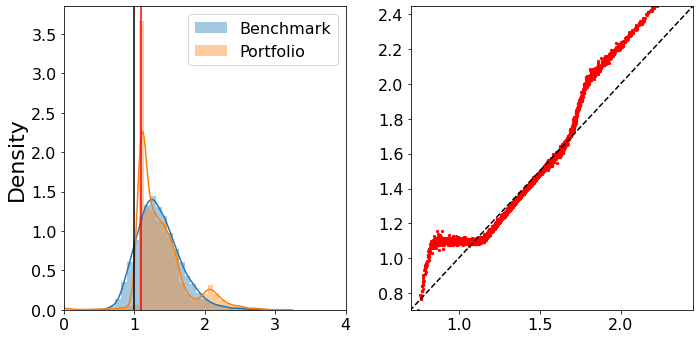

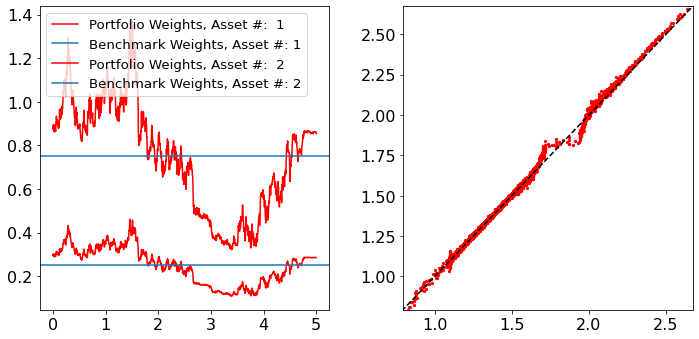

Epoch: 3 Iteration: 699  duration =  245.521  secs
Terminal Val Dist: 0.003 Wass Dist: 0.096 Budget Dist: 0.000 Risk Measure: -1.300 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


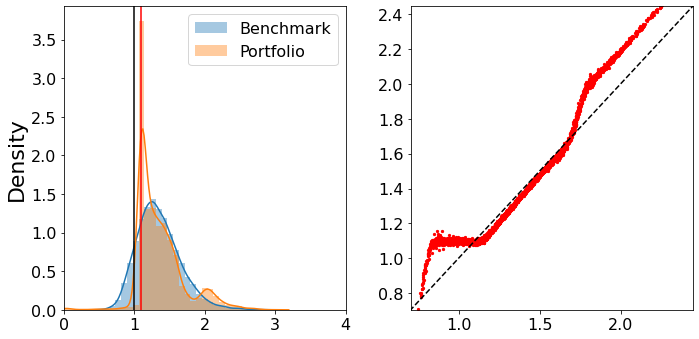

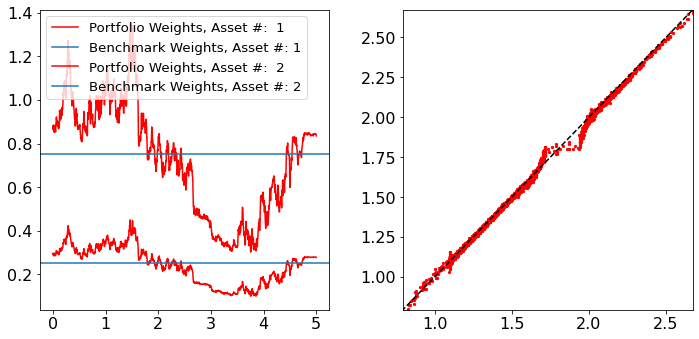

Epoch: 3 Iteration: 799  duration =  245.705  secs
Terminal Val Dist: 0.003 Wass Dist: 0.100 Budget Dist: 0.000 Risk Measure: -1.305 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


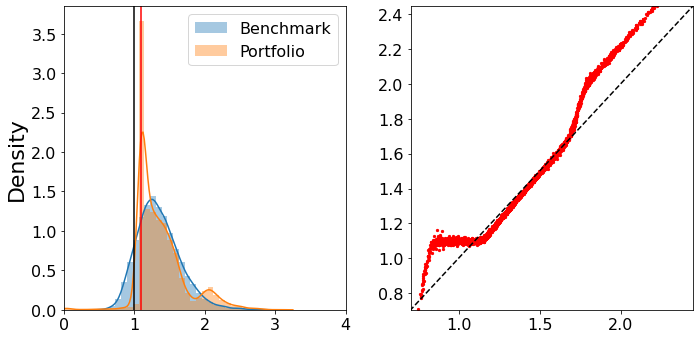

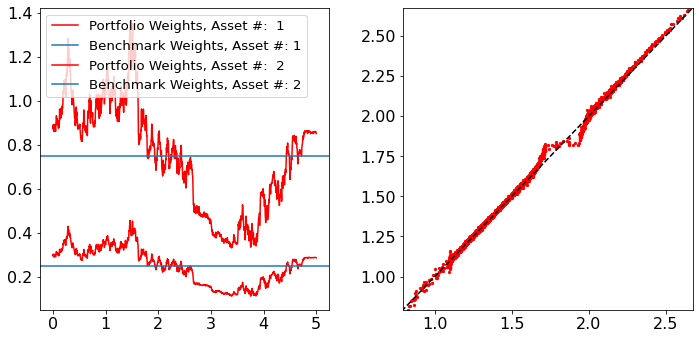

Epoch: 3 Iteration: 899  duration =  245.282  secs
Terminal Val Dist: 0.002 Wass Dist: 0.099 Budget Dist: 0.000 Risk Measure: -1.303 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


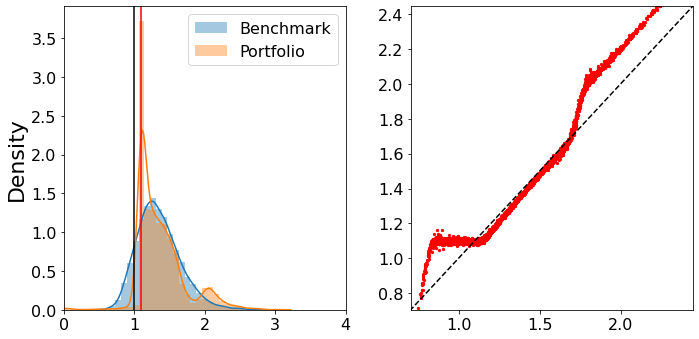

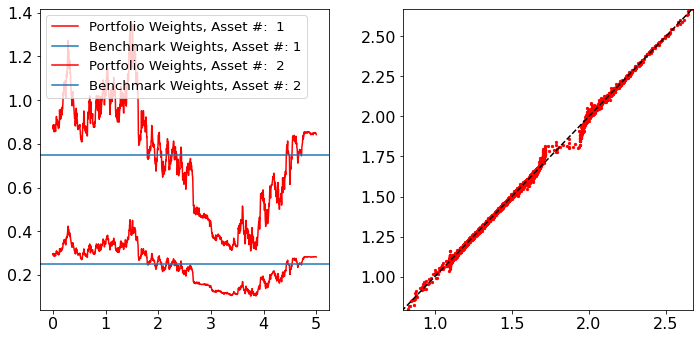

Epoch: 3 Iteration: 999  duration =  245.285  secs
Terminal Val Dist: 0.006 Wass Dist: 0.102 Budget Dist: 0.000 Risk Measure: -1.300 Loss: 0.006


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


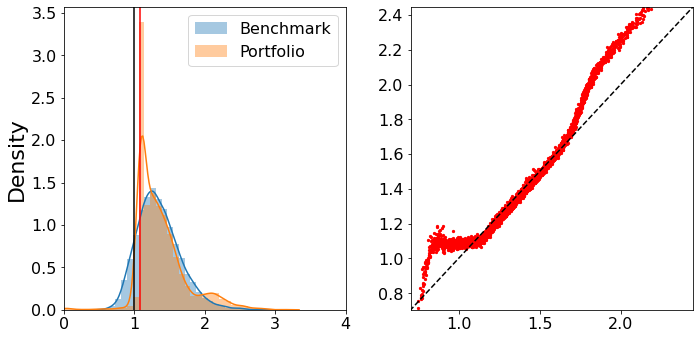

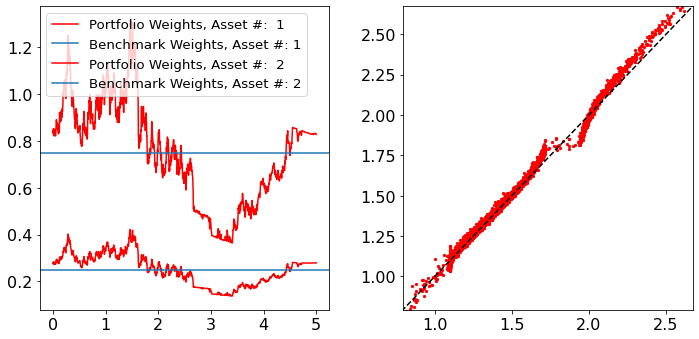

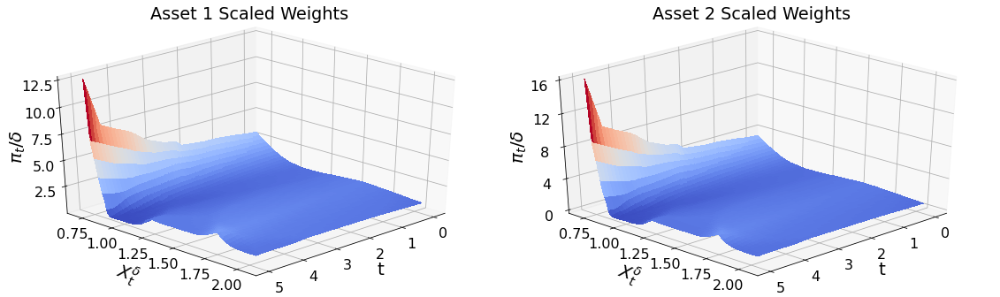

Epoch: 4 Iteration: 99  duration =  249.463  secs
Terminal Val Dist: 0.002 Wass Dist: 0.095 Budget Dist: 0.000 Risk Measure: -1.277 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


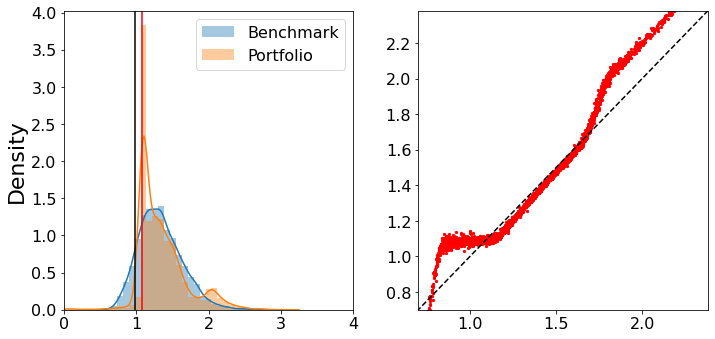

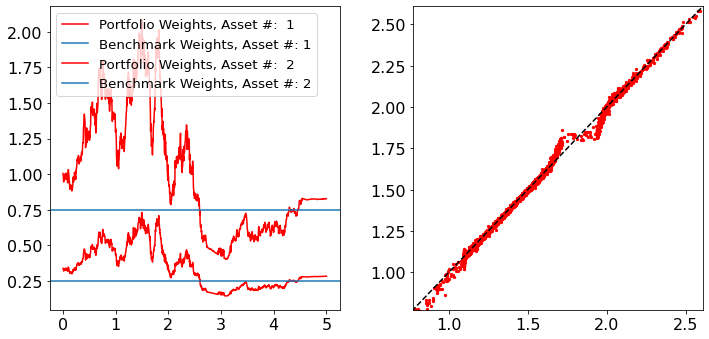

Epoch: 4 Iteration: 199  duration =  245.180  secs
Terminal Val Dist: 0.002 Wass Dist: 0.097 Budget Dist: 0.000 Risk Measure: -1.279 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


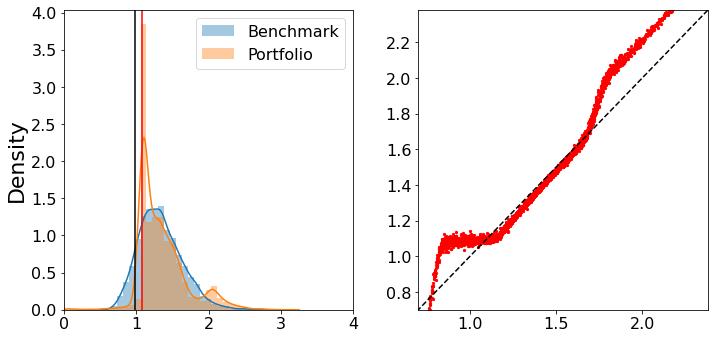

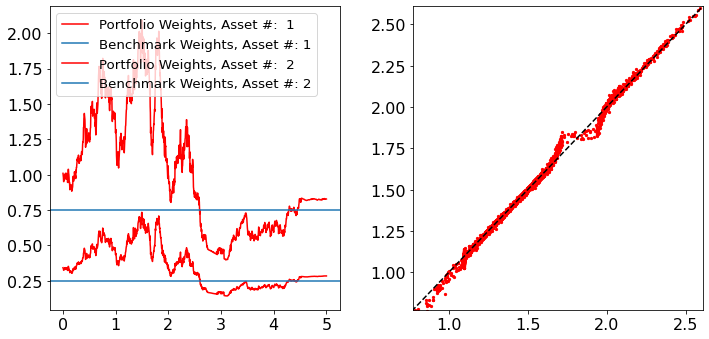

Epoch: 4 Iteration: 299  duration =  245.401  secs
Terminal Val Dist: 0.002 Wass Dist: 0.096 Budget Dist: 0.000 Risk Measure: -1.279 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


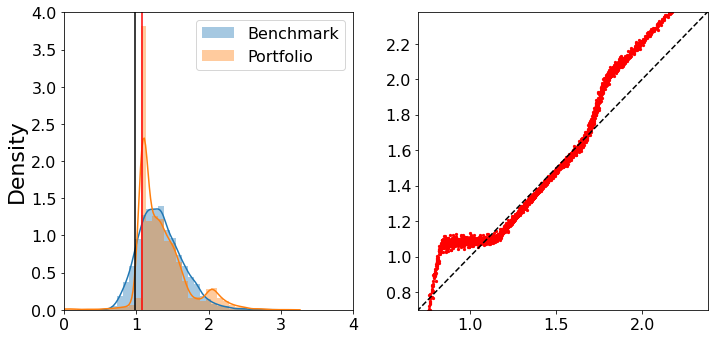

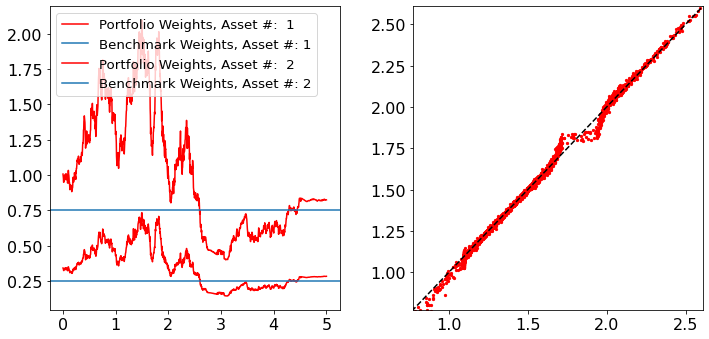

Epoch: 4 Iteration: 399  duration =  245.038  secs
Terminal Val Dist: 0.003 Wass Dist: 0.091 Budget Dist: 0.000 Risk Measure: -1.273 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


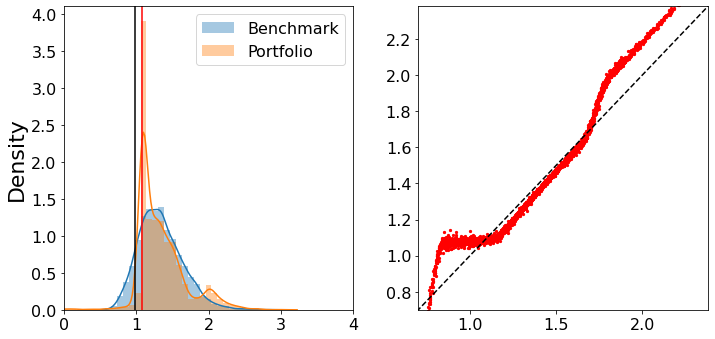

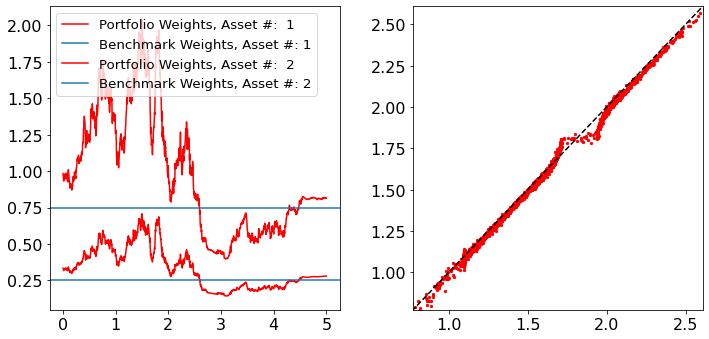

Epoch: 4 Iteration: 499  duration =  245.085  secs
Terminal Val Dist: 0.002 Wass Dist: 0.094 Budget Dist: 0.000 Risk Measure: -1.276 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


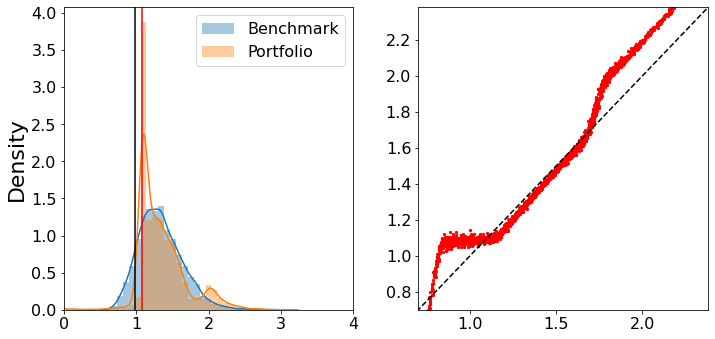

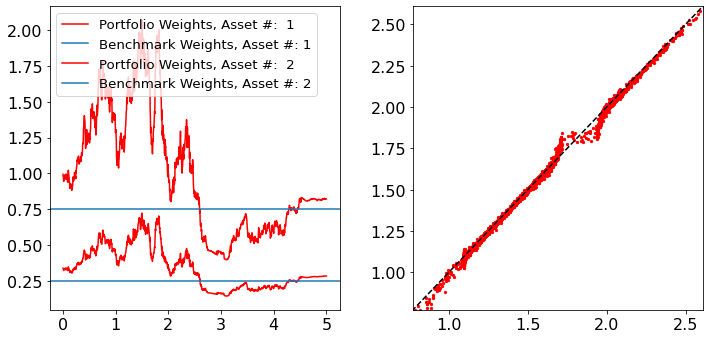

Epoch: 4 Iteration: 599  duration =  245.369  secs
Terminal Val Dist: 0.002 Wass Dist: 0.095 Budget Dist: 0.000 Risk Measure: -1.278 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


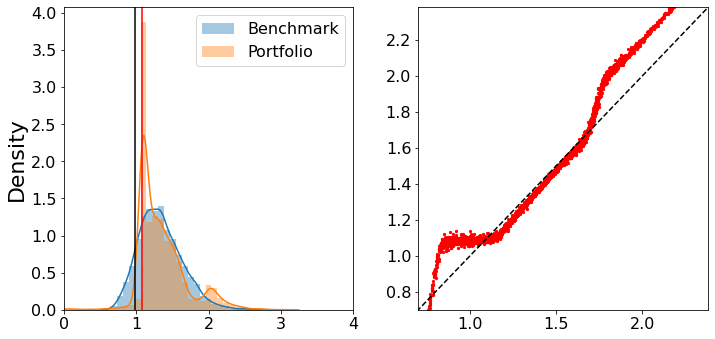

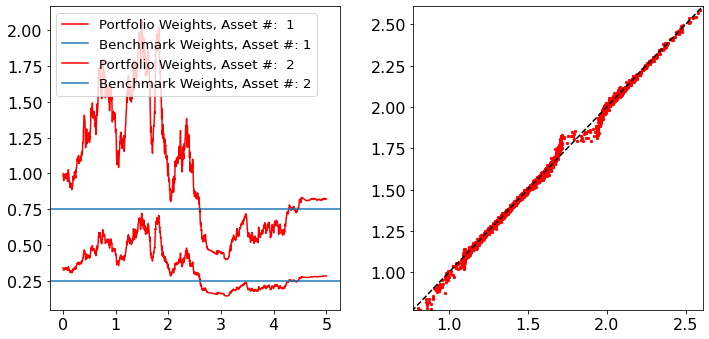

Epoch: 4 Iteration: 699  duration =  245.411  secs
Terminal Val Dist: 0.002 Wass Dist: 0.099 Budget Dist: 0.000 Risk Measure: -1.282 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


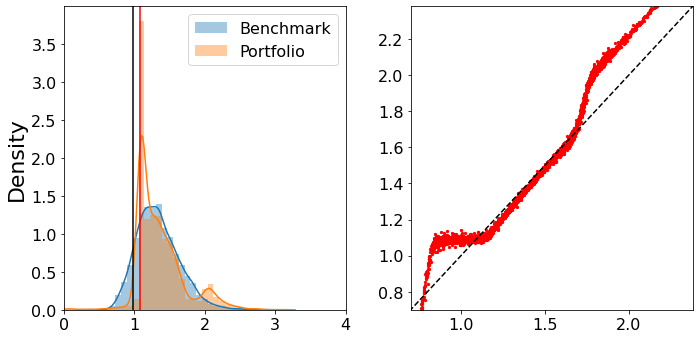

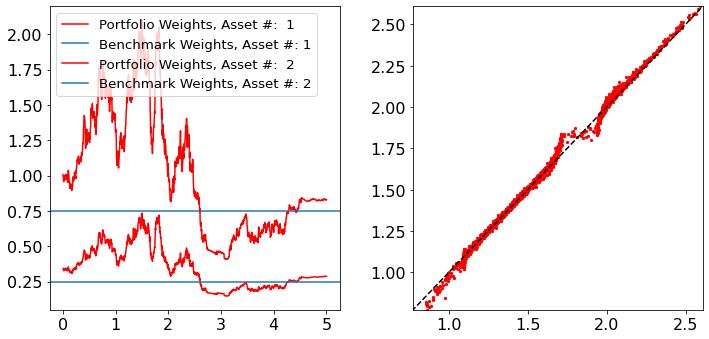

Epoch: 4 Iteration: 799  duration =  245.137  secs
Terminal Val Dist: 0.002 Wass Dist: 0.096 Budget Dist: 0.000 Risk Measure: -1.279 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


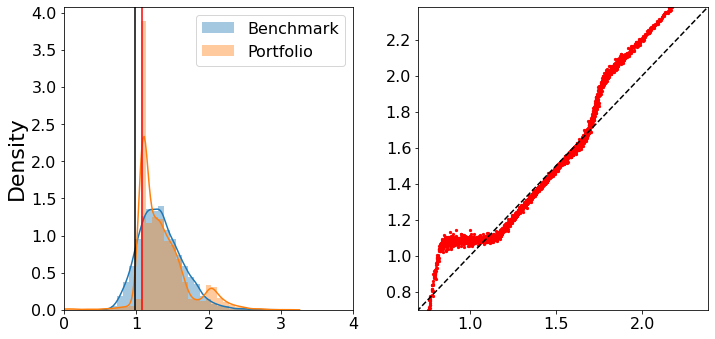

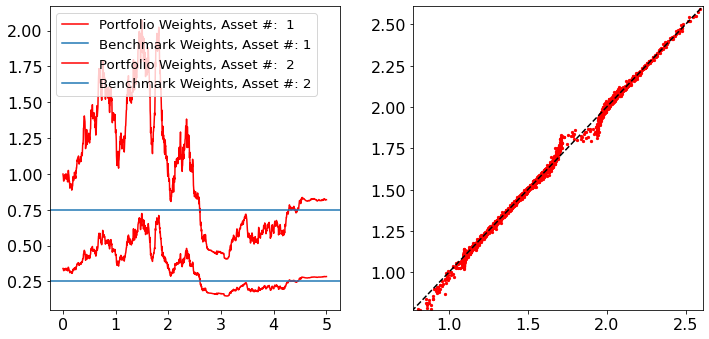

Epoch: 4 Iteration: 899  duration =  245.165  secs
Terminal Val Dist: 0.002 Wass Dist: 0.091 Budget Dist: -0.000 Risk Measure: -1.274 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


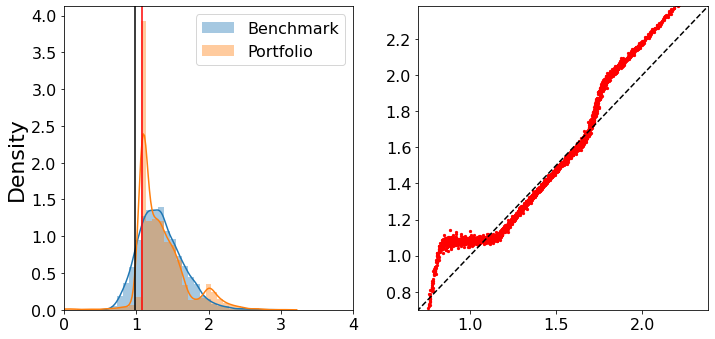

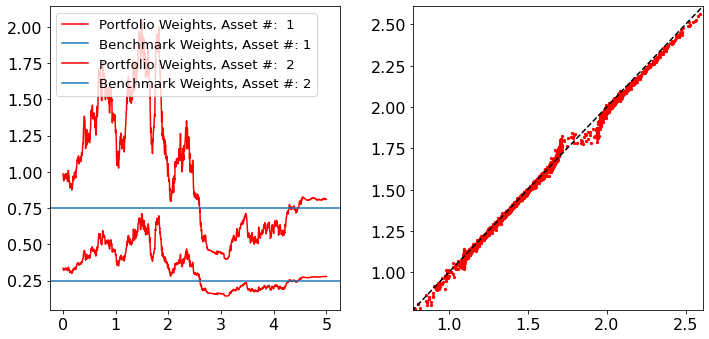

Epoch: 4 Iteration: 999  duration =  245.118  secs
Terminal Val Dist: 0.002 Wass Dist: 0.100 Budget Dist: 0.000 Risk Measure: -1.283 Loss: 0.002


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


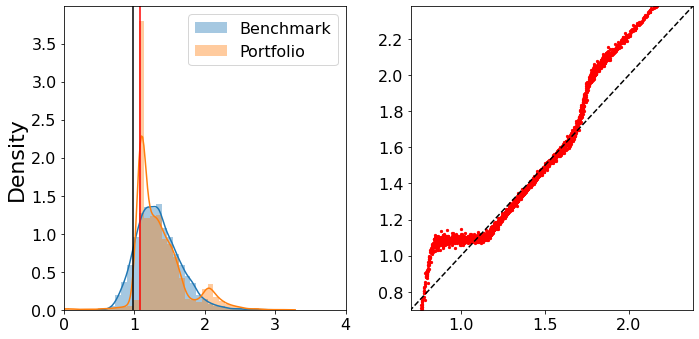

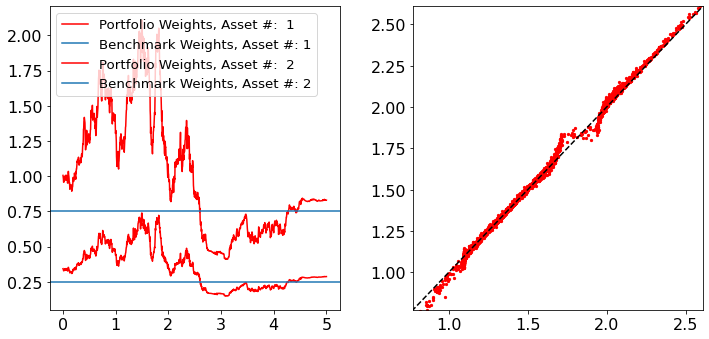

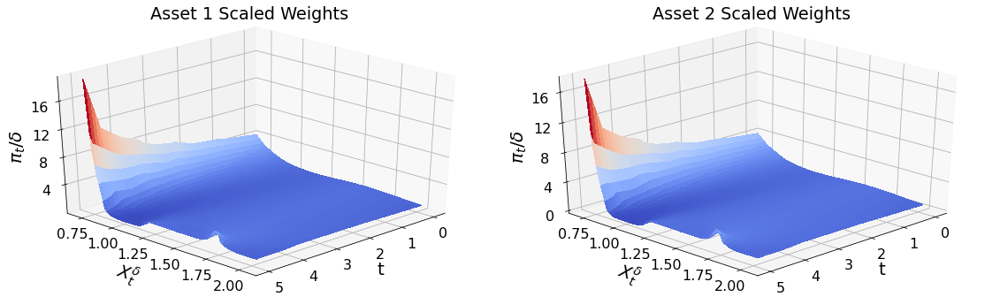

Epoch: 5 Iteration: 99  duration =  249.482  secs
Terminal Val Dist: 0.003 Wass Dist: 0.096 Budget Dist: 0.000 Risk Measure: -1.246 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


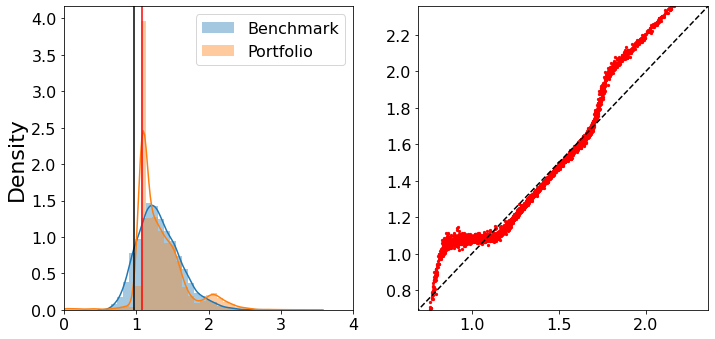

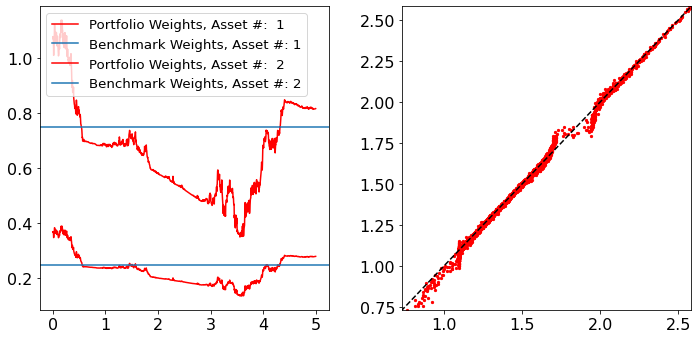

Epoch: 5 Iteration: 199  duration =  245.251  secs
Terminal Val Dist: 0.003 Wass Dist: 0.096 Budget Dist: 0.000 Risk Measure: -1.247 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


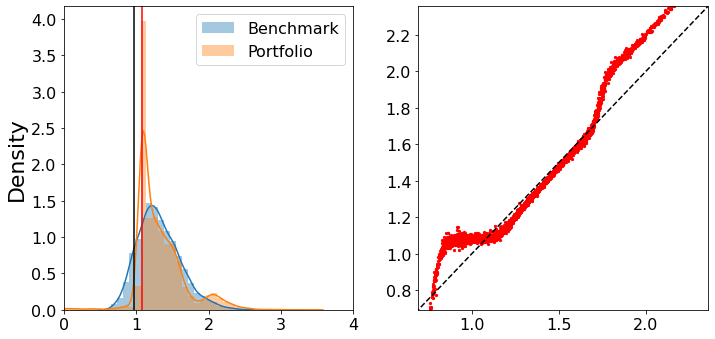

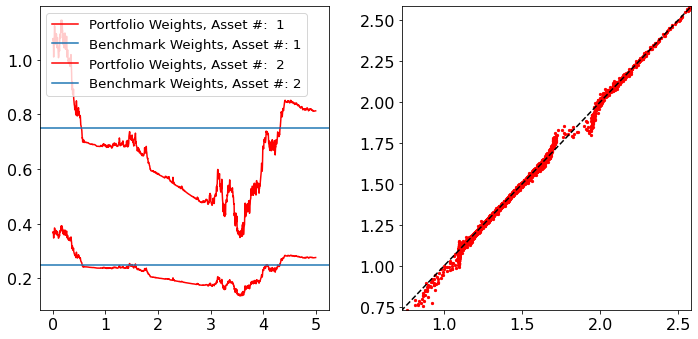

Epoch: 5 Iteration: 299  duration =  244.960  secs
Terminal Val Dist: 0.003 Wass Dist: 0.098 Budget Dist: 0.000 Risk Measure: -1.249 Loss: 0.003


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


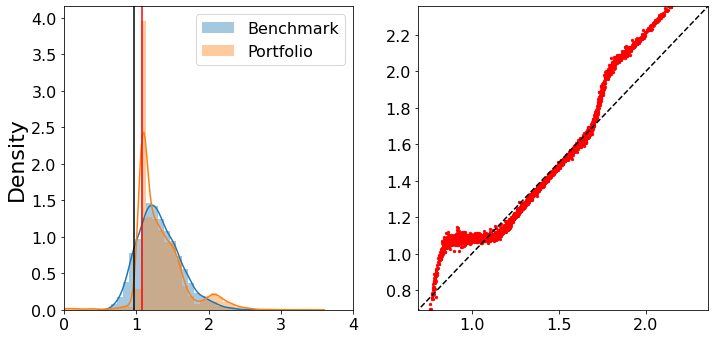

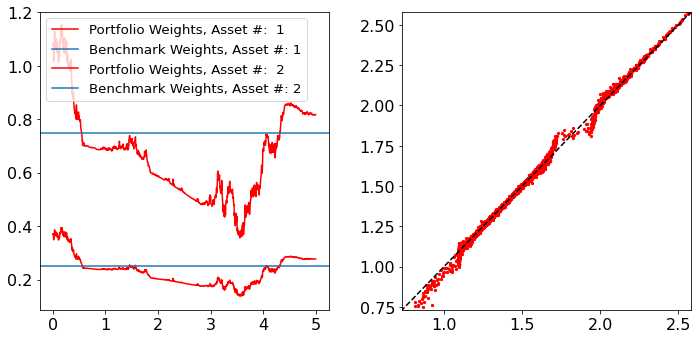

KeyboardInterrupt: ignored

In [ ]:
value_net = ValueNet(50).to(device)
model_name = "ValueNet_Standard.pt"
value_net.load_state_dict(torch.load(root_dir + model_name))

port_net = PortNet(50, 2).to(device)
model_name = "PortNet_Standard.pt"
T = 5
Ndt = 252*T
Nsims = 5000
Nepochs = 100
Train_PortNet(value_net, port_net, model_name, params_MV,  Ndt, T, Nsims, Nepochs, Path_Type == "continuous")

## Comonotonic Distortion

### Part 1

Epoch: 0 Iteration: 4998  duration =  66.900  secs
Budget Dist: -0.010 Wass Dist: 0.102 Risk Measure: -1.322 Loss: -1.320


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


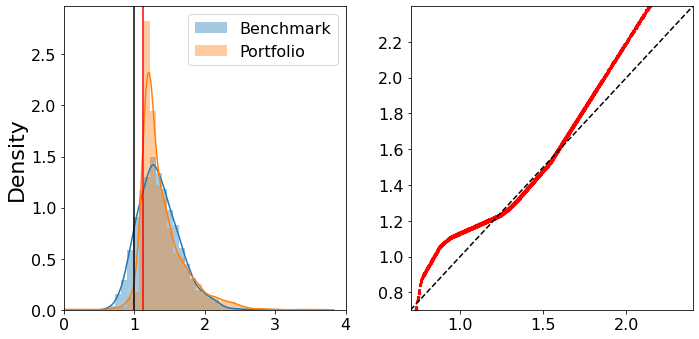

Epoch: 0 Iteration: 9997  duration =  65.503  secs
Budget Dist: -0.006 Wass Dist: 0.102 Risk Measure: -1.325 Loss: -1.322


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


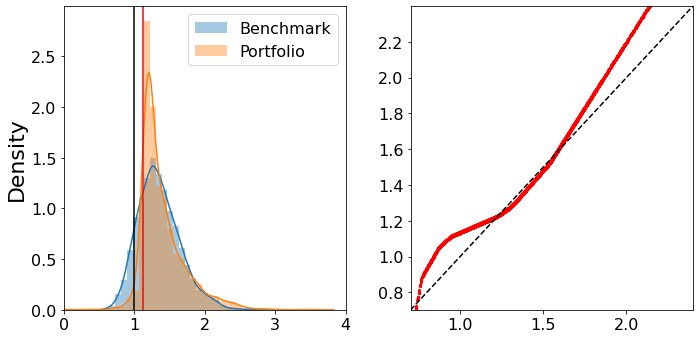

Epoch: 1 Iteration: 4998  duration =  67.890  secs
Budget Dist: 0.011 Wass Dist: 0.107 Risk Measure: -1.313 Loss: -1.293


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


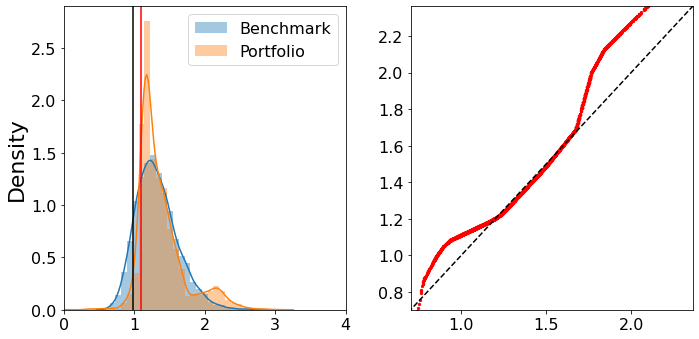

Epoch: 1 Iteration: 9997  duration =  65.870  secs
Budget Dist: -0.002 Wass Dist: 0.107 Risk Measure: -1.308 Loss: -1.299


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


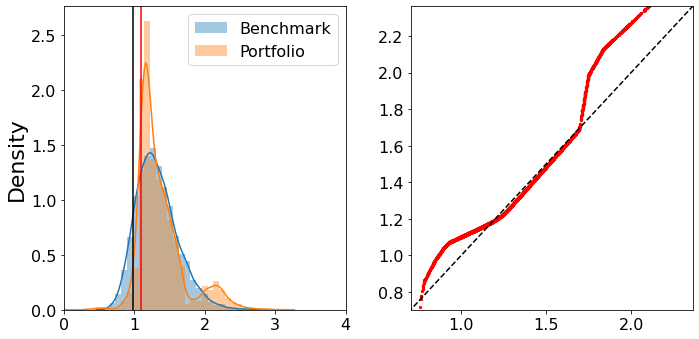

Epoch: 2 Iteration: 4998  duration =  67.876  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.306 Loss: -1.303


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


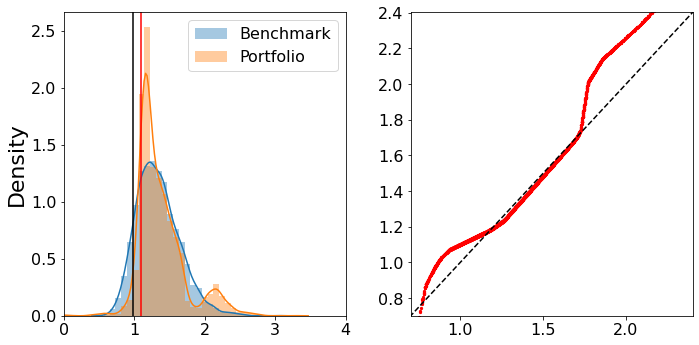

Epoch: 2 Iteration: 9997  duration =  65.917  secs
Budget Dist: 0.004 Wass Dist: 0.107 Risk Measure: -1.313 Loss: -1.300


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


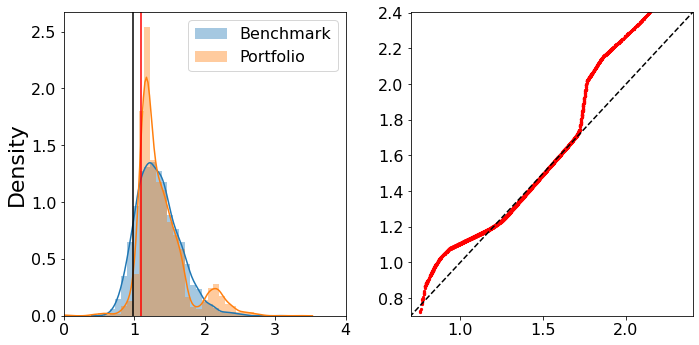

Epoch: 3 Iteration: 4998  duration =  67.935  secs
Budget Dist: -0.003 Wass Dist: 0.100 Risk Measure: -1.305 Loss: -1.305


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


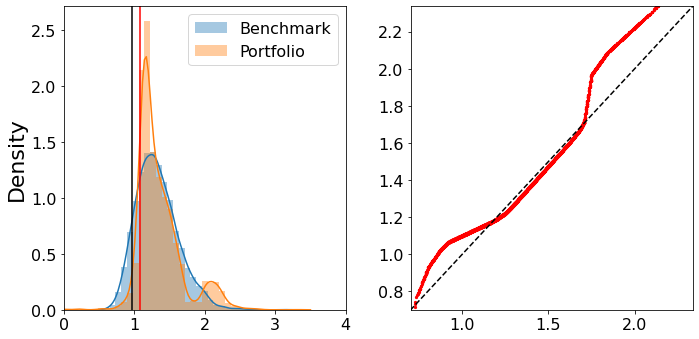

Epoch: 3 Iteration: 9997  duration =  65.955  secs
Budget Dist: -0.001 Wass Dist: 0.103 Risk Measure: -1.312 Loss: -1.308


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


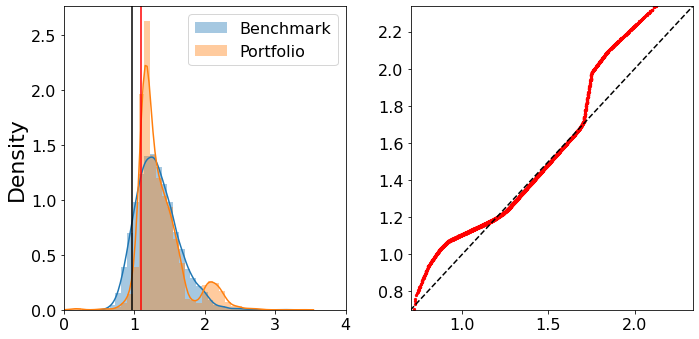

Epoch: 4 Iteration: 4998  duration =  67.981  secs
Budget Dist: -0.001 Wass Dist: 0.104 Risk Measure: -1.335 Loss: -1.330


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


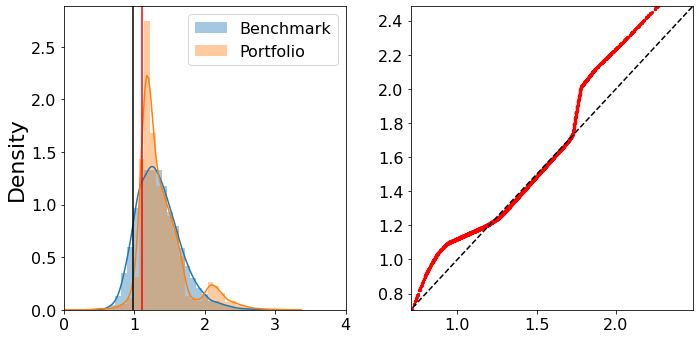

Epoch: 4 Iteration: 9997  duration =  65.930  secs
Budget Dist: 0.000 Wass Dist: 0.104 Risk Measure: -1.337 Loss: -1.332


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


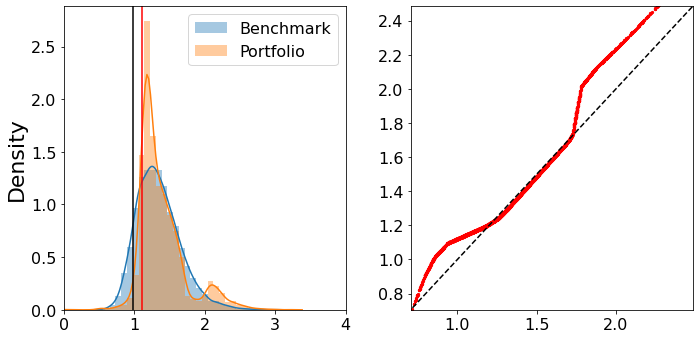

Finished Training


In [ ]:
net = ValueNet(50).to(device)
model_name = "ValueNet_Distortion.pt"
T = 5
Ndt = 252*T
Nsims = 5000
Nepochs = 5
Train_ValueNet(net, model_name, params_MV,  Ndt, T, Nsims, Nepochs, Update = "distortion")

## Copula Backprop

### Part 1

Epoch: 0 Iteration: 4998  duration =  36.016  secs
Budget Dist: -0.004 Wass Dist: 0.104 Risk Measure: -1.203 Loss: -1.194


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


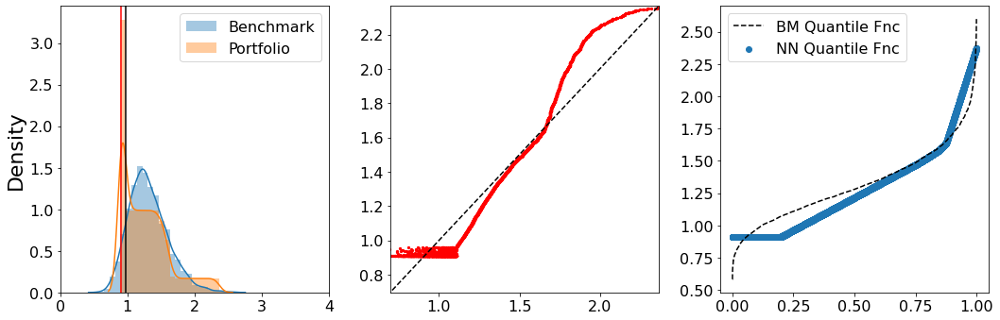

Epoch: 0 Iteration: 9997  duration =  24.383  secs
Budget Dist: -0.001 Wass Dist: 0.102 Risk Measure: -1.205 Loss: -1.201


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


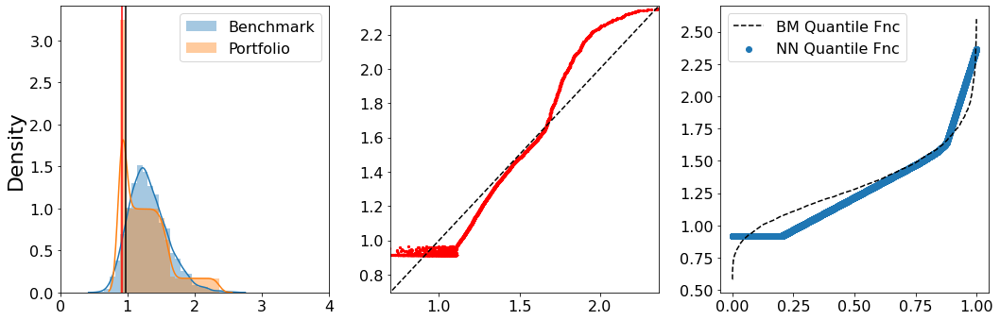

Epoch: 1 Iteration: 4998  duration =  37.315  secs
Budget Dist: 0.000 Wass Dist: 0.106 Risk Measure: -1.215 Loss: -1.201


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


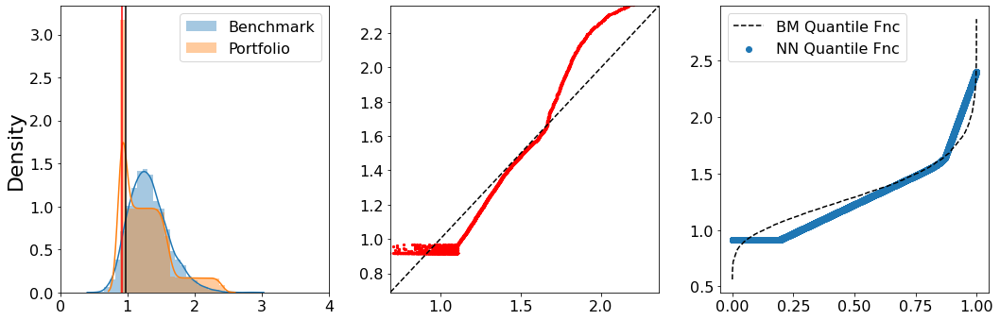

Epoch: 1 Iteration: 9997  duration =  24.661  secs
Budget Dist: -0.000 Wass Dist: 0.103 Risk Measure: -1.212 Loss: -1.206


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


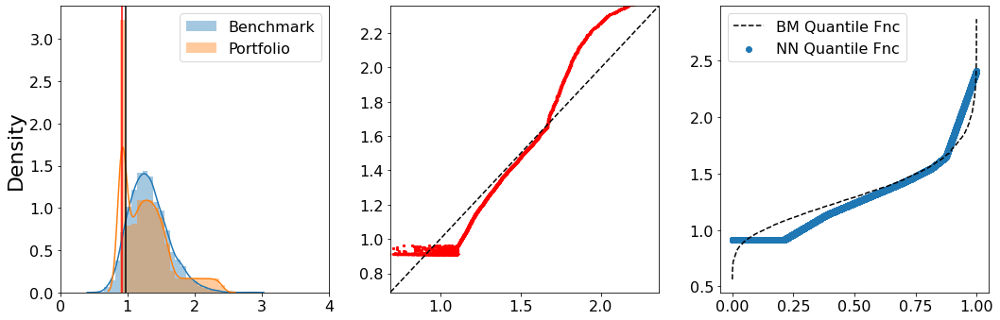

Epoch: 2 Iteration: 4998  duration =  37.192  secs
Budget Dist: -0.002 Wass Dist: 0.100 Risk Measure: -1.206 Loss: -1.206


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


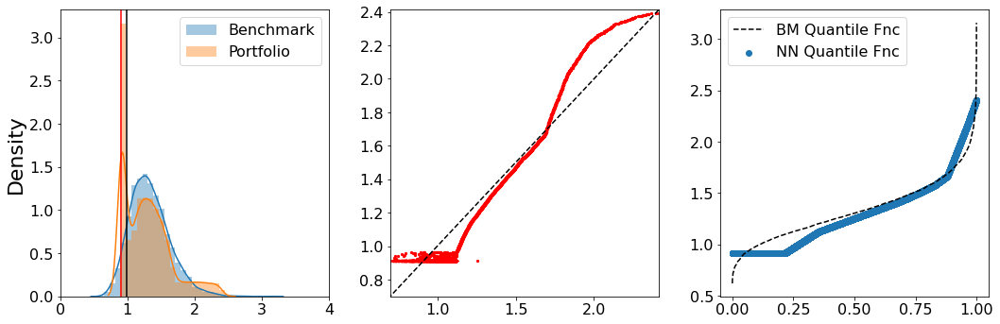

Epoch: 2 Iteration: 9997  duration =  24.698  secs
Budget Dist: -0.004 Wass Dist: 0.099 Risk Measure: -1.204 Loss: -1.204


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


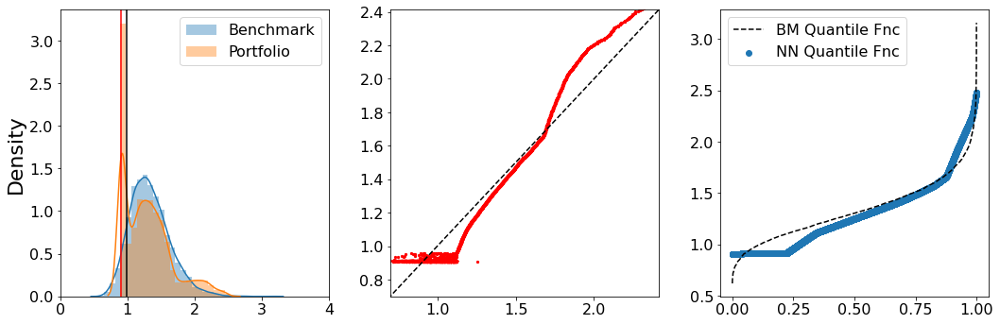

Epoch: 3 Iteration: 4998  duration =  37.337  secs
Budget Dist: -0.004 Wass Dist: 0.100 Risk Measure: -1.207 Loss: -1.207


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


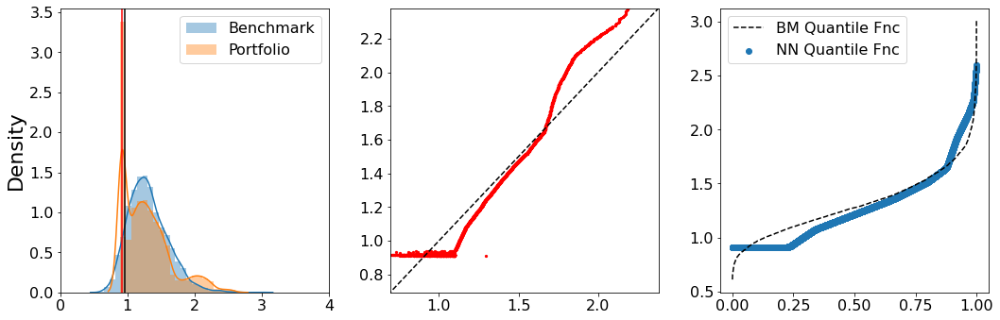

Epoch: 3 Iteration: 9997  duration =  24.944  secs
Budget Dist: 0.003 Wass Dist: 0.099 Risk Measure: -1.215 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


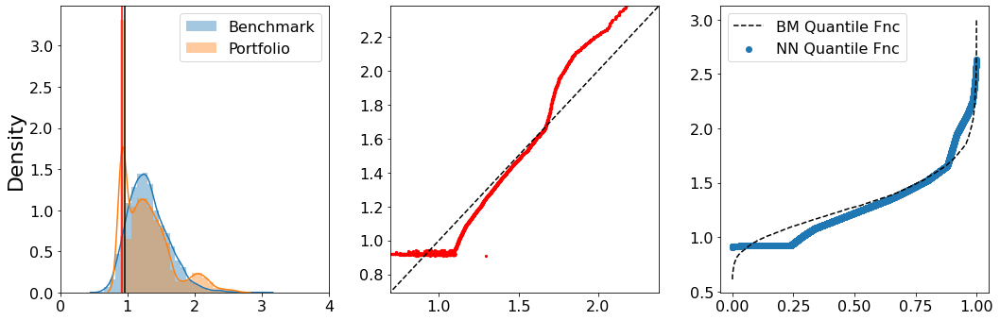

Epoch: 4 Iteration: 4998  duration =  37.388  secs
Budget Dist: -0.003 Wass Dist: 0.103 Risk Measure: -1.219 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


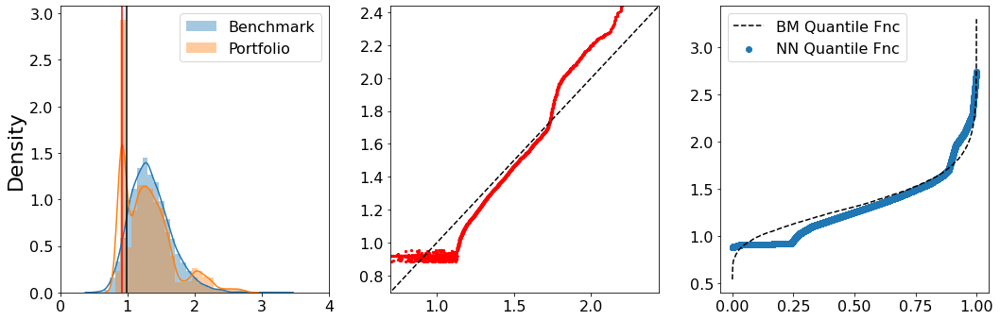

Epoch: 4 Iteration: 9997  duration =  25.011  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.221 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


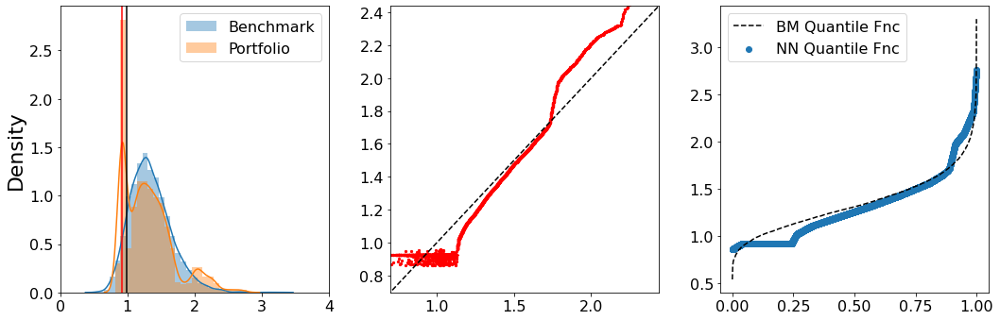

Epoch: 5 Iteration: 4998  duration =  37.150  secs
Budget Dist: -0.004 Wass Dist: 0.103 Risk Measure: -1.220 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


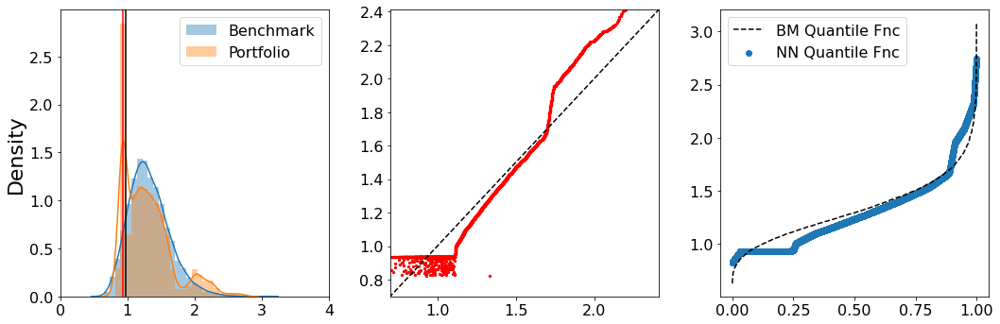

Epoch: 5 Iteration: 9997  duration =  24.936  secs
Budget Dist: 0.001 Wass Dist: 0.099 Risk Measure: -1.223 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


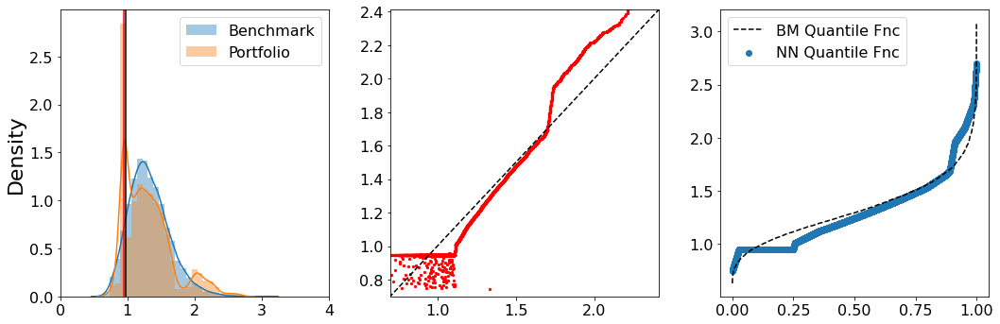

Epoch: 6 Iteration: 4998  duration =  37.048  secs
Budget Dist: -0.000 Wass Dist: 0.102 Risk Measure: -1.233 Loss: -1.228


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


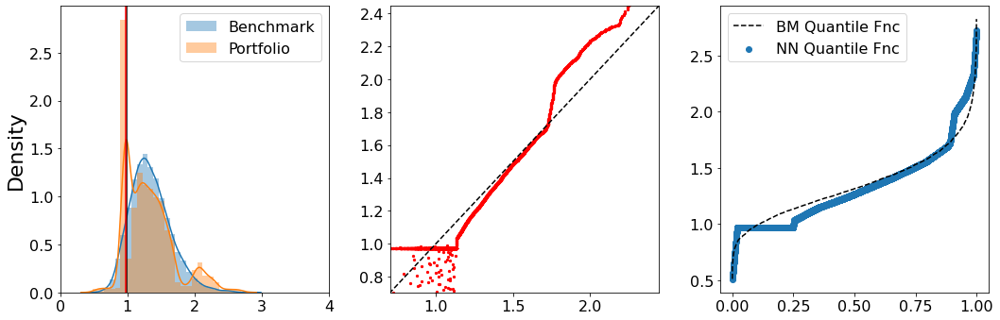

Epoch: 6 Iteration: 9997  duration =  25.163  secs
Budget Dist: 0.006 Wass Dist: 0.097 Risk Measure: -1.235 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


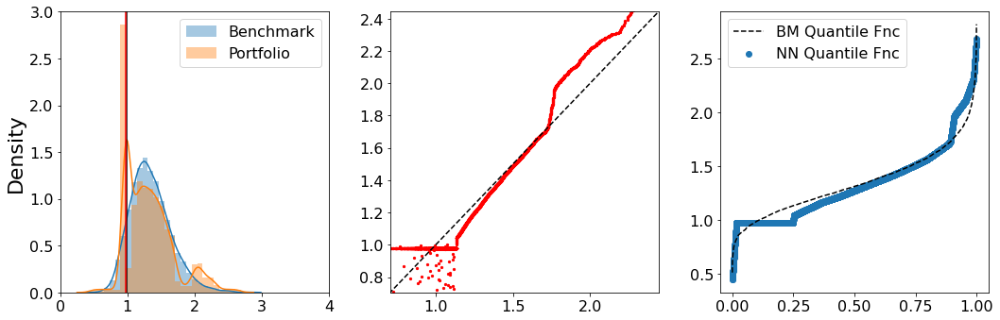

Epoch: 7 Iteration: 4998  duration =  37.162  secs
Budget Dist: -0.002 Wass Dist: 0.099 Risk Measure: -1.216 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


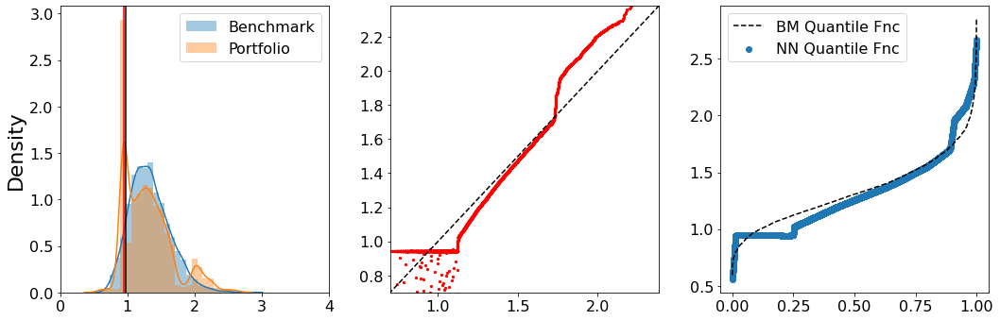

Epoch: 7 Iteration: 9997  duration =  25.065  secs
Budget Dist: 0.012 Wass Dist: 0.098 Risk Measure: -1.232 Loss: -1.208


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


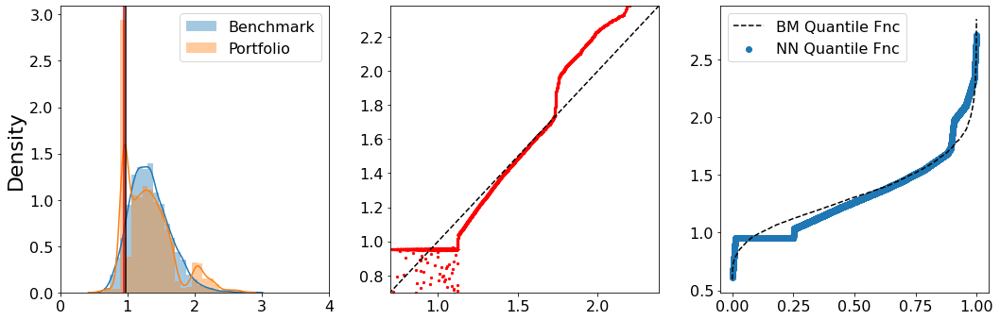

Epoch: 8 Iteration: 4998  duration =  37.124  secs
Budget Dist: -0.001 Wass Dist: 0.101 Risk Measure: -1.220 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


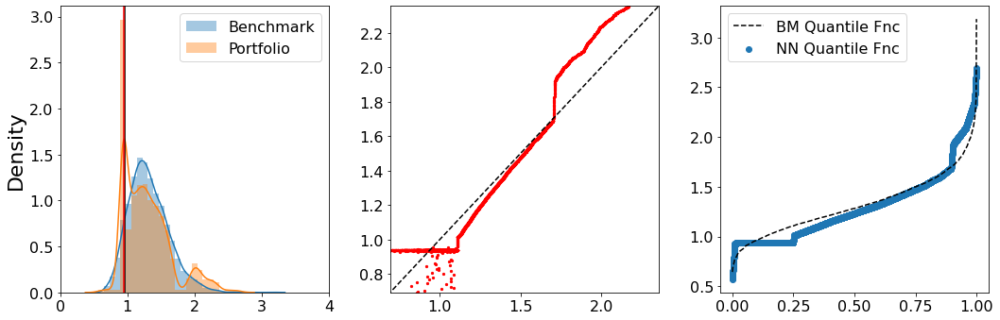

Epoch: 8 Iteration: 9997  duration =  25.180  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.224 Loss: -1.217


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


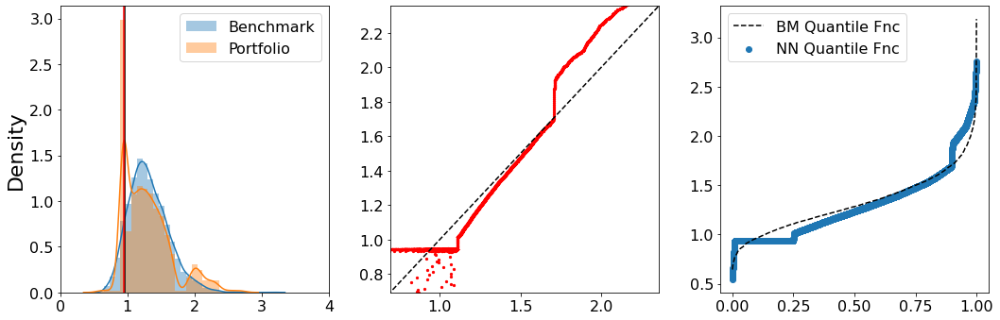

Epoch: 9 Iteration: 4998  duration =  37.194  secs
Budget Dist: 0.005 Wass Dist: 0.101 Risk Measure: -1.232 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


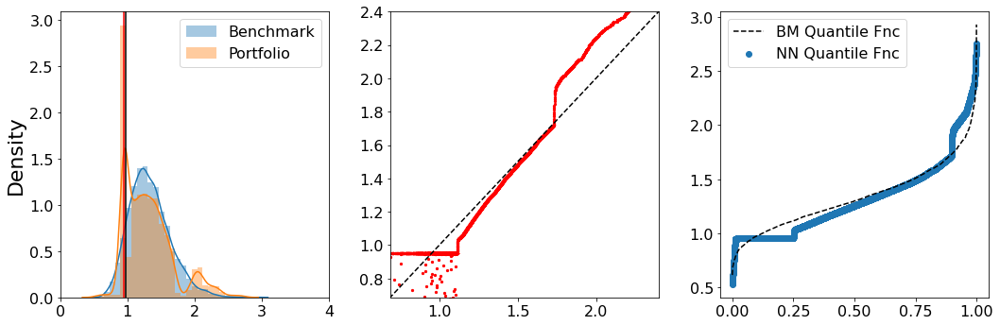

Epoch: 9 Iteration: 9997  duration =  25.121  secs
Budget Dist: 0.006 Wass Dist: 0.100 Risk Measure: -1.232 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


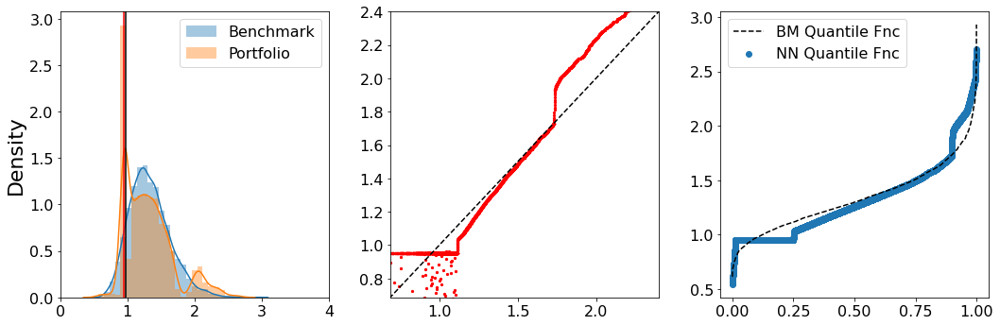

Epoch: 10 Iteration: 4998  duration =  37.274  secs
Budget Dist: 0.004 Wass Dist: 0.101 Risk Measure: -1.228 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


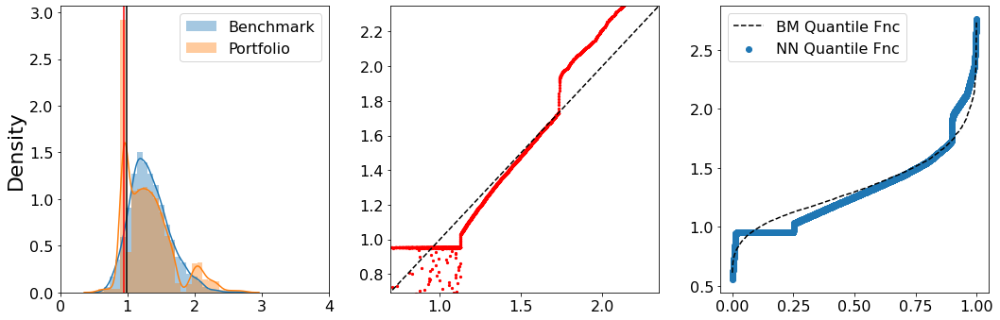

Epoch: 10 Iteration: 9997  duration =  25.000  secs
Budget Dist: -0.002 Wass Dist: 0.102 Risk Measure: -1.222 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


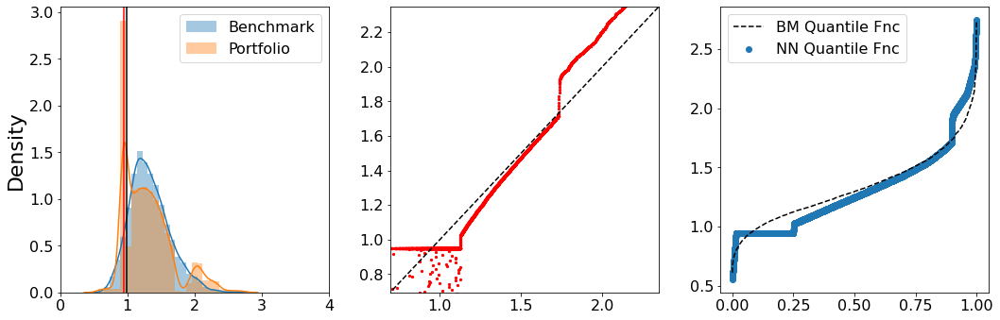

Epoch: 11 Iteration: 4998  duration =  37.045  secs
Budget Dist: 0.000 Wass Dist: 0.103 Risk Measure: -1.229 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


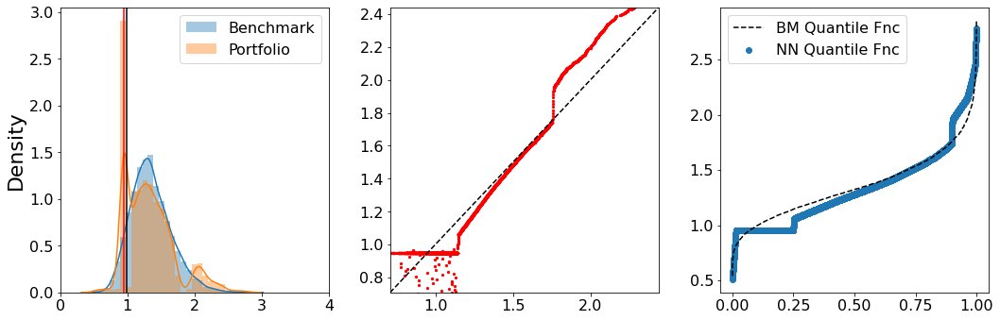

Epoch: 11 Iteration: 9997  duration =  24.908  secs
Budget Dist: 0.004 Wass Dist: 0.099 Risk Measure: -1.229 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


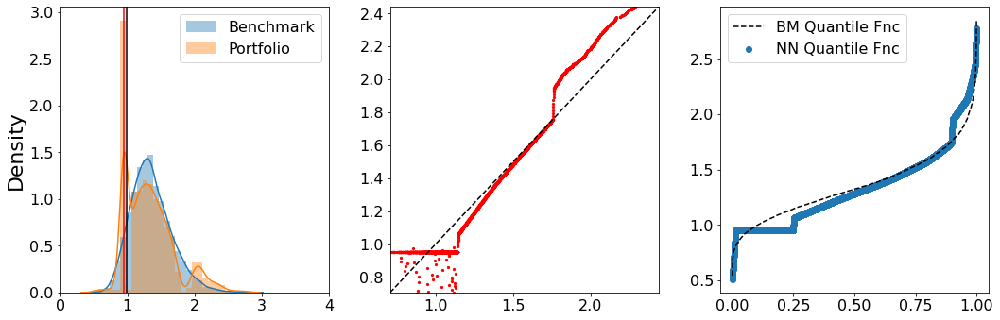

Epoch: 12 Iteration: 4998  duration =  37.009  secs
Budget Dist: -0.002 Wass Dist: 0.103 Risk Measure: -1.224 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


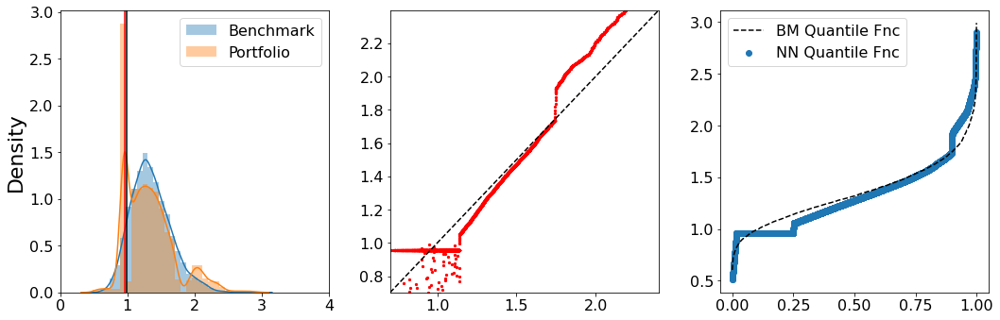

Epoch: 12 Iteration: 9997  duration =  24.844  secs
Budget Dist: -0.002 Wass Dist: 0.102 Risk Measure: -1.224 Loss: -1.220


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


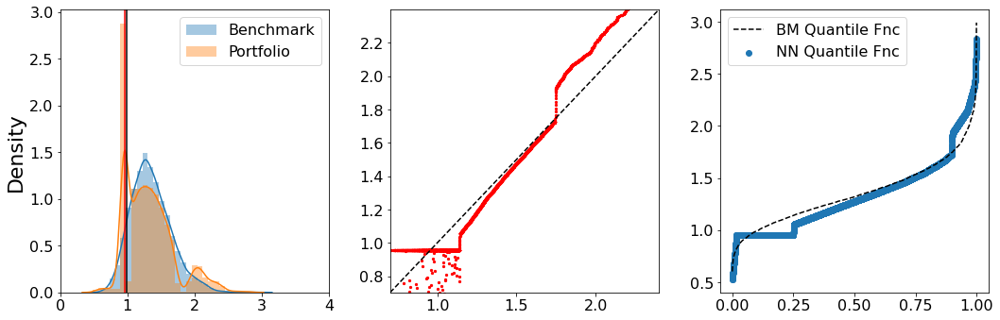

Epoch: 13 Iteration: 4998  duration =  36.835  secs
Budget Dist: 0.000 Wass Dist: 0.102 Risk Measure: -1.222 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


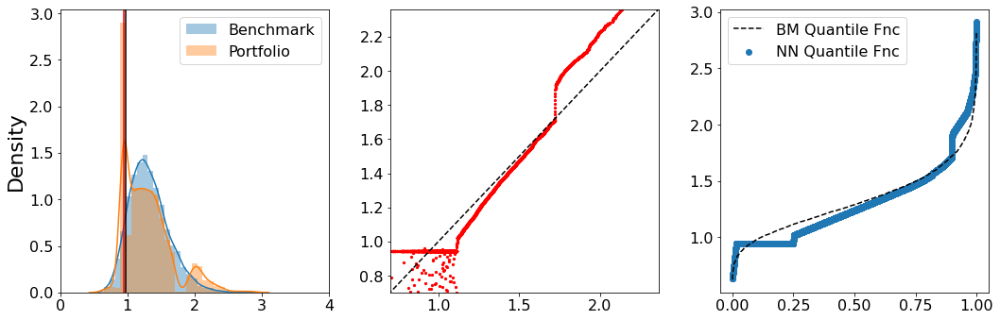

Epoch: 13 Iteration: 9997  duration =  24.962  secs
Budget Dist: 0.003 Wass Dist: 0.099 Risk Measure: -1.222 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


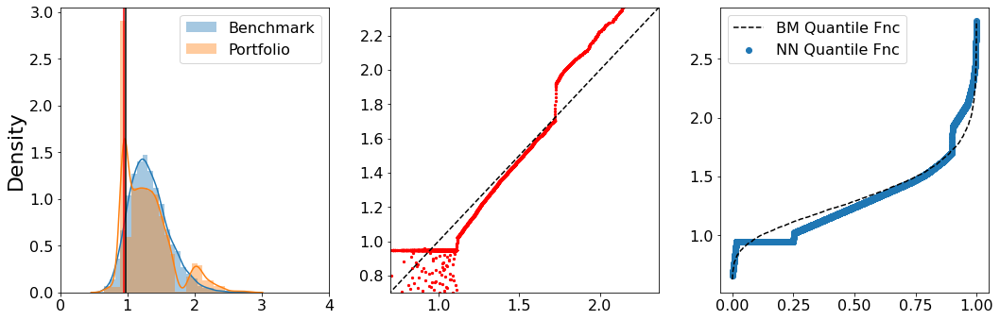

Epoch: 14 Iteration: 4998  duration =  37.123  secs
Budget Dist: 0.003 Wass Dist: 0.099 Risk Measure: -1.232 Loss: -1.225


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


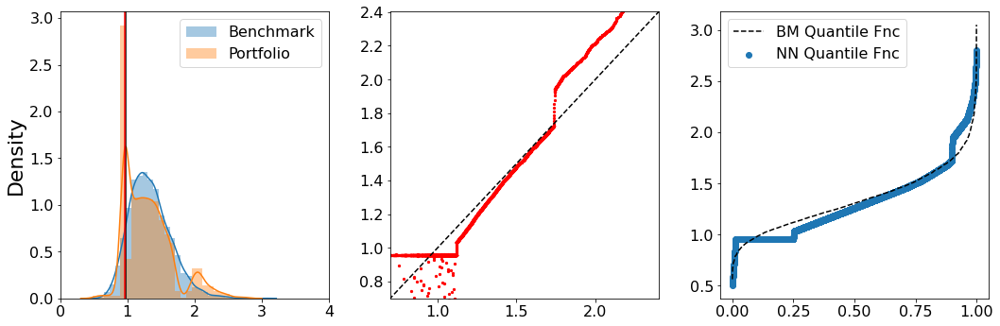

Epoch: 14 Iteration: 9997  duration =  24.870  secs
Budget Dist: 0.005 Wass Dist: 0.099 Risk Measure: -1.234 Loss: -1.224


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


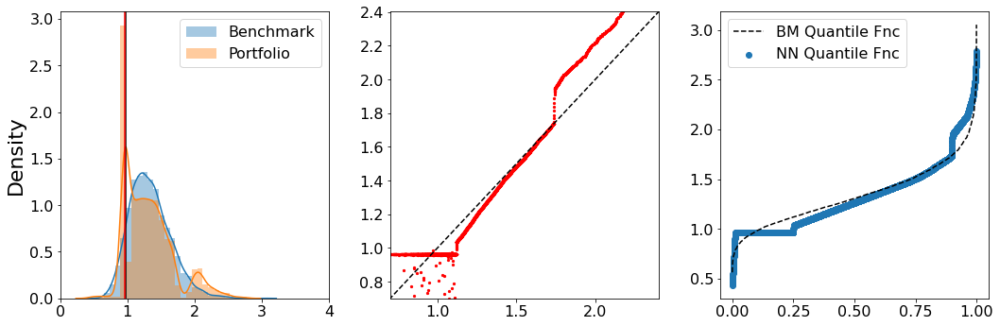

Epoch: 15 Iteration: 4998  duration =  37.032  secs
Budget Dist: 0.006 Wass Dist: 0.099 Risk Measure: -1.224 Loss: -1.212


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


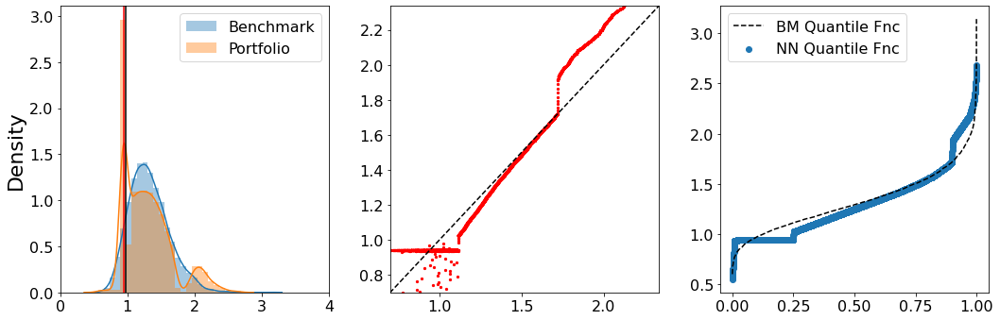

Epoch: 15 Iteration: 9997  duration =  24.803  secs
Budget Dist: -0.001 Wass Dist: 0.098 Risk Measure: -1.215 Loss: -1.215


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


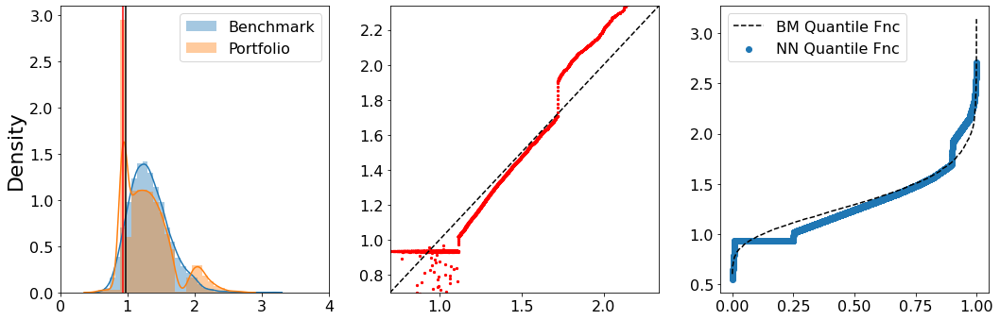

Epoch: 16 Iteration: 4998  duration =  36.969  secs
Budget Dist: -0.002 Wass Dist: 0.099 Risk Measure: -1.224 Loss: -1.224


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


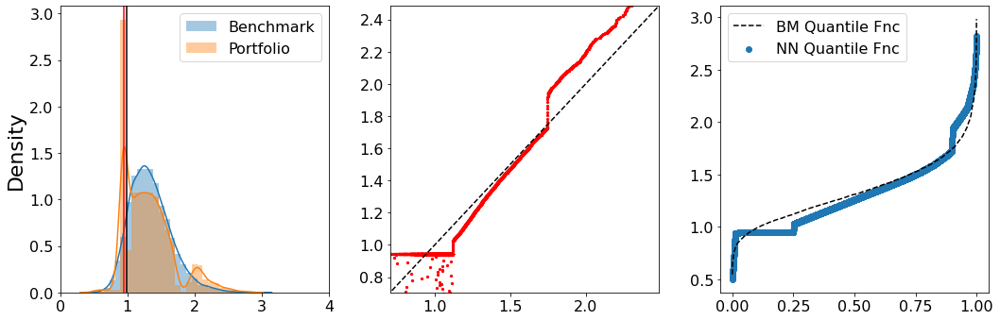

Epoch: 16 Iteration: 9997  duration =  24.751  secs
Budget Dist: 0.008 Wass Dist: 0.104 Risk Measure: -1.241 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


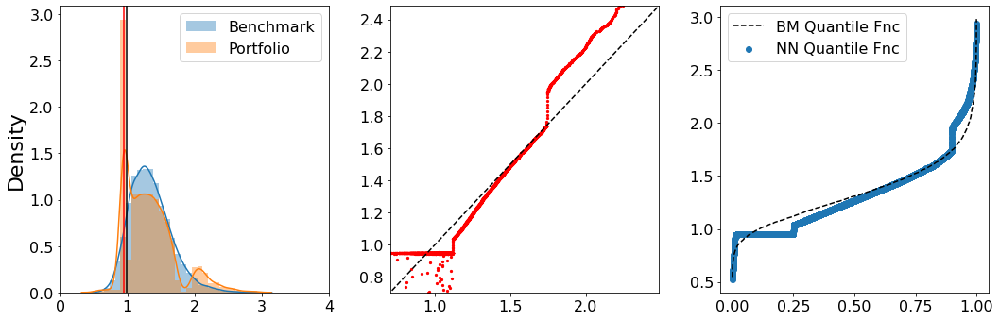

Epoch: 17 Iteration: 4998  duration =  36.931  secs
Budget Dist: 0.002 Wass Dist: 0.099 Risk Measure: -1.224 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


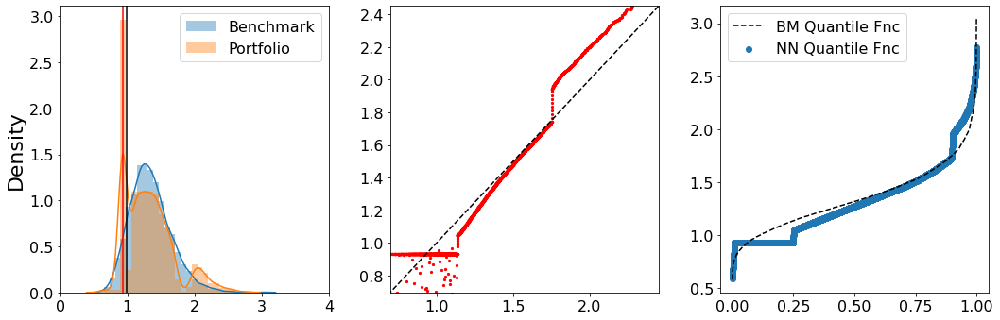

Epoch: 17 Iteration: 9997  duration =  24.839  secs
Budget Dist: -0.000 Wass Dist: 0.102 Risk Measure: -1.225 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


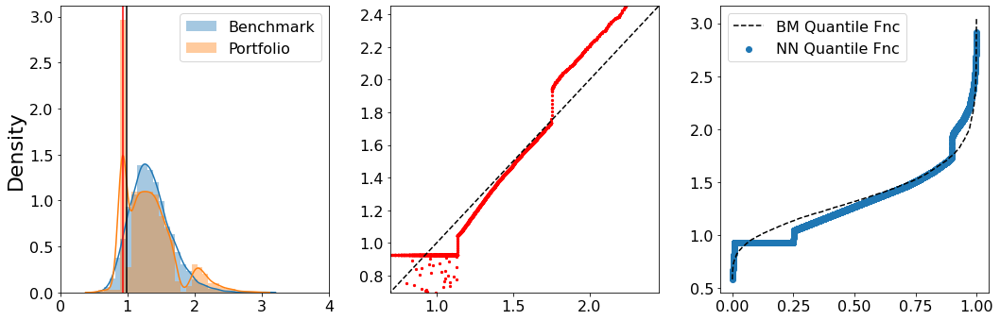

Epoch: 18 Iteration: 4998  duration =  36.973  secs
Budget Dist: 0.004 Wass Dist: 0.102 Risk Measure: -1.228 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


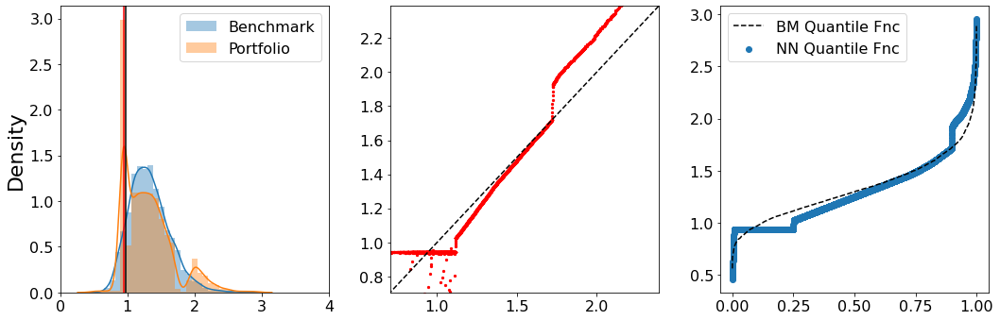

Epoch: 18 Iteration: 9997  duration =  24.569  secs
Budget Dist: -0.000 Wass Dist: 0.102 Risk Measure: -1.224 Loss: -1.220


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


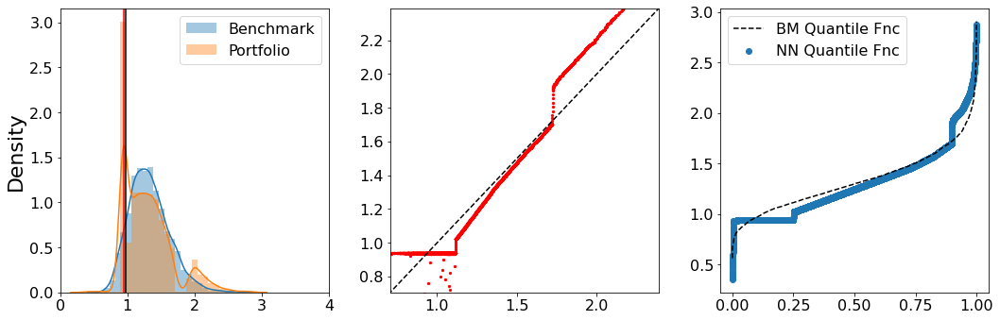

Epoch: 19 Iteration: 4998  duration =  36.964  secs
Budget Dist: 0.002 Wass Dist: 0.101 Risk Measure: -1.227 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


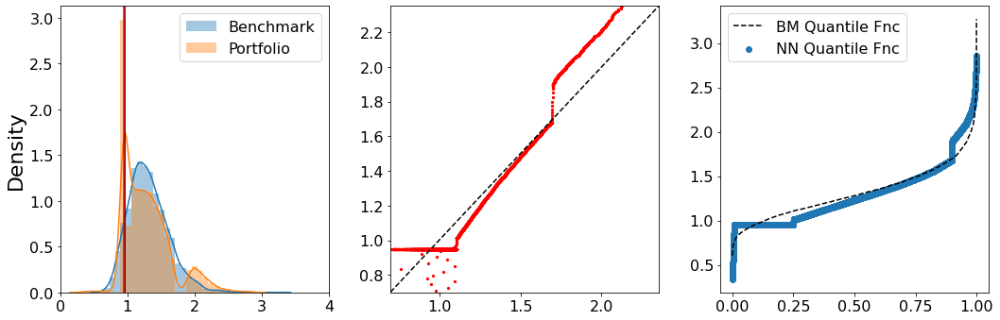

Epoch: 19 Iteration: 9997  duration =  24.574  secs
Budget Dist: 0.001 Wass Dist: 0.100 Risk Measure: -1.222 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


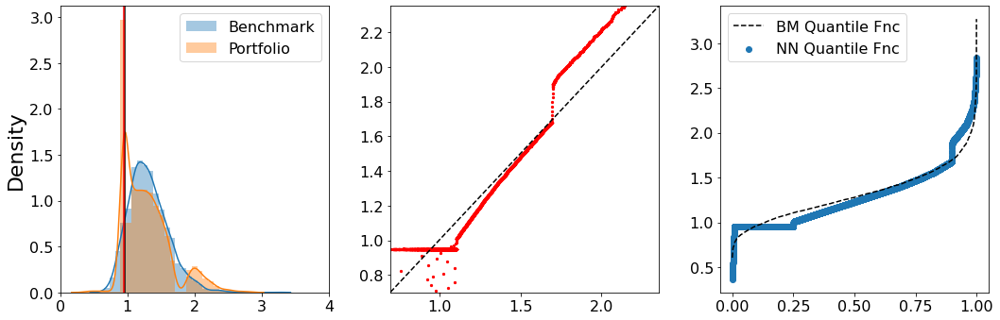

Epoch: 20 Iteration: 4998  duration =  36.769  secs
Budget Dist: 0.005 Wass Dist: 0.101 Risk Measure: -1.225 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


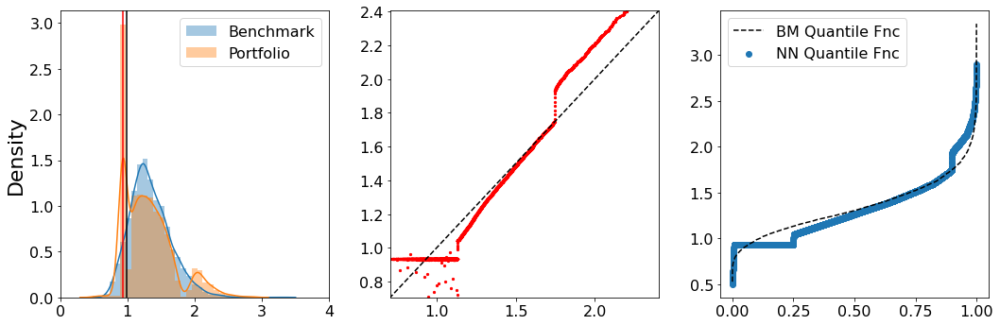

Epoch: 20 Iteration: 9997  duration =  24.198  secs
Budget Dist: -0.003 Wass Dist: 0.101 Risk Measure: -1.214 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


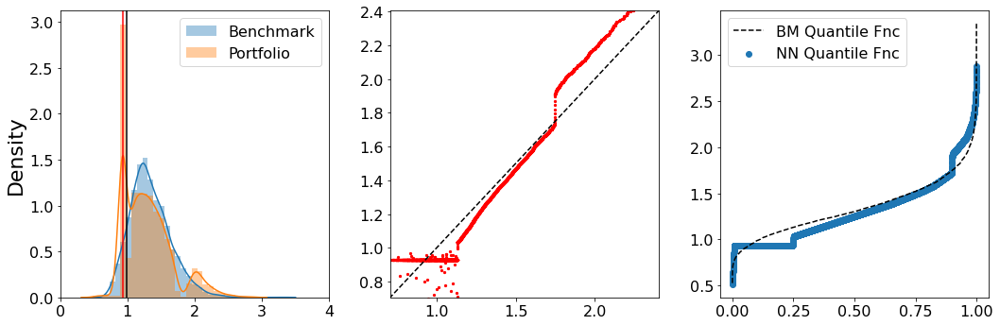

Epoch: 21 Iteration: 4998  duration =  37.073  secs
Budget Dist: -0.005 Wass Dist: 0.101 Risk Measure: -1.214 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


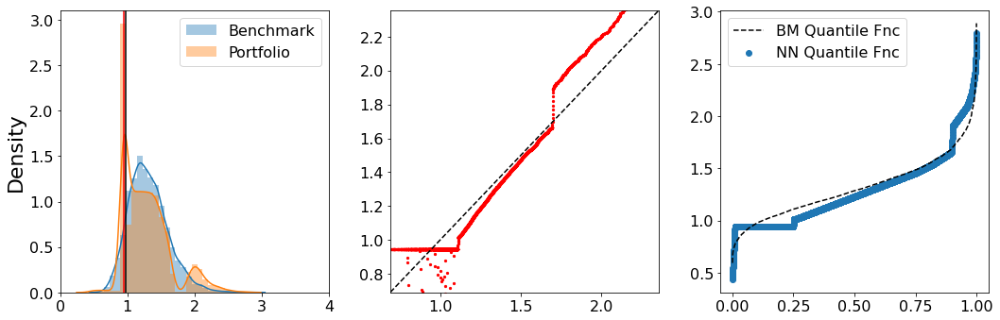

Epoch: 21 Iteration: 9997  duration =  24.359  secs
Budget Dist: 0.002 Wass Dist: 0.099 Risk Measure: -1.219 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


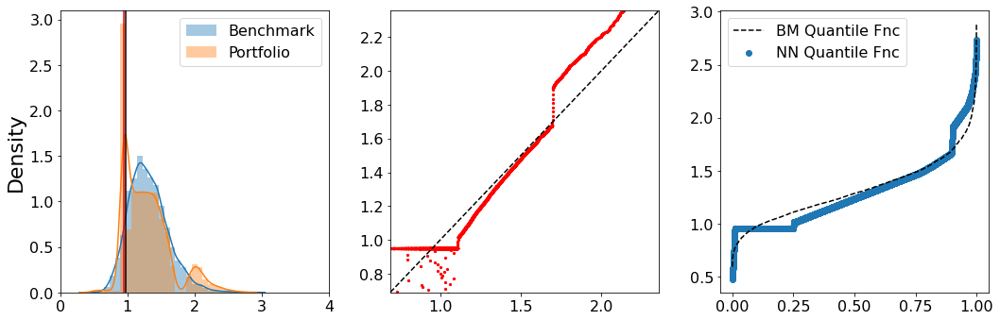

Epoch: 22 Iteration: 4998  duration =  37.196  secs
Budget Dist: 0.003 Wass Dist: 0.103 Risk Measure: -1.234 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


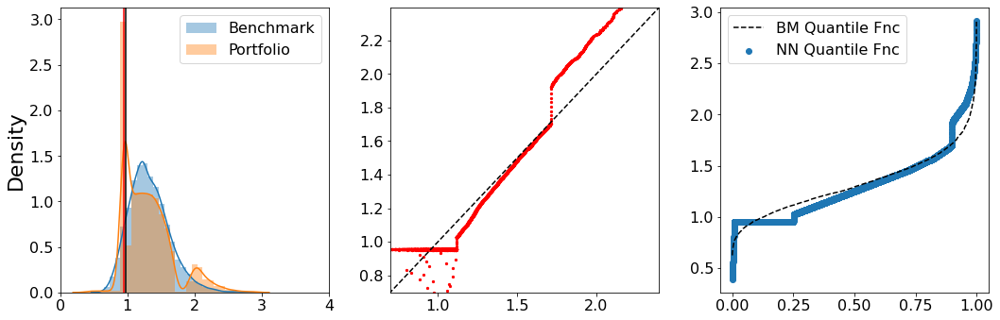

Epoch: 22 Iteration: 9997  duration =  24.401  secs
Budget Dist: 0.002 Wass Dist: 0.099 Risk Measure: -1.229 Loss: -1.226


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


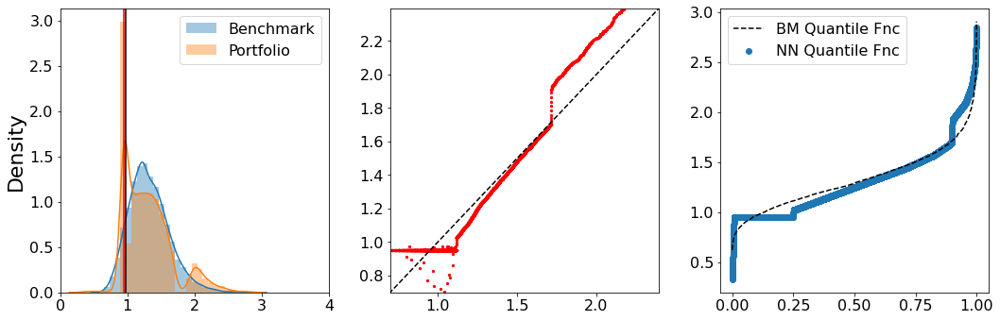

Epoch: 23 Iteration: 4998  duration =  37.381  secs
Budget Dist: -0.000 Wass Dist: 0.103 Risk Measure: -1.237 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


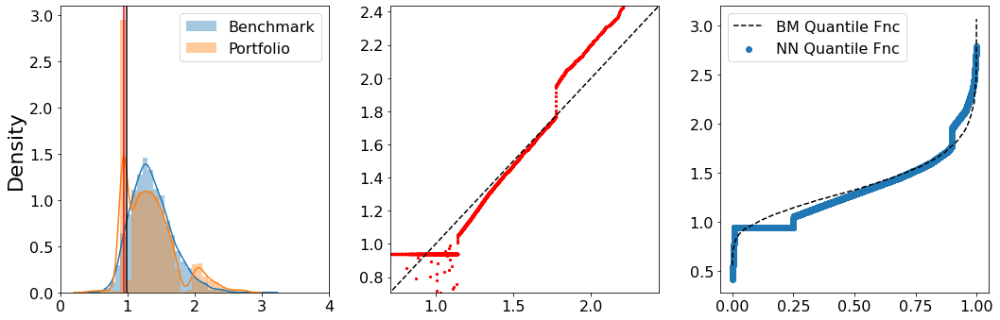

Epoch: 23 Iteration: 9997  duration =  24.537  secs
Budget Dist: 0.003 Wass Dist: 0.099 Risk Measure: -1.231 Loss: -1.225


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


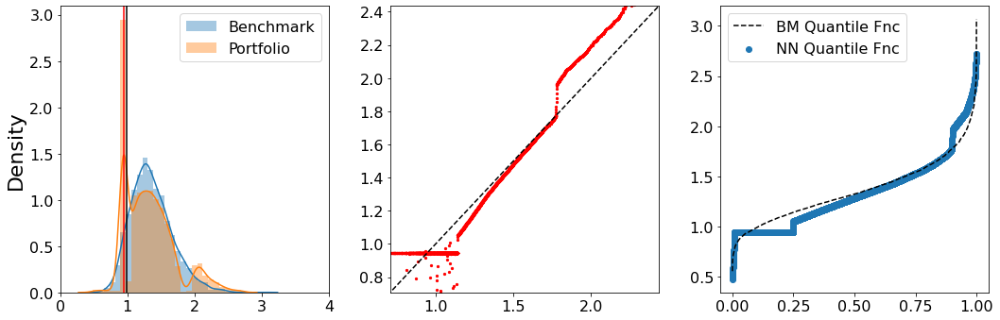

Epoch: 24 Iteration: 4998  duration =  37.209  secs
Budget Dist: 0.006 Wass Dist: 0.098 Risk Measure: -1.226 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


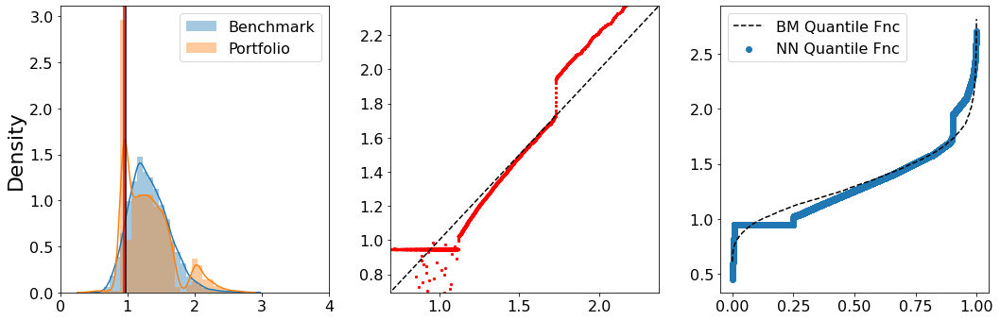

Epoch: 24 Iteration: 9997  duration =  24.576  secs
Budget Dist: -0.001 Wass Dist: 0.101 Risk Measure: -1.223 Loss: -1.220


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


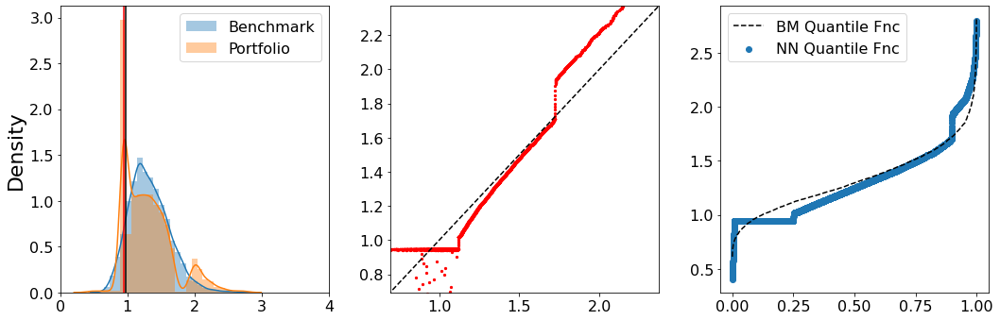

Epoch: 25 Iteration: 4998  duration =  37.220  secs
Budget Dist: -0.001 Wass Dist: 0.101 Risk Measure: -1.224 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


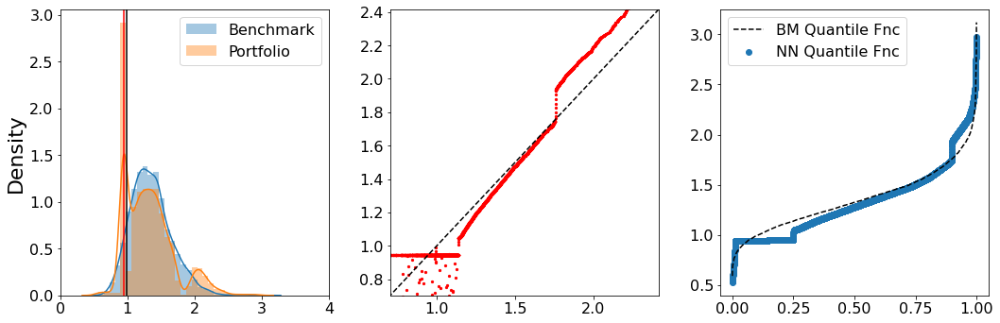

Epoch: 25 Iteration: 9997  duration =  24.640  secs
Budget Dist: -0.001 Wass Dist: 0.102 Risk Measure: -1.226 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


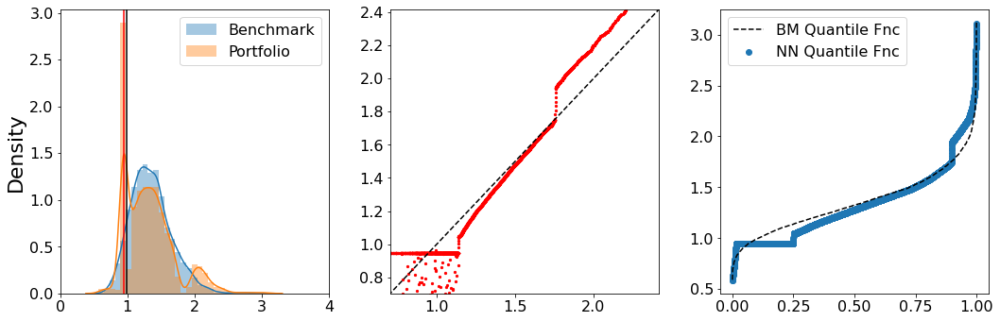

Epoch: 26 Iteration: 4998  duration =  37.110  secs
Budget Dist: 0.003 Wass Dist: 0.100 Risk Measure: -1.221 Loss: -1.215


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


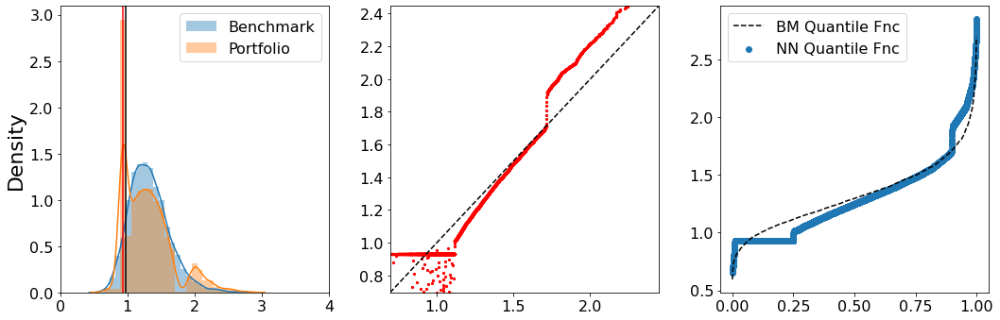

Epoch: 26 Iteration: 9997  duration =  24.877  secs
Budget Dist: 0.000 Wass Dist: 0.099 Risk Measure: -1.217 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


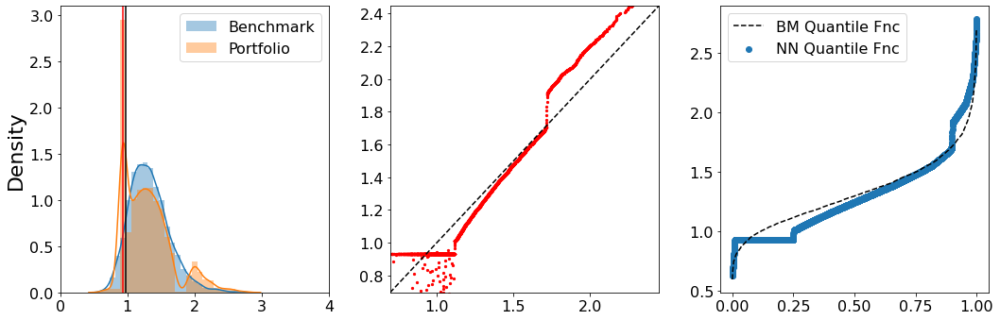

Epoch: 27 Iteration: 4998  duration =  36.986  secs
Budget Dist: 0.000 Wass Dist: 0.101 Risk Measure: -1.215 Loss: -1.212


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


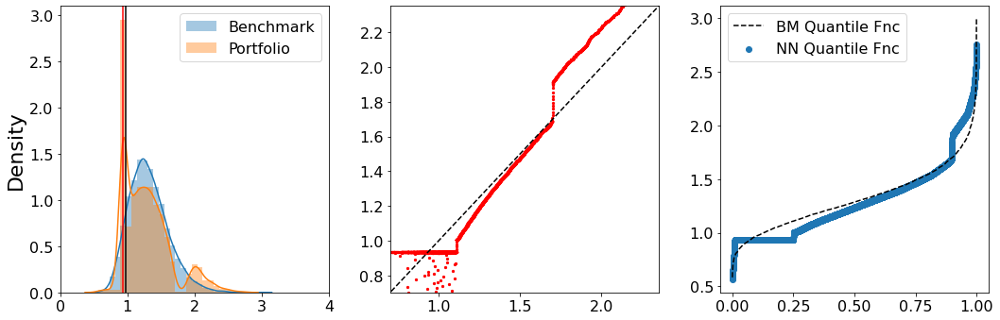

Epoch: 27 Iteration: 9997  duration =  24.753  secs
Budget Dist: 0.003 Wass Dist: 0.101 Risk Measure: -1.219 Loss: -1.210


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


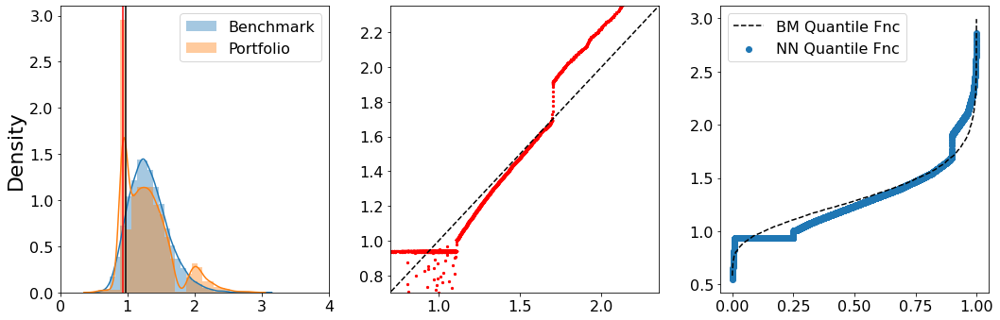

Epoch: 28 Iteration: 4998  duration =  36.826  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.223 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


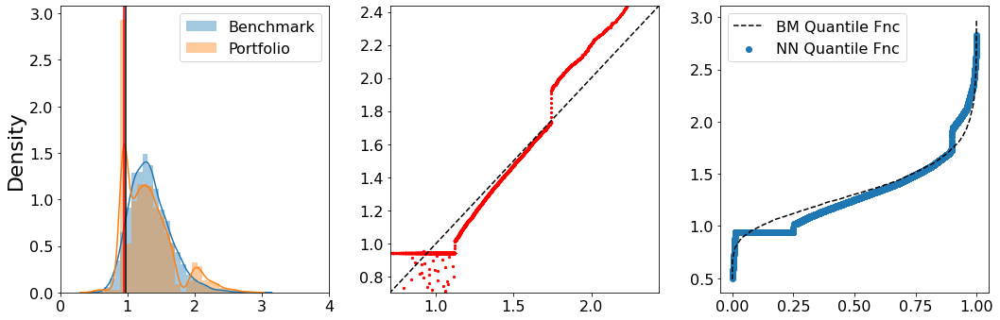

Epoch: 28 Iteration: 9997  duration =  24.980  secs
Budget Dist: 0.000 Wass Dist: 0.101 Risk Measure: -1.226 Loss: -1.225


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


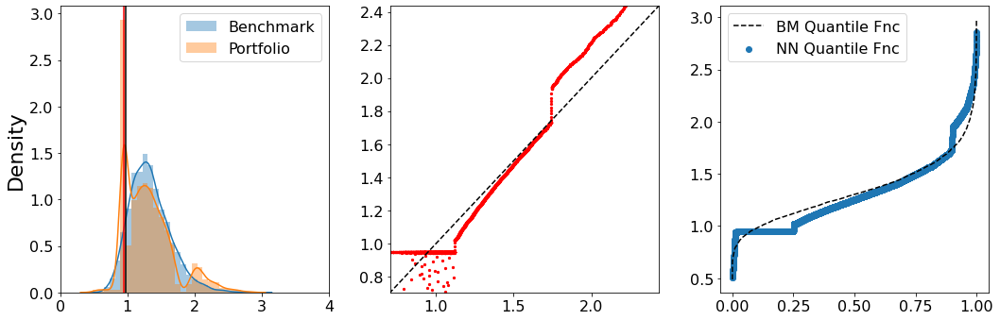

Epoch: 29 Iteration: 4998  duration =  36.817  secs
Budget Dist: 0.002 Wass Dist: 0.099 Risk Measure: -1.216 Loss: -1.211


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


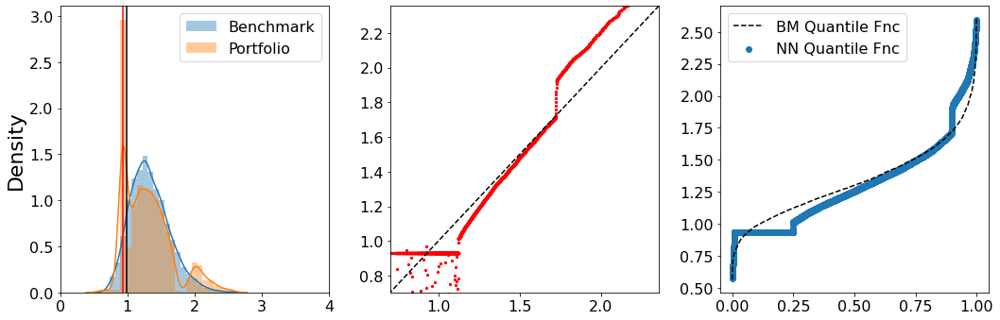

Epoch: 29 Iteration: 9997  duration =  24.810  secs
Budget Dist: 0.001 Wass Dist: 0.100 Risk Measure: -1.215 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


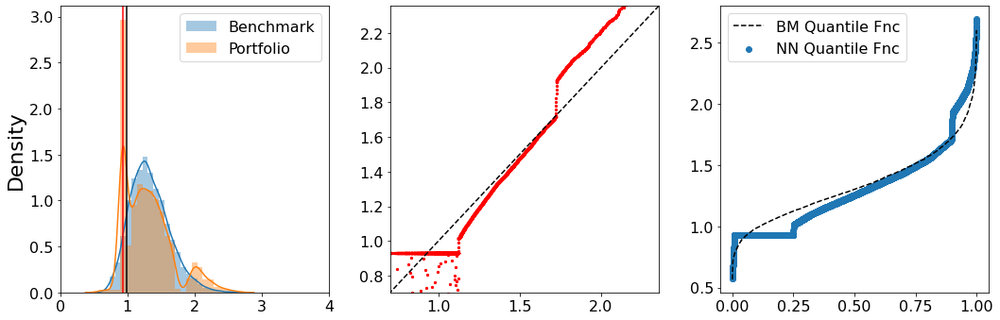

Finished Training


In [ ]:
net = ValueNet(50).to(device)
model_name = "Copula_Standard.pt"
T = 5
Ndt = 252*T
Nsims = 5000
Nepochs = 30
Train_ValueNet_Copula(net, model_name, params_MV,  Ndt, T, Nsims, Nepochs, Update = "backprop")

## Copula Distortion

### Part 1

# New section

Epoch: 0 Iteration: 4998  duration =  81.032  secs
Budget Dist: 0.017 Wass Dist: 0.099 Risk Measure: -1.231 Loss: -1.212


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


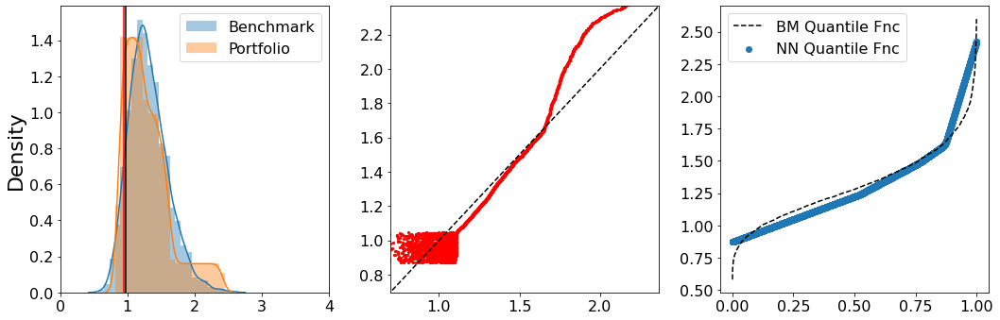

Epoch: 0 Iteration: 9997  duration =  69.719  secs
Budget Dist: 0.022 Wass Dist: 0.101 Risk Measure: -1.240 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


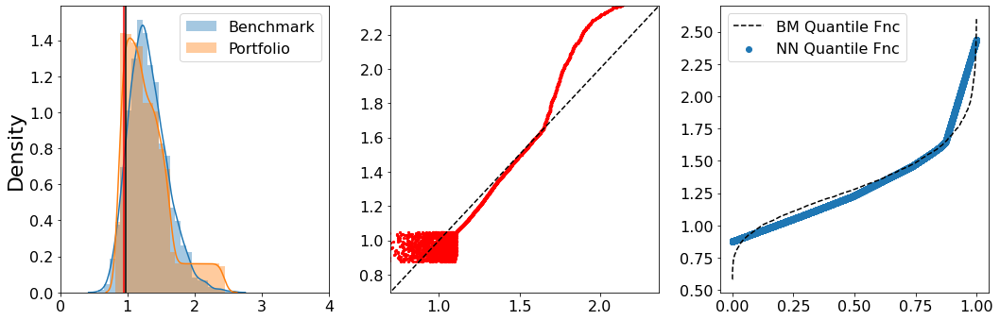

Epoch: 1 Iteration: 4998  duration =  82.018  secs
Budget Dist: 0.038 Wass Dist: 0.101 Risk Measure: -1.260 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


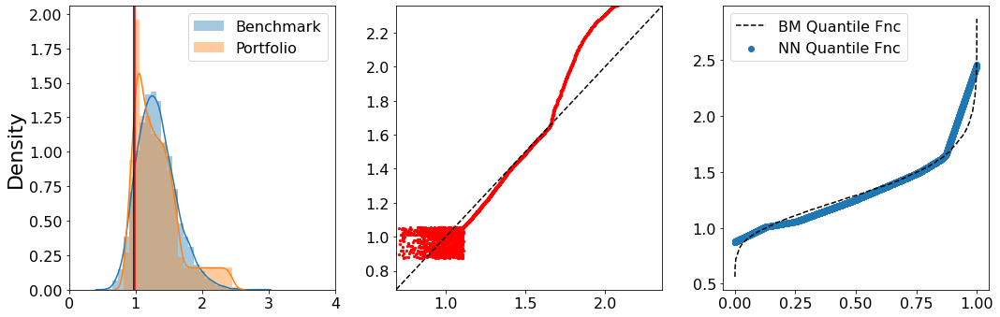

Epoch: 1 Iteration: 9997  duration =  70.125  secs
Budget Dist: 0.035 Wass Dist: 0.101 Risk Measure: -1.262 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


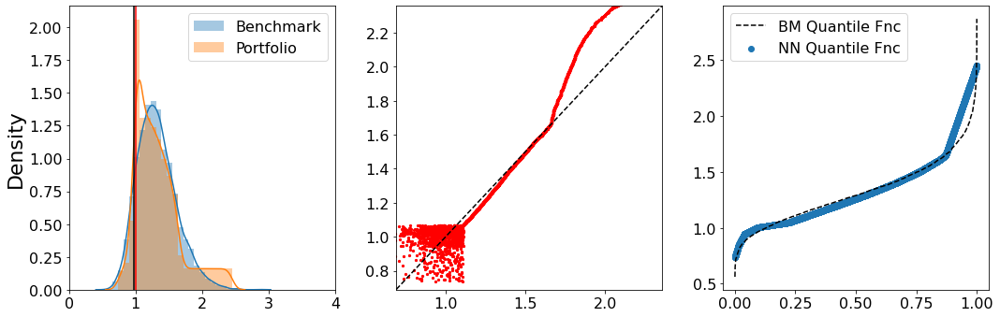

Epoch: 2 Iteration: 4998  duration =  81.833  secs
Budget Dist: 0.024 Wass Dist: 0.103 Risk Measure: -1.260 Loss: -1.230


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


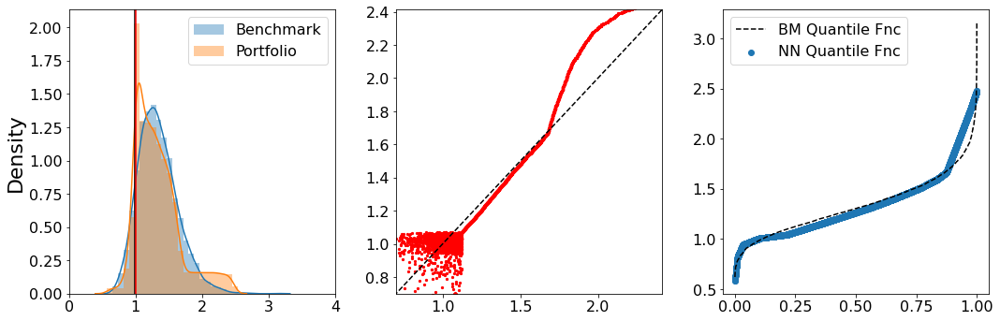

Epoch: 2 Iteration: 9997  duration =  70.140  secs
Budget Dist: -0.000 Wass Dist: 0.105 Risk Measure: -1.237 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


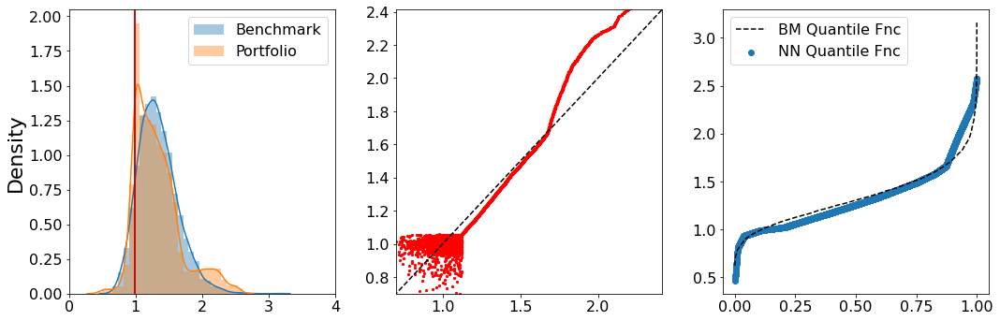

Epoch: 3 Iteration: 4998  duration =  81.918  secs
Budget Dist: 0.003 Wass Dist: 0.106 Risk Measure: -1.240 Loss: -1.229


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


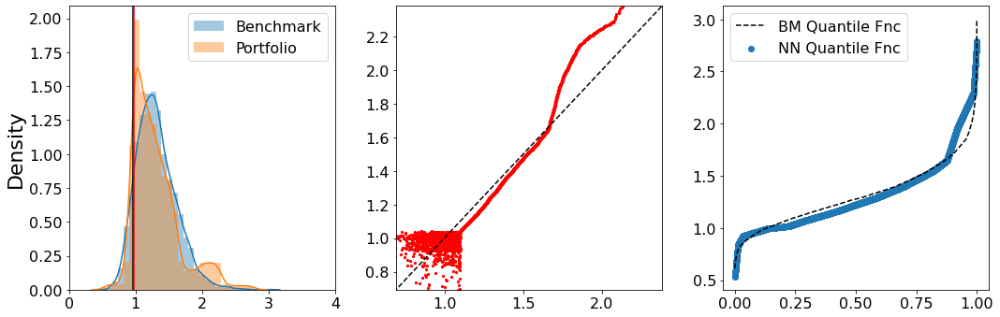

Epoch: 3 Iteration: 9997  duration =  70.059  secs
Budget Dist: 0.017 Wass Dist: 0.107 Risk Measure: -1.254 Loss: -1.227


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


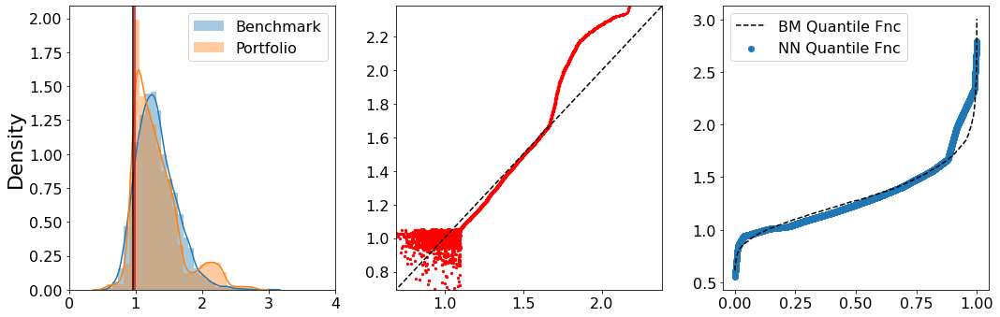

Epoch: 4 Iteration: 4998  duration =  81.910  secs
Budget Dist: 0.008 Wass Dist: 0.104 Risk Measure: -1.256 Loss: -1.242


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


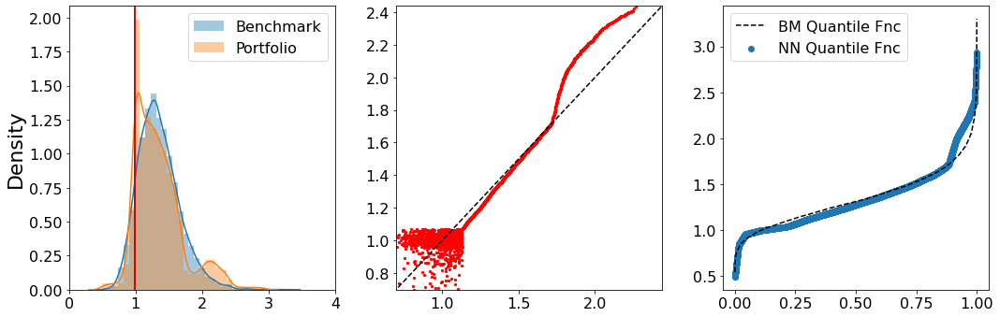

Epoch: 4 Iteration: 9997  duration =  69.972  secs
Budget Dist: 0.004 Wass Dist: 0.102 Risk Measure: -1.251 Loss: -1.244


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


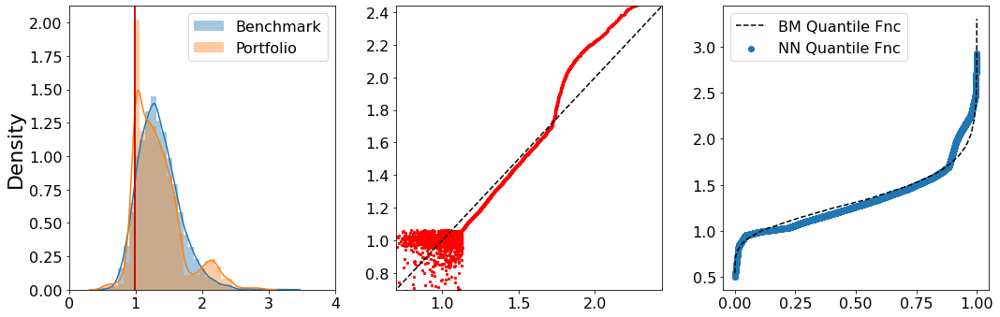

Epoch: 5 Iteration: 4998  duration =  82.074  secs
Budget Dist: -0.000 Wass Dist: 0.100 Risk Measure: -1.235 Loss: -1.235


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


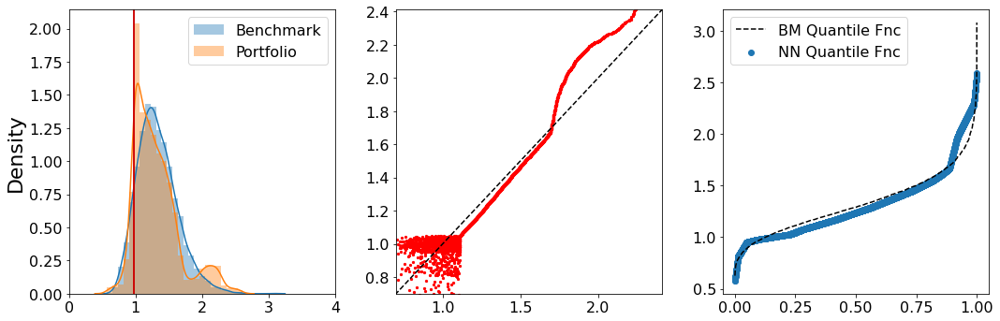

Epoch: 5 Iteration: 9997  duration =  69.925  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.236 Loss: -1.236


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


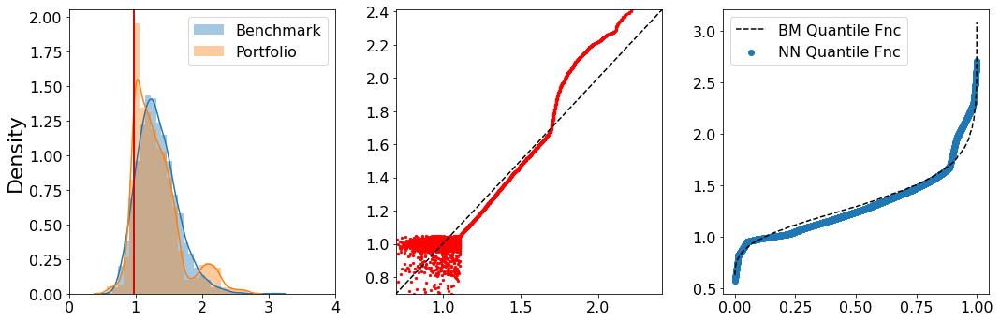

Epoch: 6 Iteration: 4998  duration =  81.700  secs
Budget Dist: 0.007 Wass Dist: 0.104 Risk Measure: -1.254 Loss: -1.241


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


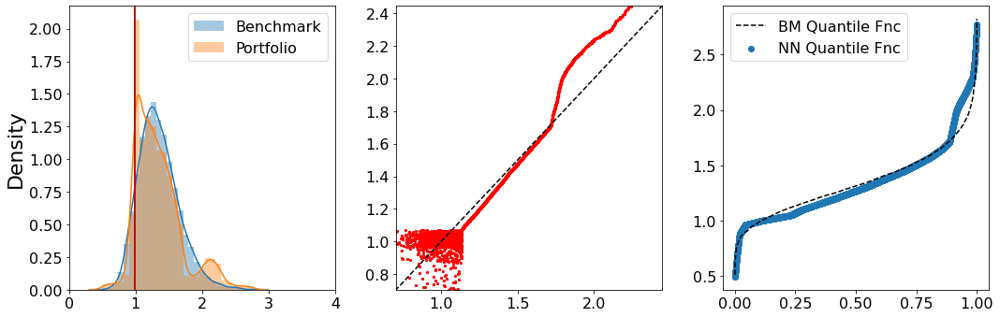

Epoch: 6 Iteration: 9997  duration =  70.015  secs
Budget Dist: 0.004 Wass Dist: 0.108 Risk Measure: -1.255 Loss: -1.241


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


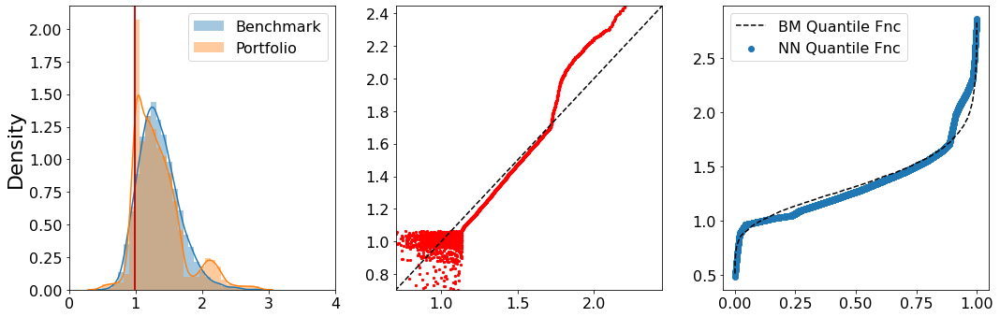

Epoch: 7 Iteration: 4998  duration =  81.609  secs
Budget Dist: 0.006 Wass Dist: 0.101 Risk Measure: -1.239 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


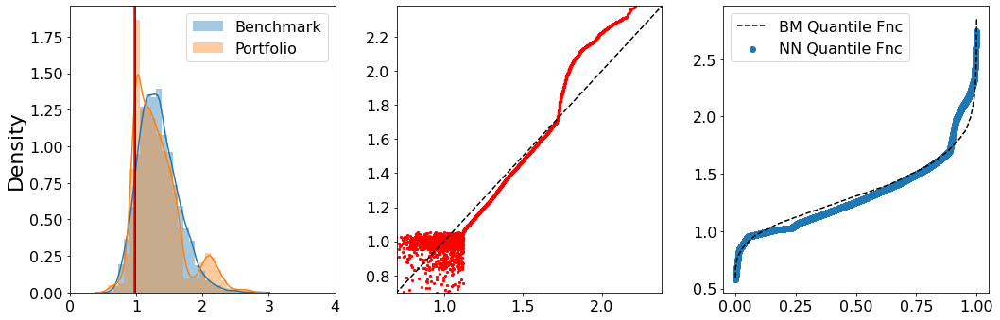

Epoch: 7 Iteration: 9997  duration =  69.480  secs
Budget Dist: 0.013 Wass Dist: 0.102 Risk Measure: -1.249 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


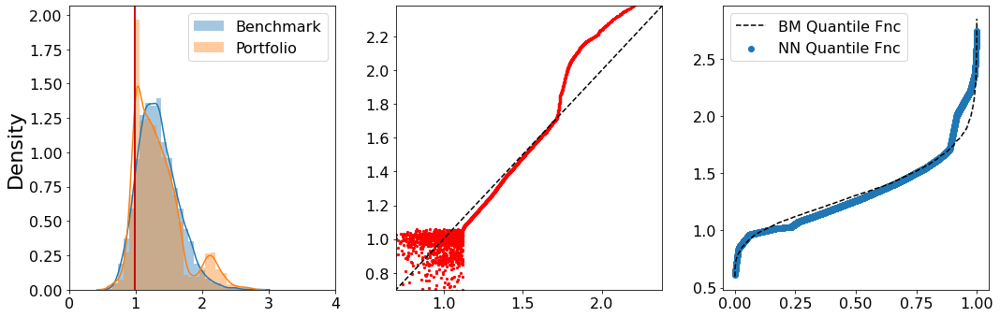

Epoch: 8 Iteration: 4998  duration =  81.792  secs
Budget Dist: 0.015 Wass Dist: 0.103 Risk Measure: -1.250 Loss: -1.229


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


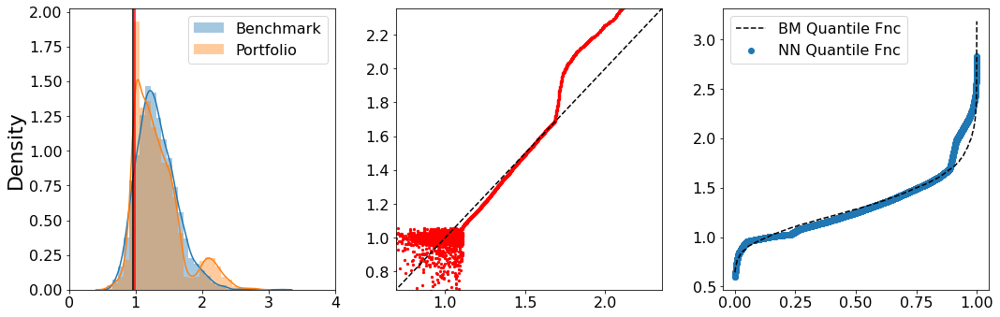

Epoch: 8 Iteration: 9997  duration =  70.290  secs
Budget Dist: 0.005 Wass Dist: 0.107 Risk Measure: -1.245 Loss: -1.230


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


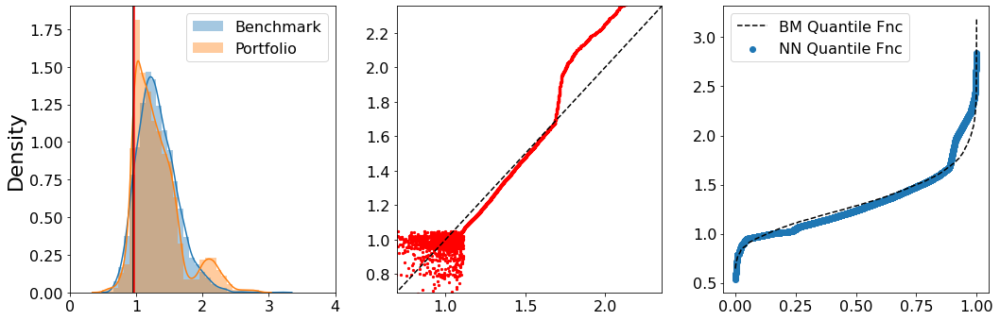

Epoch: 9 Iteration: 4998  duration =  81.798  secs
Budget Dist: 0.009 Wass Dist: 0.101 Risk Measure: -1.246 Loss: -1.235


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


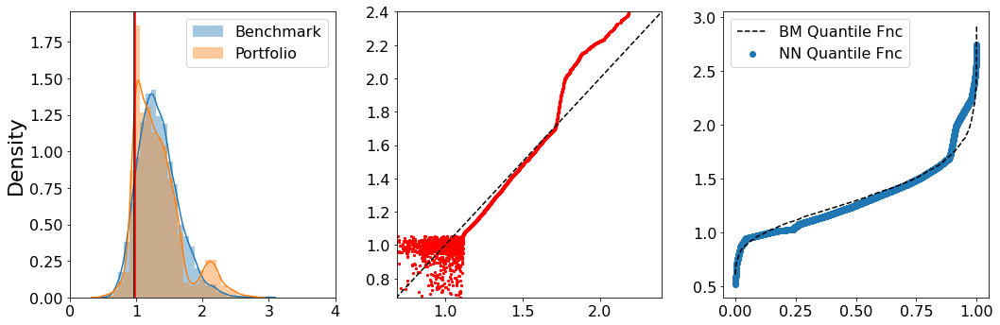

Epoch: 9 Iteration: 9997  duration =  69.467  secs
Budget Dist: -0.000 Wass Dist: 0.103 Risk Measure: -1.240 Loss: -1.235


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


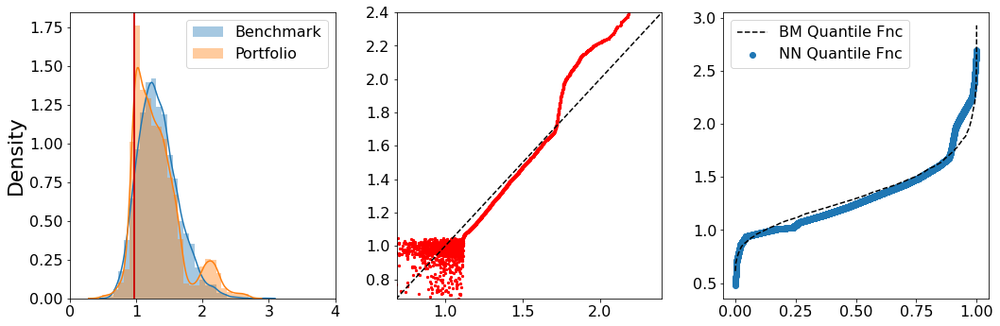

Epoch: 10 Iteration: 4998  duration =  82.107  secs
Budget Dist: 0.018 Wass Dist: 0.104 Risk Measure: -1.258 Loss: -1.233


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


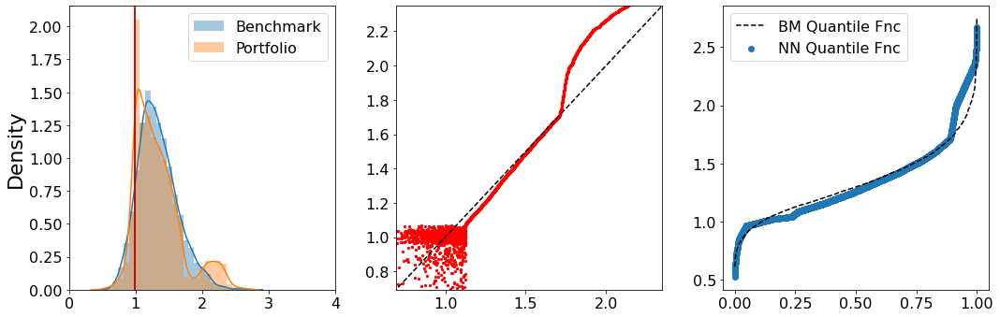

Epoch: 10 Iteration: 9997  duration =  69.602  secs
Budget Dist: 0.022 Wass Dist: 0.100 Risk Measure: -1.257 Loss: -1.234


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


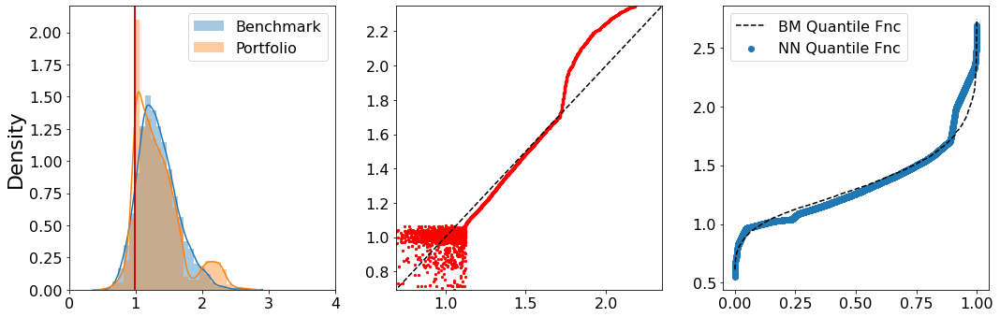

Epoch: 11 Iteration: 4998  duration =  81.981  secs
Budget Dist: 0.003 Wass Dist: 0.102 Risk Measure: -1.242 Loss: -1.236


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


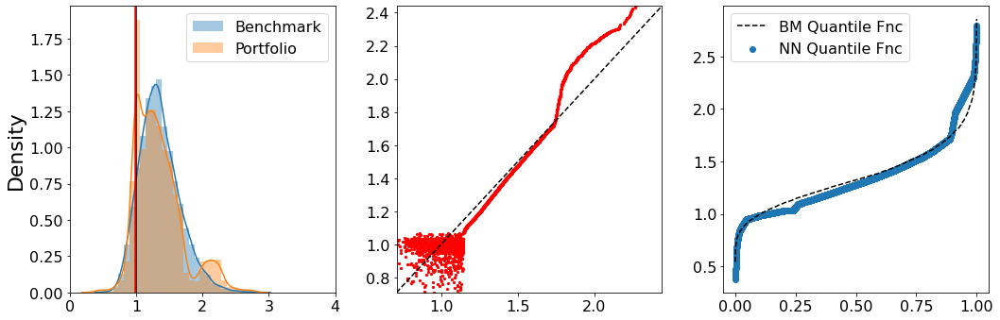

Epoch: 11 Iteration: 9997  duration =  69.851  secs
Budget Dist: 0.006 Wass Dist: 0.101 Risk Measure: -1.245 Loss: -1.237


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


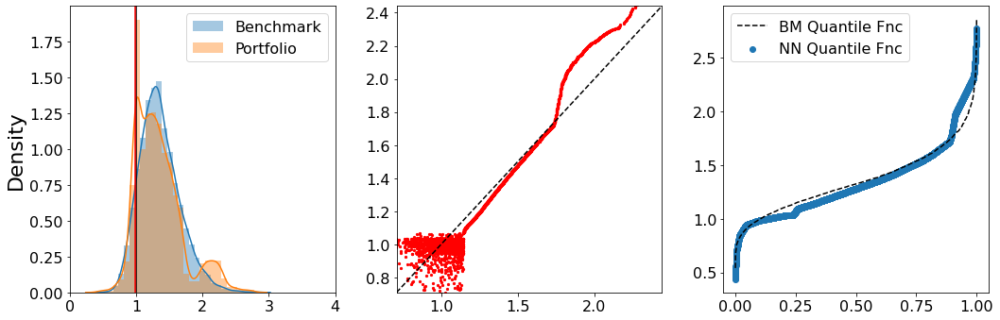

Epoch: 12 Iteration: 4998  duration =  82.606  secs
Budget Dist: 0.002 Wass Dist: 0.105 Risk Measure: -1.242 Loss: -1.234


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


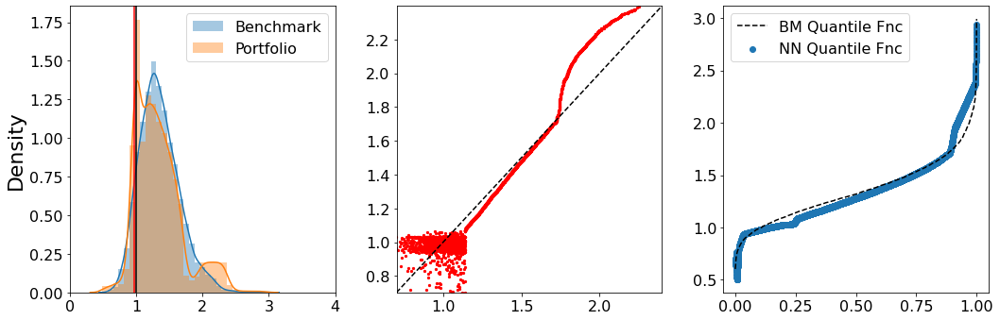

Epoch: 12 Iteration: 9997  duration =  70.995  secs
Budget Dist: 0.001 Wass Dist: 0.103 Risk Measure: -1.240 Loss: -1.234


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


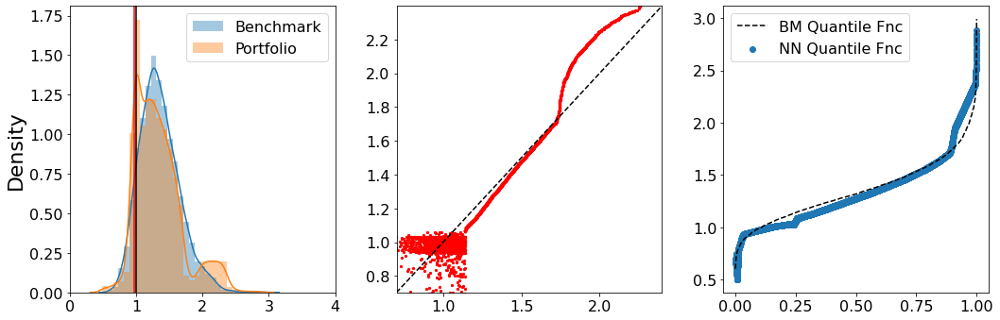

Epoch: 13 Iteration: 4998  duration =  84.230  secs
Budget Dist: 0.009 Wass Dist: 0.102 Risk Measure: -1.244 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


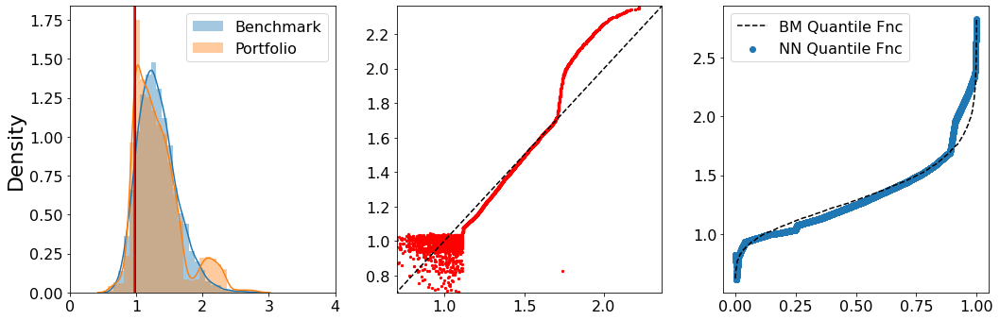

Epoch: 13 Iteration: 9997  duration =  71.893  secs
Budget Dist: 0.004 Wass Dist: 0.105 Risk Measure: -1.242 Loss: -1.232


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


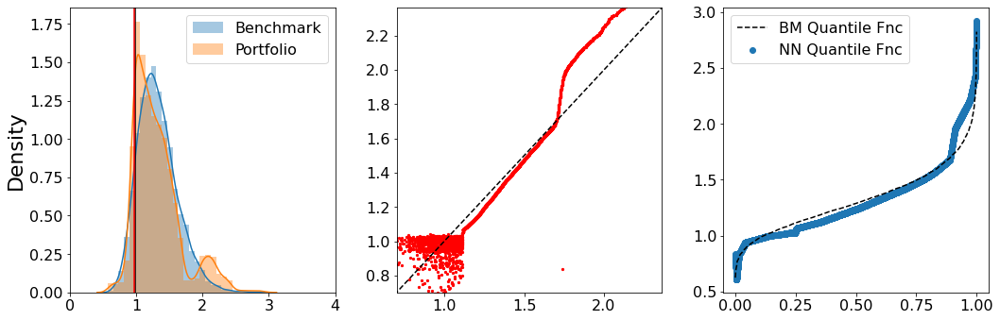

Epoch: 14 Iteration: 4998  duration =  84.187  secs
Budget Dist: 0.004 Wass Dist: 0.105 Risk Measure: -1.251 Loss: -1.240


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


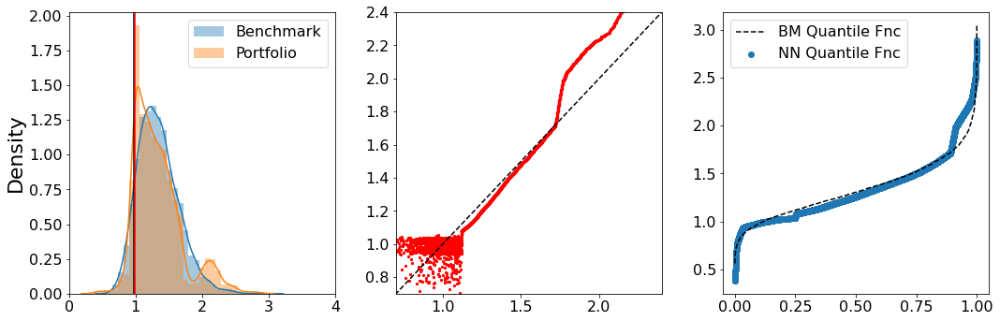

Epoch: 14 Iteration: 9997  duration =  71.830  secs
Budget Dist: 0.010 Wass Dist: 0.100 Risk Measure: -1.249 Loss: -1.238


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


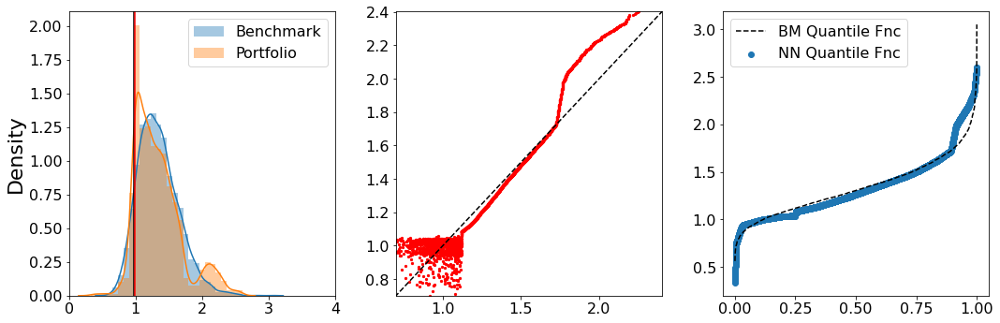

Epoch: 15 Iteration: 4998  duration =  84.450  secs
Budget Dist: 0.007 Wass Dist: 0.102 Risk Measure: -1.241 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


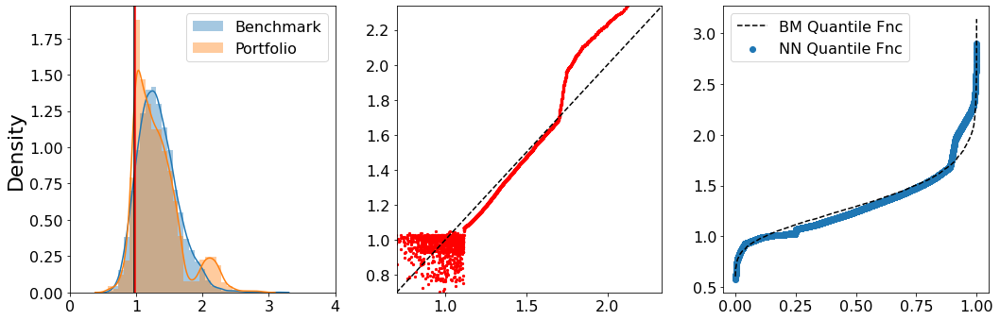

Epoch: 15 Iteration: 9997  duration =  71.799  secs
Budget Dist: -0.000 Wass Dist: 0.103 Risk Measure: -1.235 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


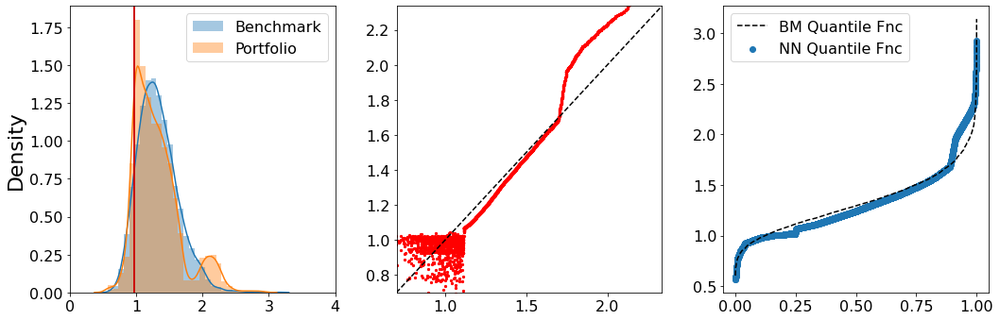

Epoch: 16 Iteration: 4998  duration =  84.068  secs
Budget Dist: 0.009 Wass Dist: 0.099 Risk Measure: -1.248 Loss: -1.239


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


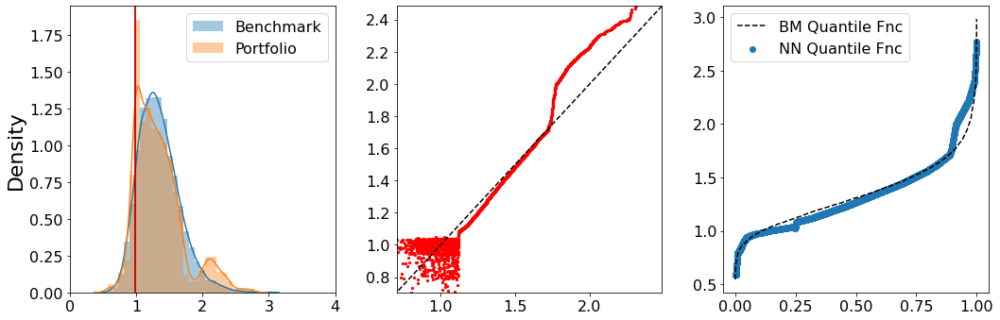

Epoch: 16 Iteration: 9997  duration =  71.617  secs
Budget Dist: 0.008 Wass Dist: 0.105 Risk Measure: -1.256 Loss: -1.241


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


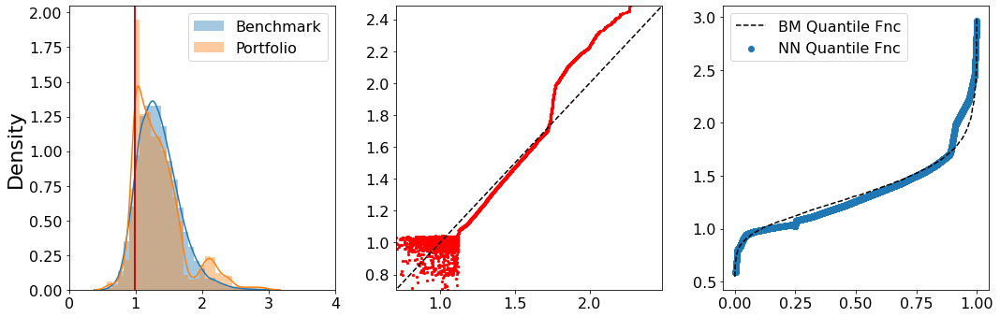

Epoch: 17 Iteration: 4998  duration =  84.055  secs
Budget Dist: 0.012 Wass Dist: 0.104 Risk Measure: -1.252 Loss: -1.234


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


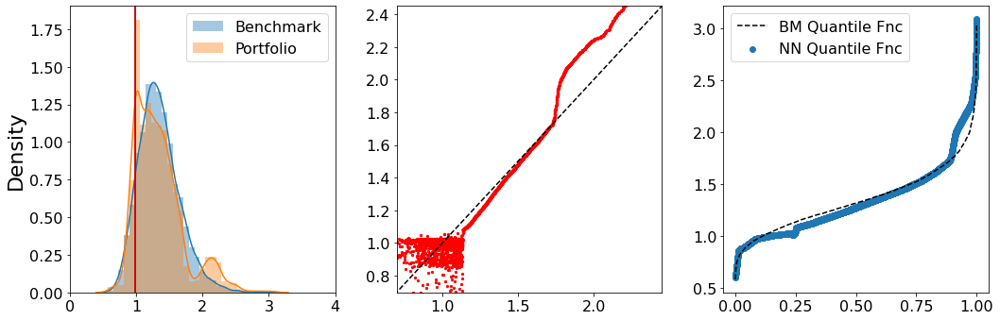

Epoch: 17 Iteration: 9997  duration =  71.561  secs
Budget Dist: 0.011 Wass Dist: 0.102 Risk Measure: -1.248 Loss: -1.234


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


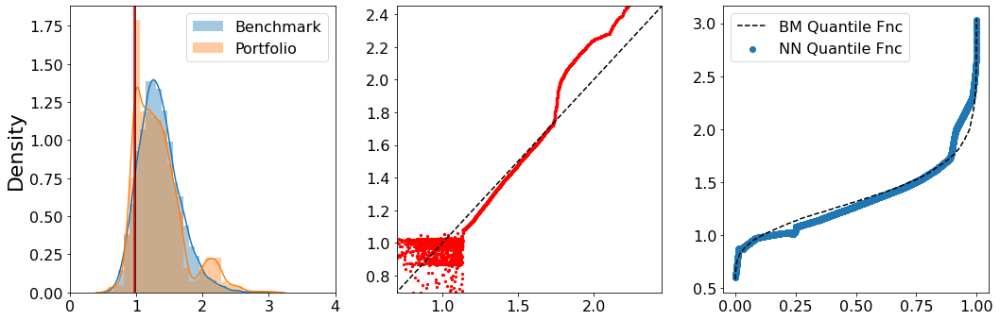

Epoch: 18 Iteration: 4998  duration =  83.974  secs
Budget Dist: 0.008 Wass Dist: 0.100 Risk Measure: -1.242 Loss: -1.233


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


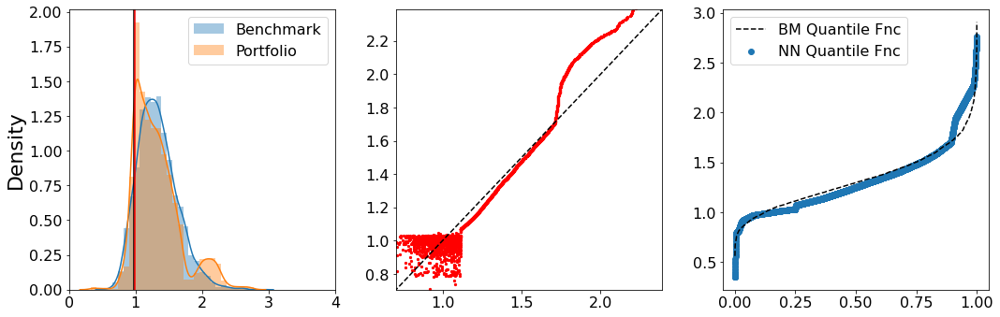

Epoch: 18 Iteration: 9997  duration =  71.670  secs
Budget Dist: 0.015 Wass Dist: 0.101 Risk Measure: -1.251 Loss: -1.233


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


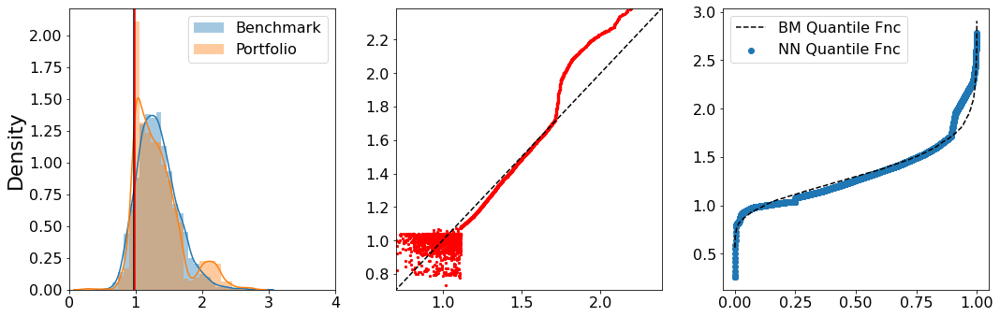

Epoch: 19 Iteration: 4998  duration =  84.373  secs
Budget Dist: 0.012 Wass Dist: 0.101 Risk Measure: -1.242 Loss: -1.228


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


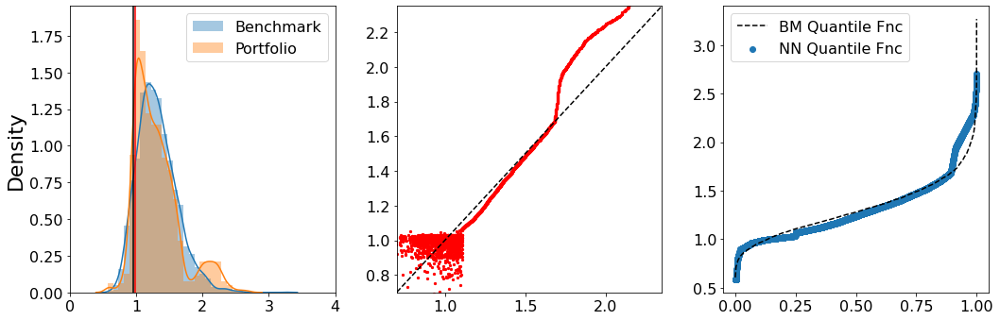

Epoch: 19 Iteration: 9997  duration =  71.723  secs
Budget Dist: 0.008 Wass Dist: 0.105 Risk Measure: -1.243 Loss: -1.228


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


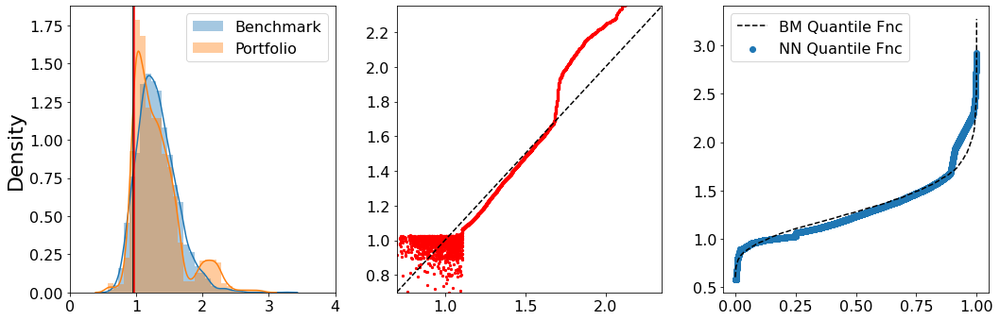

Epoch: 20 Iteration: 4998  duration =  83.740  secs
Budget Dist: 0.014 Wass Dist: 0.102 Risk Measure: -1.247 Loss: -1.230


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


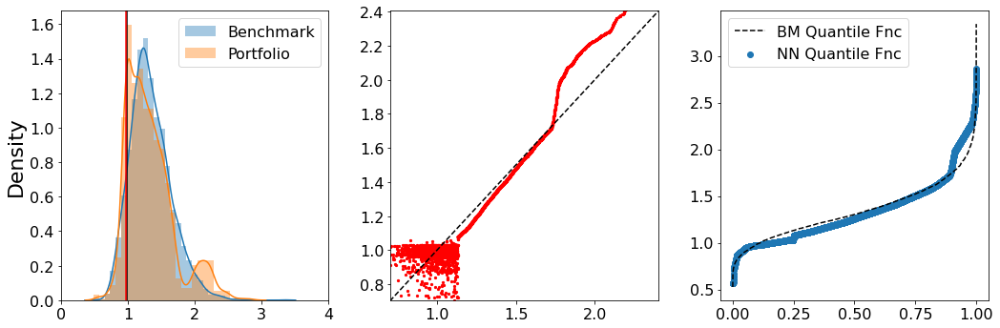

Epoch: 20 Iteration: 9997  duration =  71.474  secs
Budget Dist: 0.013 Wass Dist: 0.104 Risk Measure: -1.249 Loss: -1.230


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


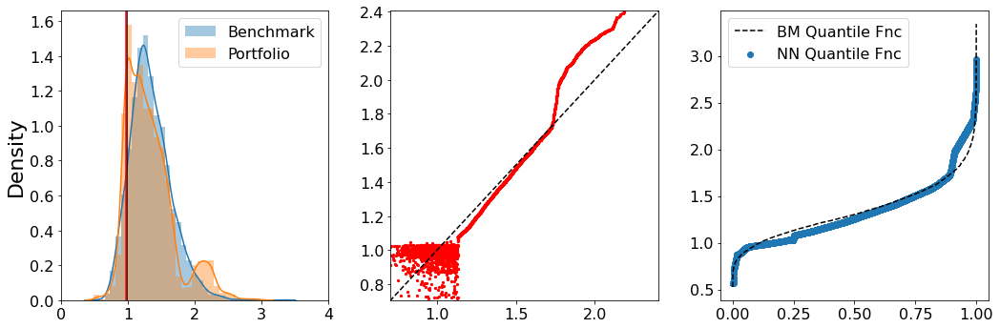

Epoch: 21 Iteration: 4998  duration =  84.288  secs
Budget Dist: -0.001 Wass Dist: 0.102 Risk Measure: -1.231 Loss: -1.229


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


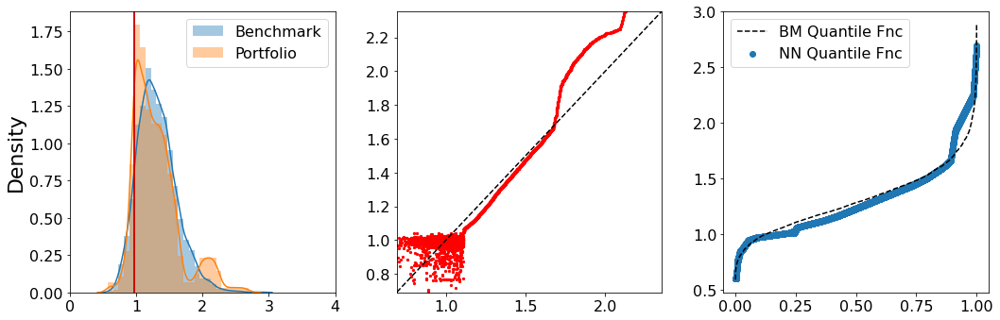

Epoch: 21 Iteration: 9997  duration =  71.502  secs
Budget Dist: 0.012 Wass Dist: 0.100 Risk Measure: -1.244 Loss: -1.229


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


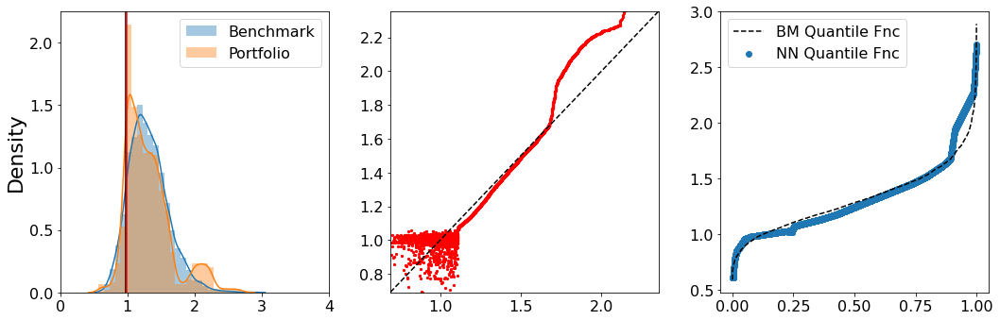

Epoch: 22 Iteration: 4998  duration =  84.105  secs
Budget Dist: 0.002 Wass Dist: 0.102 Risk Measure: -1.243 Loss: -1.239


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


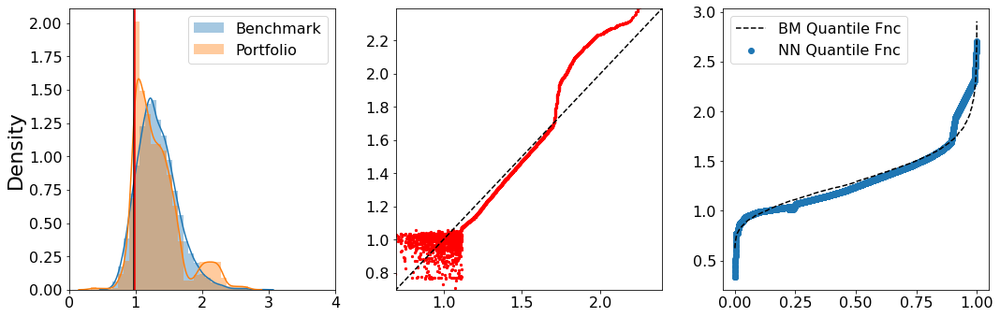

Epoch: 22 Iteration: 9997  duration =  71.813  secs
Budget Dist: 0.002 Wass Dist: 0.102 Risk Measure: -1.244 Loss: -1.239


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


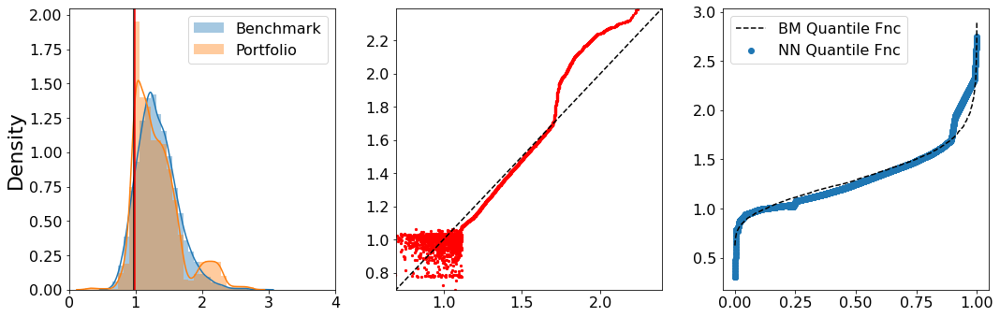

Epoch: 23 Iteration: 4998  duration =  84.477  secs
Budget Dist: 0.009 Wass Dist: 0.100 Risk Measure: -1.249 Loss: -1.240


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


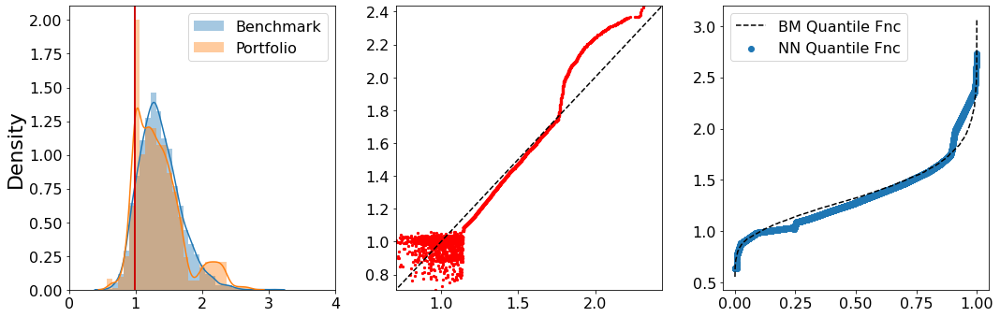

Epoch: 23 Iteration: 9997  duration =  71.890  secs
Budget Dist: 0.007 Wass Dist: 0.104 Risk Measure: -1.253 Loss: -1.241


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


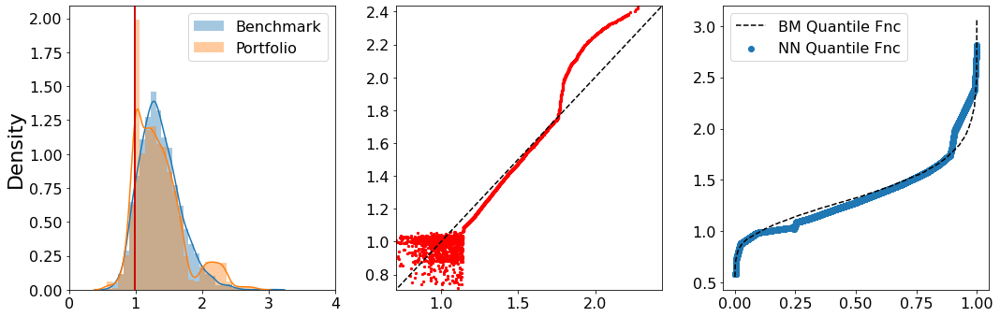

Epoch: 24 Iteration: 4998  duration =  84.489  secs
Budget Dist: 0.005 Wass Dist: 0.100 Risk Measure: -1.238 Loss: -1.232


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


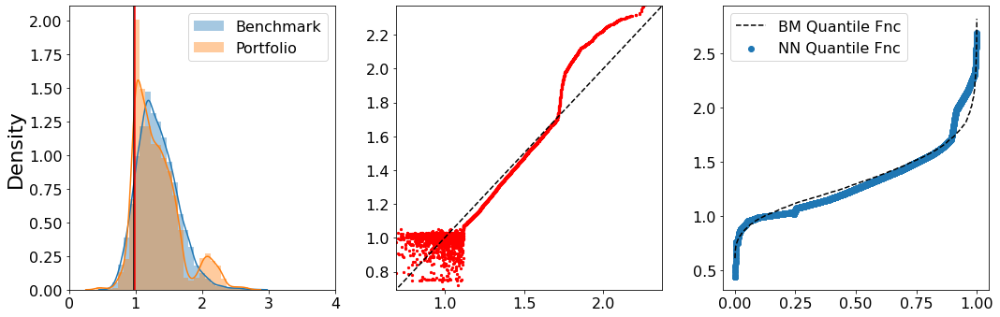

Epoch: 24 Iteration: 9997  duration =  71.770  secs
Budget Dist: 0.000 Wass Dist: 0.107 Risk Measure: -1.243 Loss: -1.234


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


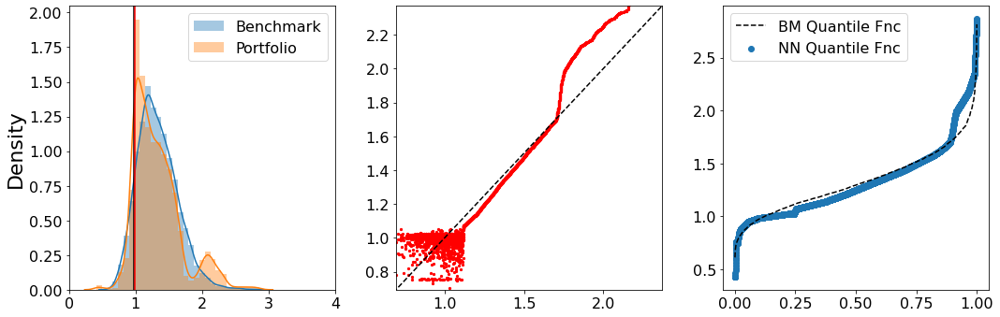

Epoch: 25 Iteration: 4998  duration =  84.194  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.240 Loss: -1.236


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


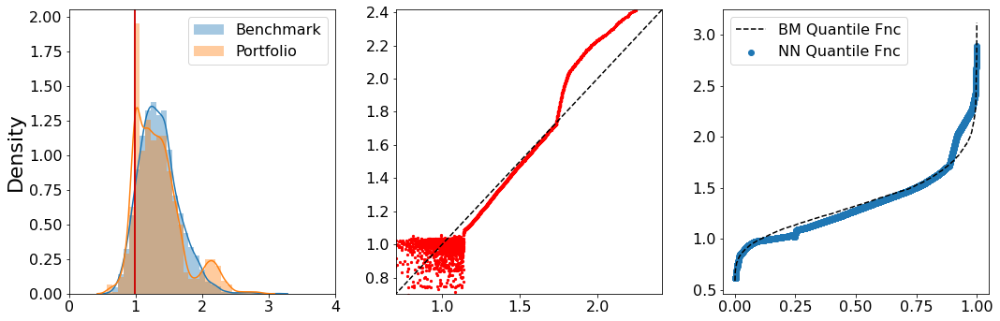

Epoch: 25 Iteration: 9997  duration =  71.777  secs
Budget Dist: 0.012 Wass Dist: 0.103 Risk Measure: -1.254 Loss: -1.237


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


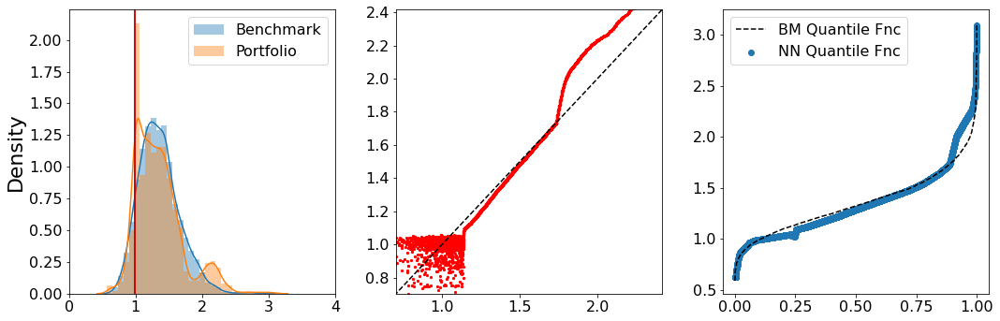

Epoch: 26 Iteration: 4998  duration =  83.940  secs
Budget Dist: 0.002 Wass Dist: 0.101 Risk Measure: -1.232 Loss: -1.229


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


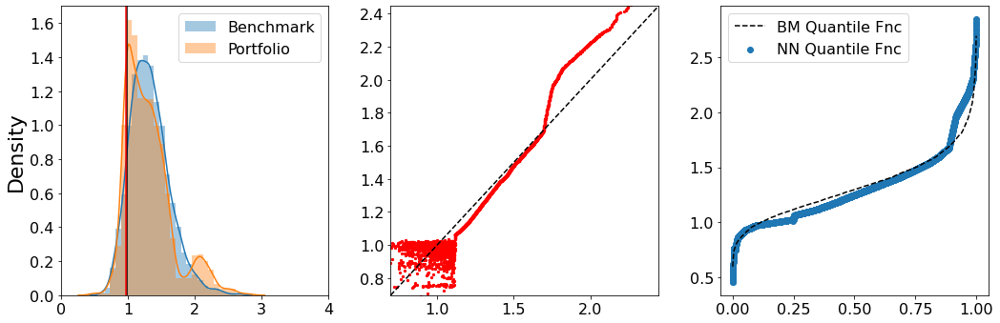

Epoch: 26 Iteration: 9997  duration =  72.231  secs
Budget Dist: 0.003 Wass Dist: 0.101 Risk Measure: -1.233 Loss: -1.229


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


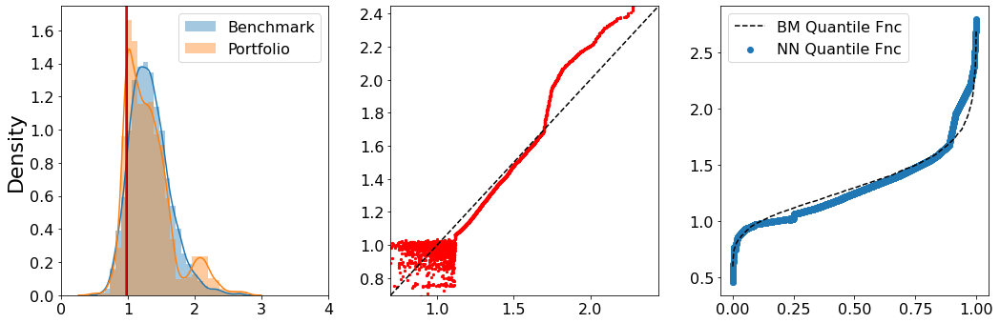

Epoch: 27 Iteration: 4998  duration =  84.278  secs
Budget Dist: 0.009 Wass Dist: 0.103 Risk Measure: -1.238 Loss: -1.224


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


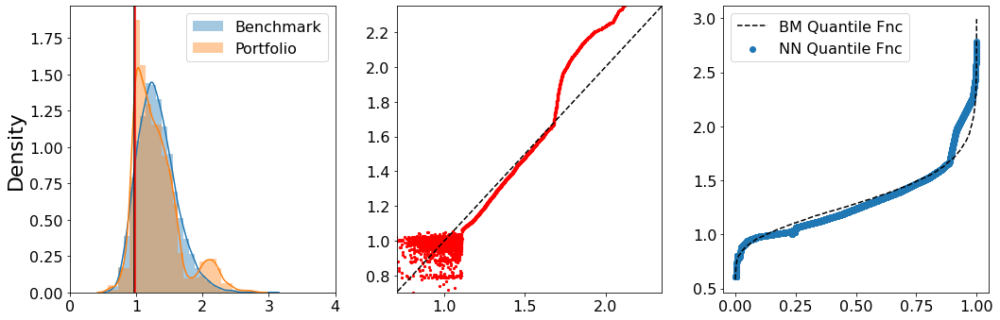

Epoch: 27 Iteration: 9997  duration =  71.733  secs
Budget Dist: 0.011 Wass Dist: 0.102 Risk Measure: -1.240 Loss: -1.225


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


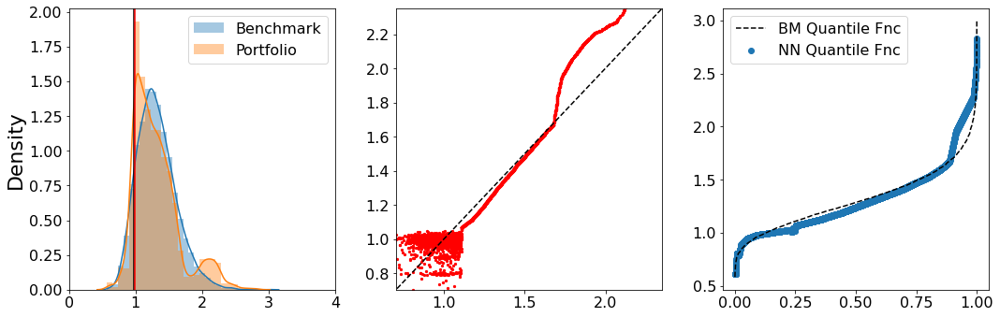

Epoch: 28 Iteration: 4998  duration =  83.732  secs
Budget Dist: 0.003 Wass Dist: 0.102 Risk Measure: -1.240 Loss: -1.235


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


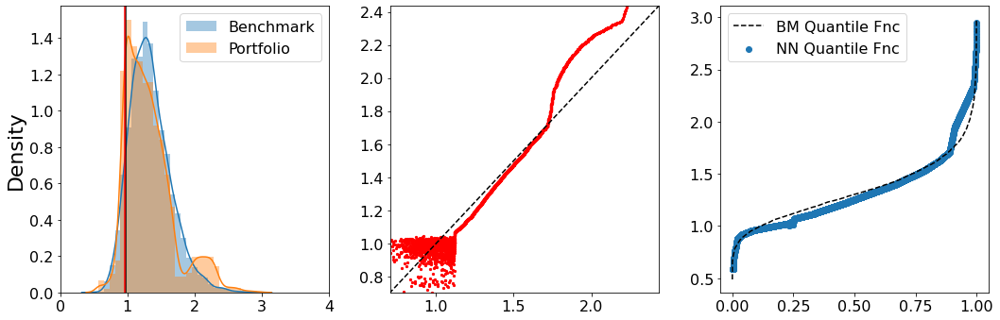

Epoch: 28 Iteration: 9997  duration =  71.905  secs
Budget Dist: 0.007 Wass Dist: 0.104 Risk Measure: -1.248 Loss: -1.235


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


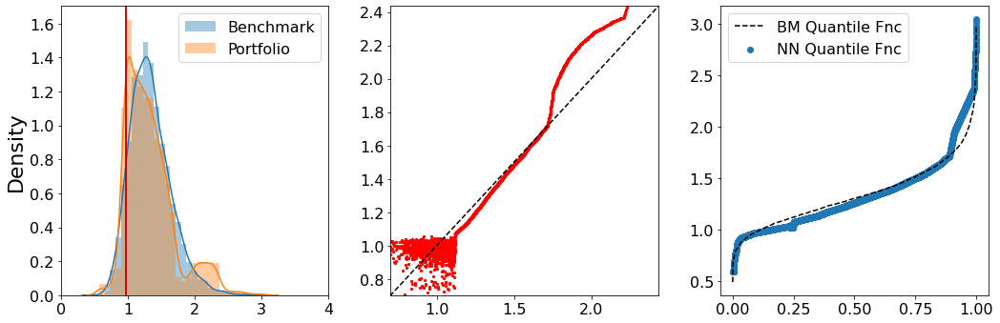

Epoch: 29 Iteration: 4998  duration =  84.157  secs
Budget Dist: 0.006 Wass Dist: 0.102 Risk Measure: -1.235 Loss: -1.226


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


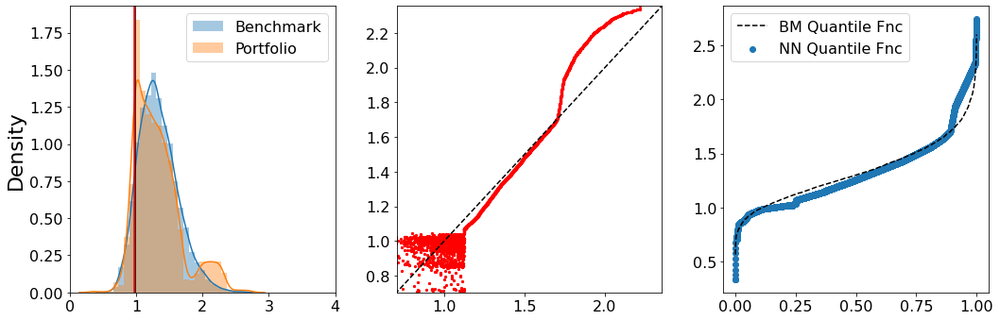

Epoch: 29 Iteration: 9997  duration =  71.686  secs
Budget Dist: 0.004 Wass Dist: 0.101 Risk Measure: -1.233 Loss: -1.226


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


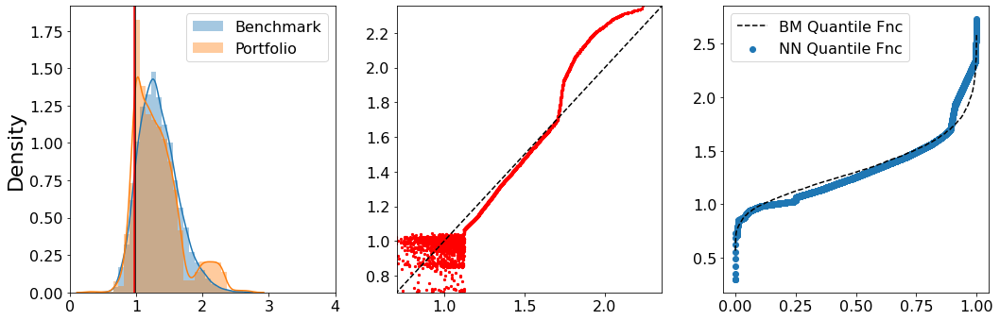

Epoch: 30 Iteration: 4998  duration =  84.207  secs
Budget Dist: 0.012 Wass Dist: 0.099 Risk Measure: -1.238 Loss: -1.225


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


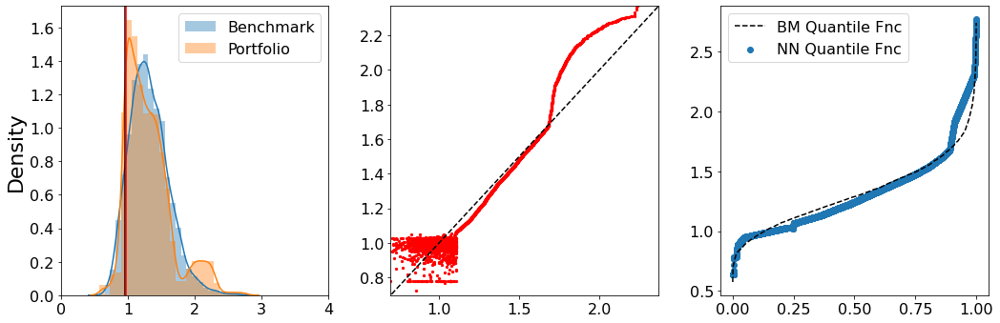

Epoch: 30 Iteration: 9997  duration =  71.698  secs
Budget Dist: 0.017 Wass Dist: 0.104 Risk Measure: -1.248 Loss: -1.225


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


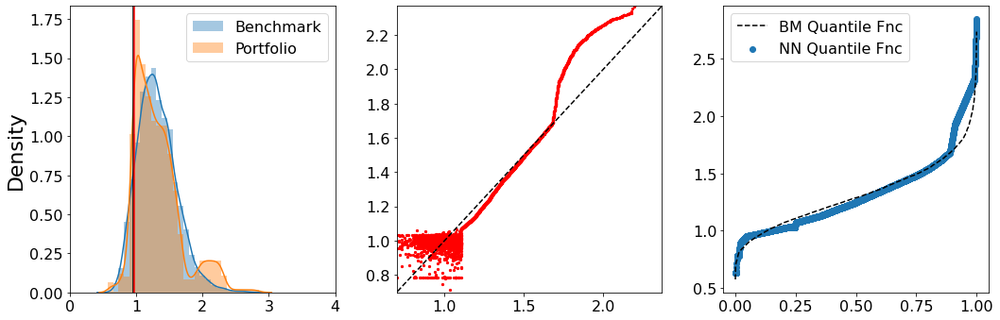

Epoch: 31 Iteration: 4998  duration =  84.364  secs
Budget Dist: 0.007 Wass Dist: 0.103 Risk Measure: -1.244 Loss: -1.233


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


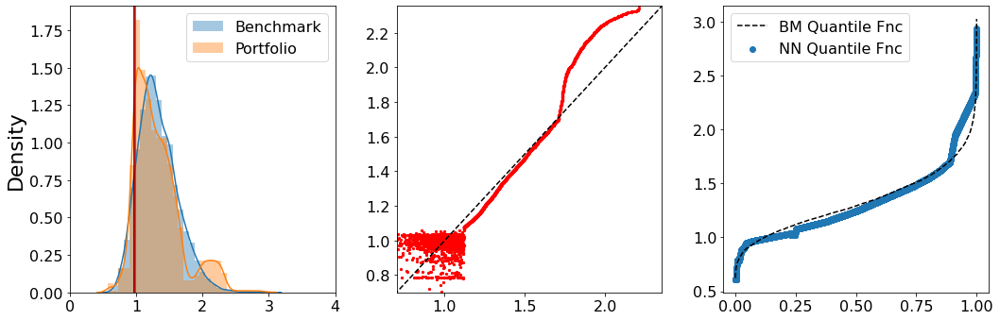

Epoch: 31 Iteration: 9997  duration =  71.641  secs
Budget Dist: 0.014 Wass Dist: 0.100 Risk Measure: -1.249 Loss: -1.233


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


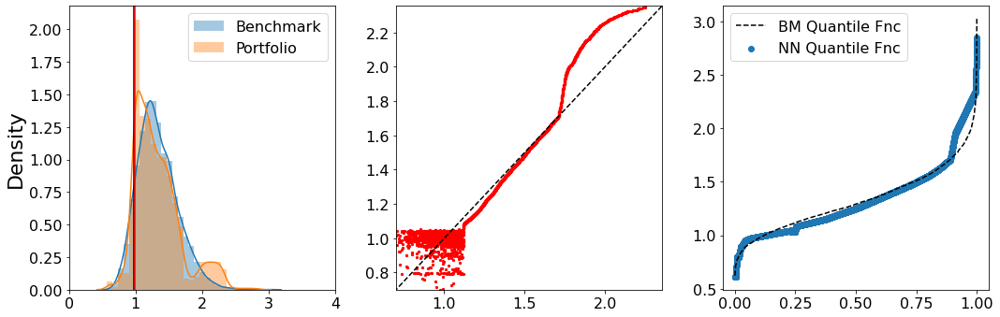

Epoch: 32 Iteration: 4998  duration =  84.550  secs
Budget Dist: 0.016 Wass Dist: 0.101 Risk Measure: -1.248 Loss: -1.230


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


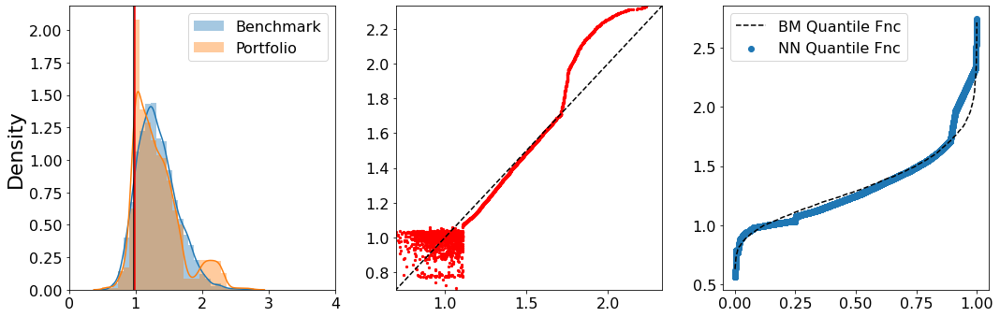

Epoch: 32 Iteration: 9997  duration =  71.957  secs
Budget Dist: 0.003 Wass Dist: 0.101 Risk Measure: -1.237 Loss: -1.231


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


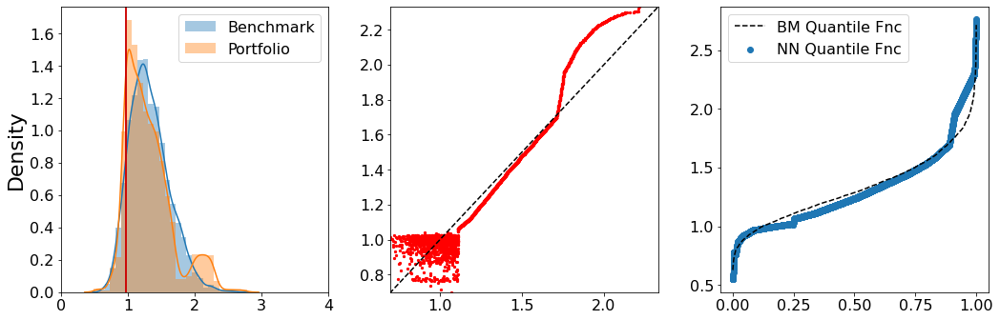

Epoch: 33 Iteration: 4998  duration =  84.126  secs
Budget Dist: 0.005 Wass Dist: 0.101 Risk Measure: -1.250 Loss: -1.243


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


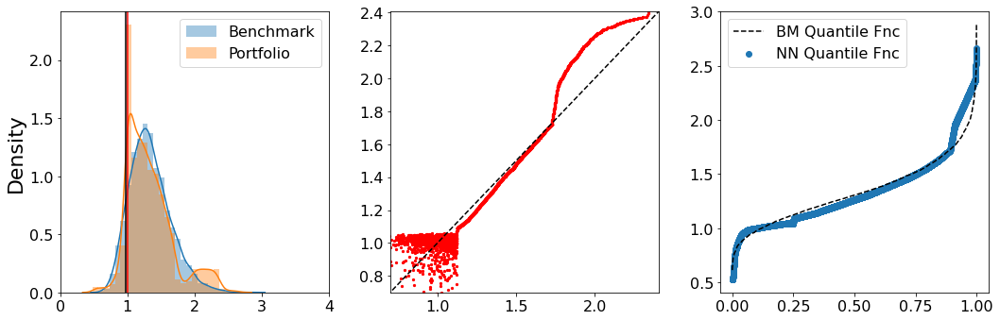

Epoch: 33 Iteration: 9997  duration =  71.707  secs
Budget Dist: 0.007 Wass Dist: 0.103 Risk Measure: -1.255 Loss: -1.244


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


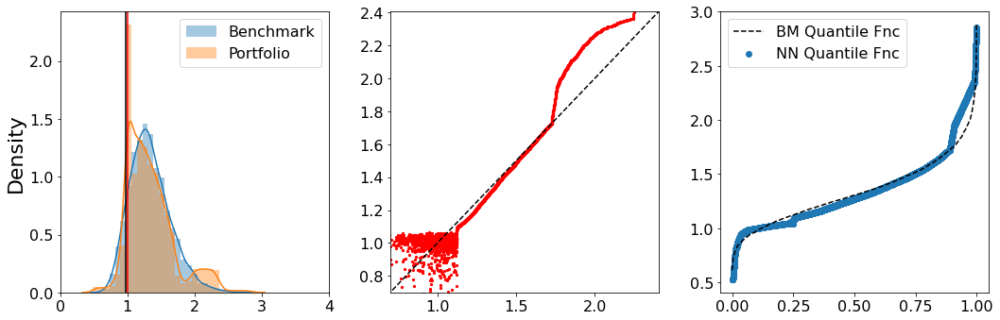

Epoch: 34 Iteration: 4998  duration =  84.824  secs
Budget Dist: 0.004 Wass Dist: 0.102 Risk Measure: -1.244 Loss: -1.238


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


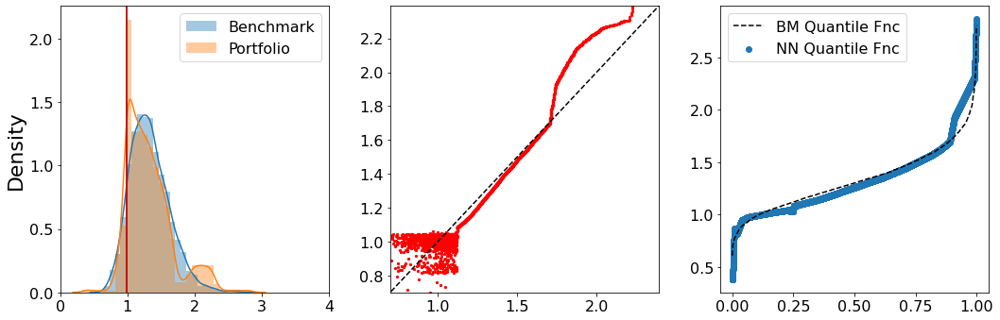

Epoch: 34 Iteration: 9997  duration =  71.927  secs
Budget Dist: 0.007 Wass Dist: 0.103 Risk Measure: -1.249 Loss: -1.238


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


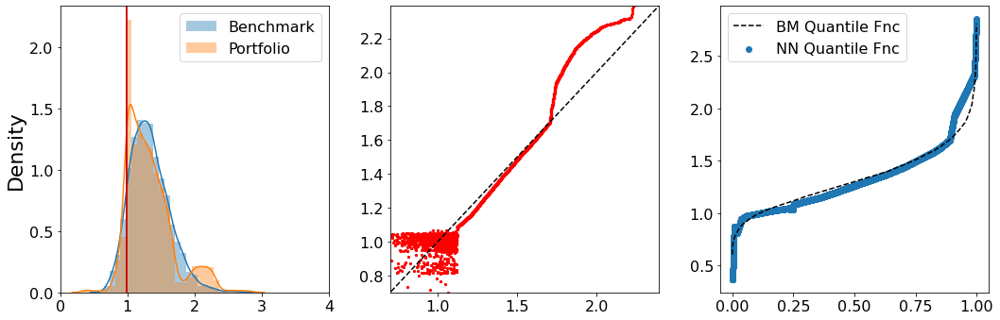

Epoch: 35 Iteration: 4998  duration =  84.537  secs
Budget Dist: 0.008 Wass Dist: 0.101 Risk Measure: -1.245 Loss: -1.235


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


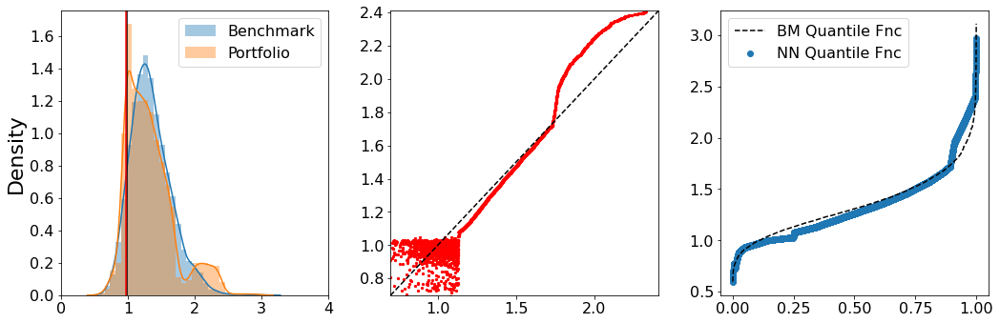

Epoch: 35 Iteration: 9997  duration =  71.753  secs
Budget Dist: 0.012 Wass Dist: 0.104 Risk Measure: -1.253 Loss: -1.235


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


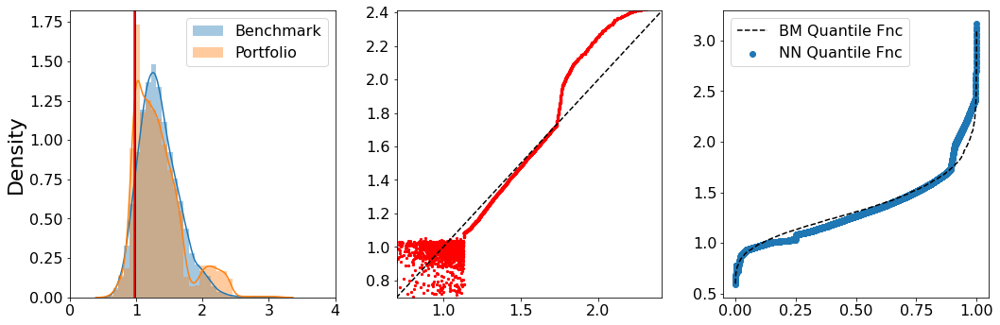

Epoch: 36 Iteration: 4998  duration =  84.590  secs
Budget Dist: 0.009 Wass Dist: 0.107 Risk Measure: -1.242 Loss: -1.224


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


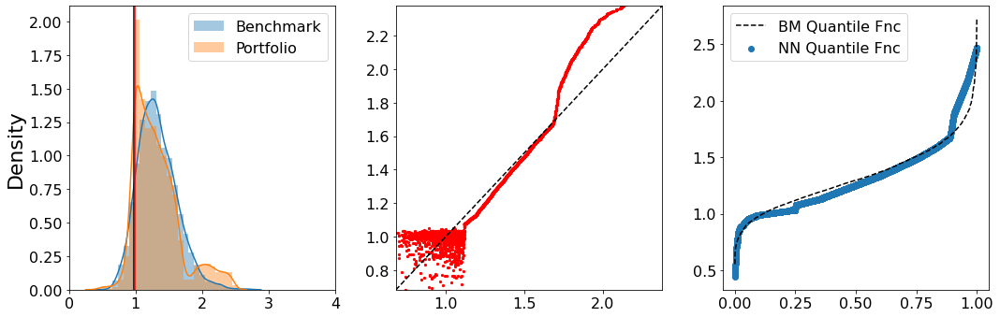

Epoch: 36 Iteration: 9997  duration =  73.650  secs
Budget Dist: 0.015 Wass Dist: 0.101 Risk Measure: -1.242 Loss: -1.224


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


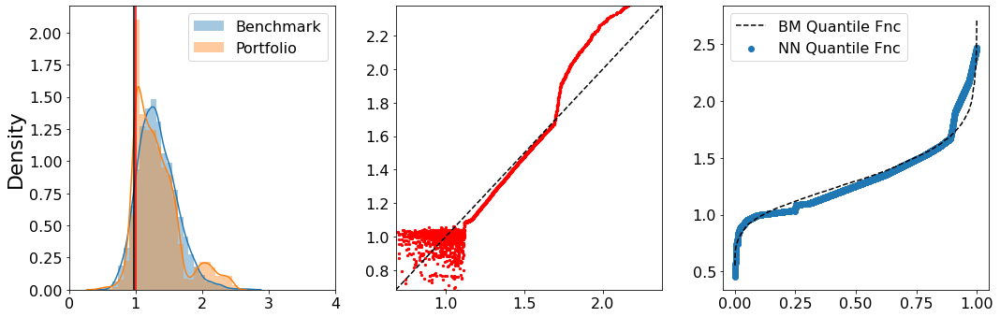

Epoch: 37 Iteration: 4998  duration =  84.301  secs
Budget Dist: 0.007 Wass Dist: 0.101 Risk Measure: -1.235 Loss: -1.226


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


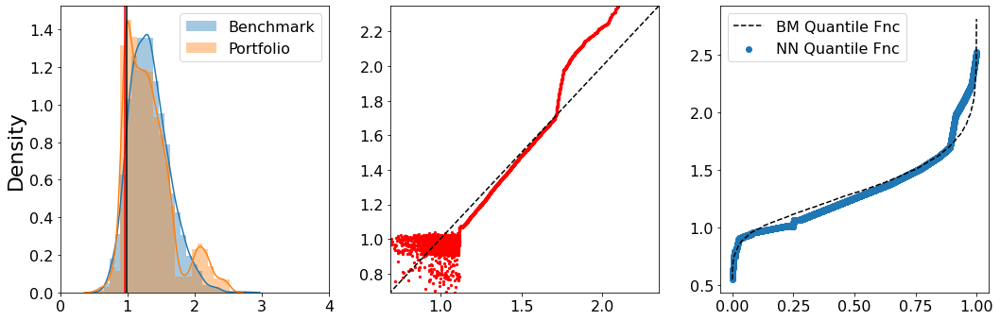

Epoch: 37 Iteration: 9997  duration =  71.892  secs
Budget Dist: 0.005 Wass Dist: 0.102 Risk Measure: -1.234 Loss: -1.226


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


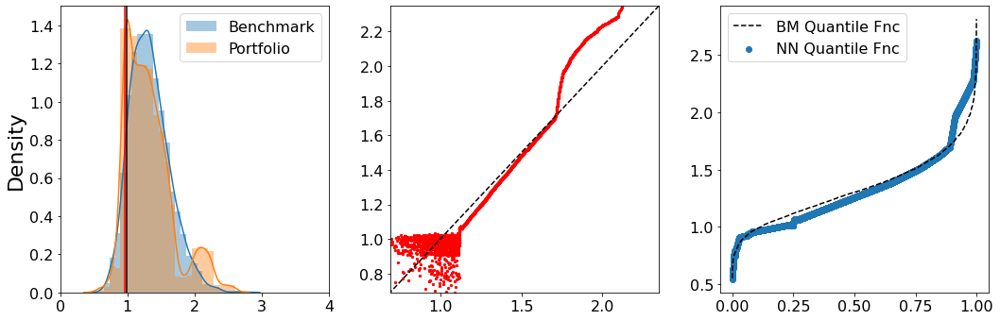

KeyboardInterrupt: ignored

In [ ]:
net = ValueNet(50).to(device)
model_name = "Copula_Distortion.pt"
T = 5
Ndt = 252*T
Nsims = 5000
Nepochs = 50
Train_ValueNet_Copula(net, model_name, params_MV,  Ndt, T, Nsims, Nepochs, Update = "distortion")

Epoch: 0 Iteration: 4998  duration =  35.376  secs
Budget Dist: 0.007 Wass Dist: 0.094 Risk Measure: -1.201 Loss: -1.188


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


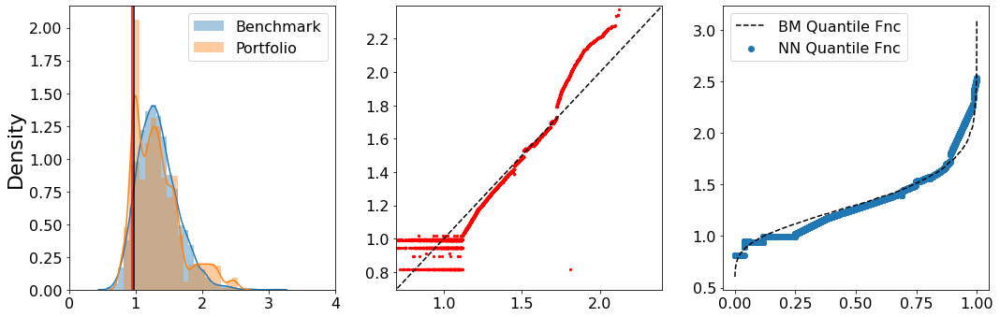

Epoch: 0 Iteration: 9997  duration =  24.747  secs
Budget Dist: -0.006 Wass Dist: 0.101 Risk Measure: -1.206 Loss: -1.204


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


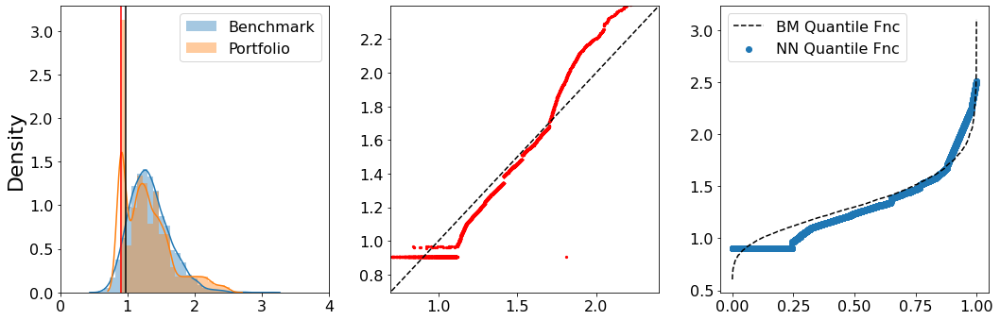

Epoch: 1 Iteration: 4998  duration =  36.765  secs
Budget Dist: 0.006 Wass Dist: 0.099 Risk Measure: -1.225 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


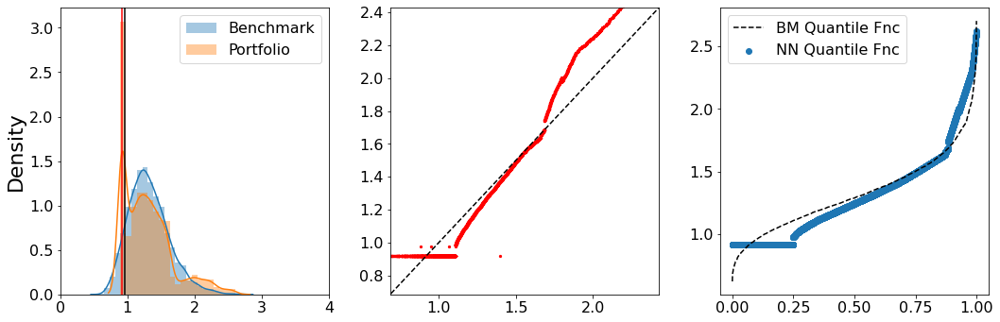

Epoch: 1 Iteration: 9997  duration =  24.826  secs
Budget Dist: 0.000 Wass Dist: 0.098 Risk Measure: -1.217 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


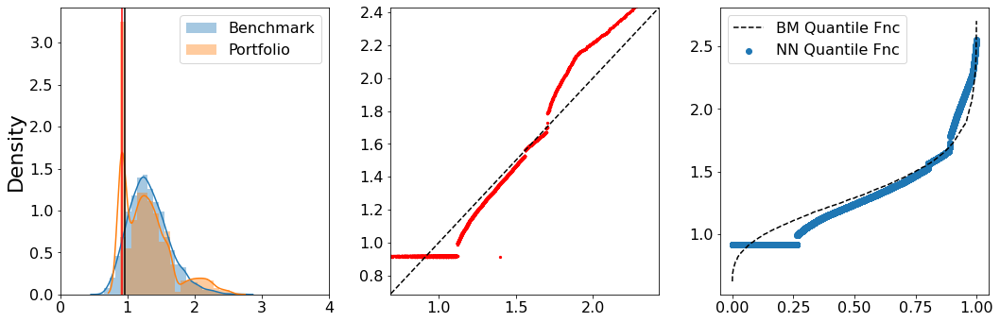

Epoch: 2 Iteration: 4998  duration =  36.588  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.219 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


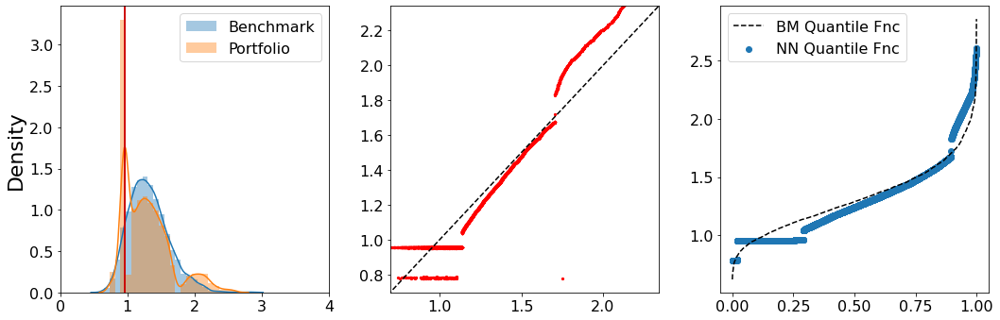

Epoch: 2 Iteration: 9997  duration =  24.853  secs
Budget Dist: -0.000 Wass Dist: 0.099 Risk Measure: -1.214 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


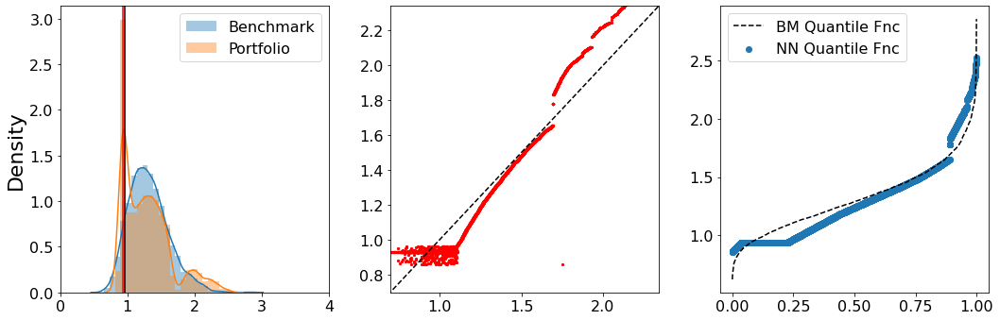

Epoch: 3 Iteration: 4998  duration =  36.453  secs
Budget Dist: -0.000 Wass Dist: 0.104 Risk Measure: -1.218 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


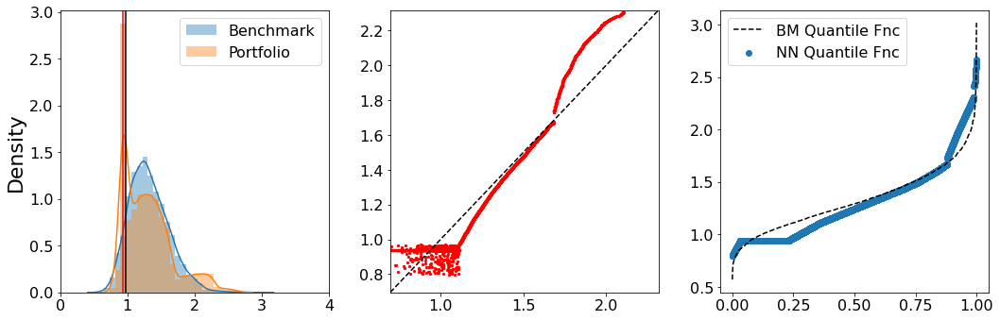

Epoch: 3 Iteration: 9997  duration =  24.836  secs
Budget Dist: 0.006 Wass Dist: 0.100 Risk Measure: -1.222 Loss: -1.210


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


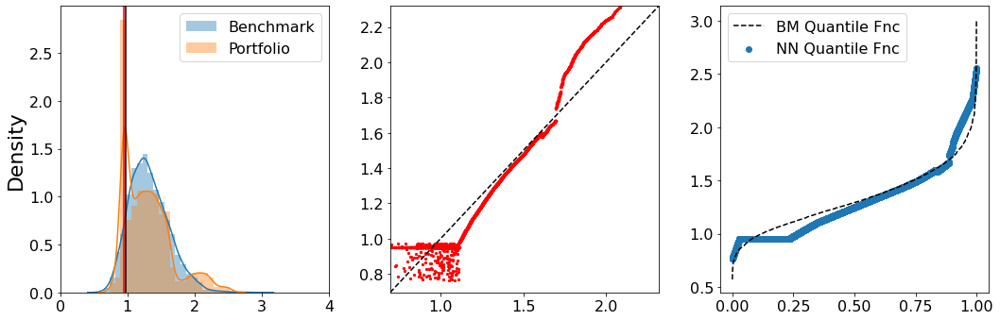

Epoch: 4 Iteration: 4998  duration =  36.514  secs
Budget Dist: 0.004 Wass Dist: 0.101 Risk Measure: -1.217 Loss: -1.208


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


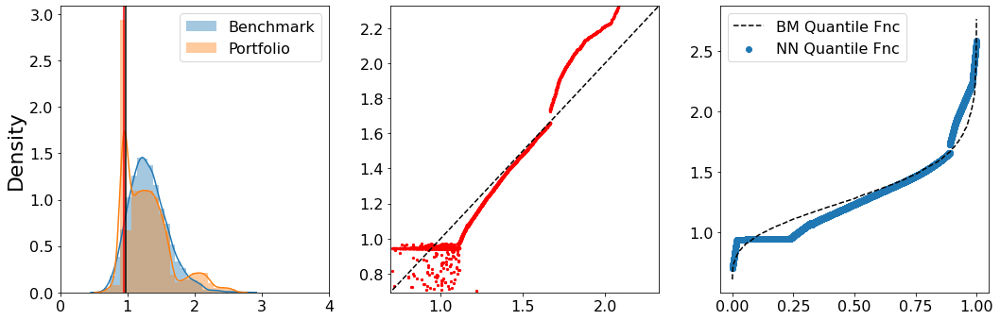

Epoch: 4 Iteration: 9997  duration =  25.225  secs
Budget Dist: 0.001 Wass Dist: 0.101 Risk Measure: -1.219 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


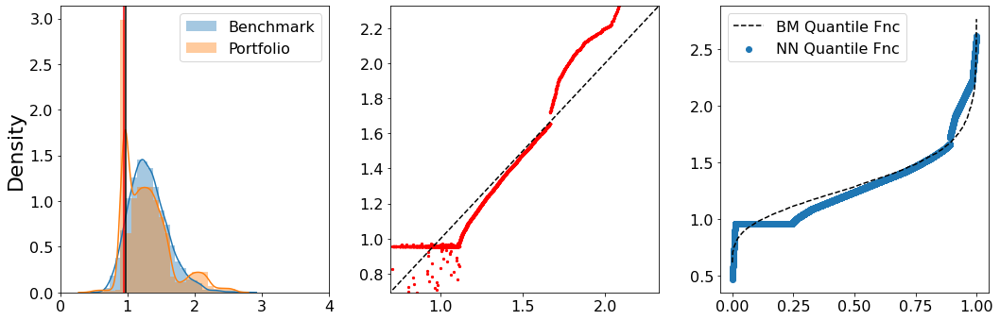

Epoch: 5 Iteration: 4998  duration =  36.480  secs
Budget Dist: -0.000 Wass Dist: 0.101 Risk Measure: -1.221 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


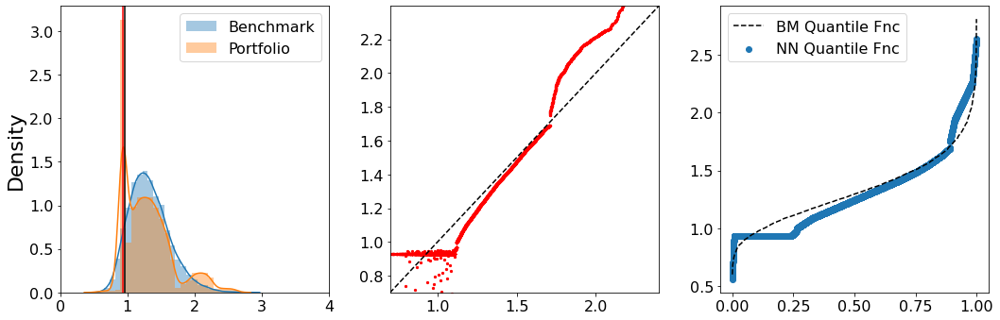

Epoch: 5 Iteration: 9997  duration =  24.776  secs
Budget Dist: 0.000 Wass Dist: 0.099 Risk Measure: -1.220 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


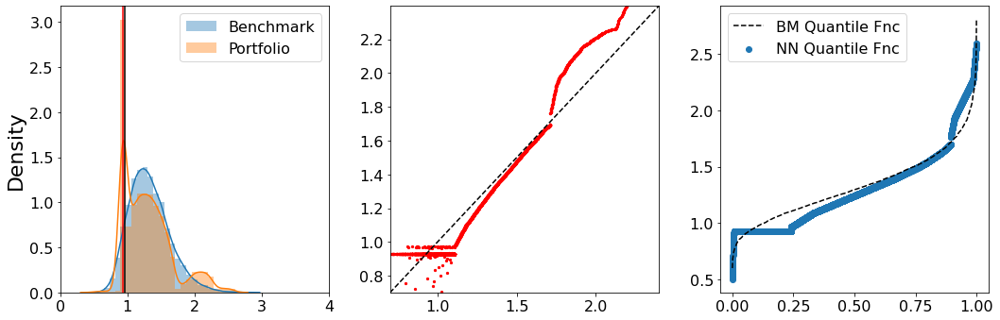

Epoch: 6 Iteration: 4998  duration =  36.854  secs
Budget Dist: 0.003 Wass Dist: 0.113 Risk Measure: -1.220 Loss: -1.189


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


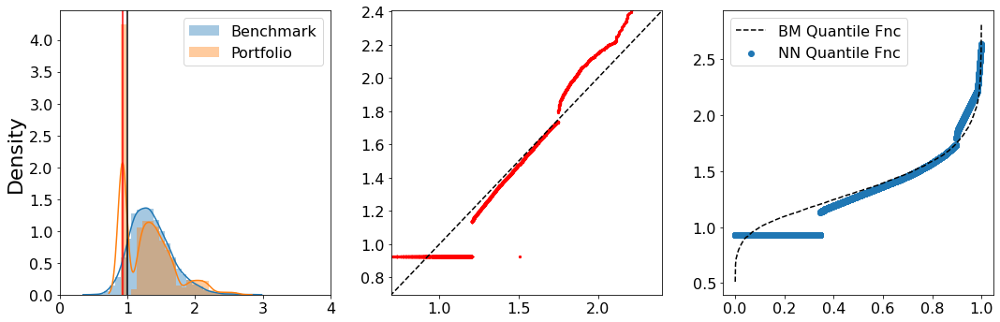

Epoch: 6 Iteration: 9997  duration =  24.849  secs
Budget Dist: 0.006 Wass Dist: 0.114 Risk Measure: -1.224 Loss: -1.185


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


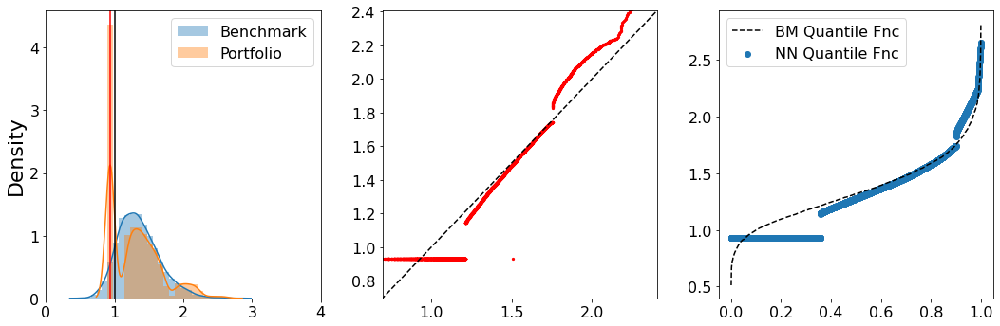

Epoch: 7 Iteration: 4998  duration =  36.697  secs
Budget Dist: 0.004 Wass Dist: 0.115 Risk Measure: -1.216 Loss: -1.178


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


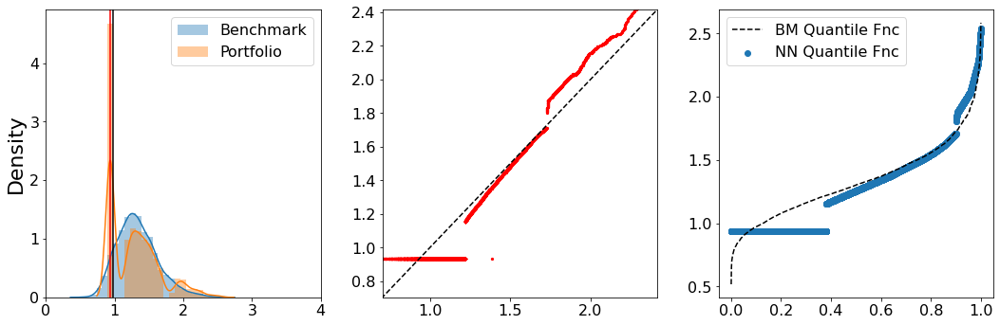

Epoch: 7 Iteration: 9997  duration =  24.749  secs
Budget Dist: 0.006 Wass Dist: 0.121 Risk Measure: -1.222 Loss: -1.168


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


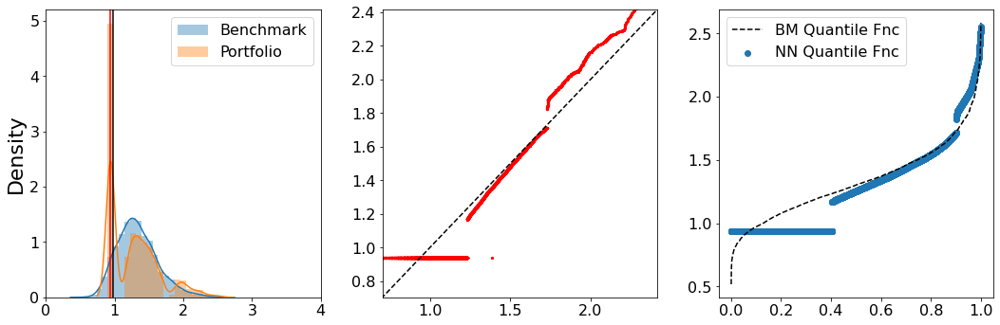

Epoch: 8 Iteration: 4998  duration =  36.358  secs
Budget Dist: 0.004 Wass Dist: 0.099 Risk Measure: -1.213 Loss: -1.206


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


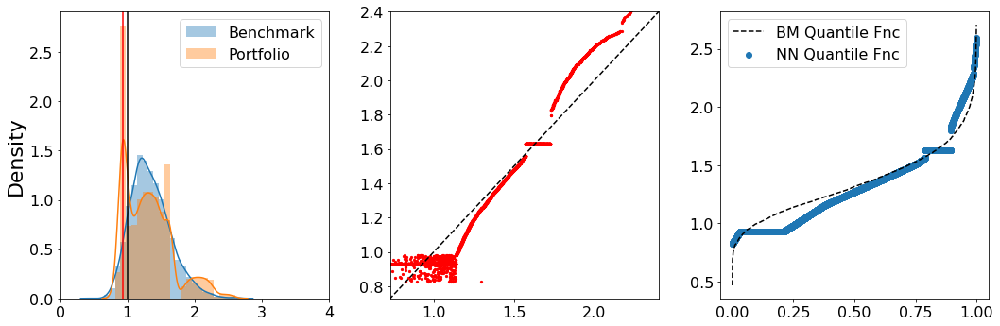

Epoch: 8 Iteration: 9997  duration =  25.082  secs
Budget Dist: 0.004 Wass Dist: 0.102 Risk Measure: -1.221 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


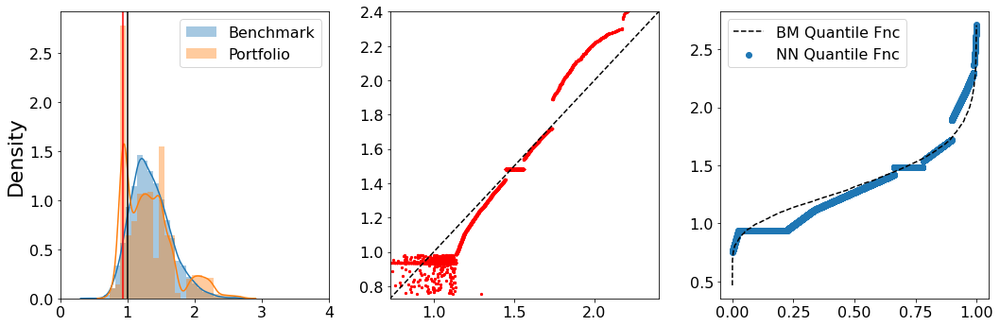

Epoch: 9 Iteration: 4998  duration =  36.670  secs
Budget Dist: -0.001 Wass Dist: 0.101 Risk Measure: -1.215 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


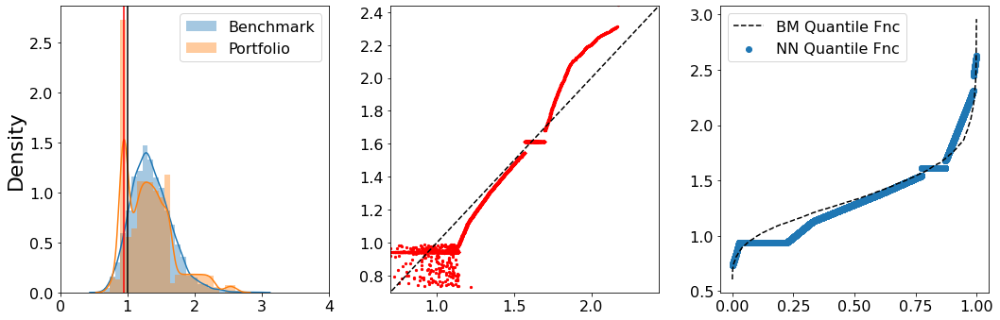

Epoch: 9 Iteration: 9997  duration =  24.898  secs
Budget Dist: -0.000 Wass Dist: 0.101 Risk Measure: -1.217 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


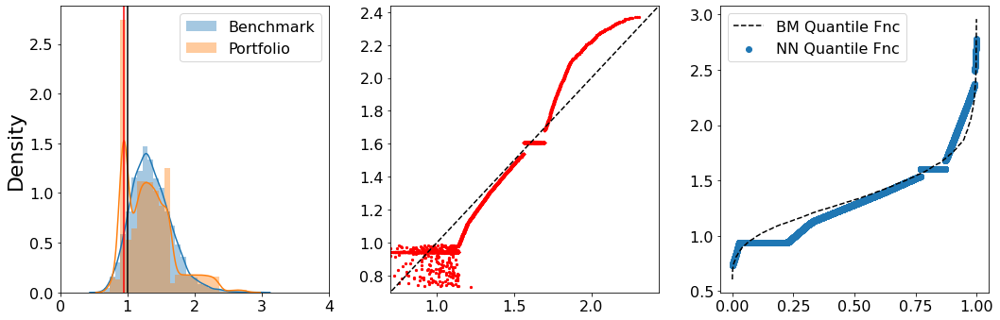

Epoch: 10 Iteration: 4998  duration =  36.704  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.223 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


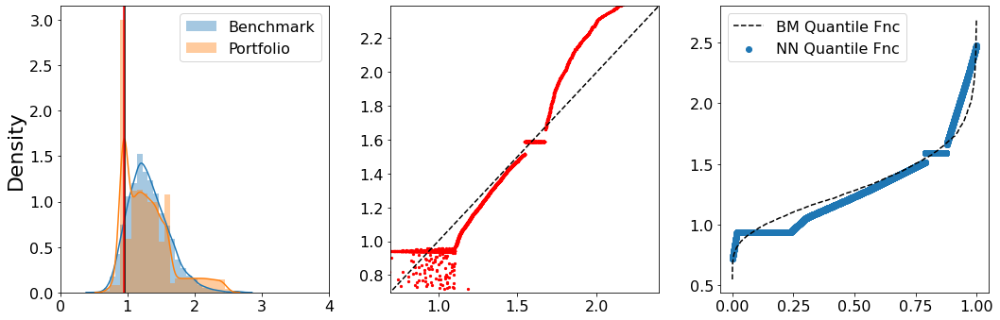

Epoch: 10 Iteration: 9997  duration =  25.092  secs
Budget Dist: 0.002 Wass Dist: 0.098 Risk Measure: -1.221 Loss: -1.217


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


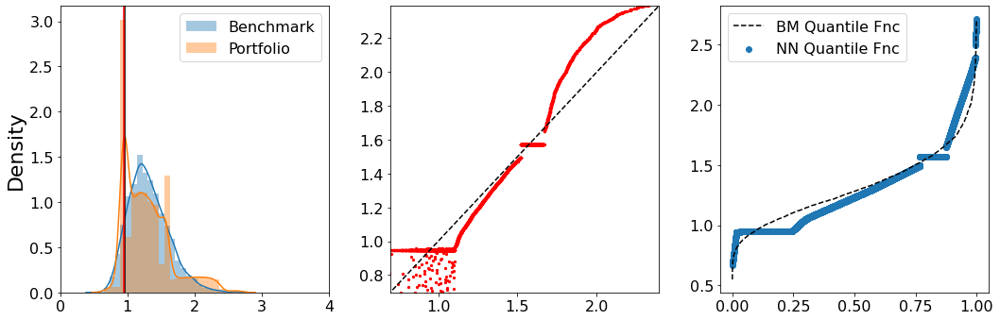

Epoch: 11 Iteration: 4998  duration =  36.641  secs
Budget Dist: -0.002 Wass Dist: 0.104 Risk Measure: -1.225 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


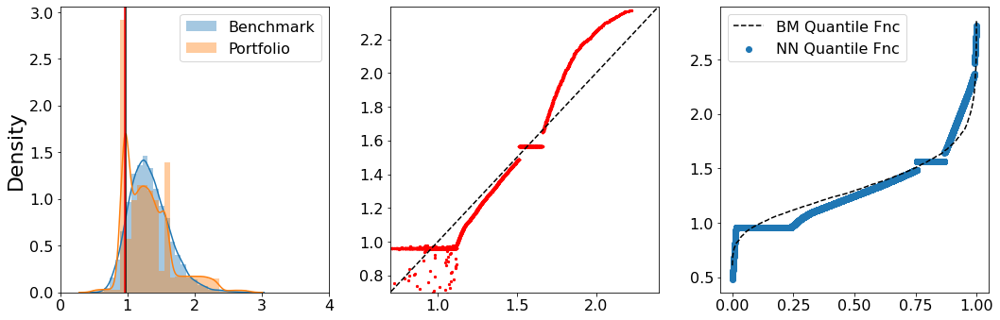

Epoch: 11 Iteration: 9997  duration =  24.952  secs
Budget Dist: -0.000 Wass Dist: 0.098 Risk Measure: -1.221 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


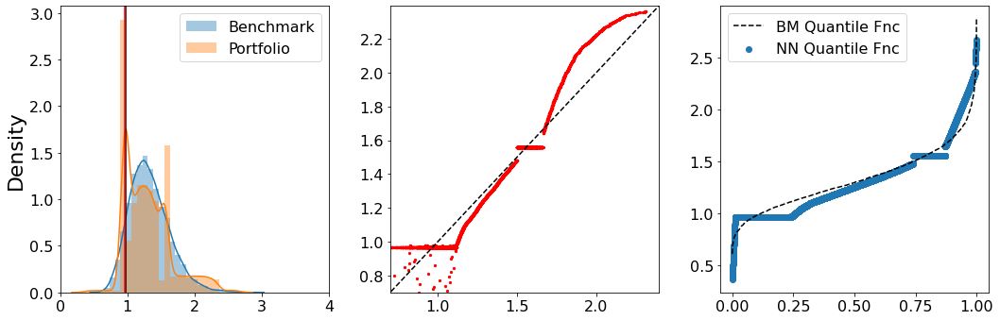

Epoch: 12 Iteration: 4998  duration =  37.037  secs
Budget Dist: 0.008 Wass Dist: 0.101 Risk Measure: -1.222 Loss: -1.205


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


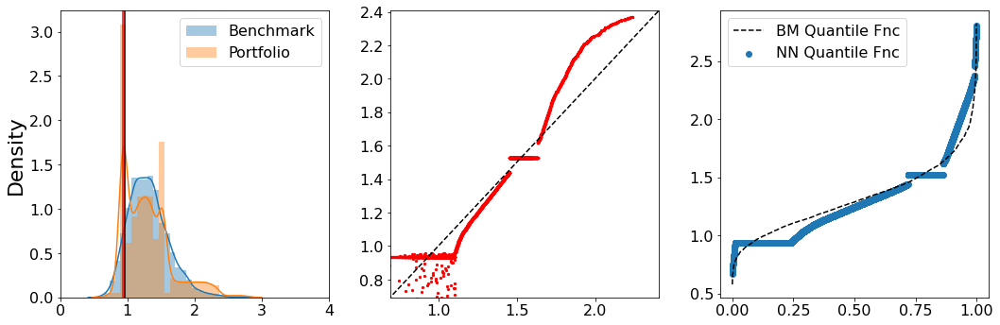

Epoch: 12 Iteration: 9997  duration =  24.977  secs
Budget Dist: 0.006 Wass Dist: 0.101 Risk Measure: -1.220 Loss: -1.206


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


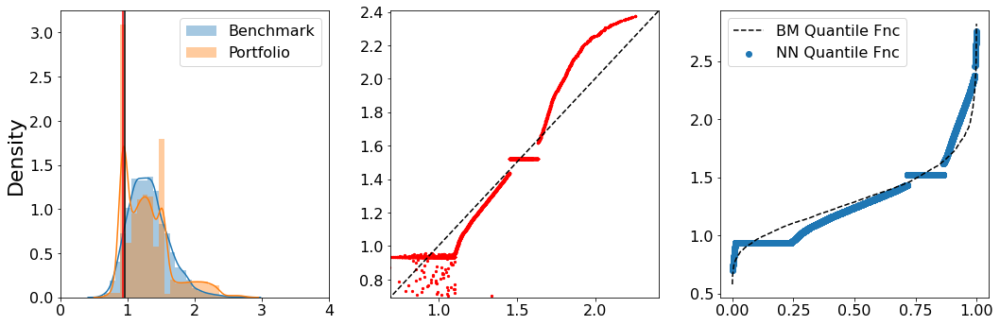

Epoch: 13 Iteration: 4998  duration =  36.712  secs
Budget Dist: -0.005 Wass Dist: 0.104 Risk Measure: -1.208 Loss: -1.199


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


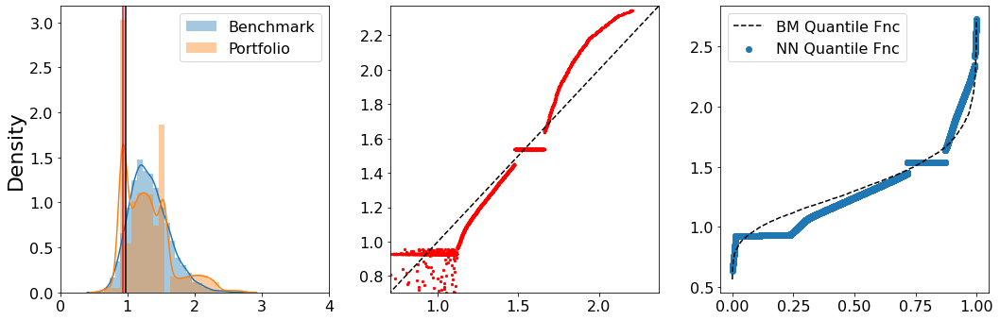

Epoch: 13 Iteration: 9997  duration =  24.991  secs
Budget Dist: 0.003 Wass Dist: 0.100 Risk Measure: -1.213 Loss: -1.207


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


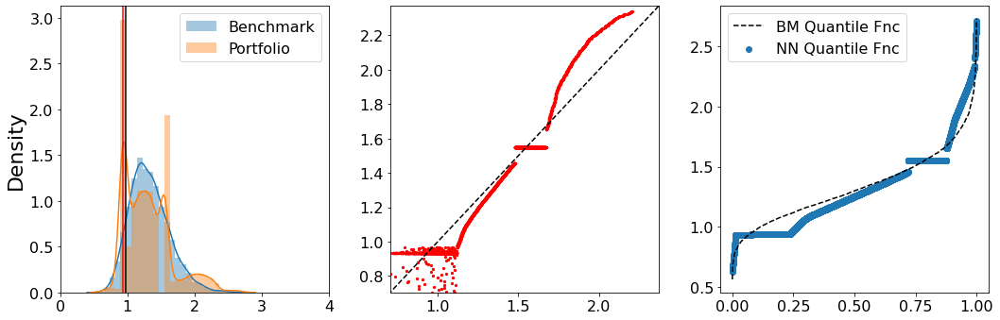

Epoch: 14 Iteration: 4998  duration =  36.969  secs
Budget Dist: 0.001 Wass Dist: 0.098 Risk Measure: -1.215 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


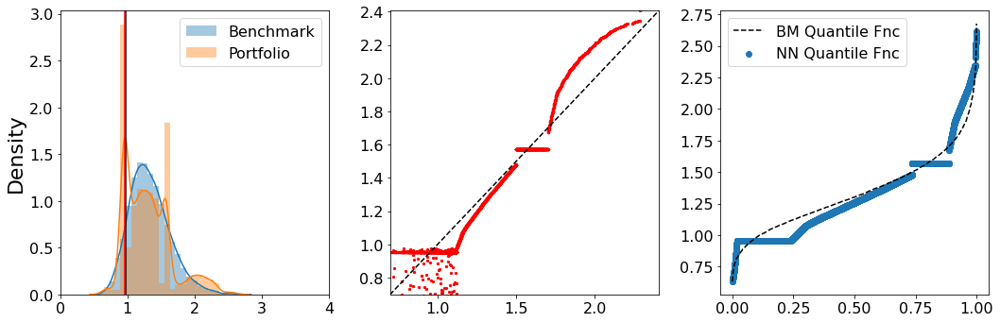

Epoch: 14 Iteration: 9997  duration =  25.101  secs
Budget Dist: 0.007 Wass Dist: 0.101 Risk Measure: -1.227 Loss: -1.211


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


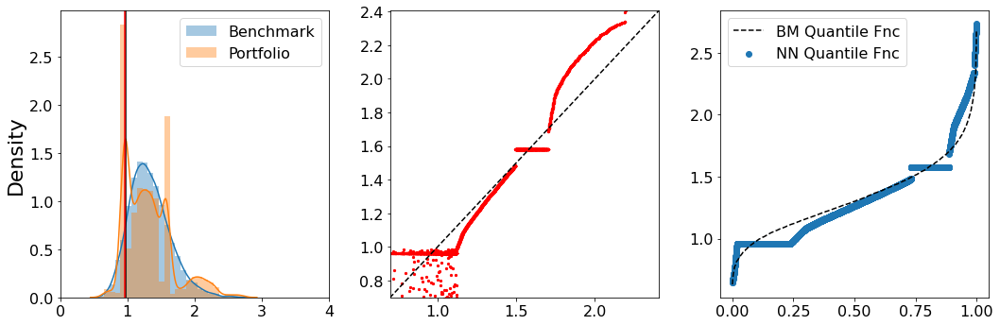

Epoch: 15 Iteration: 4998  duration =  36.404  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.212 Loss: -1.208


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


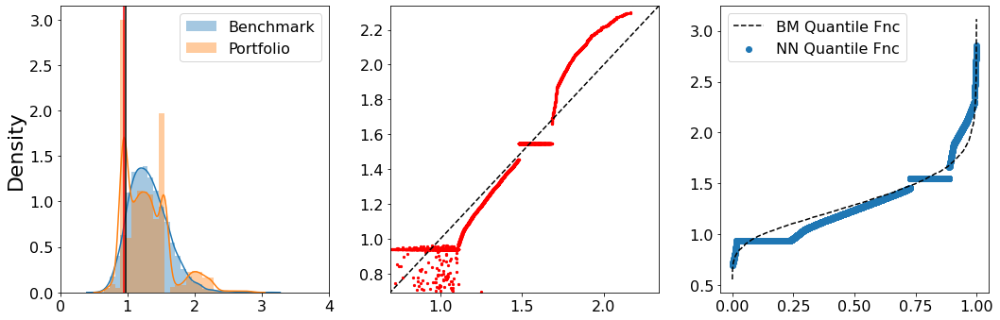

Epoch: 15 Iteration: 9997  duration =  25.026  secs
Budget Dist: -0.003 Wass Dist: 0.102 Risk Measure: -1.208 Loss: -1.203


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


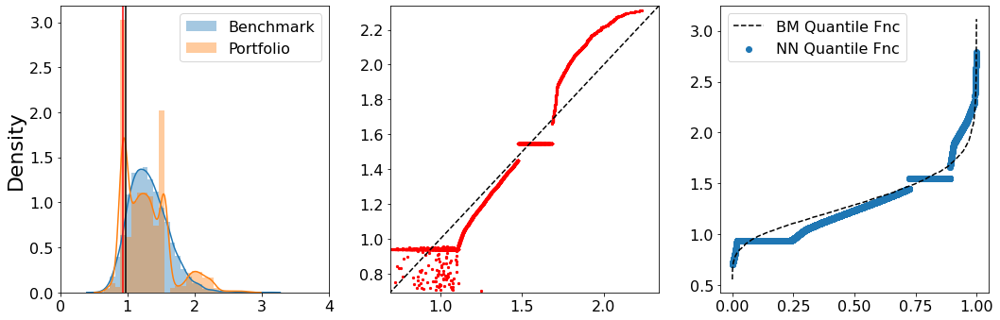

Epoch: 16 Iteration: 4998  duration =  36.741  secs
Budget Dist: 0.001 Wass Dist: 0.099 Risk Measure: -1.216 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


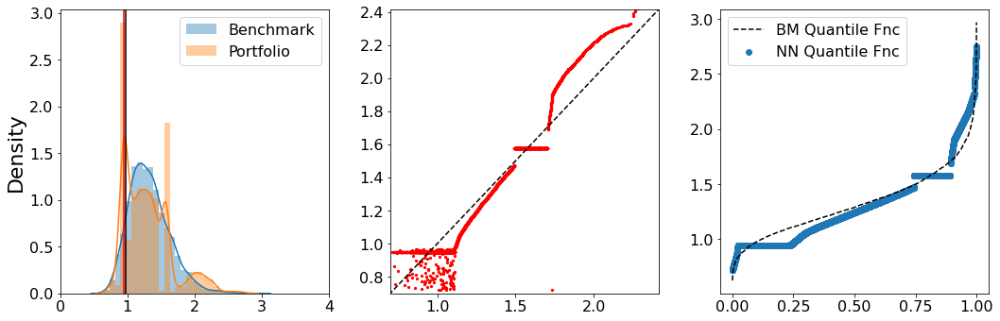

Epoch: 16 Iteration: 9997  duration =  25.400  secs
Budget Dist: 0.001 Wass Dist: 0.099 Risk Measure: -1.215 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


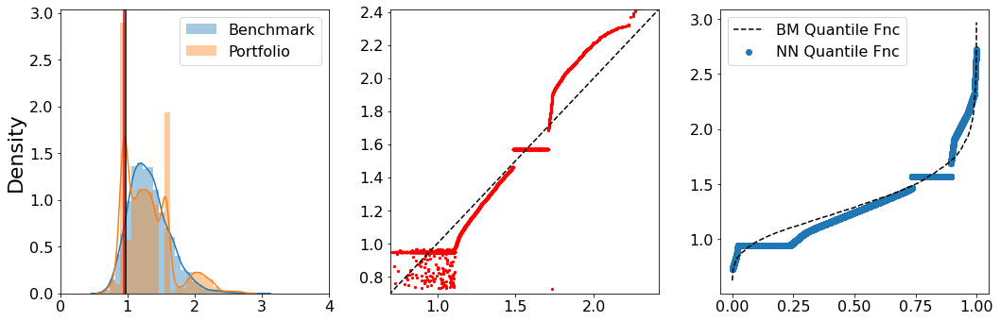

Epoch: 17 Iteration: 4998  duration =  36.958  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.213 Loss: -1.212


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


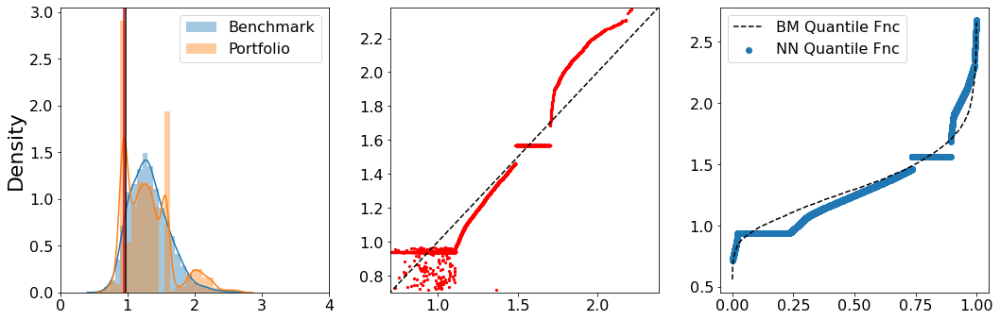

Epoch: 17 Iteration: 9997  duration =  24.961  secs
Budget Dist: 0.004 Wass Dist: 0.099 Risk Measure: -1.216 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


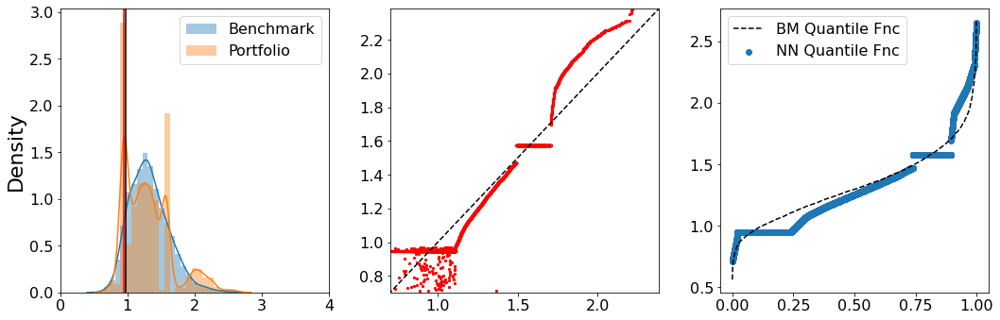

Epoch: 18 Iteration: 4998  duration =  36.515  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.228 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


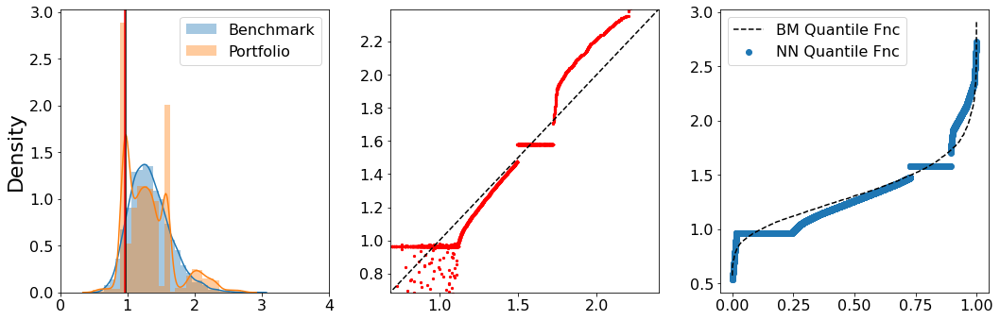

Epoch: 18 Iteration: 9997  duration =  24.948  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.223 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


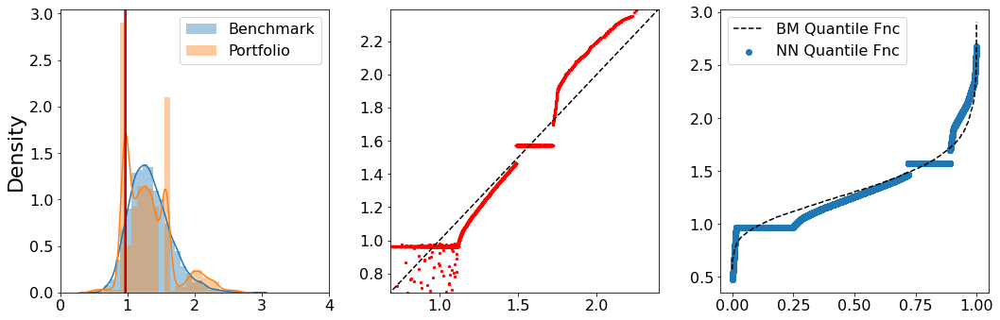

Epoch: 19 Iteration: 4998  duration =  36.951  secs
Budget Dist: -0.000 Wass Dist: 0.100 Risk Measure: -1.223 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


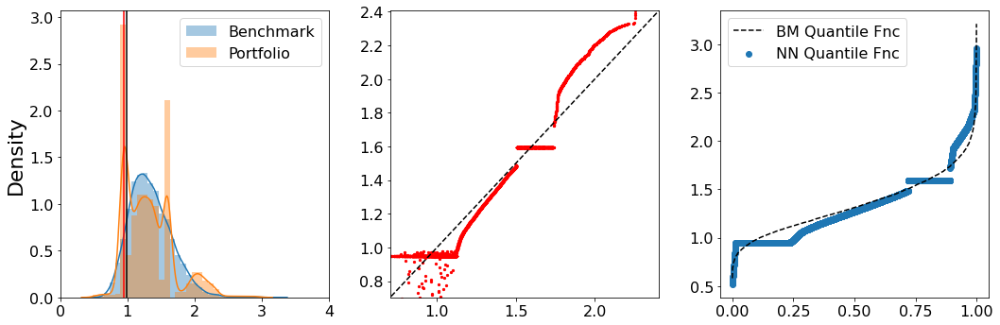

Epoch: 19 Iteration: 9997  duration =  25.024  secs
Budget Dist: 0.002 Wass Dist: 0.102 Risk Measure: -1.228 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


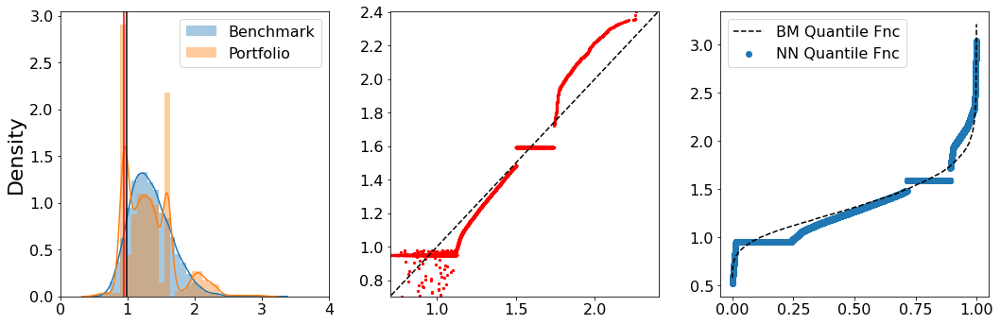

Epoch: 20 Iteration: 4998  duration =  36.662  secs
Budget Dist: -0.004 Wass Dist: 0.101 Risk Measure: -1.211 Loss: -1.208


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


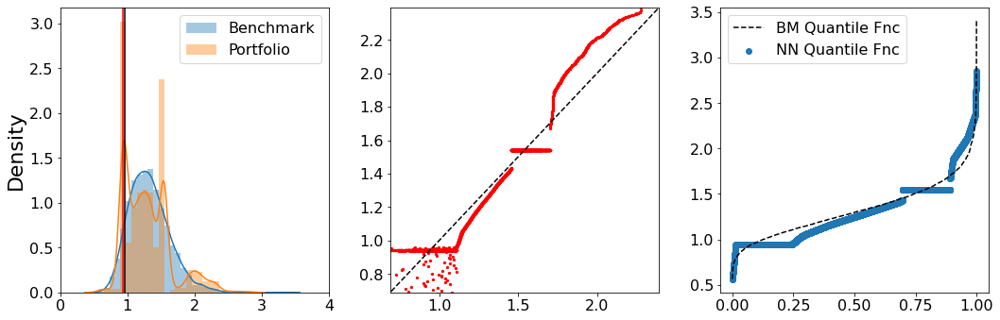

Epoch: 20 Iteration: 9997  duration =  24.847  secs
Budget Dist: -0.001 Wass Dist: 0.101 Risk Measure: -1.215 Loss: -1.212


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


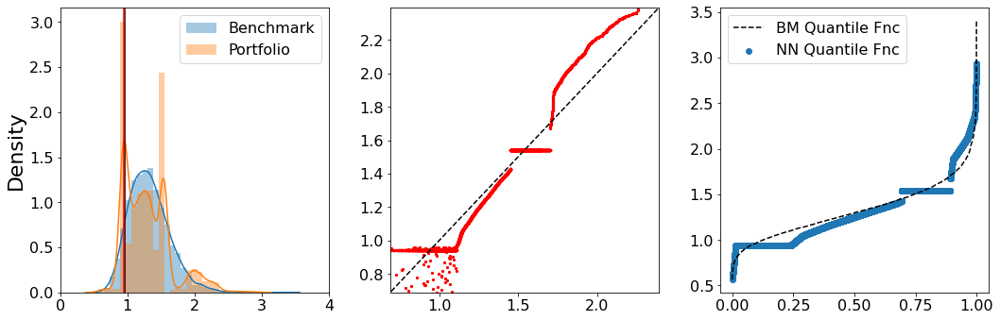

Epoch: 21 Iteration: 4998  duration =  36.578  secs
Budget Dist: 0.004 Wass Dist: 0.100 Risk Measure: -1.217 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


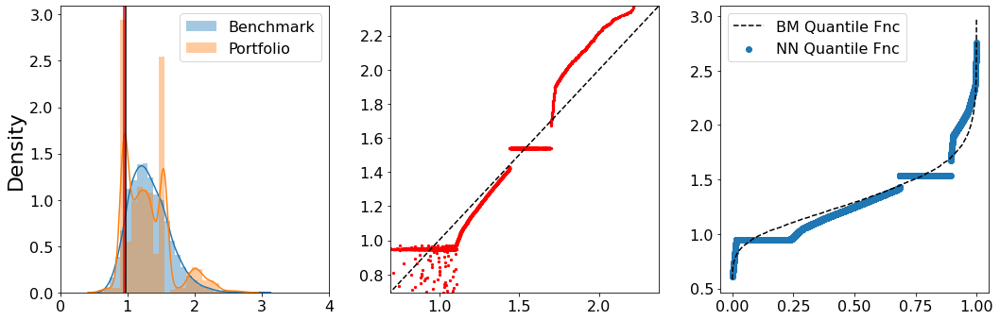

Epoch: 21 Iteration: 9997  duration =  25.252  secs
Budget Dist: 0.001 Wass Dist: 0.100 Risk Measure: -1.213 Loss: -1.211


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


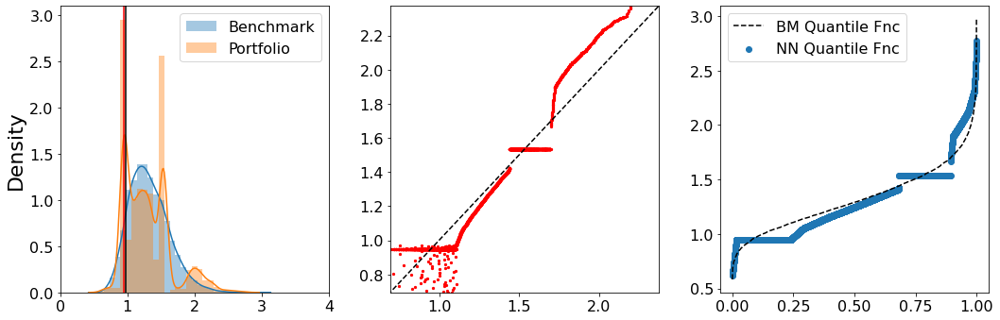

Epoch: 22 Iteration: 4998  duration =  36.524  secs
Budget Dist: 0.007 Wass Dist: 0.100 Risk Measure: -1.223 Loss: -1.210


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


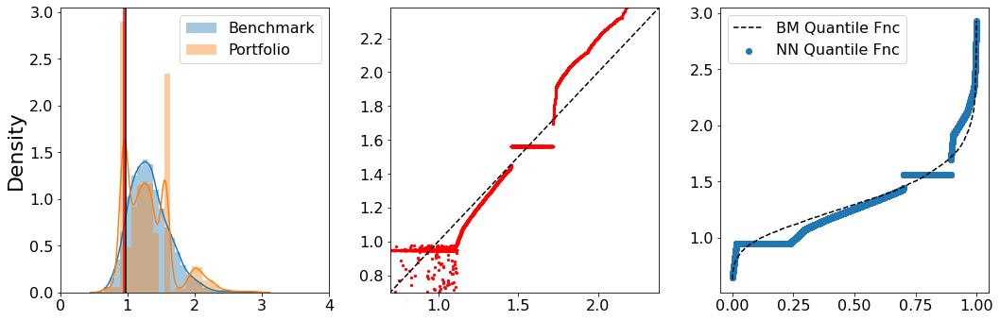

Epoch: 22 Iteration: 9997  duration =  24.806  secs
Budget Dist: -0.004 Wass Dist: 0.102 Risk Measure: -1.212 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


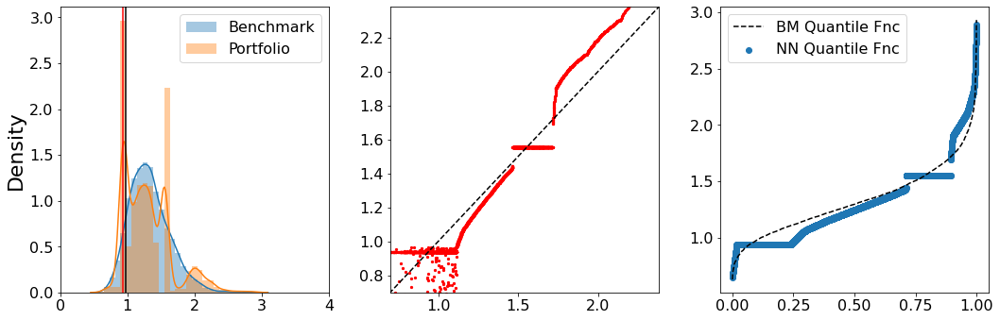

Epoch: 23 Iteration: 4998  duration =  36.552  secs
Budget Dist: 0.000 Wass Dist: 0.099 Risk Measure: -1.211 Loss: -1.210


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


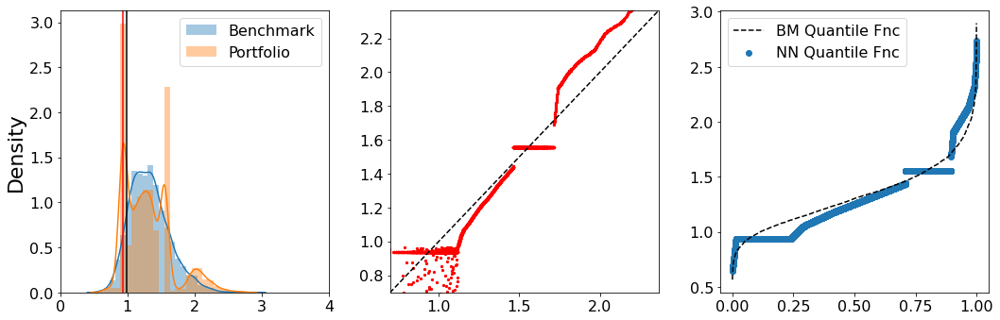

Epoch: 23 Iteration: 9997  duration =  24.781  secs
Budget Dist: 0.005 Wass Dist: 0.101 Risk Measure: -1.219 Loss: -1.208


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


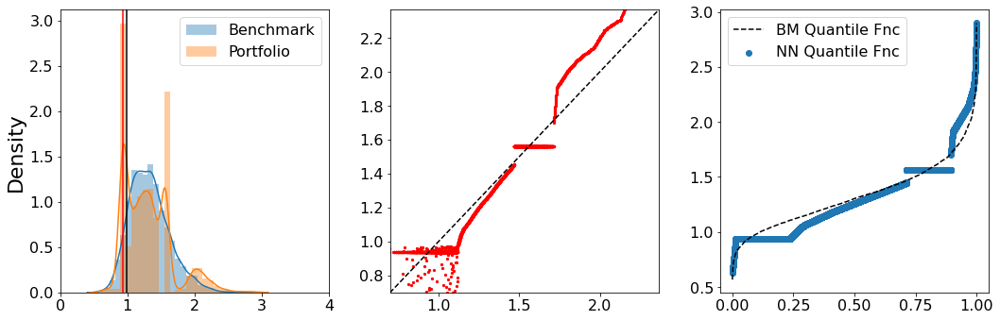

Epoch: 24 Iteration: 4998  duration =  36.570  secs
Budget Dist: 0.002 Wass Dist: 0.099 Risk Measure: -1.213 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


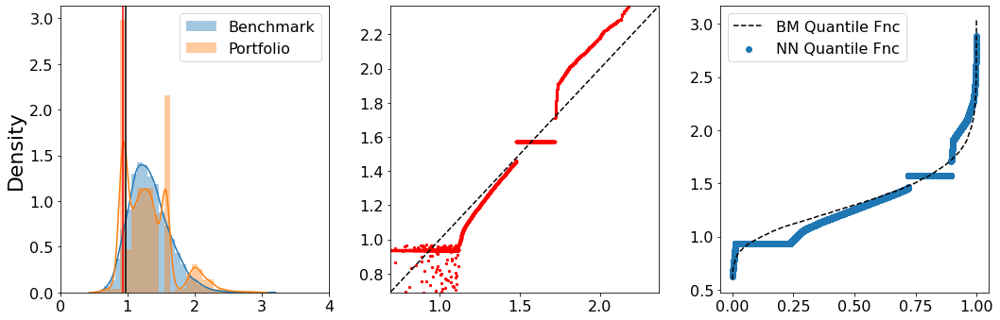

Epoch: 24 Iteration: 9997  duration =  24.983  secs
Budget Dist: -0.000 Wass Dist: 0.101 Risk Measure: -1.214 Loss: -1.211


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


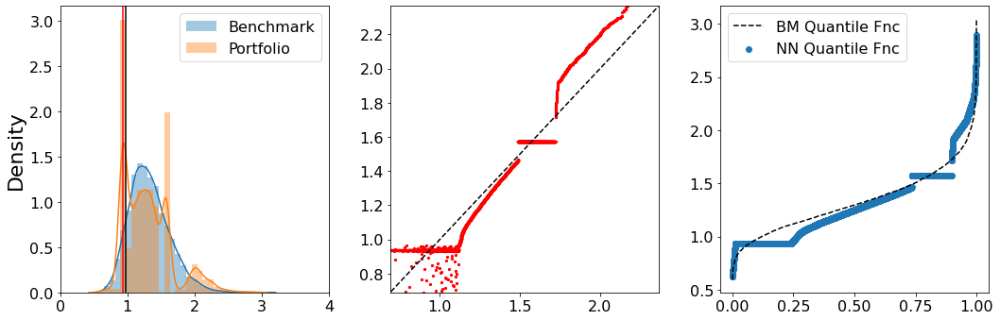

Epoch: 25 Iteration: 4998  duration =  37.219  secs
Budget Dist: 0.004 Wass Dist: 0.101 Risk Measure: -1.227 Loss: -1.217


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


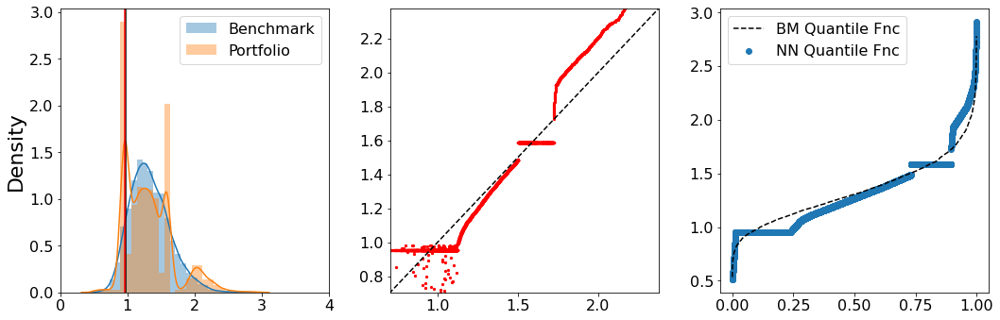

Epoch: 25 Iteration: 9997  duration =  24.867  secs
Budget Dist: 0.003 Wass Dist: 0.100 Risk Measure: -1.224 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


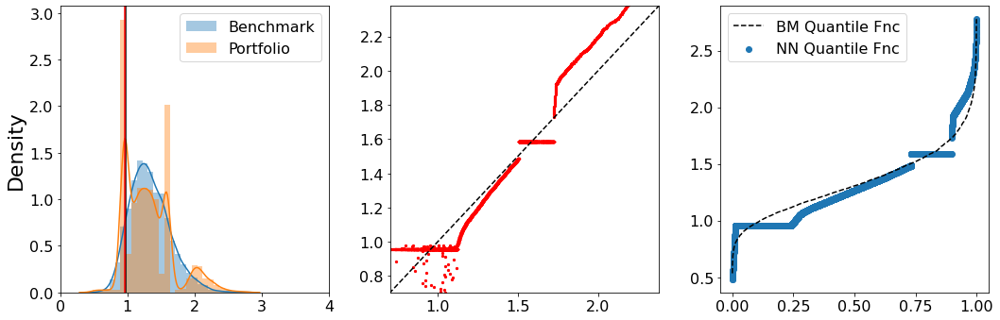

Epoch: 26 Iteration: 4998  duration =  36.709  secs
Budget Dist: 0.001 Wass Dist: 0.101 Risk Measure: -1.220 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


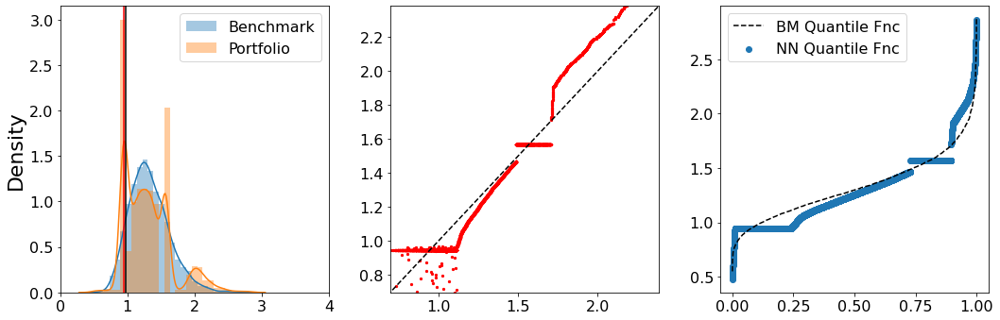

Epoch: 26 Iteration: 9997  duration =  24.834  secs
Budget Dist: -0.000 Wass Dist: 0.104 Risk Measure: -1.222 Loss: -1.214


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


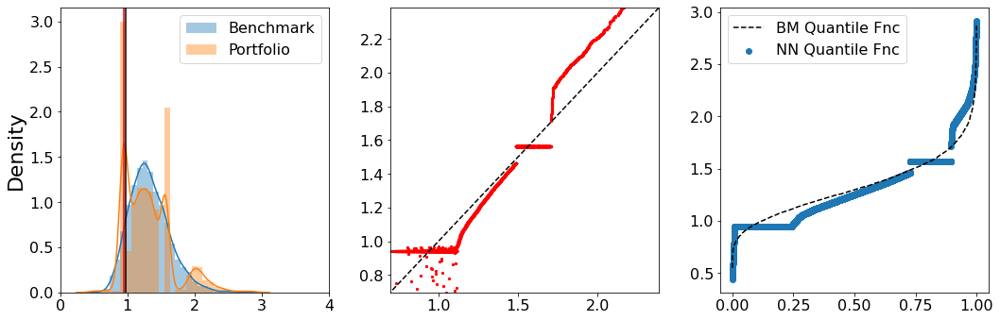

Epoch: 27 Iteration: 4998  duration =  36.544  secs
Budget Dist: 0.004 Wass Dist: 0.098 Risk Measure: -1.223 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


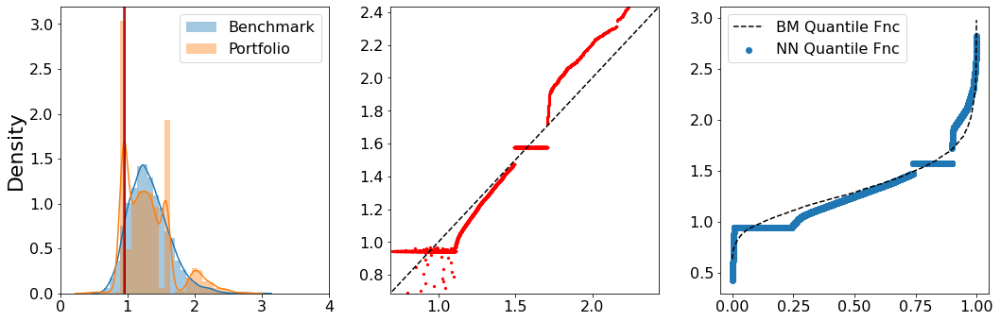

Epoch: 27 Iteration: 9997  duration =  24.918  secs
Budget Dist: -0.003 Wass Dist: 0.099 Risk Measure: -1.217 Loss: -1.217


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


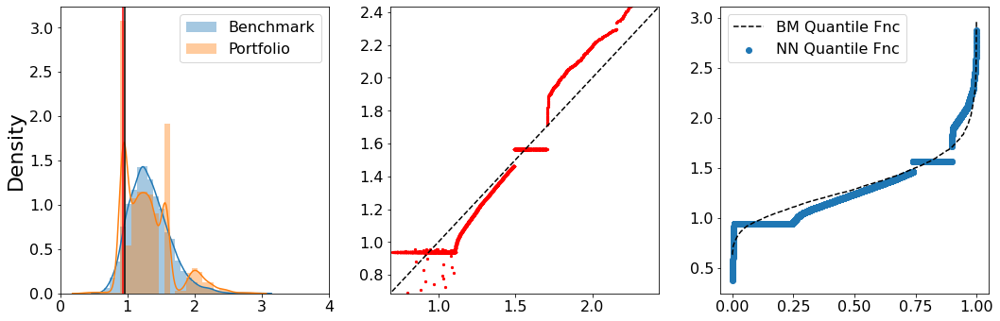

Epoch: 28 Iteration: 4998  duration =  37.177  secs
Budget Dist: -0.000 Wass Dist: 0.101 Risk Measure: -1.224 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


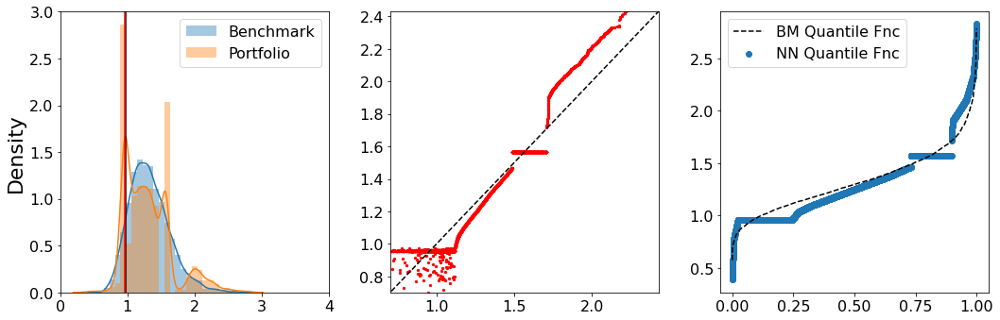

Epoch: 28 Iteration: 9997  duration =  25.124  secs
Budget Dist: -0.002 Wass Dist: 0.103 Risk Measure: -1.224 Loss: -1.218


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


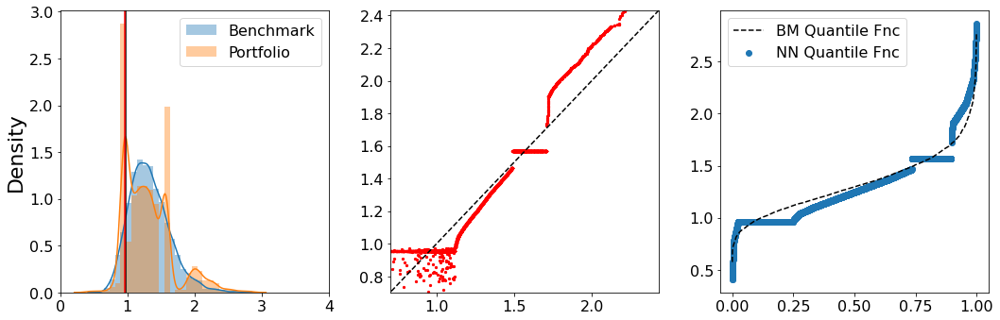

Epoch: 29 Iteration: 4998  duration =  36.680  secs
Budget Dist: 0.001 Wass Dist: 0.099 Risk Measure: -1.215 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


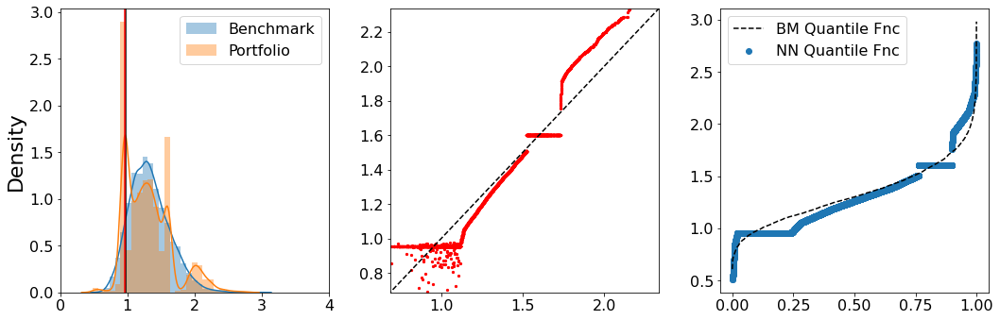

Epoch: 29 Iteration: 9997  duration =  24.979  secs
Budget Dist: -0.000 Wass Dist: 0.101 Risk Measure: -1.216 Loss: -1.215


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


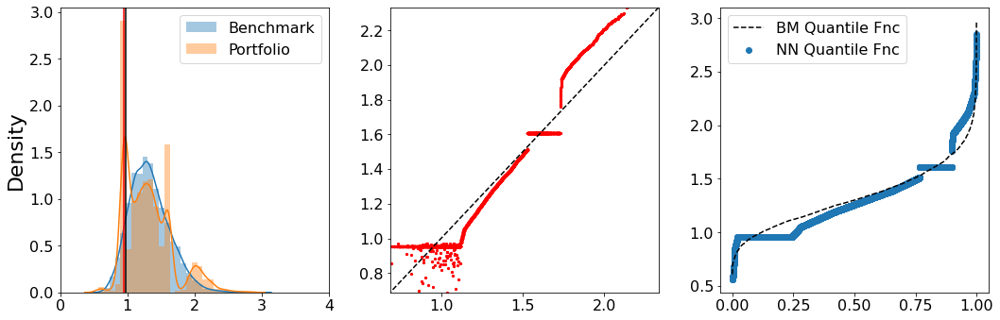

Epoch: 30 Iteration: 4998  duration =  36.545  secs
Budget Dist: 0.001 Wass Dist: 0.101 Risk Measure: -1.217 Loss: -1.215


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


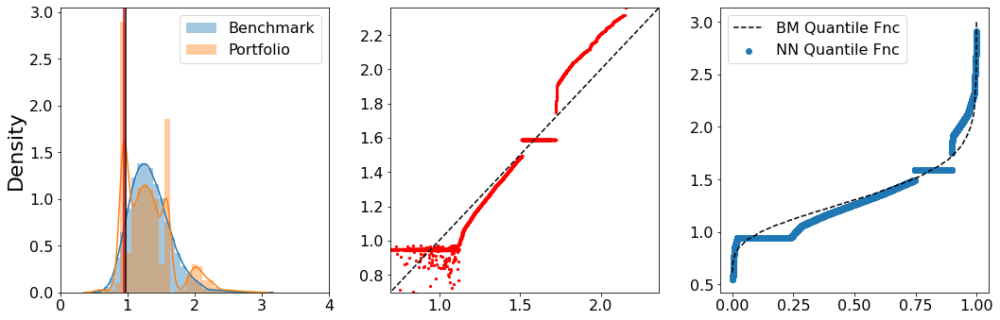

Epoch: 30 Iteration: 9997  duration =  24.859  secs
Budget Dist: -0.000 Wass Dist: 0.101 Risk Measure: -1.217 Loss: -1.215


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


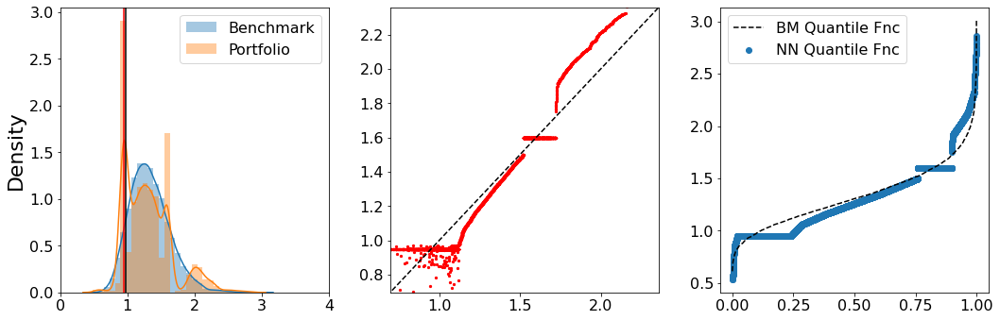

Epoch: 31 Iteration: 4998  duration =  36.644  secs
Budget Dist: 0.004 Wass Dist: 0.098 Risk Measure: -1.220 Loss: -1.211


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


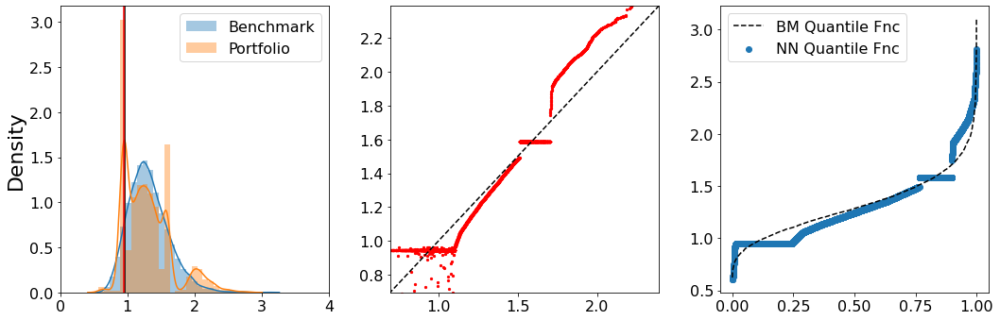

Epoch: 31 Iteration: 9997  duration =  24.930  secs
Budget Dist: -0.000 Wass Dist: 0.098 Risk Measure: -1.145 Loss: -1.145


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


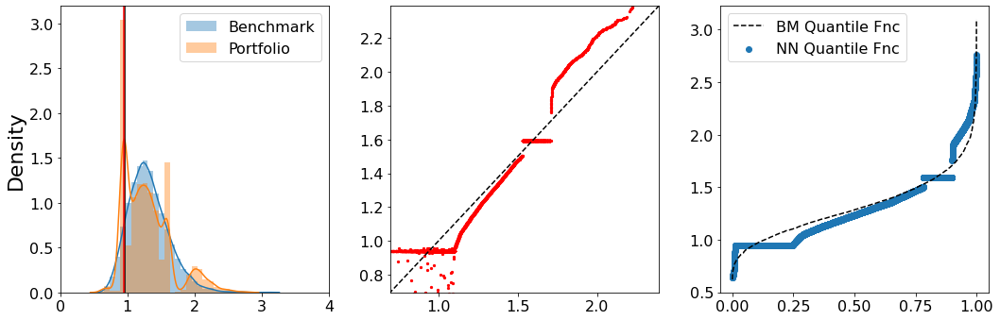

Epoch: 32 Iteration: 4998  duration =  37.147  secs
Budget Dist: -0.002 Wass Dist: 0.102 Risk Measure: -1.217 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


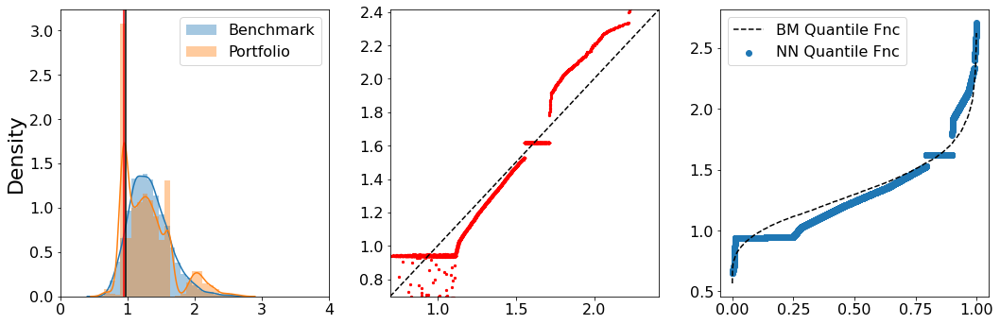

Epoch: 32 Iteration: 9997  duration =  25.007  secs
Budget Dist: 0.005 Wass Dist: 0.098 Risk Measure: -1.221 Loss: -1.210


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


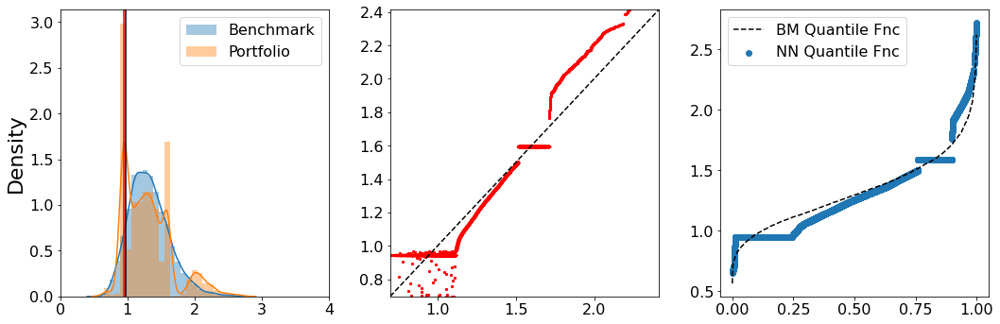

Epoch: 33 Iteration: 4998  duration =  36.828  secs
Budget Dist: 0.001 Wass Dist: 0.099 Risk Measure: -1.223 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


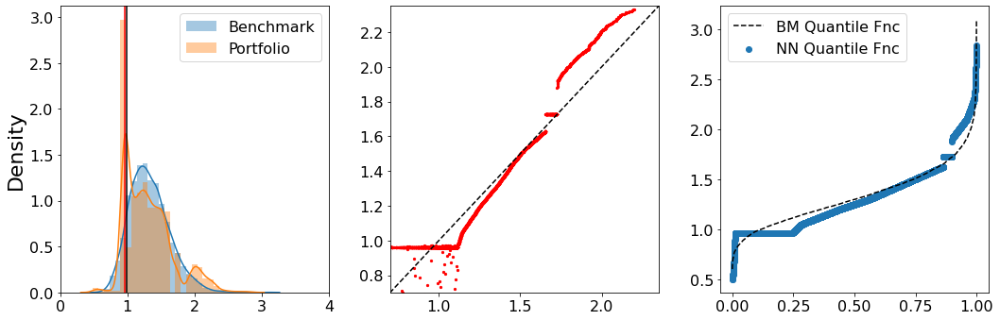

Epoch: 33 Iteration: 9997  duration =  24.984  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.220 Loss: -1.220


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


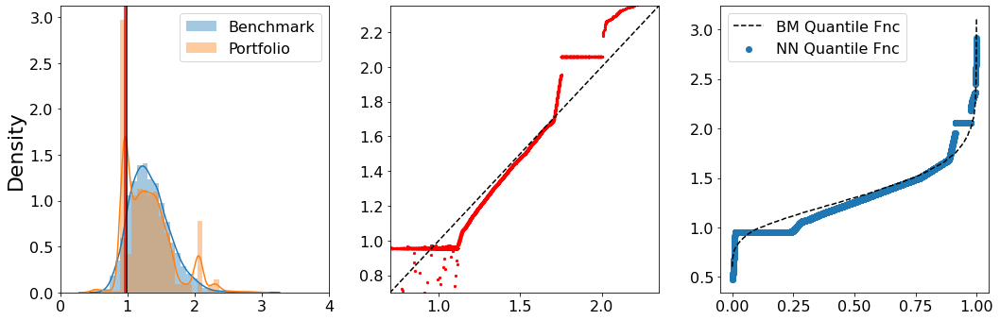

Epoch: 34 Iteration: 4998  duration =  36.584  secs
Budget Dist: 0.000 Wass Dist: 0.100 Risk Measure: -1.228 Loss: -1.227


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


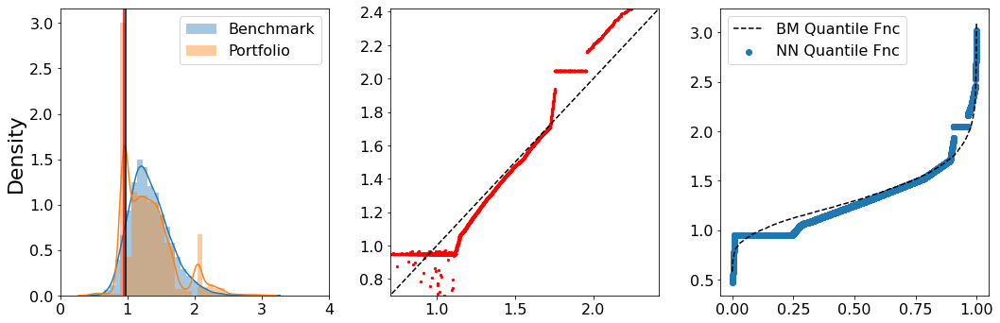

Epoch: 34 Iteration: 9997  duration =  25.057  secs
Budget Dist: 0.004 Wass Dist: 0.100 Risk Measure: -1.233 Loss: -1.225


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


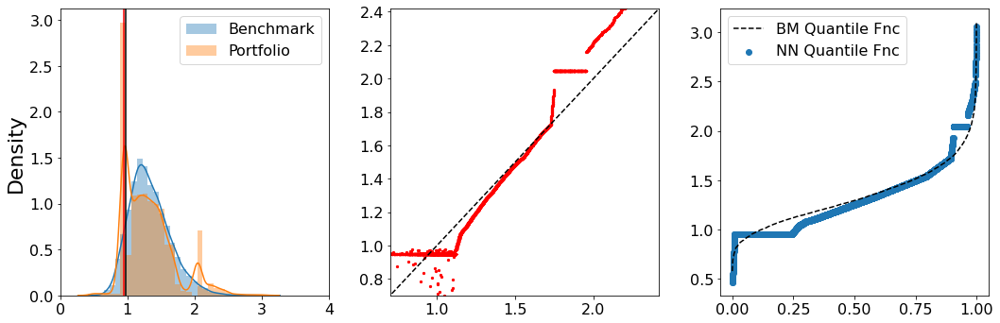

Epoch: 35 Iteration: 4998  duration =  36.854  secs
Budget Dist: -0.002 Wass Dist: 0.102 Risk Measure: -1.234 Loss: -1.230


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


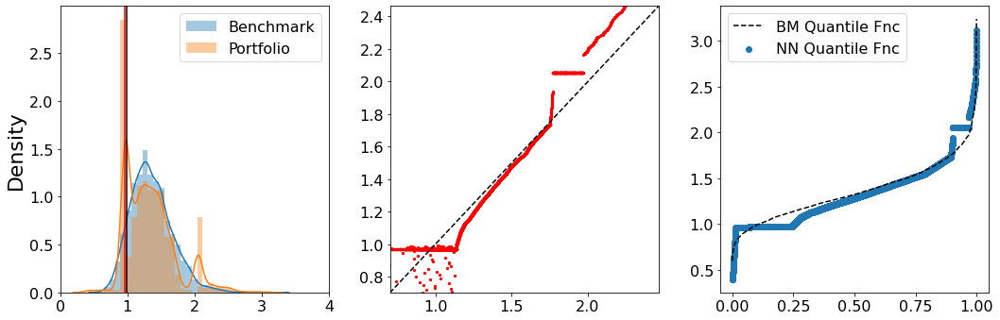

Epoch: 35 Iteration: 9997  duration =  24.902  secs
Budget Dist: -0.001 Wass Dist: 0.100 Risk Measure: -1.233 Loss: -1.233


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


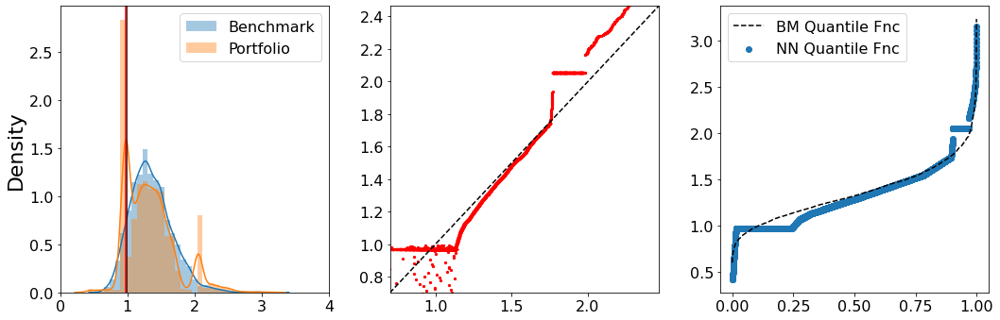

Epoch: 36 Iteration: 4998  duration =  37.164  secs
Budget Dist: 0.005 Wass Dist: 0.101 Risk Measure: -1.230 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


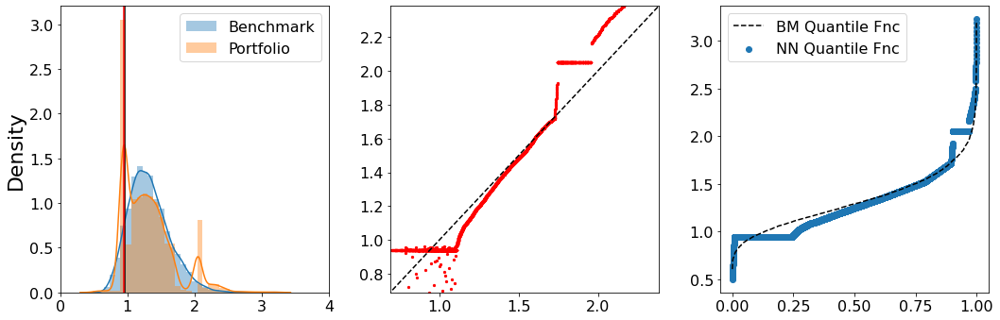

Epoch: 36 Iteration: 9997  duration =  25.021  secs
Budget Dist: -0.003 Wass Dist: 0.103 Risk Measure: -1.221 Loss: -1.215


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


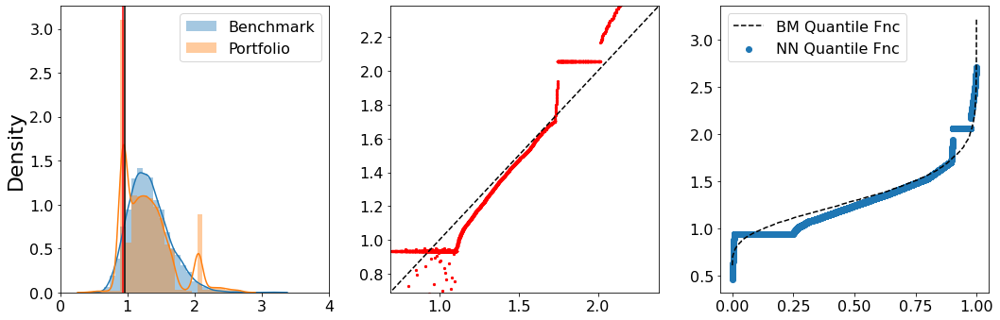

Epoch: 37 Iteration: 4998  duration =  36.513  secs
Budget Dist: -0.000 Wass Dist: 0.100 Risk Measure: -1.214 Loss: -1.213


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


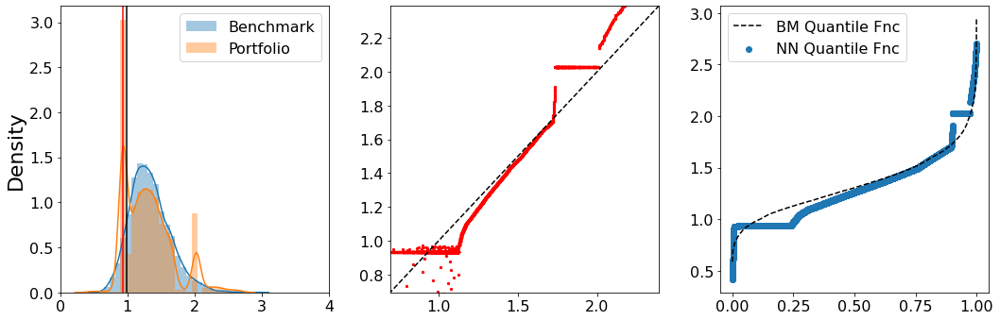

Epoch: 37 Iteration: 9997  duration =  24.834  secs
Budget Dist: -0.002 Wass Dist: 0.102 Risk Measure: -1.214 Loss: -1.210


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


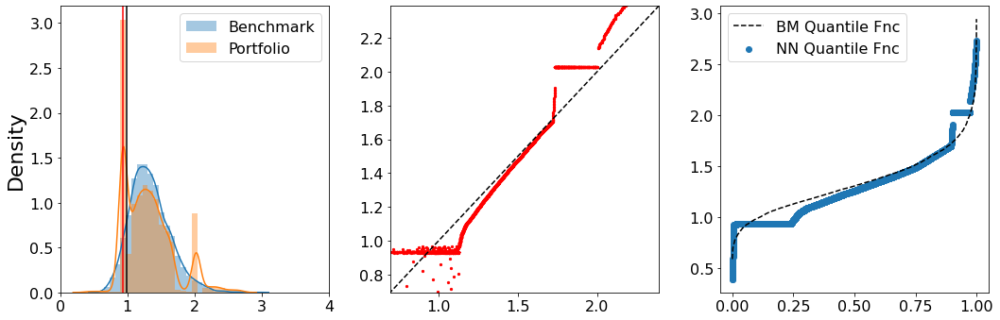

Epoch: 38 Iteration: 4998  duration =  36.325  secs
Budget Dist: -0.000 Wass Dist: 0.101 Risk Measure: -1.221 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


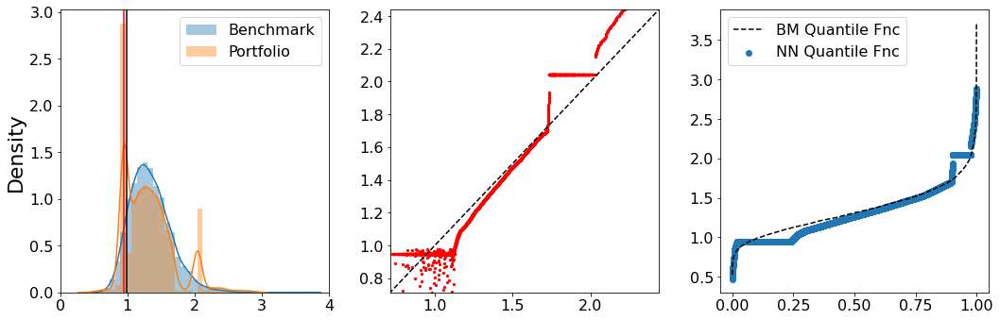

Epoch: 38 Iteration: 9997  duration =  24.632  secs
Budget Dist: -0.000 Wass Dist: 0.099 Risk Measure: -1.219 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


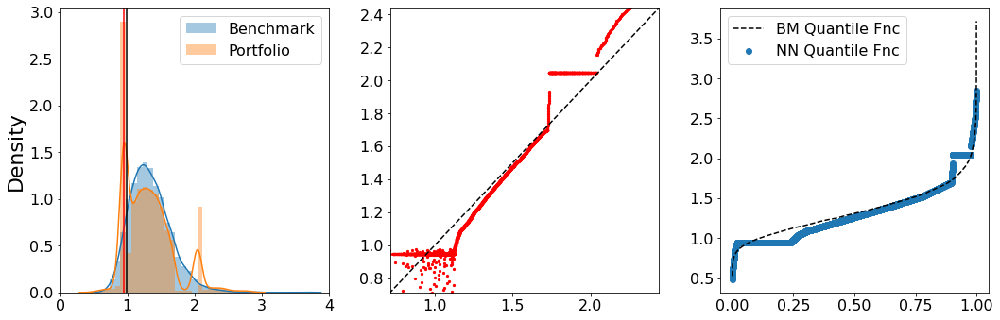

Epoch: 39 Iteration: 4998  duration =  36.283  secs
Budget Dist: -0.002 Wass Dist: 0.102 Risk Measure: -1.219 Loss: -1.215


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


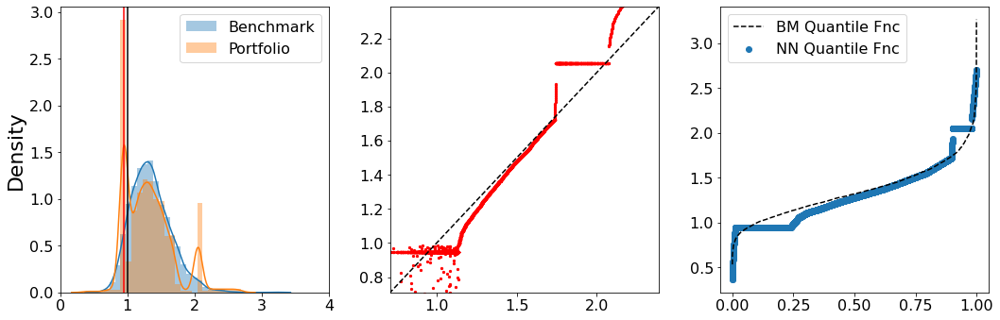

Epoch: 39 Iteration: 9997  duration =  24.598  secs
Budget Dist: 0.003 Wass Dist: 0.099 Risk Measure: -1.223 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


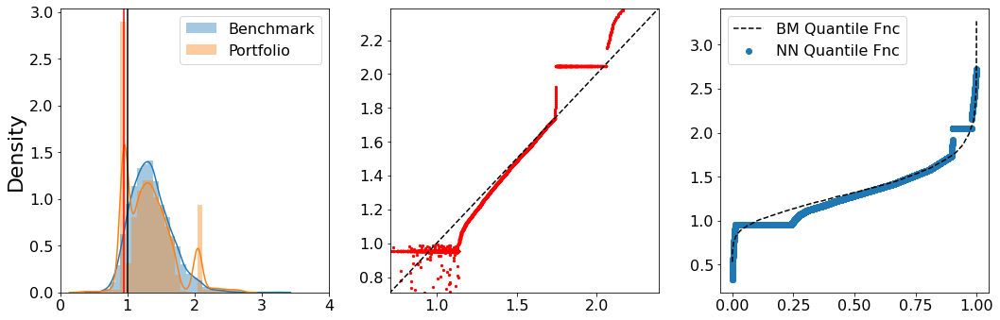

Epoch: 40 Iteration: 4998  duration =  36.184  secs
Budget Dist: 0.000 Wass Dist: 0.099 Risk Measure: -1.227 Loss: -1.227


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


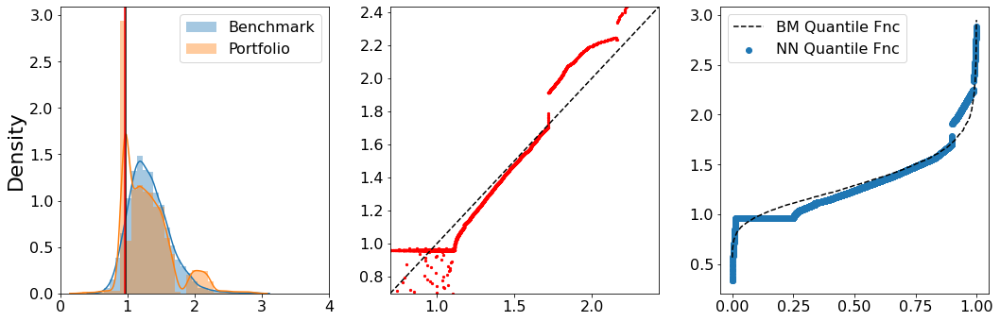

Epoch: 40 Iteration: 9997  duration =  25.424  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.231 Loss: -1.226


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


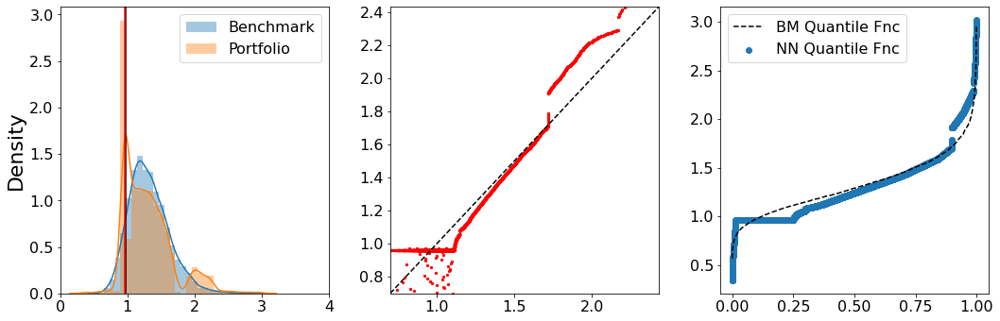

Epoch: 41 Iteration: 4998  duration =  36.538  secs
Budget Dist: 0.003 Wass Dist: 0.096 Risk Measure: -1.224 Loss: -1.217


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


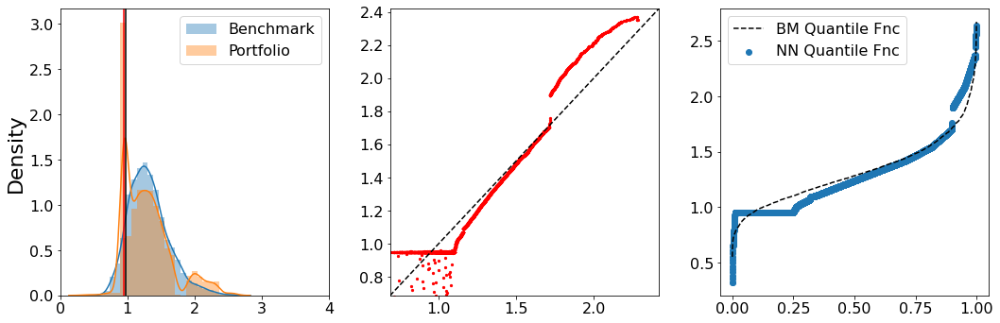

Epoch: 41 Iteration: 9997  duration =  24.775  secs
Budget Dist: 0.001 Wass Dist: 0.102 Risk Measure: -1.230 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


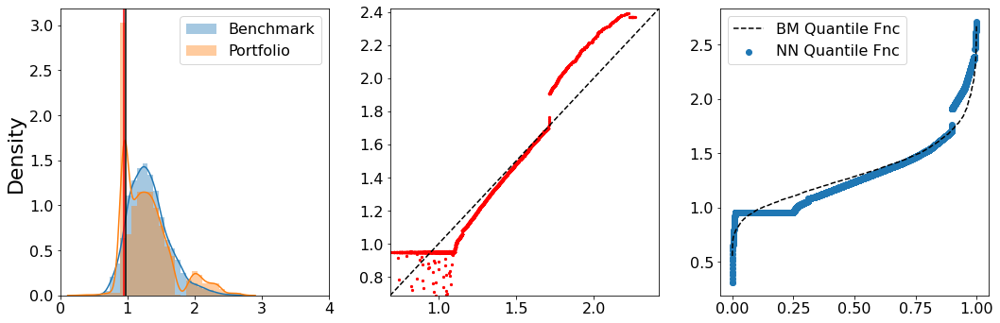

Epoch: 42 Iteration: 4998  duration =  36.546  secs
Budget Dist: 0.005 Wass Dist: 0.098 Risk Measure: -1.231 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


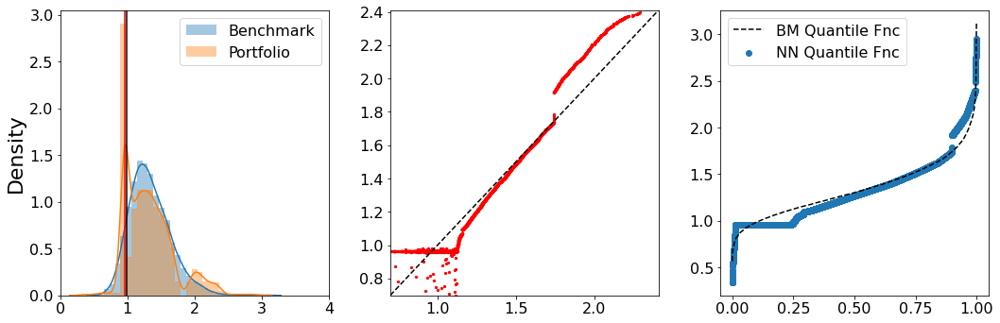

Epoch: 42 Iteration: 9997  duration =  24.669  secs
Budget Dist: -0.002 Wass Dist: 0.104 Risk Measure: -1.230 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


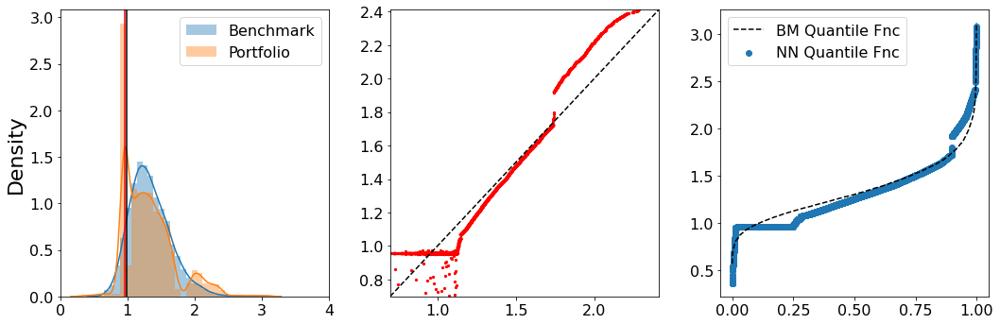

Epoch: 43 Iteration: 4998  duration =  36.437  secs
Budget Dist: 0.001 Wass Dist: 0.100 Risk Measure: -1.230 Loss: -1.229


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


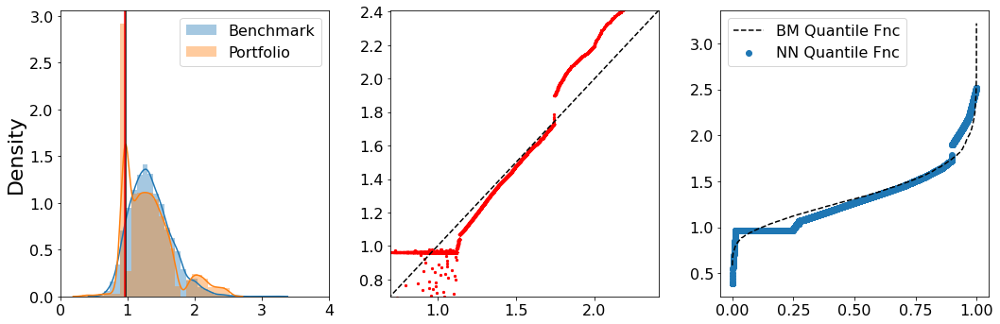

Epoch: 43 Iteration: 9997  duration =  24.561  secs
Budget Dist: 0.002 Wass Dist: 0.102 Risk Measure: -1.235 Loss: -1.226


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


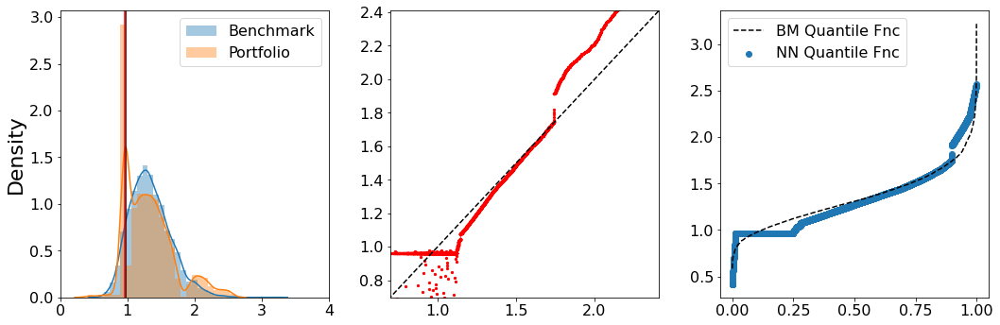

Epoch: 44 Iteration: 4998  duration =  36.308  secs
Budget Dist: 0.003 Wass Dist: 0.099 Risk Measure: -1.216 Loss: -1.209


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


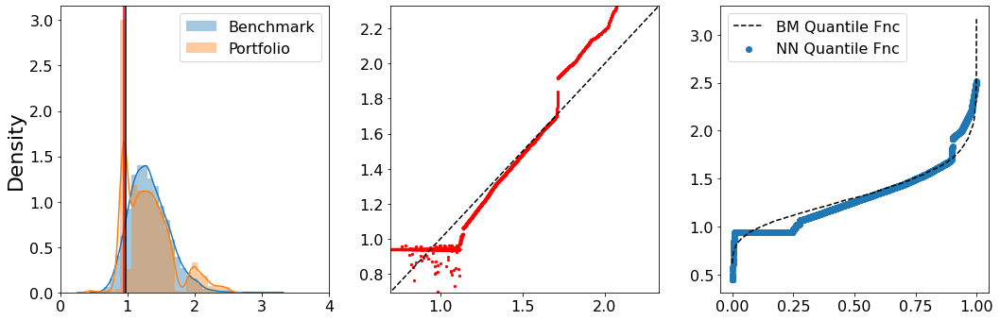

Epoch: 44 Iteration: 9997  duration =  24.640  secs
Budget Dist: -0.001 Wass Dist: 0.101 Risk Measure: -1.213 Loss: -1.211


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


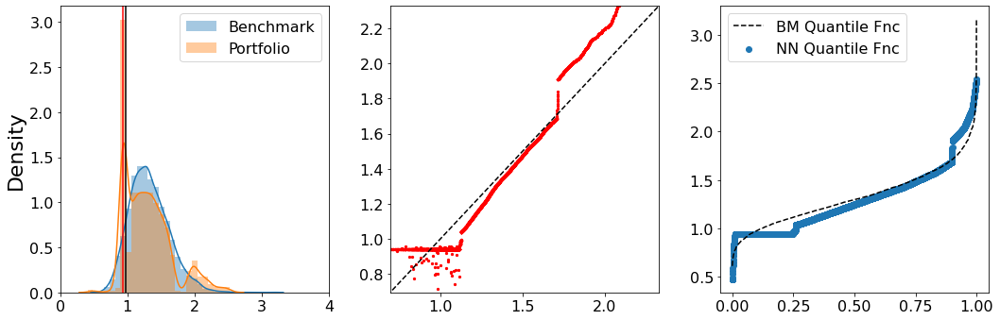

Epoch: 45 Iteration: 4998  duration =  36.456  secs
Budget Dist: -0.002 Wass Dist: 0.103 Risk Measure: -1.221 Loss: -1.216


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


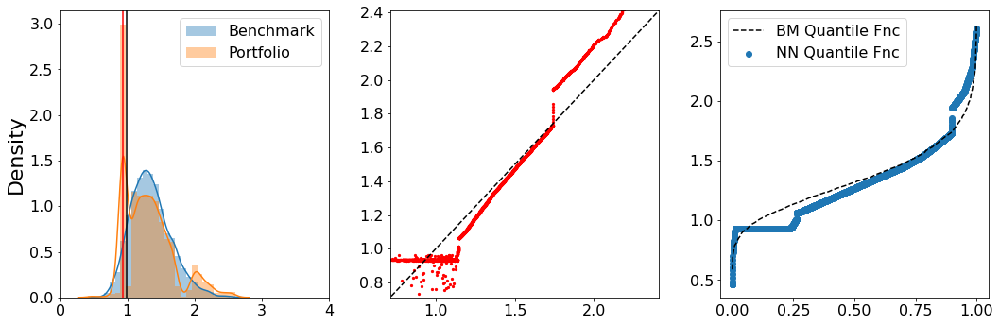

Epoch: 45 Iteration: 9997  duration =  24.690  secs
Budget Dist: 0.002 Wass Dist: 0.100 Risk Measure: -1.224 Loss: -1.219


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


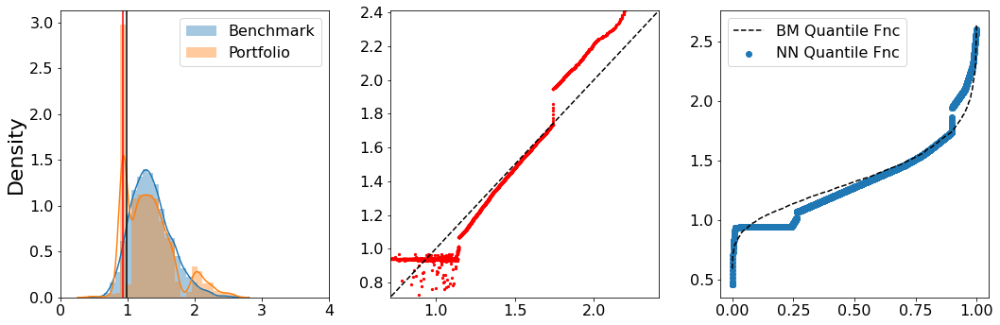

Epoch: 46 Iteration: 4998  duration =  37.287  secs
Budget Dist: -0.000 Wass Dist: 0.099 Risk Measure: -1.223 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


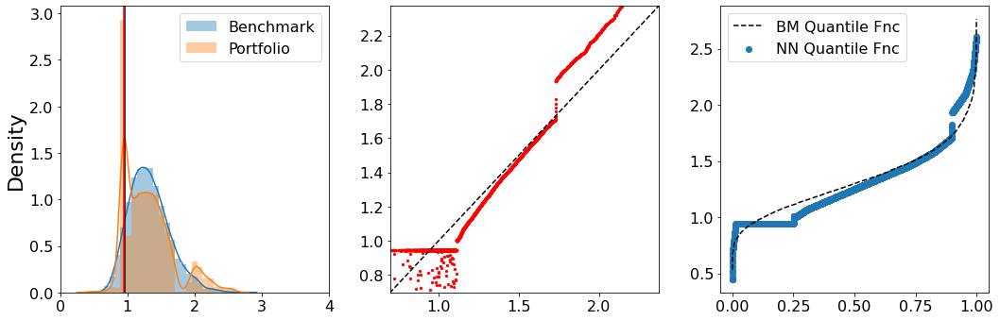

Epoch: 46 Iteration: 9997  duration =  24.750  secs
Budget Dist: 0.002 Wass Dist: 0.101 Risk Measure: -1.228 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


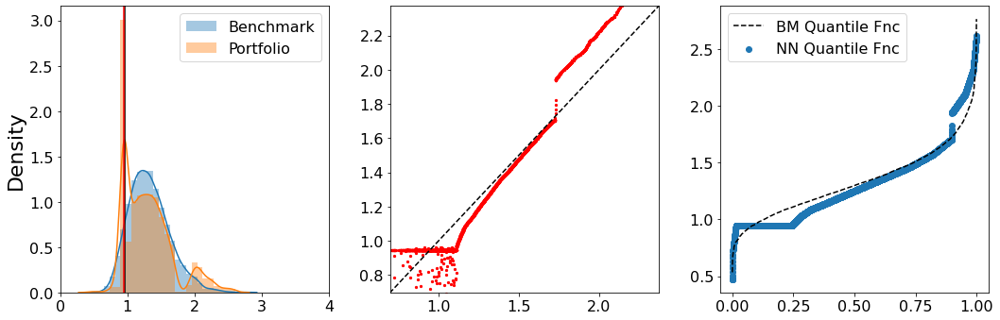

Epoch: 47 Iteration: 4998  duration =  36.644  secs
Budget Dist: 0.000 Wass Dist: 0.103 Risk Measure: -1.216 Loss: -1.208


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


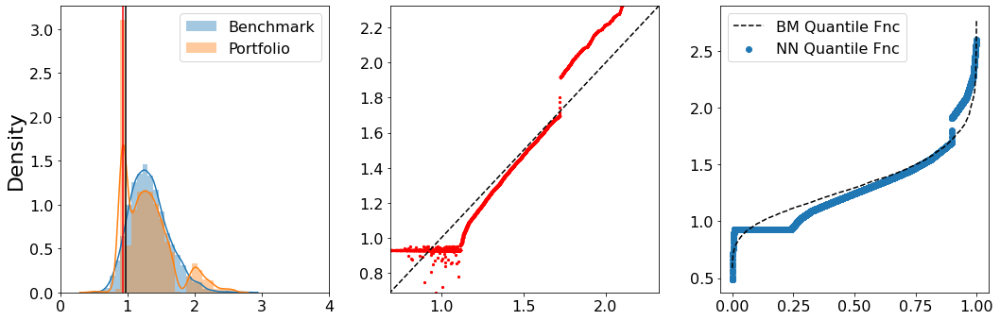

Epoch: 47 Iteration: 9997  duration =  24.721  secs
Budget Dist: 0.000 Wass Dist: 0.100 Risk Measure: -1.212 Loss: -1.211


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


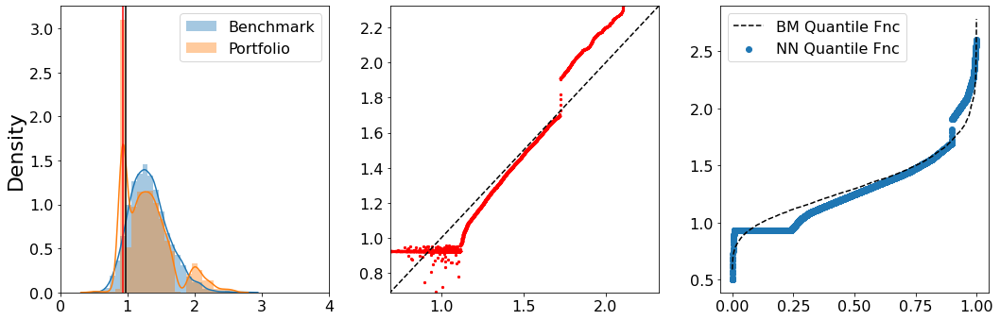

Epoch: 48 Iteration: 4998  duration =  36.619  secs
Budget Dist: 0.001 Wass Dist: 0.099 Risk Measure: -1.224 Loss: -1.222


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


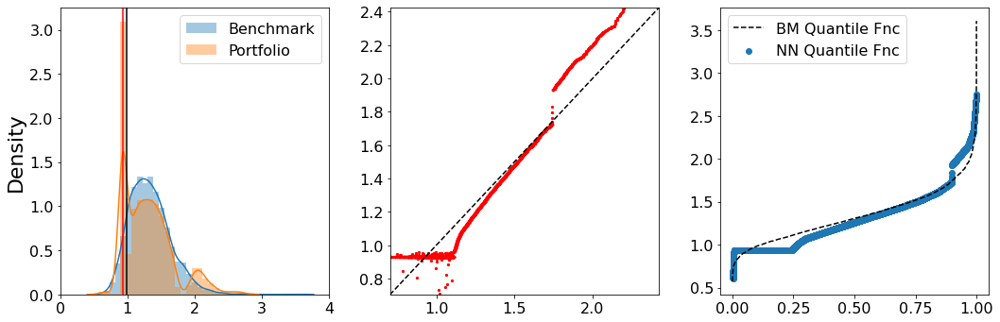

Epoch: 48 Iteration: 9997  duration =  24.666  secs
Budget Dist: 0.002 Wass Dist: 0.099 Risk Measure: -1.225 Loss: -1.221


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


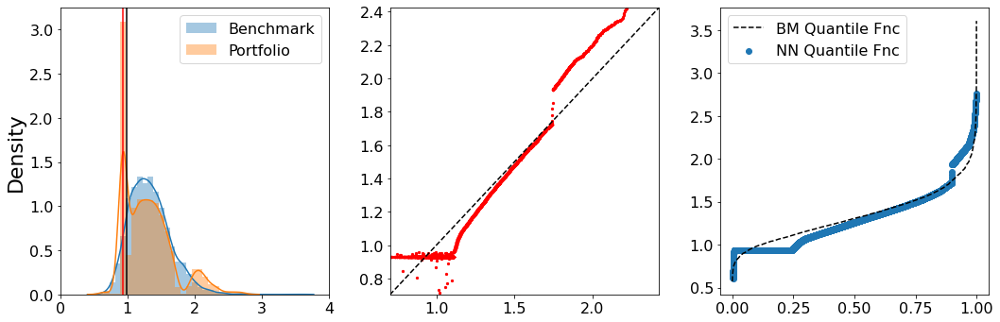

Epoch: 49 Iteration: 4998  duration =  36.395  secs
Budget Dist: 0.001 Wass Dist: 0.100 Risk Measure: -1.226 Loss: -1.224


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


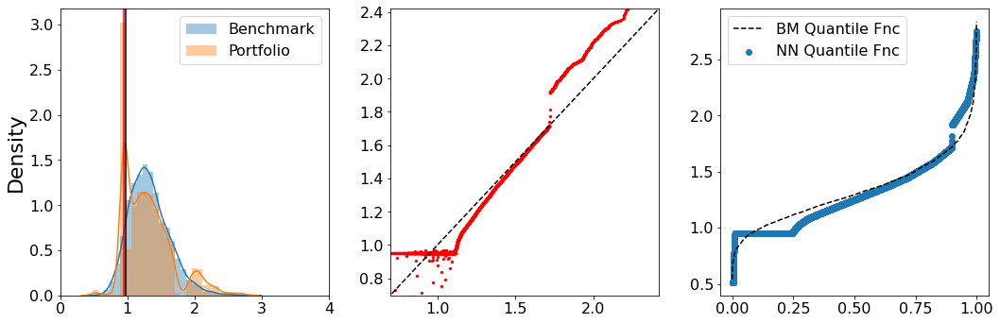

Epoch: 49 Iteration: 9997  duration =  24.695  secs
Budget Dist: -0.001 Wass Dist: 0.101 Risk Measure: -1.225 Loss: -1.223


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


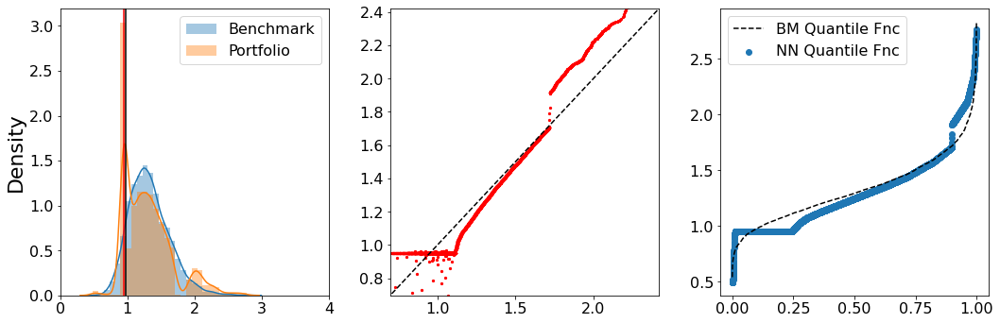

Finished Training


In [ ]:
net = ValueNet_Jump(100).to(device)
model_name = "Copula_Freeze_T5.pt"
T = 5
Ndt = 252*T
Nsims = 5000
Nepochs = 50
Train_ValueNet_Copula_Freeze(net, model_name, params_MV,  Ndt, T, Nsims, Nepochs)